In [0]:
import torch
import torch.nn as nn
from torch import optim
from torch.autograd import Variable

import os
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import librosa
import random
import copy

from tqdm import tqdm_notebook as tqdm
from datetime import datetime

In [36]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [37]:
n_mels = 80
fs = 44100
frame_length_ms=50
frame_shift_ms=25
nsc = int(fs * frame_length_ms / 1000)
nov = nsc - int(fs * frame_shift_ms / 1000)
nhop = int(fs * frame_shift_ms / 1000)
eps = 1e-8
db_ref = 160

# meta_path = "D:/korean-single-speaker-speech-dataset/transcript.v.1.2.txt"
# data_folder = "D:/korean-single-speaker-speech-dataset/kss"

meta_path = 'gdrive/My Drive/korean-single-speaker-speech-dataset/transcript.v.1.2.txt'
data_folder = 'gdrive/My Drive/korean-single-speaker-speech-dataset/kss'

with open(meta_path, encoding='utf-8') as f:
    metadata = np.array([line.strip().split('|') for line in f])
#     hours = sum((int(x[2]) for x in metadata)) * frame_shift_ms / (3600 * 1000)
#     log('Loaded metadata for %d examples (%.2f hours)' % (len(metadata), hours))

# metadata = metadata[:32, :2]

max_sequence_len = max(list(map(len, metadata[:, 1])))

error_jamos = [5868, 5998, 6046, 6155, 6202, 
               6654, 6890, 7486, 7502, 7744, 
               7765, 8267, 9069, 9927, 10437, 
               10515, 10533, 10606, 10610, 12777]

print(metadata.shape)
metadata = np.delete(metadata, error_jamos, axis = 0)
print(metadata.shape)

dataset_size = len(metadata)

(12853, 5)
(12833, 5)


In [0]:
character_length = list()
file_length = list()
division_length = list()
unicode_jamo_list = list()

for i in range(len(metadata)):
    character_length.append(len(metadata[i, 3]))
    file_length.append(float(metadata[i, 4]))
    division_length.append(float(metadata[i, 4]) * 1000 / len(metadata[i, 3]))

In [0]:
wave_name_list = []

for data in metadata:
    wave_name_list.append(data[0])

In [40]:
unicode_jamo_list = list()
for unicode in range(0x1100, 0x1113):
    unicode_jamo_list.append(chr(unicode))
    
for unicode in range(0x1161, 0x1176):
    unicode_jamo_list.append(chr(unicode))
    
for unicode in range(0x11A8, 0x11C3):
    unicode_jamo_list.append(chr(unicode))
    
unicode_jamo_list += [' ', '!', ',', '.', '?', '<sos>', '<eos>']
    
unicode_jamo_list.sort()

print(unicode_jamo_list)
print(len(unicode_jamo_list))

[' ', '!', ',', '.', '<eos>', '<sos>', '?', 'ᄀ', 'ᄁ', 'ᄂ', 'ᄃ', 'ᄄ', 'ᄅ', 'ᄆ', 'ᄇ', 'ᄈ', 'ᄉ', 'ᄊ', 'ᄋ', 'ᄌ', 'ᄍ', 'ᄎ', 'ᄏ', 'ᄐ', 'ᄑ', 'ᄒ', 'ᅡ', 'ᅢ', 'ᅣ', 'ᅤ', 'ᅥ', 'ᅦ', 'ᅧ', 'ᅨ', 'ᅩ', 'ᅪ', 'ᅫ', 'ᅬ', 'ᅭ', 'ᅮ', 'ᅯ', 'ᅰ', 'ᅱ', 'ᅲ', 'ᅳ', 'ᅴ', 'ᅵ', 'ᆨ', 'ᆩ', 'ᆪ', 'ᆫ', 'ᆬ', 'ᆭ', 'ᆮ', 'ᆯ', 'ᆰ', 'ᆱ', 'ᆲ', 'ᆳ', 'ᆴ', 'ᆵ', 'ᆶ', 'ᆷ', 'ᆸ', 'ᆹ', 'ᆺ', 'ᆻ', 'ᆼ', 'ᆽ', 'ᆾ', 'ᆿ', 'ᇀ', 'ᇁ', 'ᇂ']
74


In [0]:
class Tokenizer():
    def __init__(self, vocabs):
        self.vocabs = vocabs
        
    def word2num(self, sentence):
        tokens = list()
        for char in sentence:
            tokens.append(self.vocabs.index(char))    
        return tokens
        
    def word2vec(self, sentence):
        vectors = np.zeros((len(sentence), len(self.vocabs)))
        for i, char in enumerate(sentence):
            vectors[i, self.vocabs.index(char)] = 1   
        return vectors
    
    def num2word(self, num):
        output = list()
        for i in num:
            output.append(self.vocabs[i])
        return output

In [0]:
tokenizer = Tokenizer(unicode_jamo_list)
jamo_tokens = tokenizer.word2num(unicode_jamo_list)

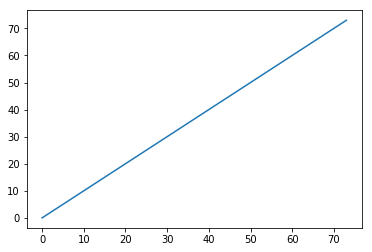

In [43]:
plt.plot(jamo_tokens)
plt.show()

In [44]:
mel_path_list = list()

for i, wav_name in enumerate(tqdm(wave_name_list)):
    
    npy_name = wav_name.replace('.wav', '.npy')
    wav_path = os.path.join(data_folder, wav_name)  
    mel_path = os.path.join(data_folder + '/mel', npy_name)
    mel_path_list.append(mel_path)
    
    if not os.path.isfile(mel_path):
#         print("{}".format(mel_path))
        y, sr = librosa.core.load(wav_path)
        f, t, Zxx = sp.signal.stft(y, fs=sr, nperseg=nsc, noverlap=nov)
        Sxx = np.abs(Zxx)
        Sxx = np.maximum(Sxx, eps)

        # plt.figure(figsize=(20,20))
        # plt.imshow(20*np.log10(Sxx), origin='lower')
        # plt.colorbar()
        # plt.show()

        mel_filters = librosa.filters.mel(sr=fs, n_fft=nsc, n_mels=n_mels)
        mel_specgram = np.matmul(mel_filters, Sxx)

    #   log_specgram = 20*np.log10(Sxx)
    #   norm_log_specgram = (log_specgram + db_ref) / db_ref

        log_mel_specgram = 20 * np.log10(np.maximum(mel_specgram, eps))
        norm_log_mel_specgram = (log_mel_specgram + db_ref) / db_ref

    #   np.save(specgram_path, norm_log_specgram)
        np.save(mel_path, norm_log_mel_specgram)
    #   np.save(specgram_path, Sxx)

    #     print(norm_log_mel_specgram.shape[1])

    #     if i % 1000 == 0:
    #         plt.figure(figsize=(8, 4))
    #         plt.imshow(20 * np.log10(Sxx), origin='lower', aspect='auto')
    #         plt.colorbar()
    #         plt.show()

    #         plt.figure(figsize=(8, 4))
    #         plt.imshow(norm_log_mel_specgram, origin='lower', aspect='auto')
    #         plt.colorbar()
    #         plt.show()    

In [0]:
# embedding_layer = nn.Embedding(len(jamo_tokens), 256)

# print(metadata[5031, 3])
# print(metadata[5031, 2])
# print(len(metadata[5031, 3]))

# input_token = tokenizer.word2num(metadata[5031, 3])
# input_tensor = torch.tensor(input_token)
# plt.imshow(embedding_layer(input_tensor).detach().numpy())

In [0]:
class Encoder(nn.Module):
    def __init__(self, D_in, H, D_out):
        super(Encoder, self).__init__()
        self.H = H
        self.fc = torch.nn.Linear(D_in, H)
        self.relu = torch.nn.ReLU()
        
        self.fc_2 = torch.nn.Linear(H, H)
        self.relu_2 = torch.nn.ReLU()
        
        self.gru = nn.GRU(H, D_out, num_layers=3, bidirectional=True, batch_first=True)
        self.relu_gru = torch.nn.ReLU()

    def forward(self, input_tensor):
        output_tensor = self.fc(input_tensor)
        output_tensor = self.relu(output_tensor)
        
        output_tensor, _ = self.gru(output_tensor)
        output_tensor = self.relu_gru(output_tensor)
        
        output_tensor = self.fc_2(output_tensor)
        output_tensor = self.relu_2(output_tensor)
        return output_tensor
    
class Decoder(nn.Module):
    def __init__(self, H, D_out):
        super(Decoder, self).__init__()
        self.H = H
        self.fc_embed = nn.Linear(256, 1024)
        self.gru = nn.GRU(2 * H, H, batch_first=True)
        self.attention = AttentionModule(D_out * 2)
        self.fc = nn.Linear(1024, 74)
        self.softmax = nn.Softmax(dim=2)

    def forward(self, input_tensor, hidden_tensor, query):
#         print("Input tensor shape in Decoder: {}".format(input_tensor.shape))
#         print("Hidden_tensor shape in Decoder: {}".format(hidden_tensor.shape))
        output_tensor = self.fc_embed(input_tensor)
#         print("Output tensor shape in Decoder: {}".format(output_tensor.shape))
        output_tensor, hidden_tensor = self.gru(output_tensor, hidden_tensor)
        
#         print("Hidden_tensor shape in Decoder: {}".format(hidden_tensor.shape))
#         print("Output tensor shape in Decoder: {}".format(output_tensor.shape))
        
        context_vector, alpha = self.attention(query, output_tensor)
        output_tensor = torch.cat([output_tensor, context_vector], dim=2)
#         print('output_tensor: {}'.format(output_tensor.shape))
#         print('output_tensor: {}'.format(context_vector.shape))
        output_tensor = self.fc(output_tensor)
        prediction_tensor = self.softmax(output_tensor)

        return prediction_tensor, hidden_tensor, context_vector, alpha

class AttentionModule(torch.nn.Module):
    def __init__(self, H):
        super(AttentionModule, self).__init__()
        self.fc_alpha = nn.Linear(H, 1)
        self.W = nn.Linear(H, H)
        self.V = nn.Linear(H, H)
        self.sigmoid = nn.Sigmoid()
        self.softmax = nn.Softmax(dim=1)
        
    def forward(self, query, key):
        output_tensor = torch.tanh(torch.add(self.W(query), self.V(key)))
        e = self.fc_alpha(output_tensor)
        e_sig = self.sigmoid(e)
        alpha = self.softmax(e_sig).transpose(1, 2)
        context_vector = torch.bmm(alpha, query)
        
        return context_vector, alpha

class Mel2SeqNet():
    def __init__(self, D_in, H, D_out):
        super(Mel2SeqNet, self).__init__()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        
        self.H = H
        self.encoder = Encoder(D_in, H, D_out).to(device)
        self.embedding_layer = nn.Embedding(len(jamo_tokens), 256).to(device)
        self.decoder = Decoder(H, D_out).to(device)
        self.encoder_optimizer = optim.SGD(self.encoder.parameters(), lr=0.01)
        self.decoder_optimizer = optim.SGD(self.decoder.parameters(), lr=0.01)
        self.embedding_optimizer = optim.SGD(self.embedding_layer.parameters(), lr=0.01)
        
        self.criterion = nn.CrossEntropyLoss(reduction='none')

    def train(self, input_tensor, ground_truth, loss_mask):
        
        batch_size = input_tensor.shape[0]

        self.encoder_optimizer.zero_grad()
        self.decoder_optimizer.zero_grad()
        self.embedding_optimizer.zero_grad()

        encoded_tensor = self.encoder(input_tensor)
        decoder_hidden = encoded_tensor[:, -1, :].view(1, batch_size, self.H).contiguous()
#         decoder_hidden = encoded_tensor[:, -1, :].transpose(0, 1)
        
        pred_tensor_list = list()
        att_weight_list = list()
        
        loss = 0
        
        decoder_input = self.embedding_layer(torch.tensor(tokenizer.word2num(['<sos>'] * batch_size)).to(device)).view([batch_size, 1, -1])
        
#         print(encoded_tensor.shape)
#         print(decoder_hidden.shape)
#         print(decoder_input.shape)
        
        for i in range(ground_truth.shape[1]):
            
            pred_tensor, decoder_hidden, context_vector, att_weight = self.decoder(decoder_input, decoder_hidden, encoded_tensor)
            pred_tensor_list.append(pred_tensor)
            att_weight_list.append(att_weight)
            
#             print('pred_tensor shape: {}'.format(pred_tensor.shape))
            truth = ground_truth[:, i]
            truth = truth.type(torch.cuda.LongTensor)
            
            loss += torch.dot(loss_mask[:, i], self.criterion(pred_tensor.view([batch_size, -1]), truth)) / batch_size
            decoder_input = self.embedding_layer(truth).view([batch_size, 1, -1])
            
        loss.backward()

        self.encoder_optimizer.step()
        self.decoder_optimizer.step()
        self.embedding_optimizer.step()

        pred_tensor = torch.cat(pred_tensor_list, dim=1)
        attention_matrix = torch.cat(att_weight_list, dim=1)
        
        return pred_tensor, attention_matrix, loss.item() / ground_truth.shape[1]
    
    def save(self, check_point_name):
        torch.save({
            'embedding_layer_state_dict': self.embedding_layer.state_dict(),
            'encoder_state_dict': self.encoder.state_dict(),
            'decoder_state_dict': self.decoder.state_dict(),
            'embedding_optimizer_state_dict': self.embedding_optimizer.state_dict(),
            'encoder_optimizer_state_dict': self.encoder_optimizer.state_dict(),
            'decoder_optimizer_state_dict': self.decoder_optimizer.state_dict(),
            }, check_point_name)
    
    def load(self, check_point_name):
        checkpoint = torch.load(check_point_name)
        self.embedding_layer.load_state_dict(checkpoint['embedding_layer_state_dict'])
        self.encoder.load_state_dict(checkpoint['encoder_state_dict'])
        self.decoder.load_state_dict(checkpoint['decoder_state_dict'])
        self.embedding_optimizer.load_state_dict(checkpoint['embedding_optimizer_state_dict'])
        self.encoder_optimizer.load_state_dict(checkpoint['encoder_optimizer_state_dict'])
        self.decoder_optimizer.load_state_dict(checkpoint['decoder_optimizer_state_dict'])
    
        self.embedding_layer.eval()
        self.encoder.eval()
        self.decoder.eval()
        self.embedding_layer.train()
        self.encoder.train()
        self.decoder.train()
    
net = Mel2SeqNet(80, 512, 256)

In [47]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")      
print(device)

cuda:0


In [0]:
# class Preloader():
#     def __init__(self, mel_path_list):
#         super(Preloader).__init__()
#         self.mel_path_list = mel_path_list
#         self.tensor_input_list = [None] * len(mel_path_list)
    
#     def load(self, i):
#         norm_log_mel_specgram = np.load(self.mel_path_list[i])
#         input_spectrogram = norm_log_mel_specgram.T
#         tensor_input = torch.tensor(input_spectrogram).view(1, input_spectrogram.shape[0], input_spectrogram.shape[1])
#         self.tensor_input_list[i] = tensor_input
        
#     def get(self, i):
#         if type(self.tensor_input_list[i]) == type(None):
#             self.load(i)
#         return self.tensor_input_list[i]  
    
#     def get_batch(self):
        
#         return batched_tensor, indxes 

In [0]:
class Batched_Preloader():
    def __init__(self, mel_path_list, ground_truth_list, batch_size):
        super(Batched_Preloader).__init__()
        self.mel_path_list = mel_path_list
        self.total_num_input = len(mel_path_list)
        self.tensor_input_list = [None] * self.total_num_input
        self.ground_truth_list = ground_truth_list
        self.sentence_length_list = np.asarray(list(map(len, ground_truth_list)))
        self.shuffle_step = 4
        self.loading_sequence = None
        self.end_flag = True
        self.batch_size = batch_size
    
    def load(self, i):
        norm_log_mel_specgram = np.load(self.mel_path_list[i])
        input_spectrogram = norm_log_mel_specgram.T
        tensor_input = torch.tensor(input_spectrogram).view(1, input_spectrogram.shape[0], input_spectrogram.shape[1])
        self.tensor_input_list[i] = tensor_input
        
    def get(self, i):
        if type(self.tensor_input_list[i]) == type(None):
            self.load(i)
        return self.tensor_input_list[i]  
    
    def initialize_batch(self):
        loading_sequence = np.argsort(self.sentence_length_list)
        bundle = np.stack([self.sentence_length_list[loading_sequence], loading_sequence])
        
        for seq_len in range(self.shuffle_step, np.max(self.sentence_length_list), self.shuffle_step):
            idxs = np.where((bundle[0, :] > seq_len) & (bundle[0, :] <= seq_len + self.shuffle_step))[0]
            idxs_origin = copy.deepcopy(idxs)
            random.shuffle(idxs)
            bundle[:, idxs_origin] = bundle[:, idxs]
            
        loading_sequence = bundle[1, :]
        
        self.loading_sequence = loading_sequence
        self.current_loading_index = 0
        self.end_flag = False
        
        return
    
    def get_batch(self):
        
        tensor_list = list()
        ground_truth_list = list()
        tensor_size_list = list()
        ground_truth_size_list = list()
        
        count = 0
        max_seq_len = 0
        max_sen_len = 0
        
        for i in range(self.batch_size):
            
            if self.current_loading_index >= self.total_num_input:
                self.end_flag = True
                break
            
            tensor = self.get(self.loading_sequence[self.current_loading_index])
            tensor_list.append(tensor)
            tensor_size_list.append(tensor.shape[1])
            
            ground_truth = self.ground_truth_list[self.loading_sequence[self.current_loading_index]]
            ground_truth_list.append(ground_truth)
            ground_truth_size_list.append(len(ground_truth))
            
            
            if (tensor.shape[1] > max_seq_len):
                max_seq_len = tensor.shape[1]
            if (len(ground_truth) > max_sen_len):
                max_sen_len = len(ground_truth)  
            
            self.current_loading_index += 1
            count += 1
            
        batched_tensor = torch.zeros(count, max_seq_len, n_mels)
        batched_ground_truth = torch.zeros(count, max_sen_len)
        batched_loss_mask = torch.zeros(count, max_sen_len)
        
        for order in range(count):
            batched_tensor[order, :tensor_size_list[order], :] = tensor_list[order]
#             print(ground_truth_size_list[order])
            batched_ground_truth[order, :ground_truth_size_list[order]] = torch.tensor(ground_truth_list[order])
            batched_loss_mask[order, :ground_truth_size_list[order]] = torch.ones(ground_truth_size_list[order])
        
        return batched_tensor, batched_ground_truth, batched_loss_mask
        
#         return batched_tensor, ground_truth_tensor 

In [0]:
ground_truth_list = [(tokenizer.word2num(list(metadata[i, 3]) + ['<eos>'])) for i in range(len(metadata))]

In [0]:
# preloader = Preloader(mel_path_list)
preloader = Batched_Preloader(mel_path_list, ground_truth_list, 32)

Loading check point file Failed
08-24 14:08:14
Calculated 10 Batches
Loss 10: 4.043168067932129
08-24 14:08:15


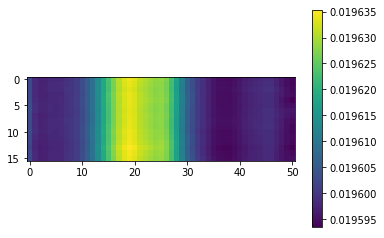

Calculated 20 Batches
Loss 20: 4.034645080566406
08-24 14:08:17


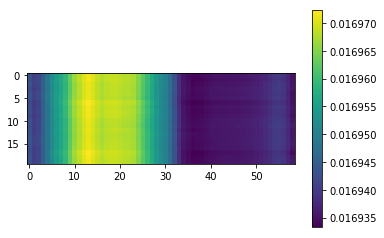

Calculated 30 Batches
Loss 30: 4.045753796895345
08-24 14:08:40


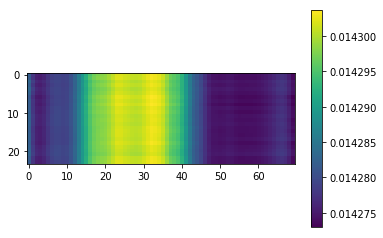

Calculated 40 Batches
Loss 40: 4.067853609720866
08-24 14:09:28


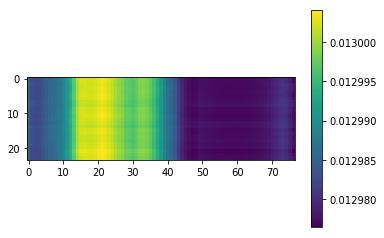

Calculated 50 Batches
Loss 50: 3.971697671072824
08-24 14:10:14


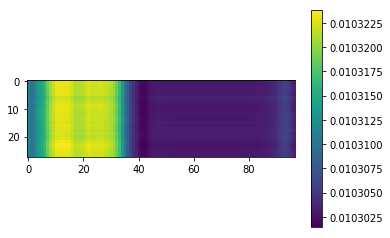

Calculated 60 Batches
Loss 60: 4.115571975708008
08-24 14:11:44


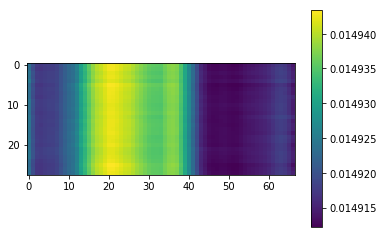

Calculated 70 Batches
Loss 70: 4.105557577950614
08-24 14:13:12


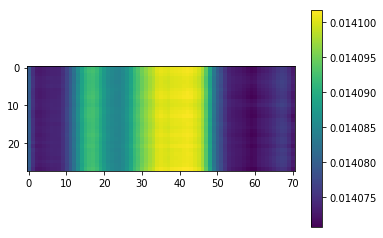

Calculated 80 Batches
Loss 80: 4.066801071166992
08-24 14:14:36


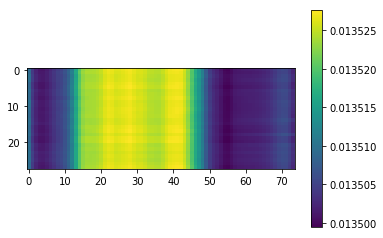

Calculated 90 Batches
Loss 90: 4.0789971351623535
08-24 14:15:57


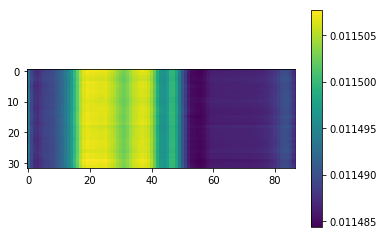

Calculated 100 Batches
Loss 100: 4.158297538757324
08-24 14:17:22


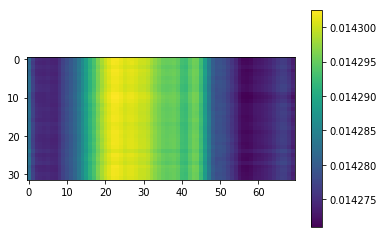

Calculated 110 Batches
Loss 110: 4.094890117645264
08-24 14:18:42


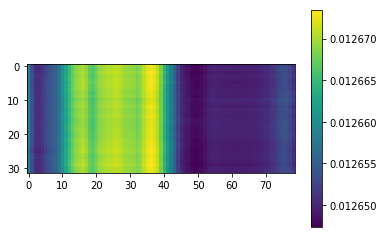

Calculated 120 Batches
Loss 120: 4.144505977630615
08-24 14:20:06


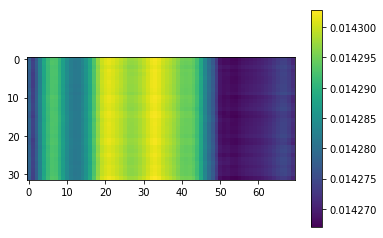

Calculated 130 Batches
Loss 130: 4.126856803894043
08-24 14:21:32


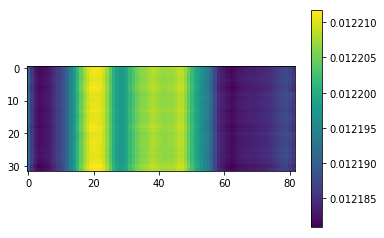

Calculated 140 Batches
Loss 140: 4.123148600260417
08-24 14:22:54


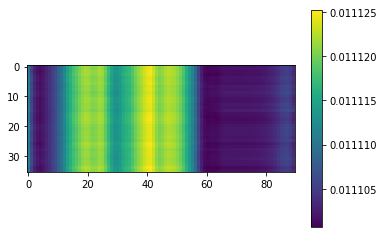

Calculated 150 Batches
Loss 150: 4.094333648681641
08-24 14:24:19


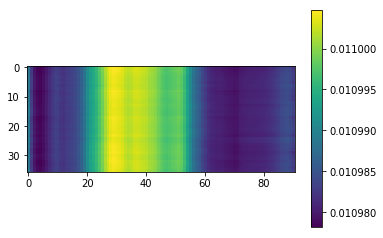

Calculated 160 Batches
Loss 160: 4.097801208496094
08-24 14:25:44


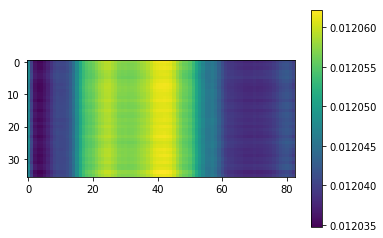

Calculated 170 Batches
Loss 170: 4.107995351155599
08-24 14:27:06


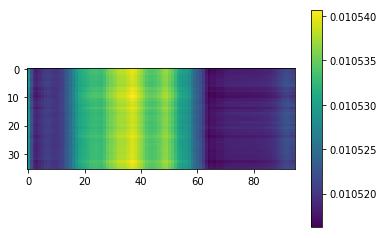

Calculated 180 Batches
Loss 180: 4.075998094346788
08-24 14:28:26


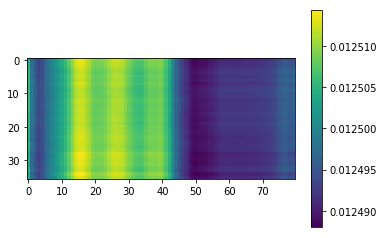

Calculated 190 Batches
Loss 190: 4.064892196655274
08-24 14:29:44


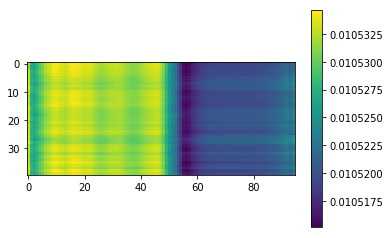

Calculated 200 Batches
Loss 200: 4.0770915985107425
08-24 14:31:04


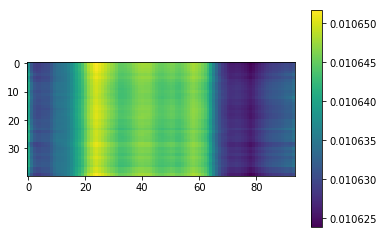

Calculated 210 Batches
Loss 210: 4.018146896362305
08-24 14:32:23


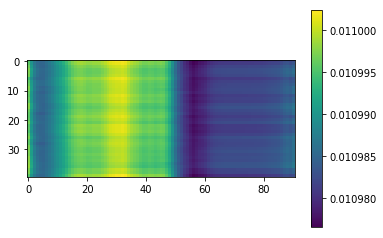

Calculated 220 Batches
Loss 220: 3.9975467681884767
08-24 14:33:41


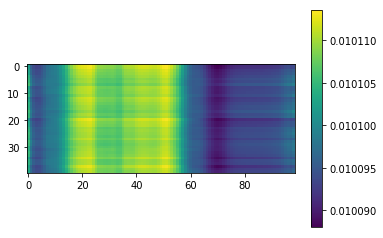

Calculated 230 Batches
Loss 230: 4.020210266113281
08-24 14:35:02


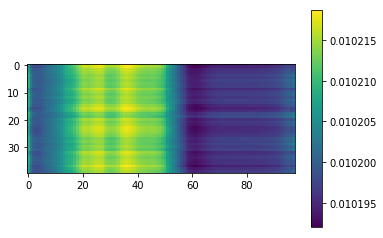

Calculated 240 Batches
Loss 240: 3.9979782104492188
08-24 14:36:22


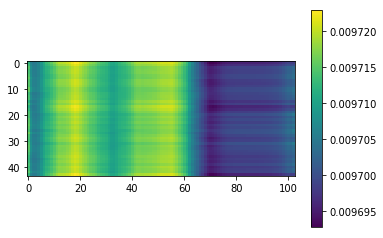

Calculated 250 Batches
Loss 250: 4.037949648770419
08-24 14:37:41


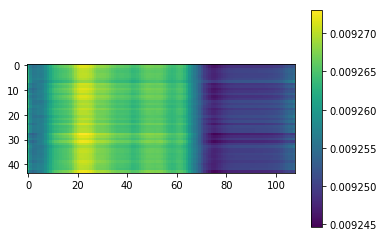

Calculated 260 Batches
Loss 260: 4.005510156804865
08-24 14:39:01


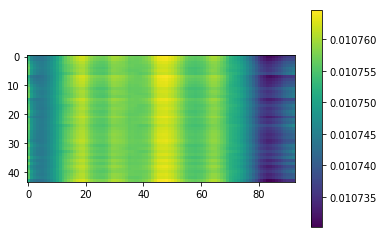

Calculated 270 Batches
Loss 270: 4.000750801780007
08-24 14:40:38


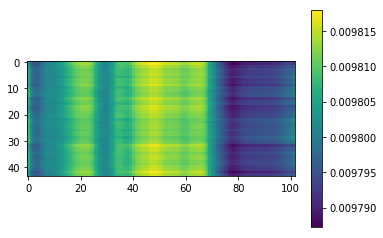

Calculated 280 Batches
Loss 280: 4.043003082275391
08-24 14:41:55


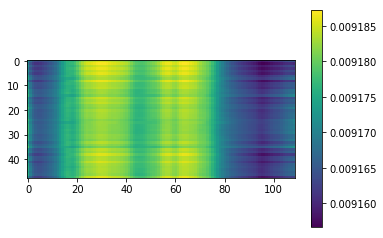

Calculated 290 Batches
Loss 290: 4.003011385599772
08-24 14:43:15


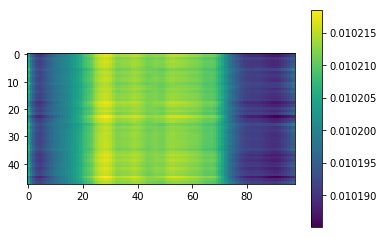

Calculated 300 Batches
Loss 300: 4.010244051615397
08-24 14:44:36


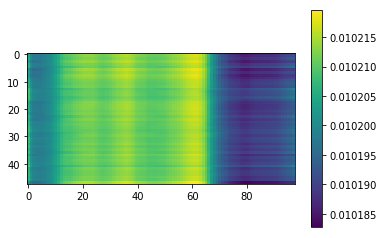

Calculated 310 Batches
Loss 310: 4.011058171590169
08-24 14:45:53


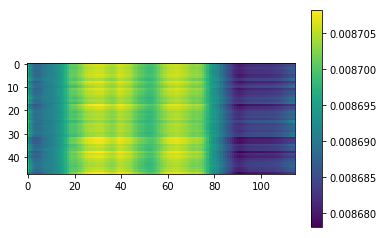

Calculated 320 Batches
Loss 320: 3.997843228853666
08-24 14:47:13


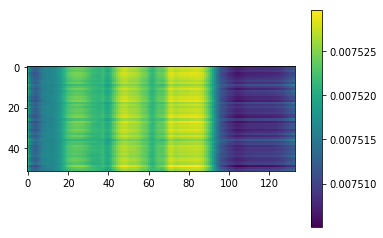

Calculated 330 Batches
Loss 330: 4.0140706575833836
08-24 14:48:34


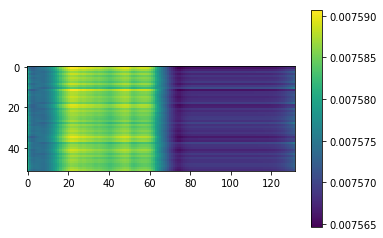

Calculated 340 Batches
Loss 340: 3.876206261771066
08-24 14:50:01


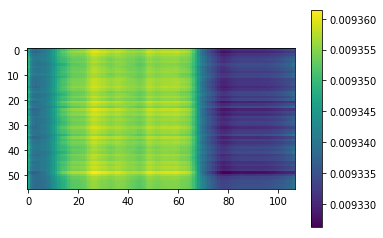

Calculated 350 Batches
Loss 350: 4.009322030203683
08-24 14:51:22


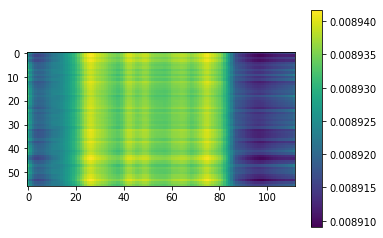

Calculated 360 Batches
Loss 360: 3.799122111002604
08-24 14:52:43


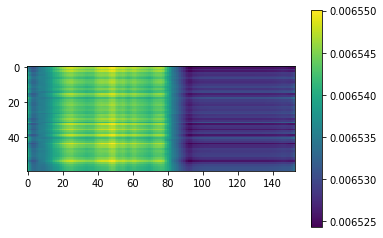

Calculated 370 Batches
Loss 370: 3.9750073750813804
08-24 14:54:05


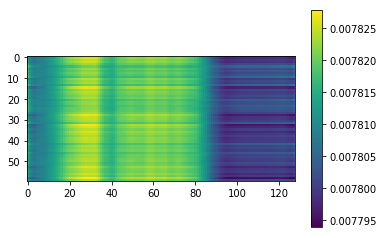

Calculated 380 Batches
Loss 380: 3.9881224632263184
08-24 14:55:35


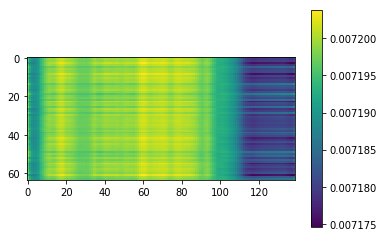

Calculated 390 Batches
Loss 390: 4.014504376579733
08-24 14:57:00


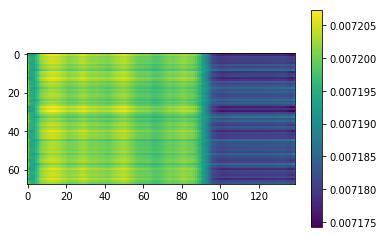

Calculated 400 Batches
Loss 400: 3.8543250344016333
08-24 14:58:24


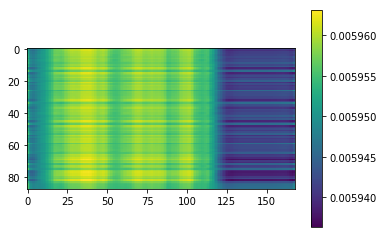

Mean Loss: 4.03523886780063
----------------------------------------------------
08-24 14:58:33
Calculated 10 Batches
Loss 10: 3.745774269104004
08-24 14:58:33


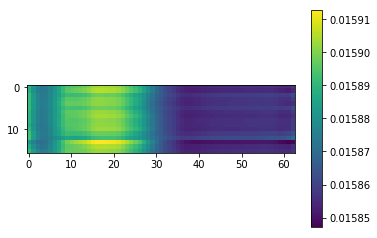

Calculated 20 Batches
Loss 20: 3.8091361999511717
08-24 14:58:34


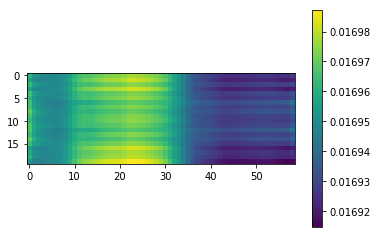

Calculated 30 Batches
Loss 30: 3.8180602391560874
08-24 14:58:35


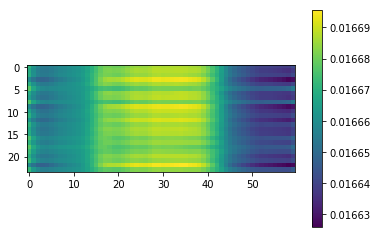

Calculated 40 Batches
Loss 40: 3.8330837885538735
08-24 14:58:36


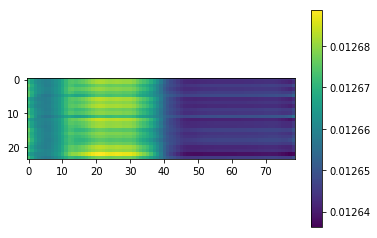

Calculated 50 Batches
Loss 50: 3.832944325038365
08-24 14:58:37


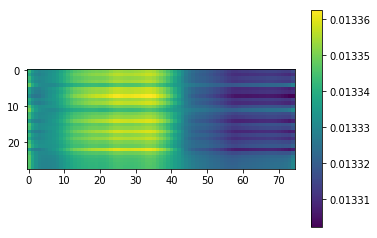

Calculated 60 Batches
Loss 60: 3.8654894147600447
08-24 14:58:39


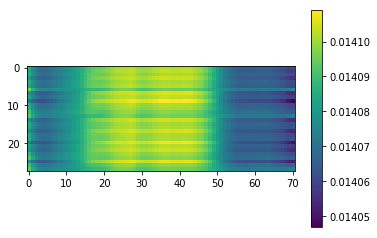

Calculated 70 Batches
Loss 70: 3.8170367649623325
08-24 14:58:40


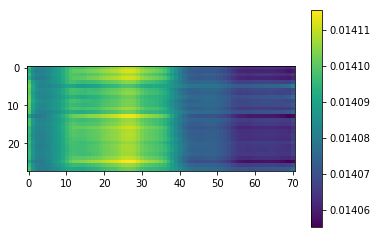

Calculated 80 Batches
Loss 80: 3.8511674063546315
08-24 14:58:41


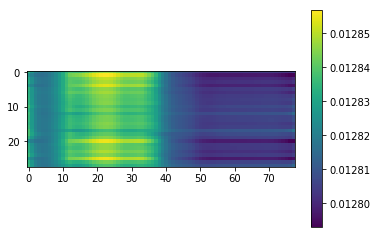

Calculated 90 Batches
Loss 90: 3.912461996078491
08-24 14:58:42


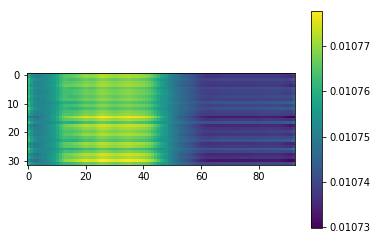

Calculated 100 Batches
Loss 100: 3.8767166137695312
08-24 14:58:44


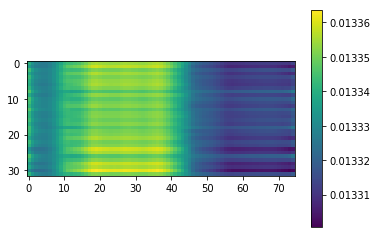

Calculated 110 Batches
Loss 110: 3.879340410232544
08-24 14:58:45


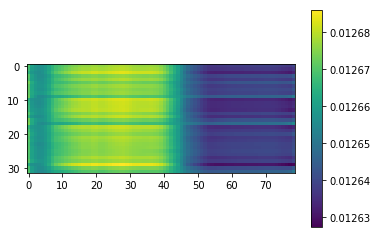

Calculated 120 Batches
Loss 120: 3.9506962299346924
08-24 14:58:47


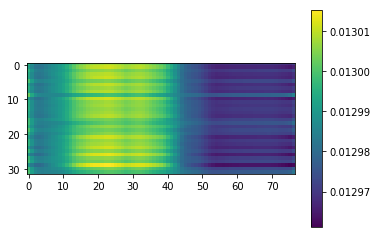

Calculated 130 Batches
Loss 130: 3.877511739730835
08-24 14:58:48


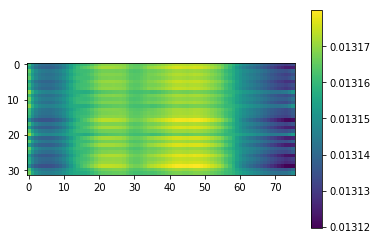

Calculated 140 Batches
Loss 140: 3.8889867994520397
08-24 14:58:50


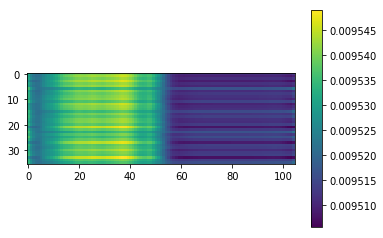

Calculated 150 Batches
Loss 150: 3.8804931640625
08-24 14:58:51


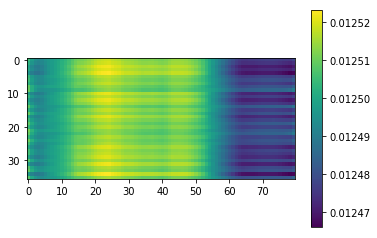

Calculated 160 Batches
Loss 160: 3.8570488823784723
08-24 14:58:53


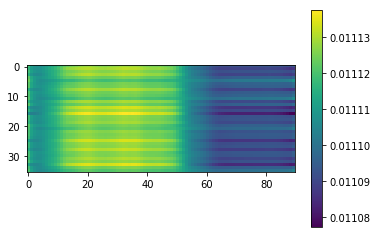

Calculated 170 Batches
Loss 170: 3.8890020582411022
08-24 14:58:55


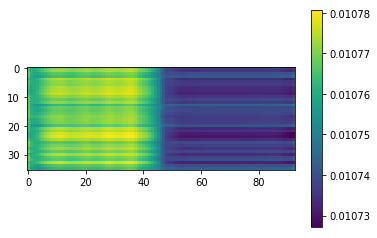

Calculated 180 Batches
Loss 180: 3.8894148932562933
08-24 14:58:56


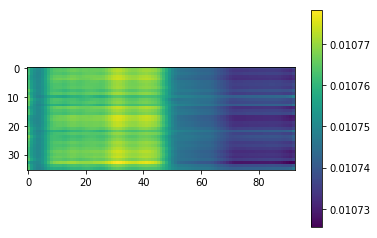

Calculated 190 Batches
Loss 190: 3.961583709716797
08-24 14:58:58


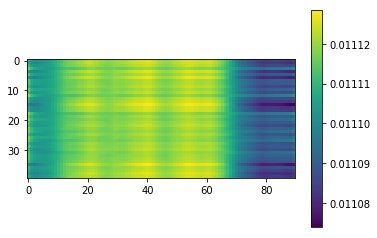

Calculated 200 Batches
Loss 200: 3.9112998962402346
08-24 14:59:00


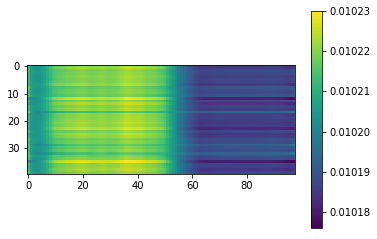

Calculated 210 Batches
Loss 210: 3.886037826538086
08-24 14:59:02


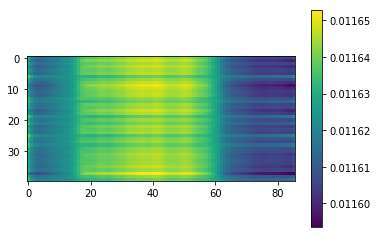

Calculated 220 Batches
Loss 220: 3.9368717193603517
08-24 14:59:04


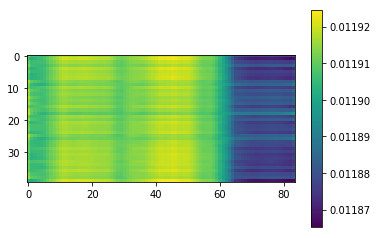

Calculated 230 Batches
Loss 230: 3.901767349243164
08-24 14:59:06


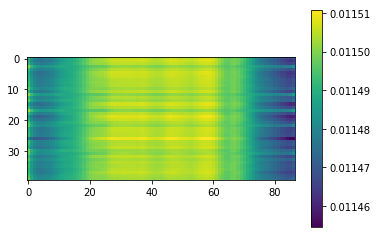

Calculated 240 Batches
Loss 240: 3.9278221130371094
08-24 14:59:08


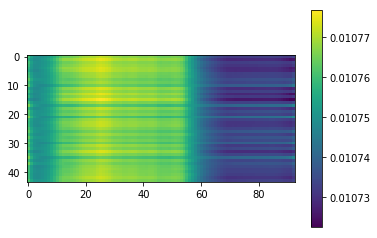

Calculated 250 Batches
Loss 250: 3.9368806318803267
08-24 14:59:10


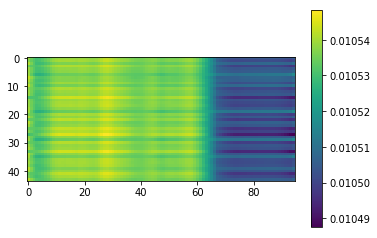

Calculated 260 Batches
Loss 260: 3.9002005837180396
08-24 14:59:12


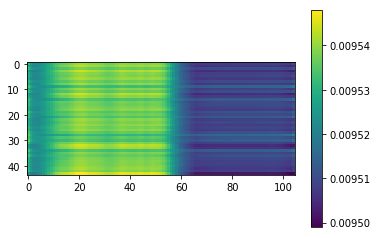

Calculated 270 Batches
Loss 270: 3.9408524253151636
08-24 14:59:14


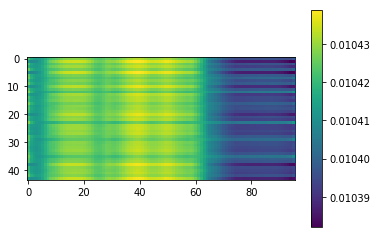

Calculated 280 Batches
Loss 280: 3.9469496409098306
08-24 14:59:16


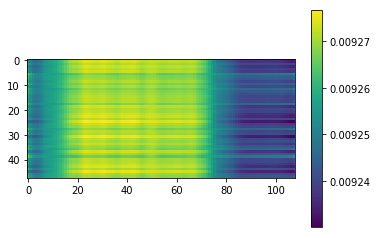

Calculated 290 Batches
Loss 290: 3.9326550165812173
08-24 14:59:18


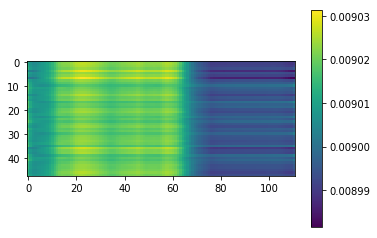

Calculated 300 Batches
Loss 300: 3.929950396219889
08-24 14:59:20


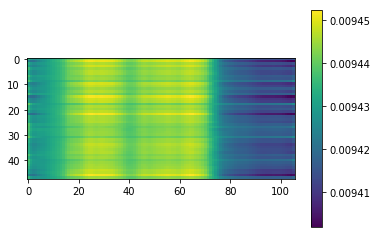

Calculated 310 Batches
Loss 310: 3.9316539764404297
08-24 14:59:22


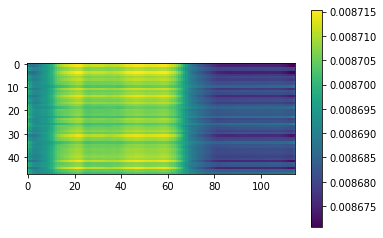

Calculated 320 Batches
Loss 320: 3.9259391197791467
08-24 14:59:25


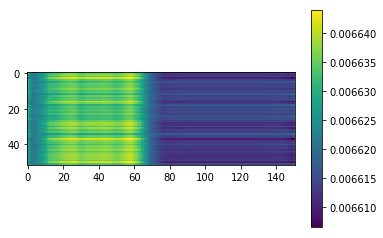

Calculated 330 Batches
Loss 330: 3.9400913531963644
08-24 14:59:28


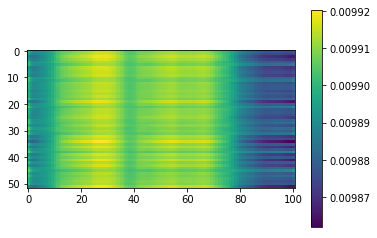

Calculated 340 Batches
Loss 340: 3.814850398472377
08-24 14:59:30


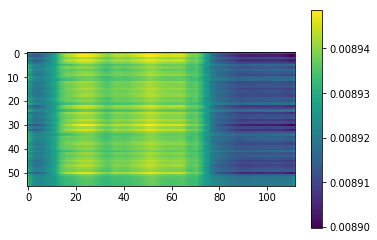

Calculated 350 Batches
Loss 350: 3.957160677228655
08-24 14:59:33


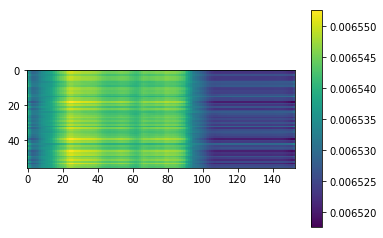

Calculated 360 Batches
Loss 360: 3.753435516357422
08-24 14:59:36


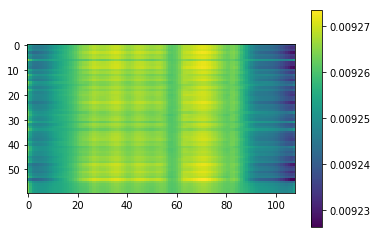

Calculated 370 Batches
Loss 370: 3.9222284952799478
08-24 14:59:39


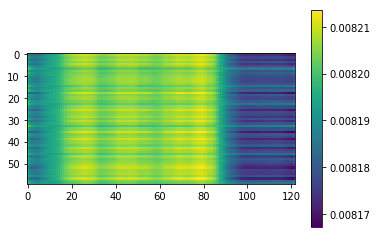

Calculated 380 Batches
Loss 380: 3.9572901725769043
08-24 14:59:42


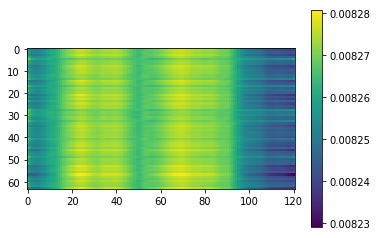

Calculated 390 Batches
Loss 390: 3.989201265222886
08-24 14:59:45


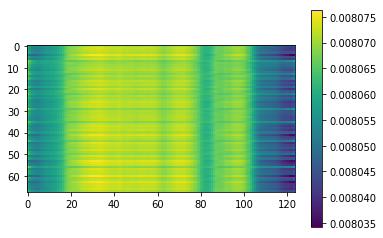

Calculated 400 Batches
Loss 400: 3.8361344770951704
08-24 14:59:49


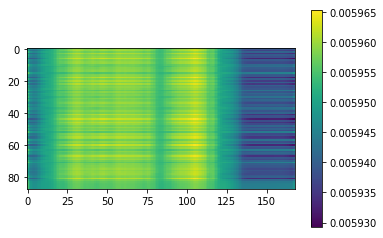

Mean Loss: 3.8933999149148044
----------------------------------------------------
08-24 14:59:51
Calculated 10 Batches
Loss 10: 3.6519031524658203
08-24 14:59:51


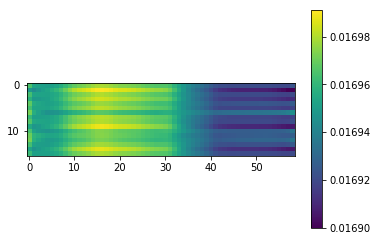

Calculated 20 Batches
Loss 20: 3.833013916015625
08-24 14:59:52


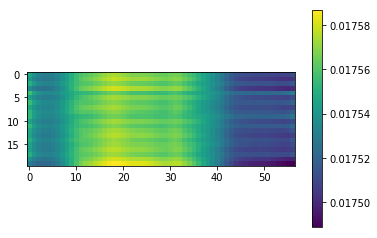

Calculated 30 Batches
Loss 30: 3.8158528010050454
08-24 14:59:53


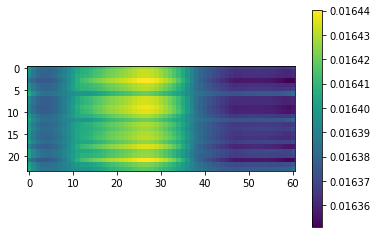

Calculated 40 Batches
Loss 40: 3.8385047912597656
08-24 14:59:54


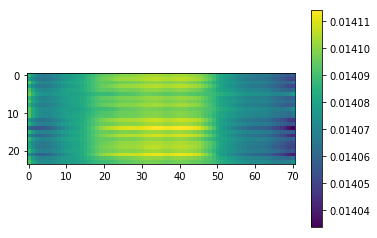

Calculated 50 Batches
Loss 50: 3.7719083513532365
08-24 14:59:55


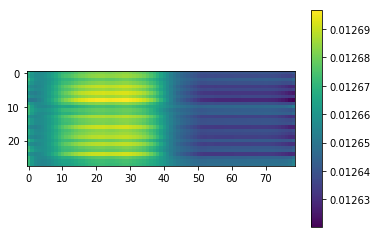

Calculated 60 Batches
Loss 60: 3.7818450927734375
08-24 14:59:57


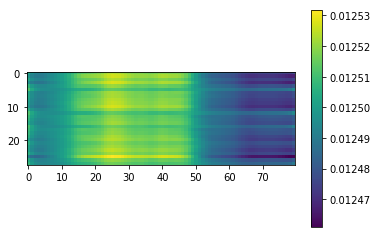

Calculated 70 Batches
Loss 70: 3.909005573817662
08-24 14:59:58


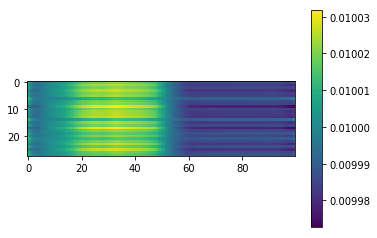

Calculated 80 Batches
Loss 80: 3.8625090462820872
08-24 14:59:59


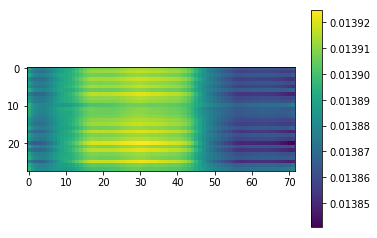

Calculated 90 Batches
Loss 90: 3.8735251426696777
08-24 15:00:01


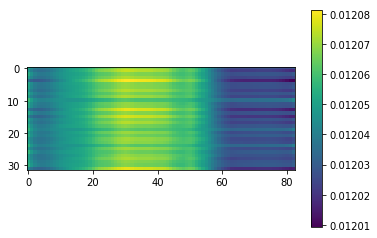

Calculated 100 Batches
Loss 100: 3.8916258811950684
08-24 15:00:02


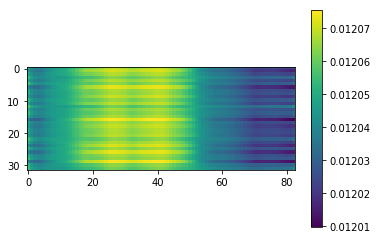

Calculated 110 Batches
Loss 110: 3.8884620666503906
08-24 15:00:04


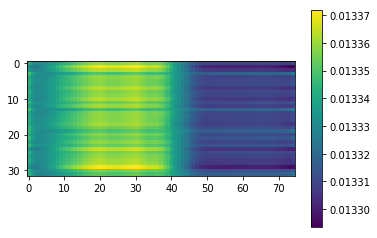

Calculated 120 Batches
Loss 120: 3.9064881801605225
08-24 15:00:05


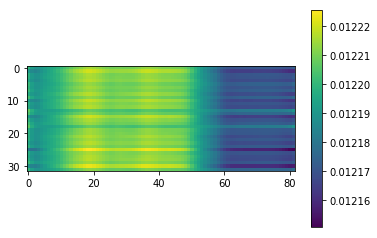

Calculated 130 Batches
Loss 130: 3.8765854835510254
08-24 15:00:07


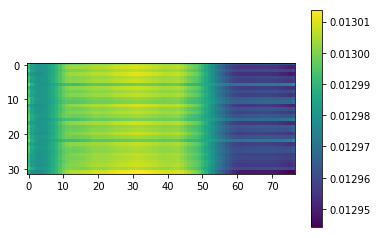

Calculated 140 Batches
Loss 140: 3.876919640435113
08-24 15:00:08


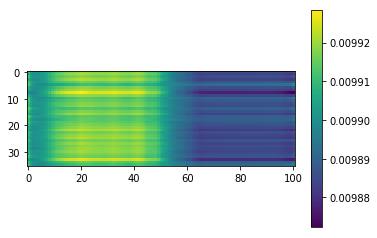

Calculated 150 Batches
Loss 150: 3.8668301900227866
08-24 15:00:10


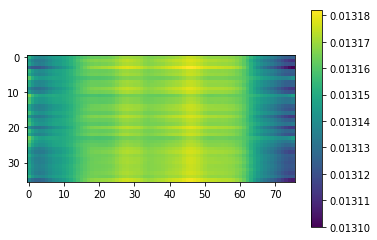

Calculated 160 Batches
Loss 160: 3.8841976589626737
08-24 15:00:12


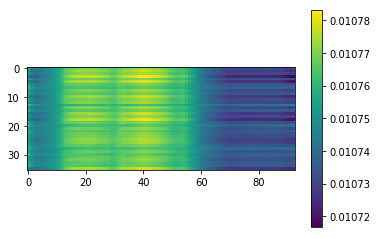

Calculated 170 Batches
Loss 170: 3.873224046495226
08-24 15:00:13


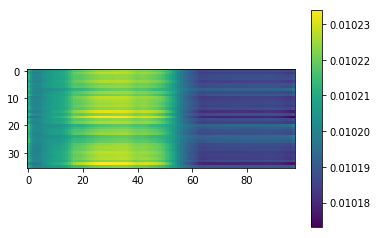

Calculated 180 Batches
Loss 180: 3.9160029093424478
08-24 15:00:15


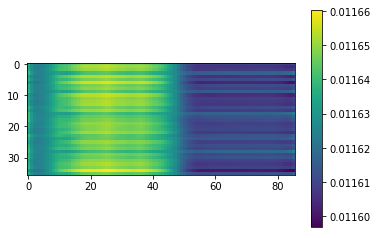

Calculated 190 Batches
Loss 190: 3.8966690063476563
08-24 15:00:17


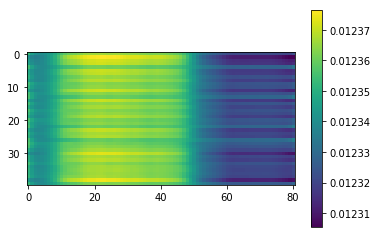

Calculated 200 Batches
Loss 200: 3.8909053802490234
08-24 15:00:19


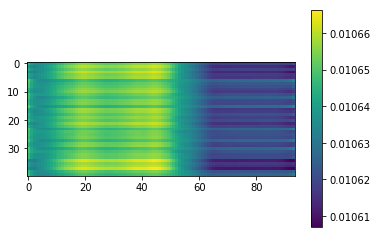

Calculated 210 Batches
Loss 210: 3.8820995330810546
08-24 15:00:21


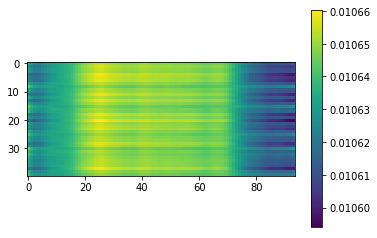

Calculated 220 Batches
Loss 220: 3.897935485839844
08-24 15:00:22


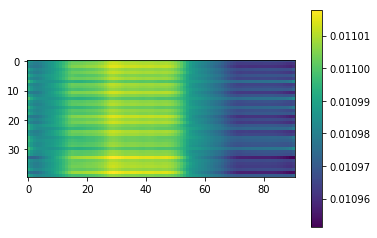

Calculated 230 Batches
Loss 230: 3.933594512939453
08-24 15:00:24


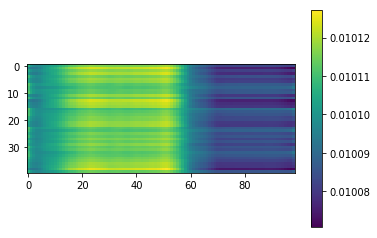

Calculated 240 Batches
Loss 240: 3.883432561700994
08-24 15:00:26


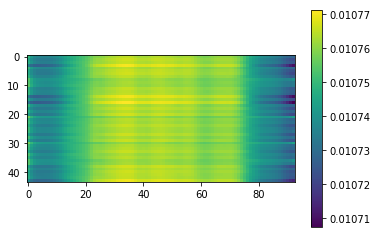

Calculated 250 Batches
Loss 250: 3.944562391801314
08-24 15:00:28


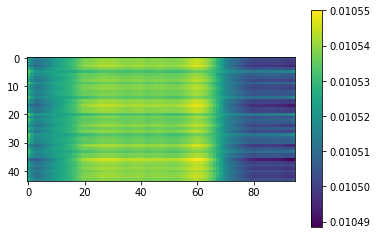

Calculated 260 Batches
Loss 260: 3.942251378839666
08-24 15:00:30


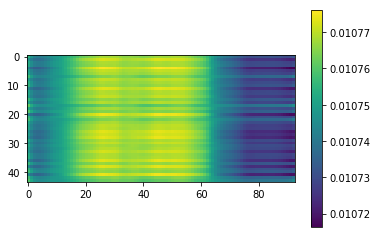

Calculated 270 Batches
Loss 270: 3.91161450472745
08-24 15:00:32


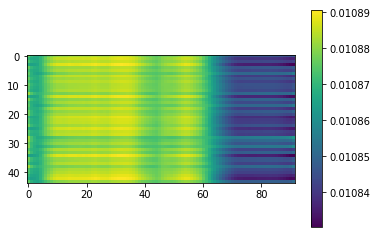

Calculated 280 Batches
Loss 280: 3.951650301615397
08-24 15:00:35


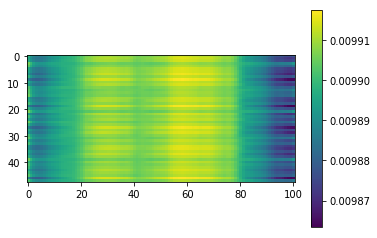

Calculated 290 Batches
Loss 290: 3.925039291381836
08-24 15:00:37


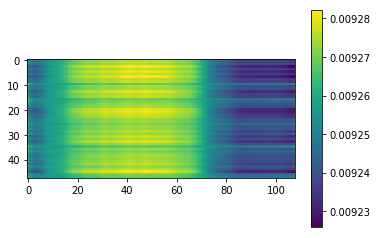

Calculated 300 Batches
Loss 300: 3.917865435282389
08-24 15:00:39


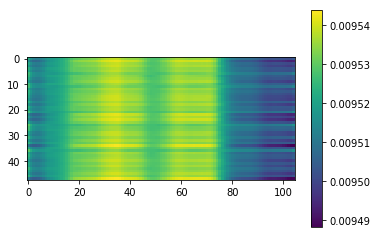

Calculated 310 Batches
Loss 310: 3.955478032430013
08-24 15:00:41


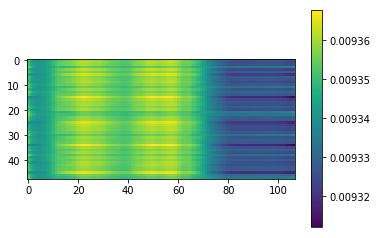

Calculated 320 Batches
Loss 320: 3.913318340594952
08-24 15:00:44


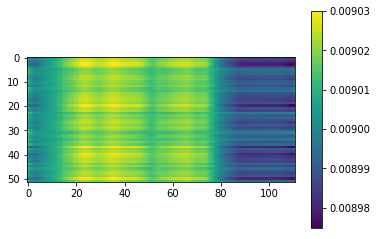

Calculated 330 Batches
Loss 330: 3.942217019888071
08-24 15:00:46


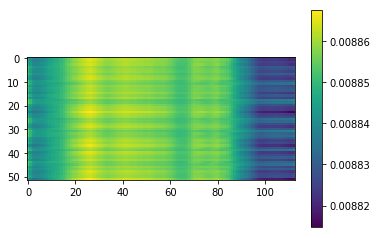

Calculated 340 Batches
Loss 340: 3.8043281010219028
08-24 15:00:49


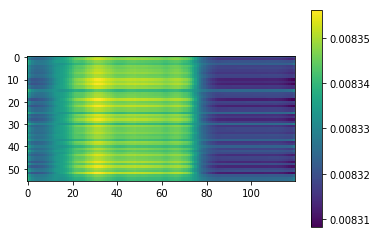

Calculated 350 Batches
Loss 350: 3.9142058236258372
08-24 15:00:52


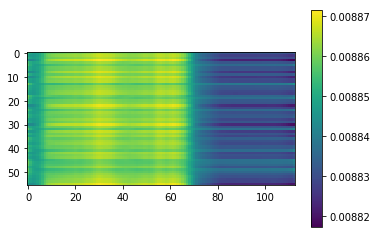

Calculated 360 Batches
Loss 360: 3.825887130478681
08-24 15:00:54


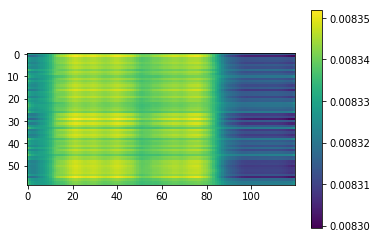

Calculated 370 Batches
Loss 370: 3.972906239827474
08-24 15:00:57


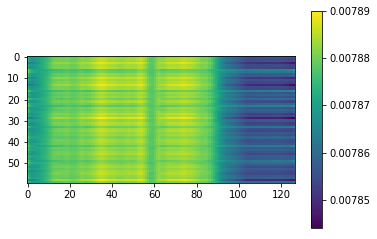

Calculated 380 Batches
Loss 380: 3.954266309738159
08-24 15:01:00


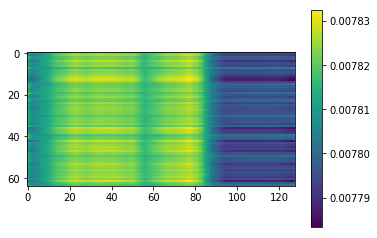

Calculated 390 Batches
Loss 390: 3.9845967012293197
08-24 15:01:03


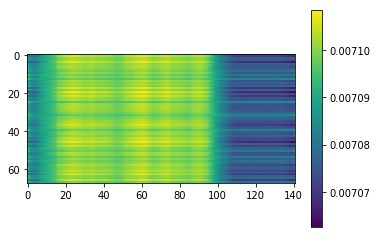

Calculated 400 Batches
Loss 400: 3.8376343467018823
08-24 15:01:07


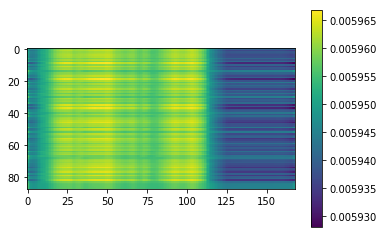

Mean Loss: 3.887346377841056
----------------------------------------------------
08-24 15:01:09
Calculated 10 Batches
Loss 10: 3.748535633087158
08-24 15:01:09


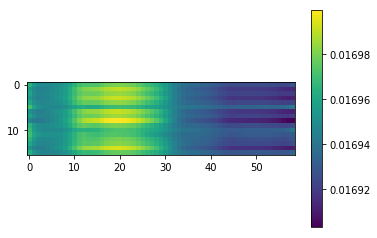

Calculated 20 Batches
Loss 20: 3.803289794921875
08-24 15:01:10


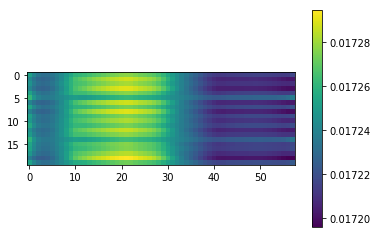

Calculated 30 Batches
Loss 30: 3.859694480895996
08-24 15:01:11


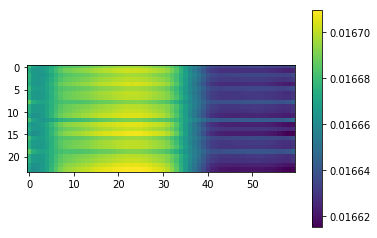

Calculated 40 Batches
Loss 40: 3.894709587097168
08-24 15:01:12


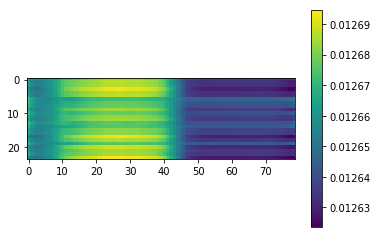

Calculated 50 Batches
Loss 50: 3.730093002319336
08-24 15:01:13


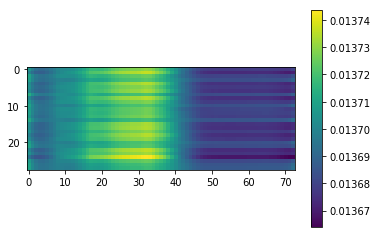

Calculated 60 Batches
Loss 60: 3.846327917916434
08-24 15:01:15


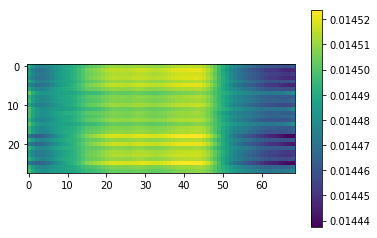

Calculated 70 Batches
Loss 70: 3.8192081451416016
08-24 15:01:16


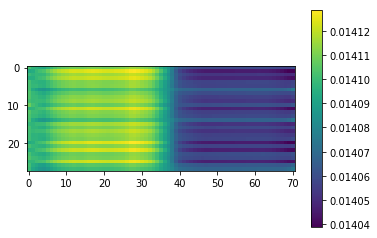

Calculated 80 Batches
Loss 80: 3.8741708483014787
08-24 15:01:18


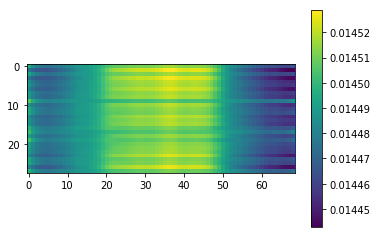

Calculated 90 Batches
Loss 90: 3.9117844104766846
08-24 15:01:19


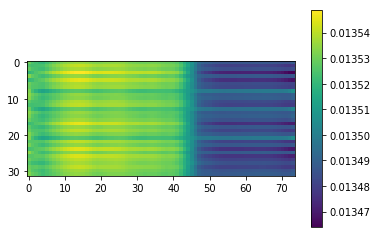

Calculated 100 Batches
Loss 100: 3.8826982975006104
08-24 15:01:20


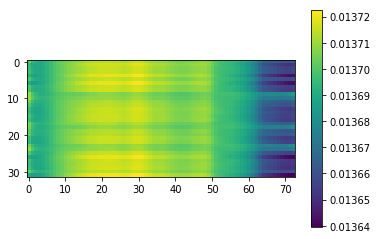

Calculated 110 Batches
Loss 110: 3.8430068492889404
08-24 15:01:22


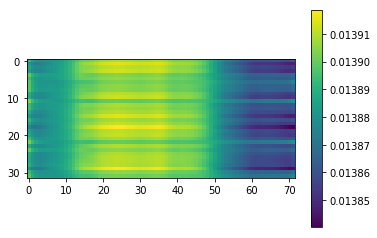

Calculated 120 Batches
Loss 120: 3.8566322326660156
08-24 15:01:23


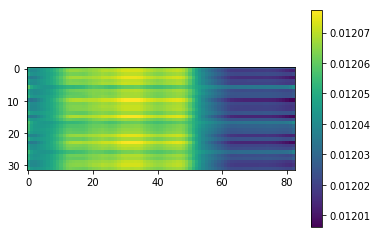

Calculated 130 Batches
Loss 130: 3.8976073265075684
08-24 15:01:25


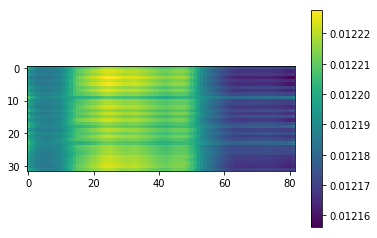

Calculated 140 Batches
Loss 140: 3.9131151835123696
08-24 15:01:26


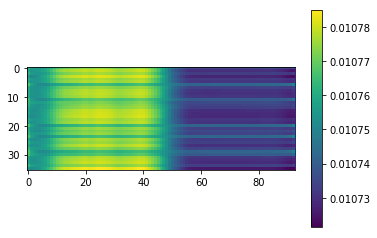

Calculated 150 Batches
Loss 150: 3.9146461486816406
08-24 15:01:28


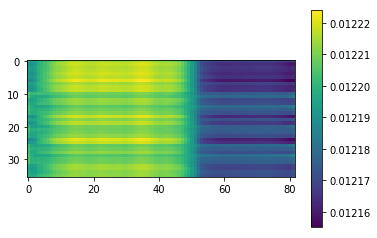

Calculated 160 Batches
Loss 160: 3.8697132534450955
08-24 15:01:30


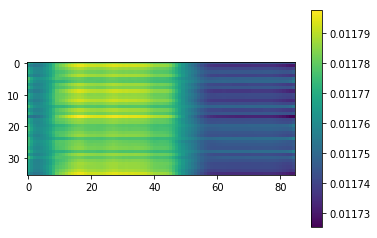

Calculated 170 Batches
Loss 170: 3.9276885986328125
08-24 15:01:31


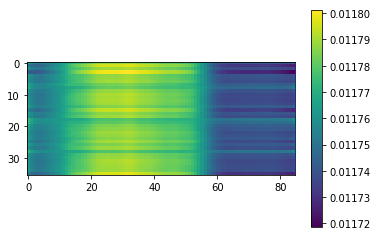

Calculated 180 Batches
Loss 180: 3.884474860297309
08-24 15:01:33


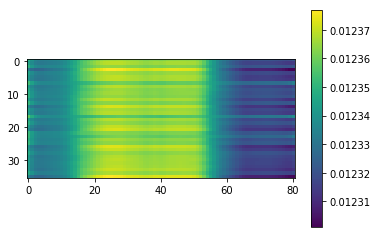

Calculated 190 Batches
Loss 190: 3.9039546966552736
08-24 15:01:35


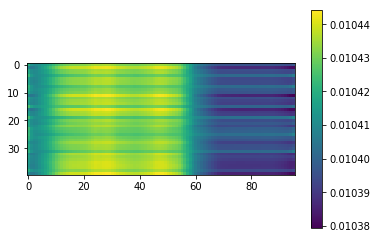

Calculated 200 Batches
Loss 200: 3.8794174194335938
08-24 15:01:37


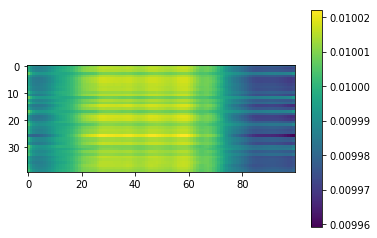

Calculated 210 Batches
Loss 210: 3.9052867889404297
08-24 15:01:38


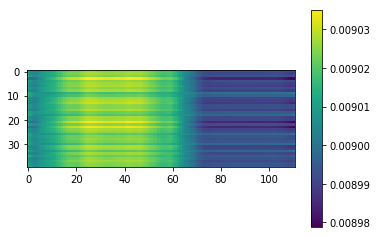

Calculated 220 Batches
Loss 220: 3.9124465942382813
08-24 15:01:40


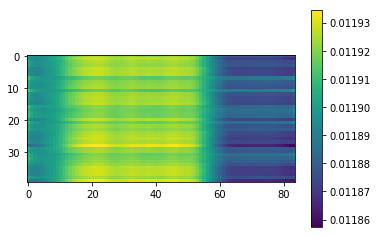

Calculated 230 Batches
Loss 230: 3.9270984649658205
08-24 15:01:42


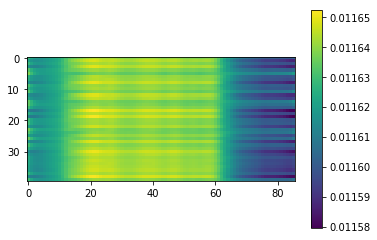

Calculated 240 Batches
Loss 240: 3.9104305614124644
08-24 15:01:44


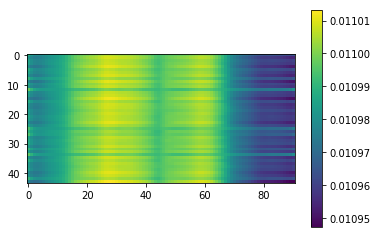

Calculated 250 Batches
Loss 250: 3.9655019586736504
08-24 15:01:46


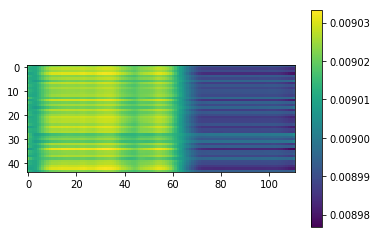

Calculated 260 Batches
Loss 260: 3.9086844704367896
08-24 15:01:48


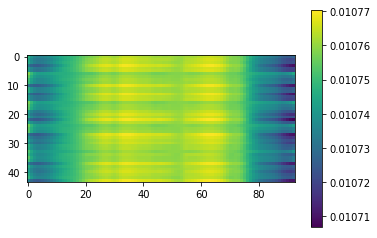

Calculated 270 Batches
Loss 270: 3.910760359330611
08-24 15:01:50


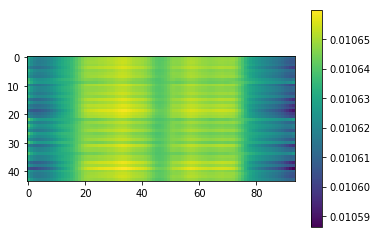

Calculated 280 Batches
Loss 280: 3.9185803731282554
08-24 15:01:53


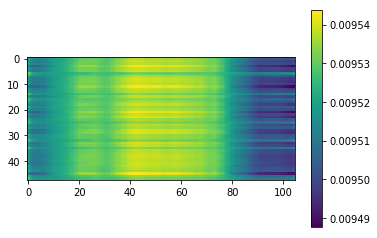

Calculated 290 Batches
Loss 290: 3.9491440455118814
08-24 15:01:55


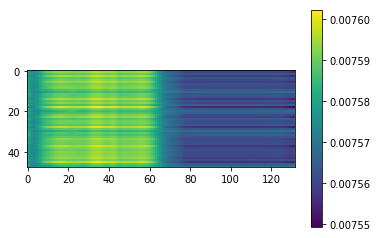

Calculated 300 Batches
Loss 300: 3.905213991800944
08-24 15:01:57


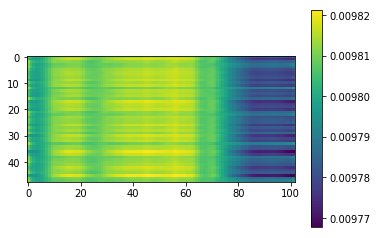

Calculated 310 Batches
Loss 310: 3.934144973754883
08-24 15:01:59


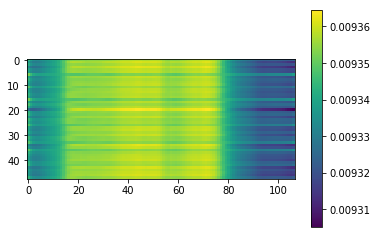

Calculated 320 Batches
Loss 320: 3.9348103449894833
08-24 15:02:02


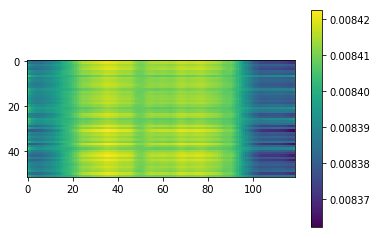

Calculated 330 Batches
Loss 330: 3.9484517024113583
08-24 15:02:04


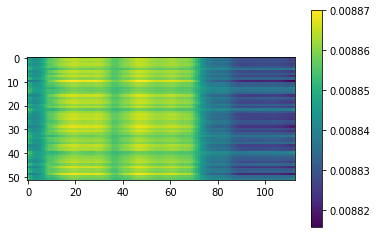

Calculated 340 Batches
Loss 340: 3.797694069998605
08-24 15:02:07


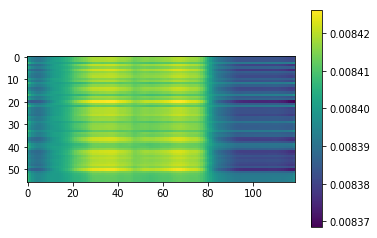

Calculated 350 Batches
Loss 350: 3.977724347795759
08-24 15:02:09


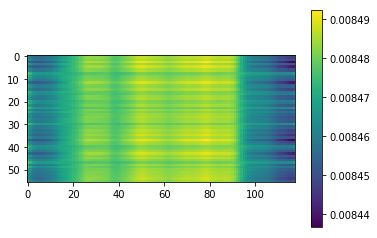

Calculated 360 Batches
Loss 360: 3.8304451118081304
08-24 15:02:12


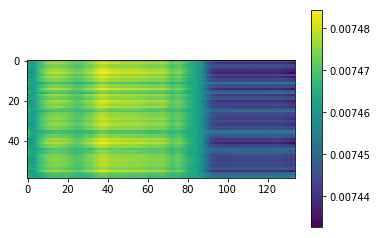

Calculated 370 Batches
Loss 370: 3.9324668884277343
08-24 15:02:15


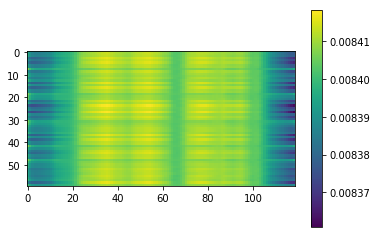

Calculated 380 Batches
Loss 380: 3.974238872528076
08-24 15:02:18


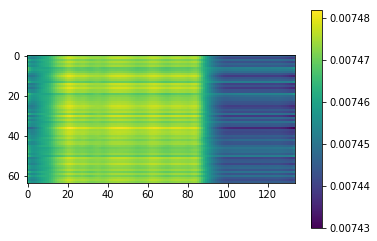

Calculated 390 Batches
Loss 390: 3.9726975384880516
08-24 15:02:21


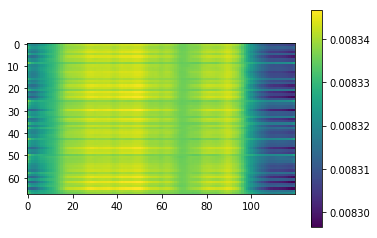

Calculated 400 Batches
Loss 400: 3.8335574756969106
08-24 15:02:25


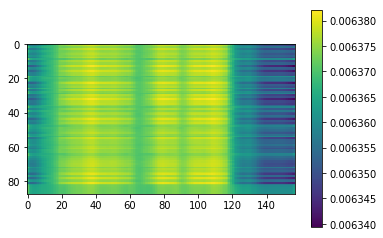

Mean Loss: 3.8861833055349284
----------------------------------------------------
08-24 15:02:26
Calculated 10 Batches
Loss 10: 3.779200553894043
08-24 15:02:27


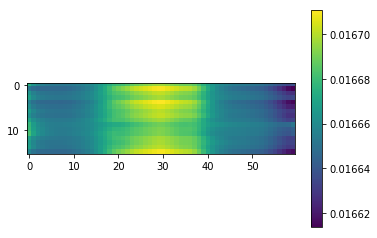

Calculated 20 Batches
Loss 20: 3.809778594970703
08-24 15:02:28


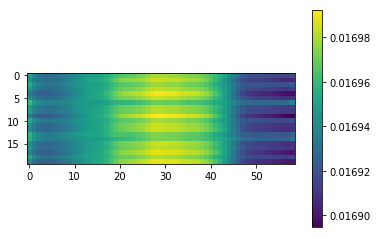

Calculated 30 Batches
Loss 30: 3.899433453877767
08-24 15:02:29


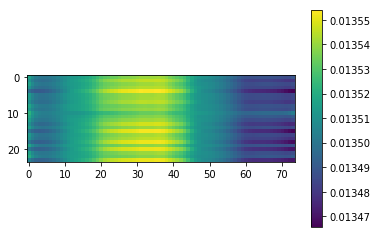

Calculated 40 Batches
Loss 40: 3.8653443654378257
08-24 15:02:30


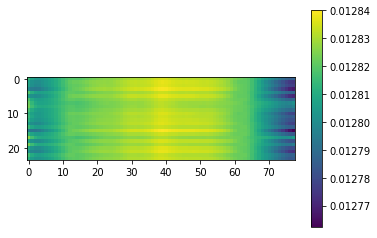

Calculated 50 Batches
Loss 50: 3.765489305768694
08-24 15:02:31


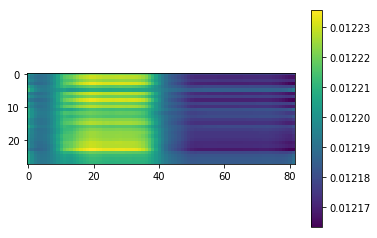

Calculated 60 Batches
Loss 60: 3.918536594935826
08-24 15:02:33


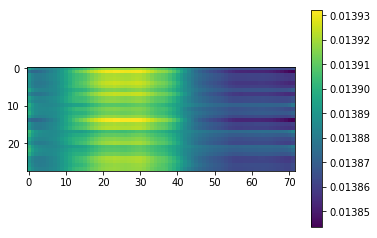

Calculated 70 Batches
Loss 70: 3.8615095955984935
08-24 15:02:34


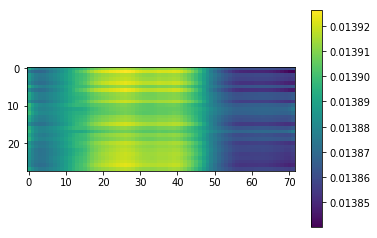

Calculated 80 Batches
Loss 80: 3.812790189470564
08-24 15:02:35


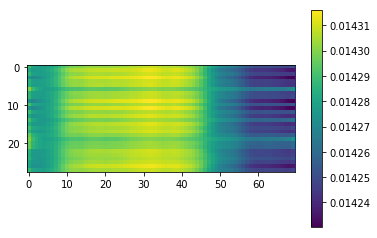

Calculated 90 Batches
Loss 90: 3.8682570457458496
08-24 15:02:37


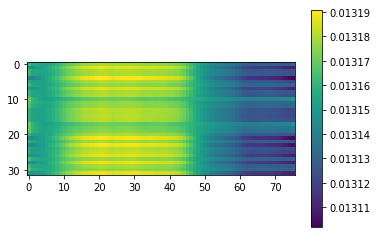

Calculated 100 Batches
Loss 100: 3.868502378463745
08-24 15:02:38


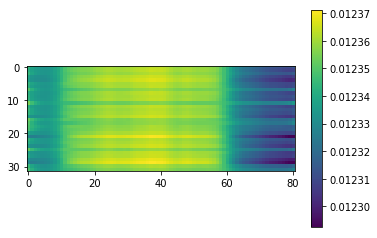

Calculated 110 Batches
Loss 110: 3.879089593887329
08-24 15:02:40


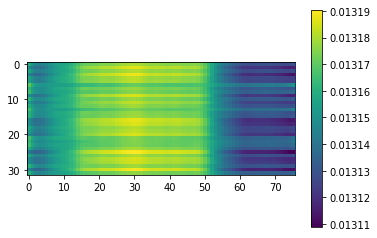

Calculated 120 Batches
Loss 120: 3.8800203800201416
08-24 15:02:41


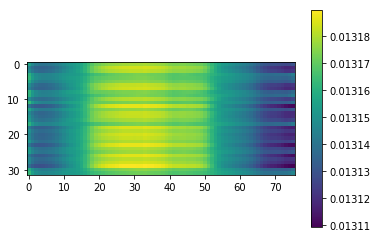

Calculated 130 Batches
Loss 130: 3.840113639831543
08-24 15:02:42


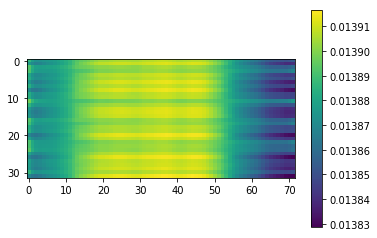

Calculated 140 Batches
Loss 140: 3.855269538031684
08-24 15:02:44


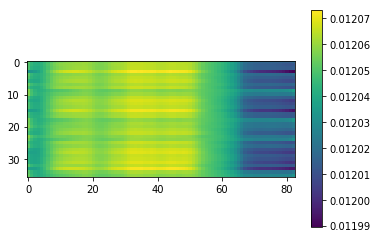

Calculated 150 Batches
Loss 150: 3.934769948323568
08-24 15:02:46


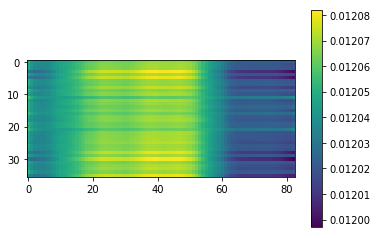

Calculated 160 Batches
Loss 160: 3.851843516031901
08-24 15:02:47


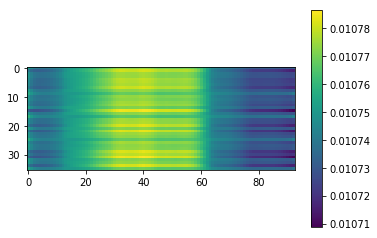

Calculated 170 Batches
Loss 170: 3.913537767198351
08-24 15:02:49


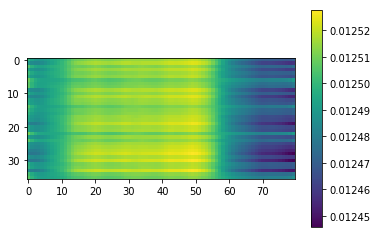

Calculated 180 Batches
Loss 180: 3.8894466824001737
08-24 15:02:51


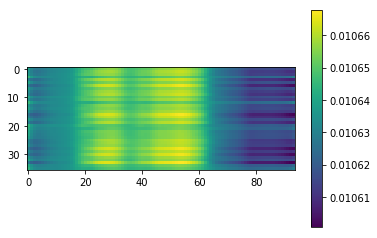

Calculated 190 Batches
Loss 190: 3.8434494018554686
08-24 15:02:53


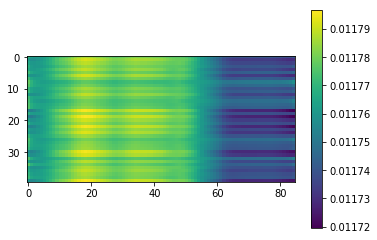

Calculated 200 Batches
Loss 200: 3.939483642578125
08-24 15:02:55


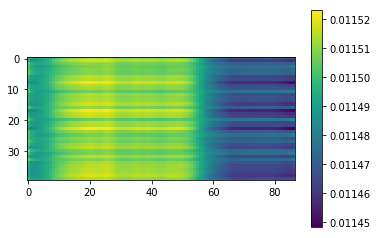

Calculated 210 Batches
Loss 210: 3.9155948638916014
08-24 15:02:56


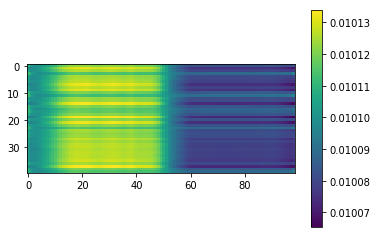

Calculated 220 Batches
Loss 220: 3.9000648498535155
08-24 15:02:58


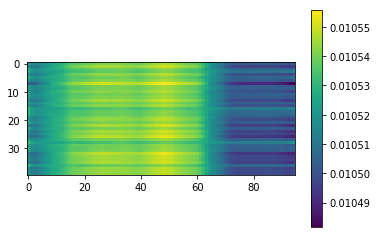

Calculated 230 Batches
Loss 230: 3.913911056518555
08-24 15:03:00


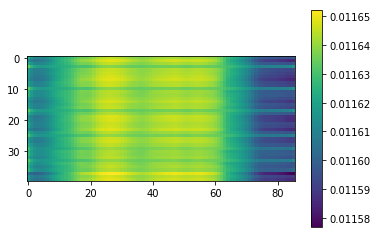

Calculated 240 Batches
Loss 240: 3.911208066073331
08-24 15:03:02


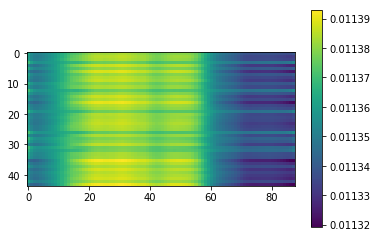

Calculated 250 Batches
Loss 250: 3.9014629017223013
08-24 15:03:04


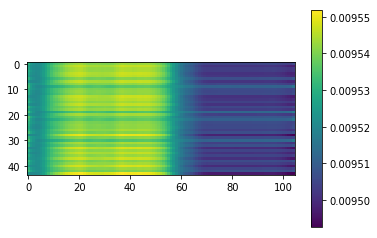

Calculated 260 Batches
Loss 260: 3.9389083168723364
08-24 15:03:06


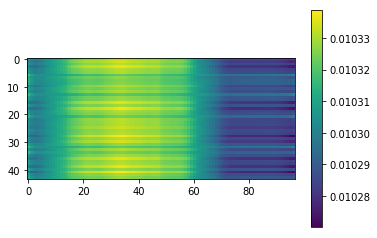

Calculated 270 Batches
Loss 270: 3.904526797207919
08-24 15:03:08


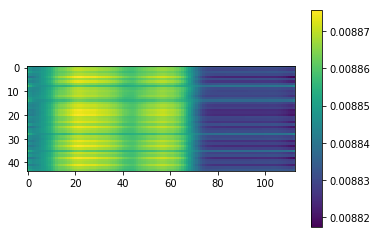

Calculated 280 Batches
Loss 280: 3.9715118408203125
08-24 15:03:10


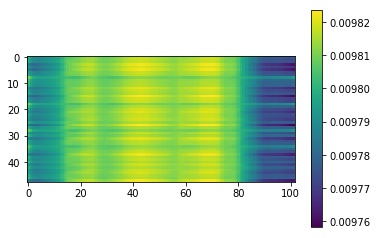

Calculated 290 Batches
Loss 290: 3.9003190994262695
08-24 15:03:13


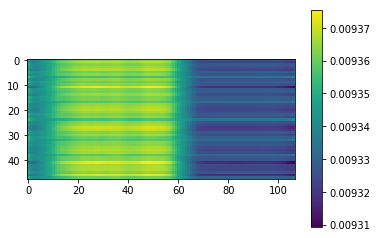

Calculated 300 Batches
Loss 300: 3.9461965560913086
08-24 15:03:15


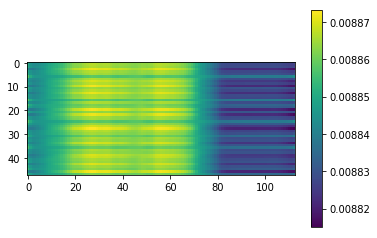

Calculated 310 Batches
Loss 310: 3.929856618245443
08-24 15:03:17


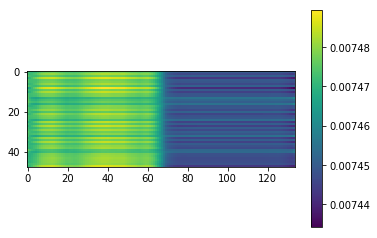

Calculated 320 Batches
Loss 320: 3.93142817570613
08-24 15:03:19


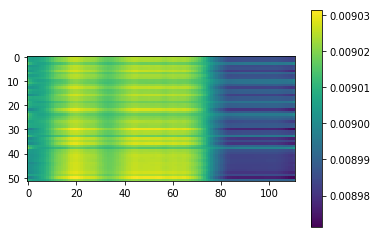

Calculated 330 Batches
Loss 330: 3.9418549170860877
08-24 15:03:22


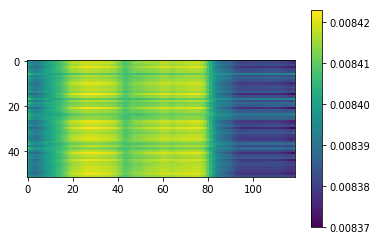

Calculated 340 Batches
Loss 340: 3.80548095703125
08-24 15:03:24


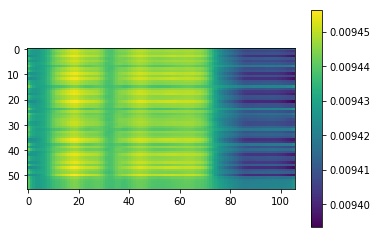

Calculated 350 Batches
Loss 350: 3.950932366507394
08-24 15:03:27


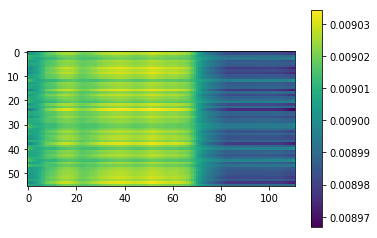

Calculated 360 Batches
Loss 360: 3.795196533203125
08-24 15:03:30


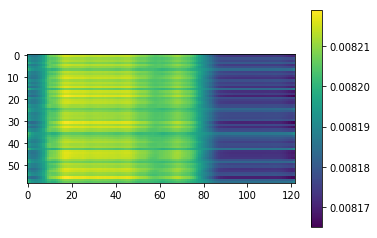

Calculated 370 Batches
Loss 370: 3.915424346923828
08-24 15:03:33


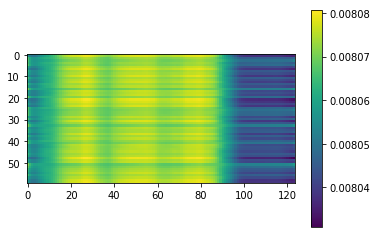

Calculated 380 Batches
Loss 380: 3.9622206687927246
08-24 15:03:36


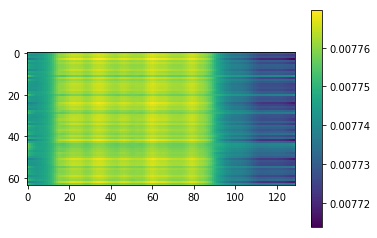

Calculated 390 Batches
Loss 390: 3.958588544060202
08-24 15:03:39


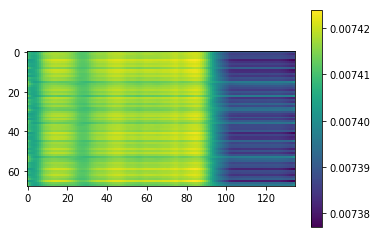

Calculated 400 Batches
Loss 400: 3.828902157870206
08-24 15:03:43


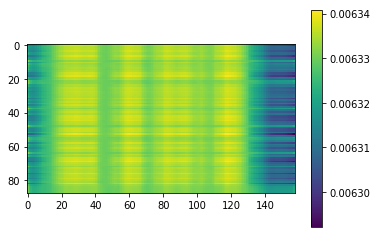

Mean Loss: 3.8837607460883654
----------------------------------------------------
08-24 15:03:44
Calculated 10 Batches
Loss 10: 3.817223310470581
08-24 15:03:45


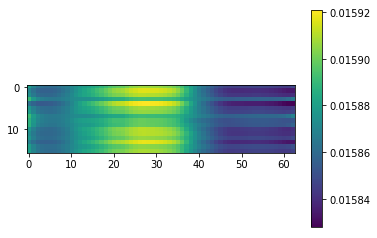

Calculated 20 Batches
Loss 20: 3.8195995330810546
08-24 15:03:46


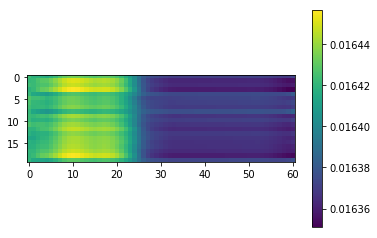

Calculated 30 Batches
Loss 30: 3.844203313191732
08-24 15:03:47


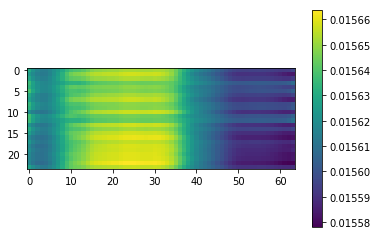

Calculated 40 Batches
Loss 40: 3.8437623977661133
08-24 15:03:48


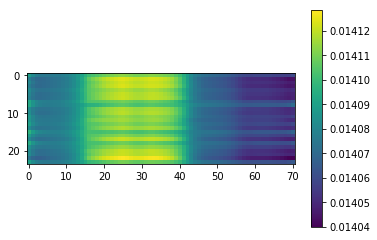

Calculated 50 Batches
Loss 50: 3.6877762930733815
08-24 15:03:49


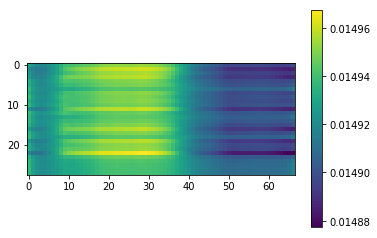

Calculated 60 Batches
Loss 60: 3.8505848475864957
08-24 15:03:50


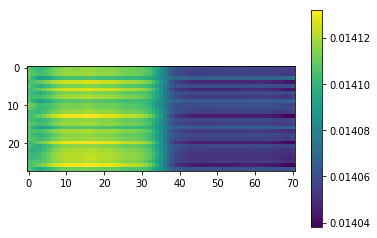

Calculated 70 Batches
Loss 70: 3.8530943734305247
08-24 15:03:52


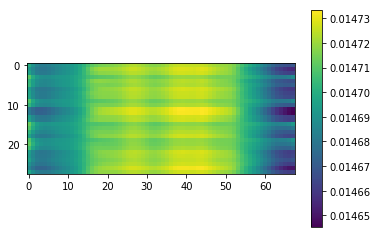

Calculated 80 Batches
Loss 80: 3.84097535269601
08-24 15:03:53


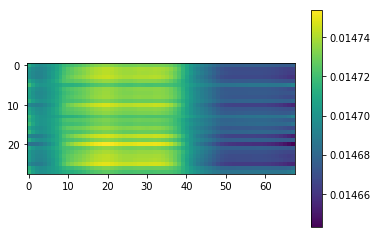

Calculated 90 Batches
Loss 90: 3.866605043411255
08-24 15:03:54


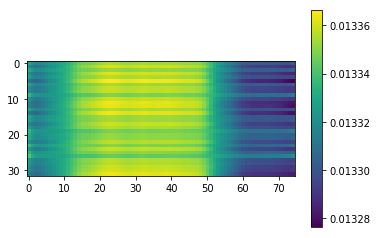

Calculated 100 Batches
Loss 100: 3.860778331756592
08-24 15:03:56


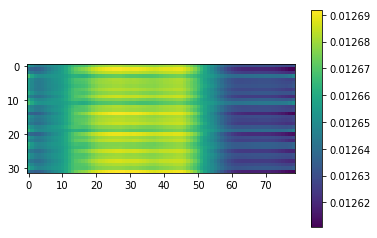

Calculated 110 Batches
Loss 110: 3.86942720413208
08-24 15:03:57


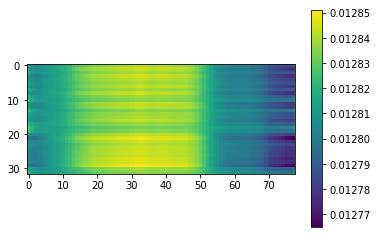

Calculated 120 Batches
Loss 120: 3.892984628677368
08-24 15:03:59


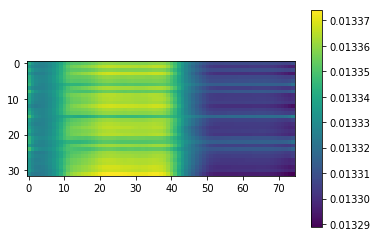

Calculated 130 Batches
Loss 130: 3.867568016052246
08-24 15:04:00


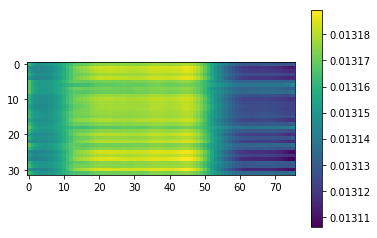

Calculated 140 Batches
Loss 140: 3.8712145487467446
08-24 15:04:02


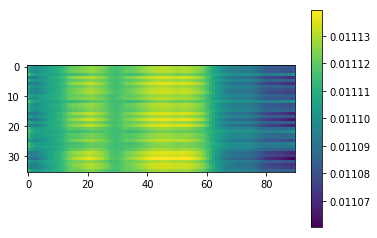

Calculated 150 Batches
Loss 150: 3.8753975762261286
08-24 15:04:03


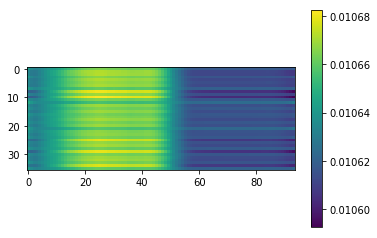

Calculated 160 Batches
Loss 160: 3.883700476752387
08-24 15:04:05


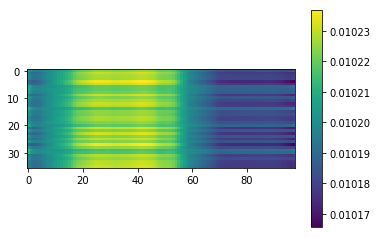

Calculated 170 Batches
Loss 170: 3.853806813557943
08-24 15:04:07


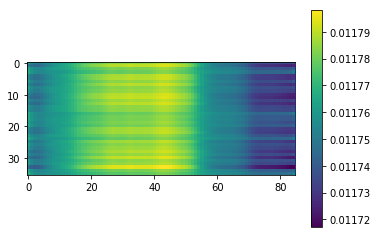

Calculated 180 Batches
Loss 180: 3.87314690483941
08-24 15:04:09


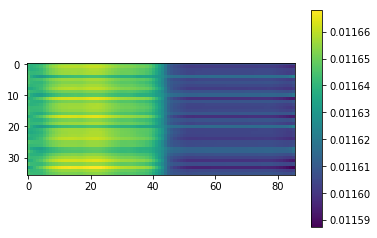

Calculated 190 Batches
Loss 190: 3.9125648498535157
08-24 15:04:11


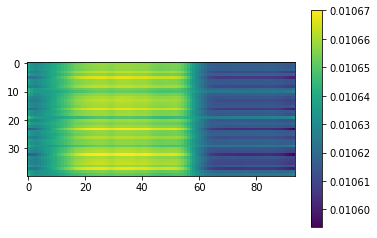

Calculated 200 Batches
Loss 200: 3.8915641784667967
08-24 15:04:12


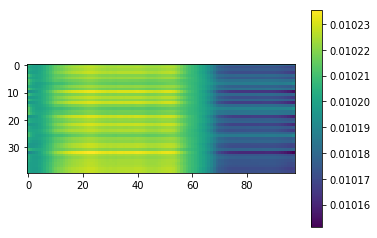

Calculated 210 Batches
Loss 210: 3.880101776123047
08-24 15:04:14


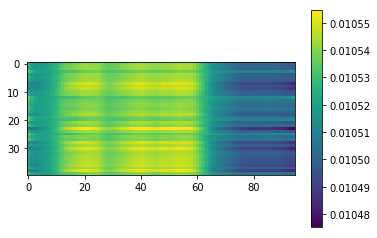

Calculated 220 Batches
Loss 220: 3.9534019470214843
08-24 15:04:16


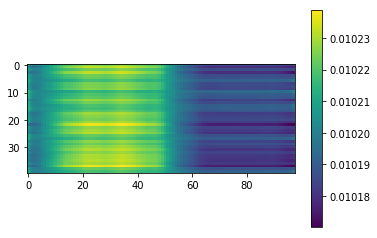

Calculated 230 Batches
Loss 230: 3.9204612731933595
08-24 15:04:18


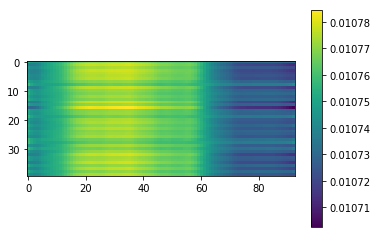

Calculated 240 Batches
Loss 240: 3.9154253872958096
08-24 15:04:20


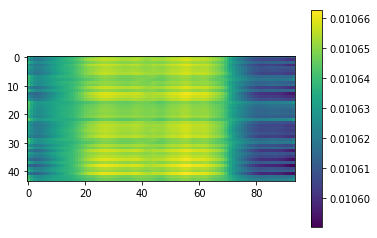

Calculated 250 Batches
Loss 250: 3.9242897033691406
08-24 15:04:22


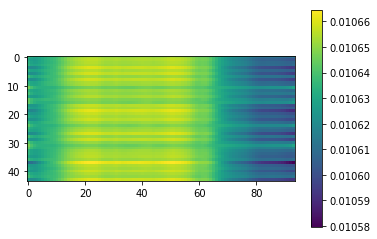

Calculated 260 Batches
Loss 260: 3.938849015669389
08-24 15:04:24


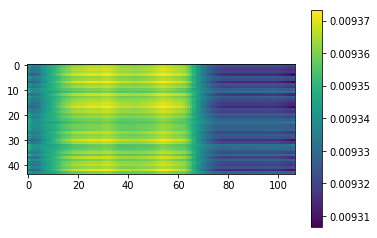

Calculated 270 Batches
Loss 270: 3.884638699618253
08-24 15:04:26


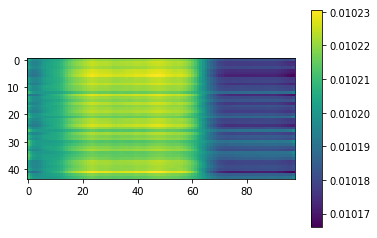

Calculated 280 Batches
Loss 280: 3.935153007507324
08-24 15:04:28


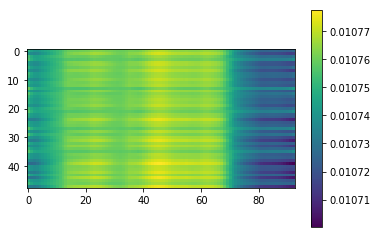

Calculated 290 Batches
Loss 290: 3.8957672119140625
08-24 15:04:30


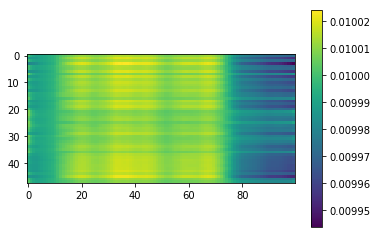

Calculated 300 Batches
Loss 300: 3.939428965250651
08-24 15:04:33


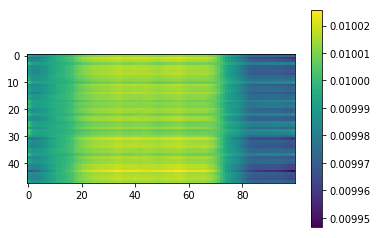

Calculated 310 Batches
Loss 310: 3.8976866404215493
08-24 15:04:35


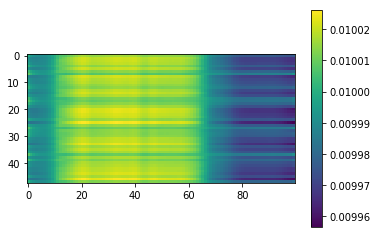

Calculated 320 Batches
Loss 320: 3.921826876126803
08-24 15:04:37


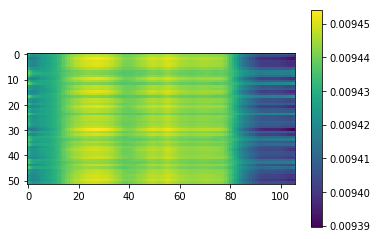

Calculated 330 Batches
Loss 330: 3.9146672762357273
08-24 15:04:40


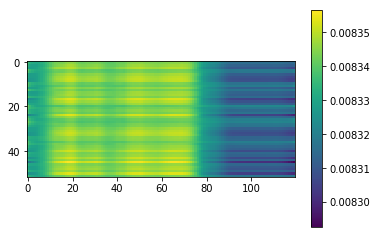

Calculated 340 Batches
Loss 340: 3.800973892211914
08-24 15:04:42


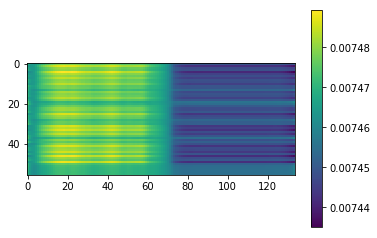

Calculated 350 Batches
Loss 350: 3.9652955191476003
08-24 15:04:45


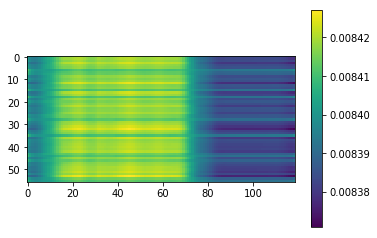

Calculated 360 Batches
Loss 360: 3.749401346842448
08-24 15:04:48


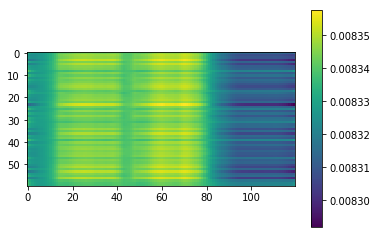

Calculated 370 Batches
Loss 370: 3.9541112263997396
08-24 15:04:50


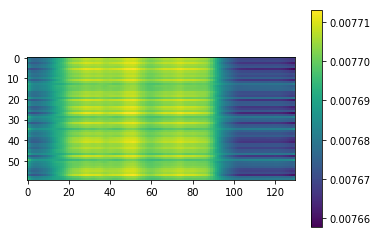

Calculated 380 Batches
Loss 380: 3.958895683288574
08-24 15:04:53


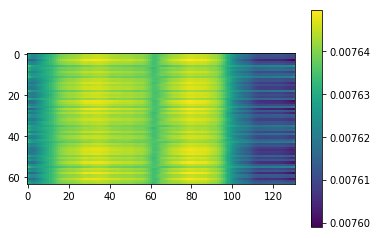

Calculated 390 Batches
Loss 390: 3.9759575338924633
08-24 15:04:57


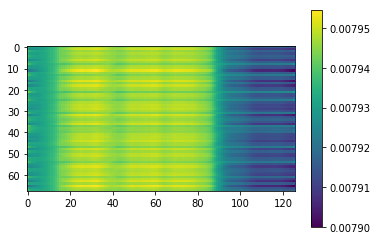

Calculated 400 Batches
Loss 400: 3.844641598788175
08-24 15:05:01


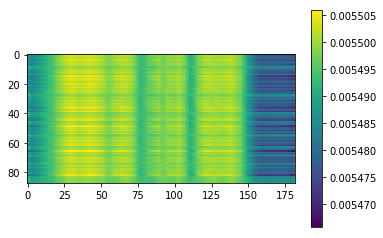

Mean Loss: 3.88218147422729
----------------------------------------------------
08-24 15:05:02
Calculated 10 Batches
Loss 10: 3.787508487701416
08-24 15:05:02


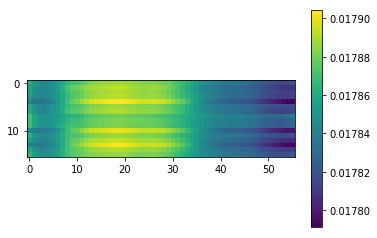

Calculated 20 Batches
Loss 20: 3.8375736236572267
08-24 15:05:03


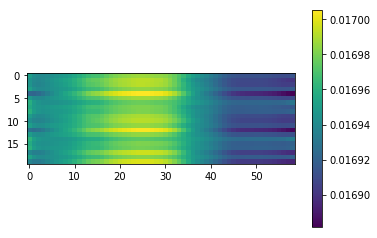

Calculated 30 Batches
Loss 30: 3.8213980992635093
08-24 15:05:04


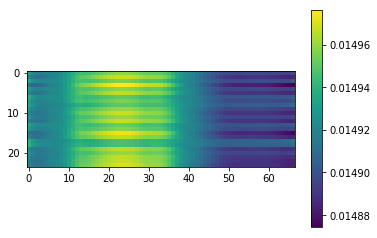

Calculated 40 Batches
Loss 40: 3.8560765584309897
08-24 15:05:05


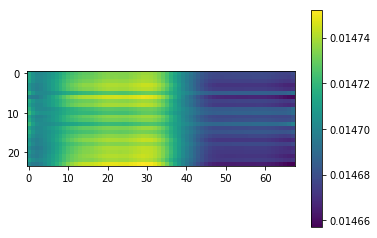

Calculated 50 Batches
Loss 50: 3.7490340641566684
08-24 15:05:07


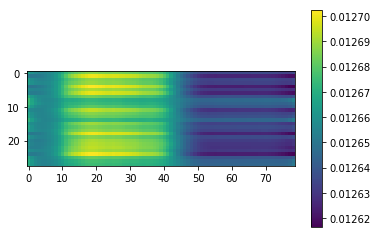

Calculated 60 Batches
Loss 60: 3.851513998849051
08-24 15:05:08


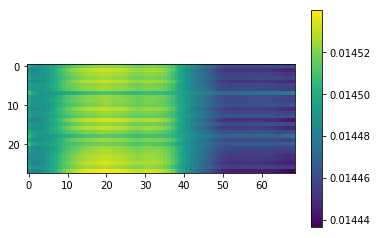

Calculated 70 Batches
Loss 70: 3.8672196524483815
08-24 15:05:09


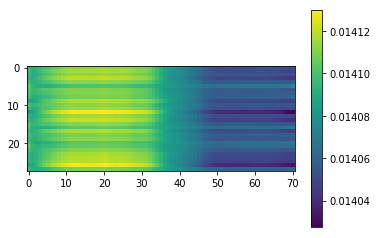

Calculated 80 Batches
Loss 80: 3.8087844848632812
08-24 15:05:10


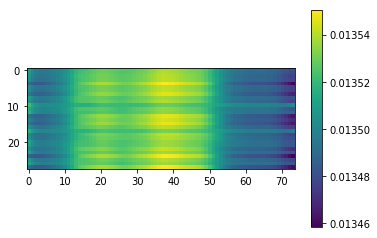

Calculated 90 Batches
Loss 90: 3.8462600708007812
08-24 15:05:12


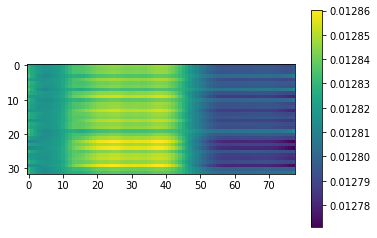

Calculated 100 Batches
Loss 100: 3.8502073287963867
08-24 15:05:13


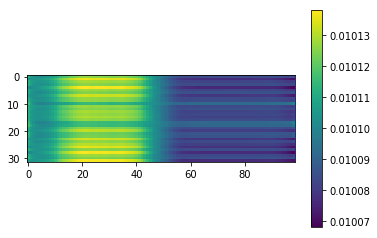

Calculated 110 Batches
Loss 110: 3.886552095413208
08-24 15:05:15


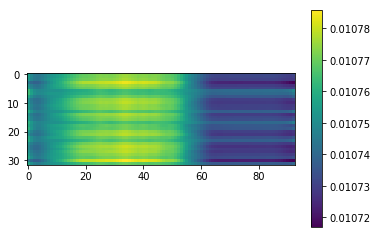

Calculated 120 Batches
Loss 120: 3.8682756423950195
08-24 15:05:16


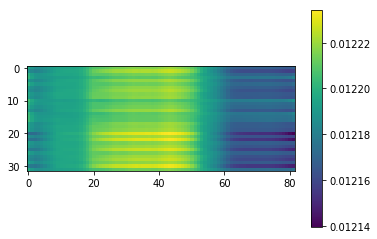

Calculated 130 Batches
Loss 130: 3.8458969593048096
08-24 15:05:18


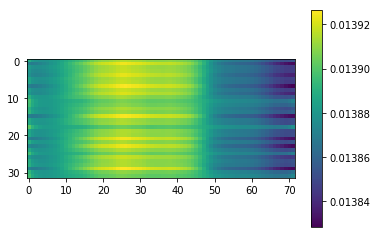

Calculated 140 Batches
Loss 140: 3.876191880967882
08-24 15:05:19


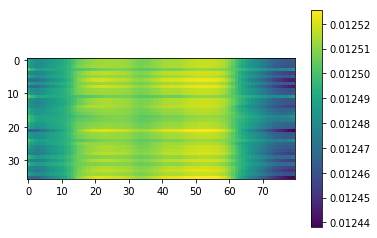

Calculated 150 Batches
Loss 150: 3.881964365641276
08-24 15:05:21


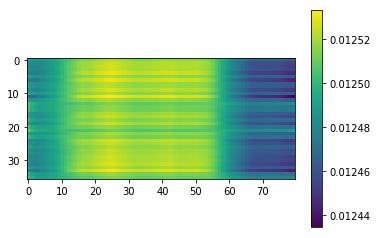

Calculated 160 Batches
Loss 160: 3.84598626030816
08-24 15:05:23


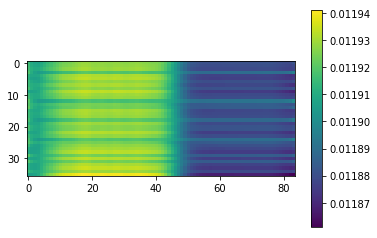

Calculated 170 Batches
Loss 170: 3.819562700059679
08-24 15:05:24


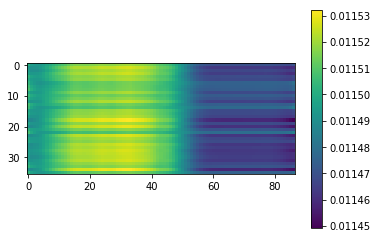

Calculated 180 Batches
Loss 180: 3.918578677707248
08-24 15:05:26


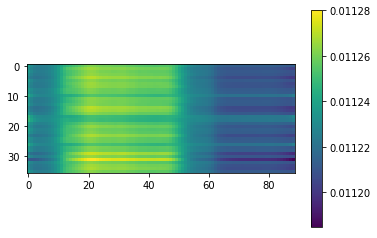

Calculated 190 Batches
Loss 190: 3.9249797821044923
08-24 15:05:28


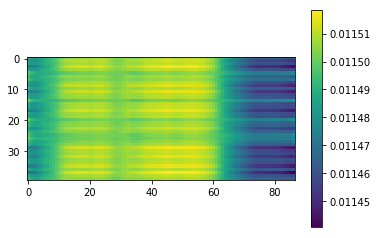

Calculated 200 Batches
Loss 200: 3.9576251983642576
08-24 15:05:30


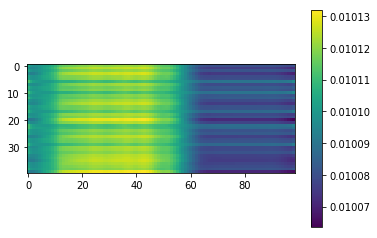

Calculated 210 Batches
Loss 210: 3.9149951934814453
08-24 15:05:32


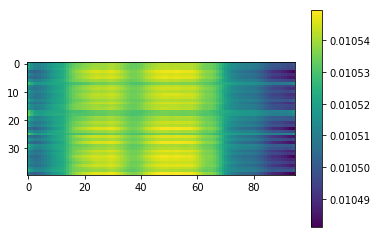

Calculated 220 Batches
Loss 220: 3.866179656982422
08-24 15:05:34


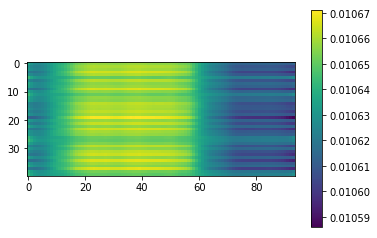

Calculated 230 Batches
Loss 230: 3.901597595214844
08-24 15:05:35


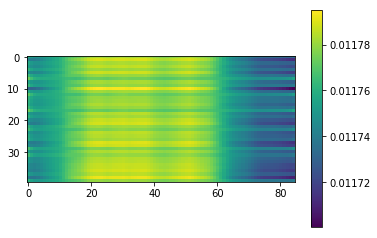

Calculated 240 Batches
Loss 240: 3.8780784606933594
08-24 15:05:37


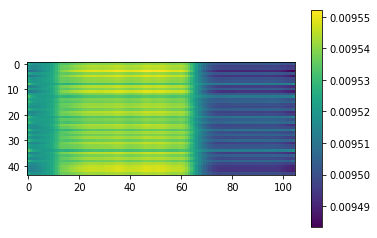

Calculated 250 Batches
Loss 250: 3.9163218411532315
08-24 15:05:39


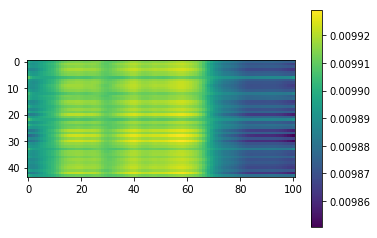

Calculated 260 Batches
Loss 260: 3.9108470569957388
08-24 15:05:41


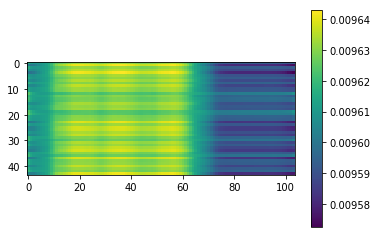

Calculated 270 Batches
Loss 270: 3.9048406427556817
08-24 15:05:43


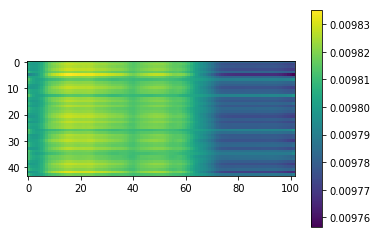

Calculated 280 Batches
Loss 280: 3.910271962483724
08-24 15:05:46


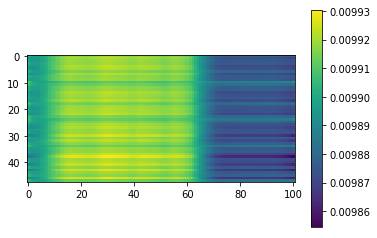

Calculated 290 Batches
Loss 290: 3.919429143269857
08-24 15:05:48


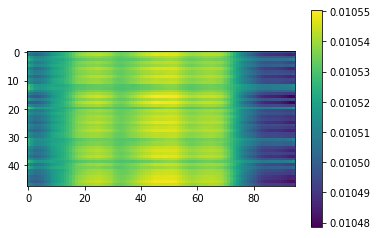

Calculated 300 Batches
Loss 300: 3.8910528818766275
08-24 15:05:50


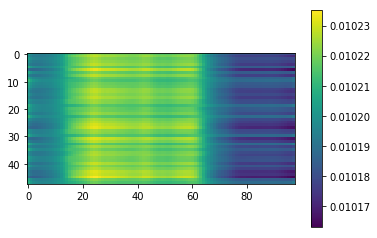

Calculated 310 Batches
Loss 310: 3.89908504486084
08-24 15:05:52


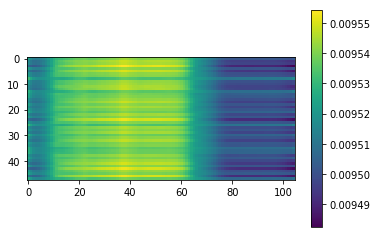

Calculated 320 Batches
Loss 320: 3.915333087627704
08-24 15:05:55


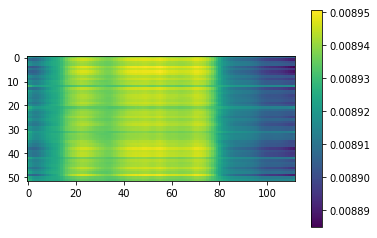

Calculated 330 Batches
Loss 330: 3.920182154728816
08-24 15:05:57


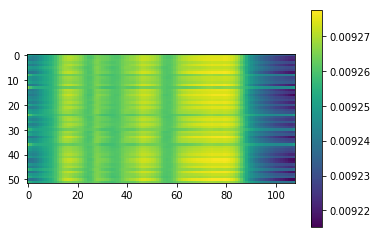

Calculated 340 Batches
Loss 340: 3.7956036158970425
08-24 15:06:00


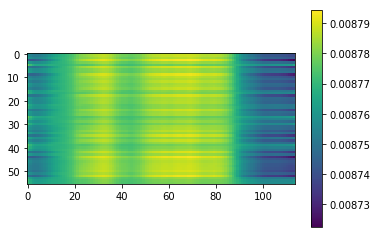

Calculated 350 Batches
Loss 350: 3.953350067138672
08-24 15:06:03


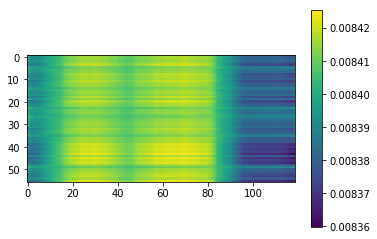

Calculated 360 Batches
Loss 360: 3.764526875813802
08-24 15:06:05


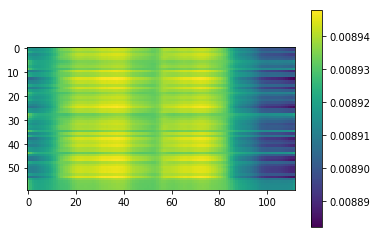

Calculated 370 Batches
Loss 370: 3.9522369384765623
08-24 15:06:08


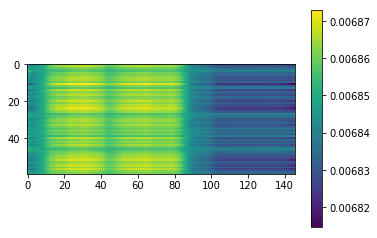

Calculated 380 Batches
Loss 380: 3.9686055183410645
08-24 15:06:11


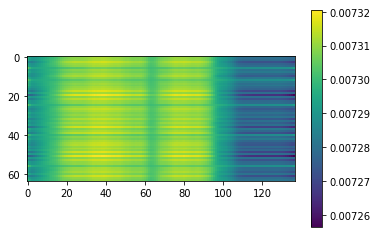

Calculated 390 Batches
Loss 390: 3.9782867431640625
08-24 15:06:15


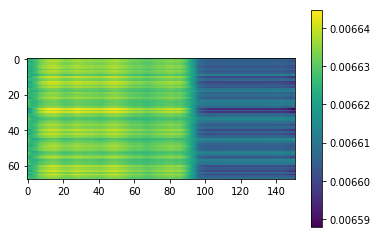

Calculated 400 Batches
Loss 400: 3.840110085227273
08-24 15:06:19


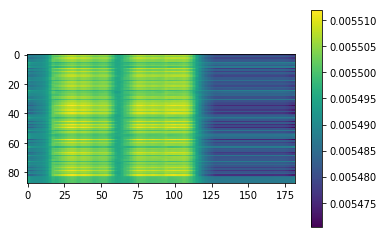

Mean Loss: 3.881394089552828
----------------------------------------------------
08-24 15:06:20
Calculated 10 Batches
Loss 10: 3.7883403301239014
08-24 15:06:20


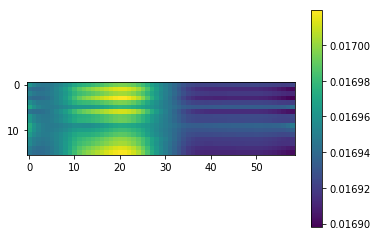

Calculated 20 Batches
Loss 20: 3.815110778808594
08-24 15:06:21


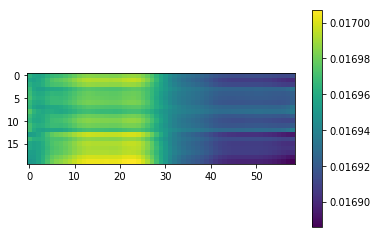

Calculated 30 Batches
Loss 30: 3.8162864049275718
08-24 15:06:22


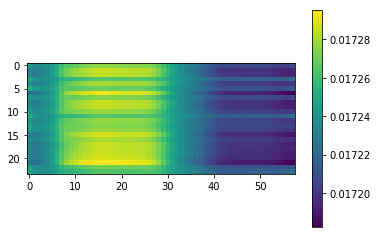

Calculated 40 Batches
Loss 40: 3.8114004135131836
08-24 15:06:23


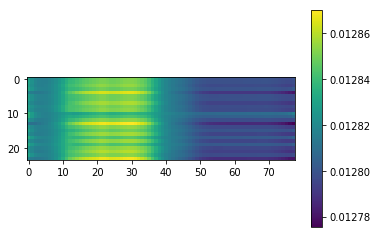

Calculated 50 Batches
Loss 50: 3.758624485560826
08-24 15:06:24


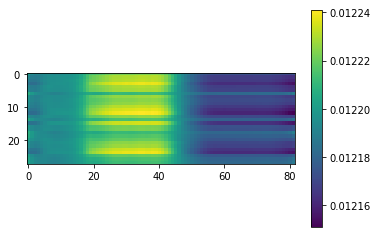

Calculated 60 Batches
Loss 60: 3.8606899806431363
08-24 15:06:26


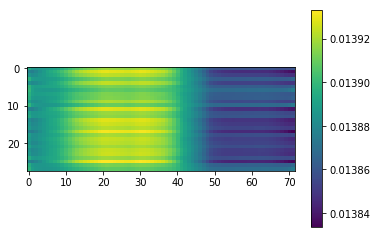

Calculated 70 Batches
Loss 70: 3.839858736310686
08-24 15:06:27


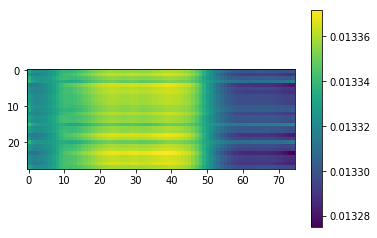

Calculated 80 Batches
Loss 80: 3.8067498888288225
08-24 15:06:28


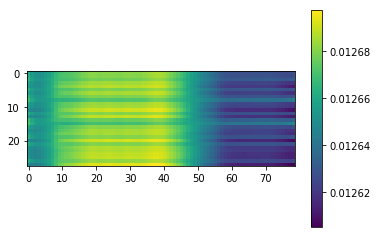

Calculated 90 Batches
Loss 90: 3.836449146270752
08-24 15:06:30


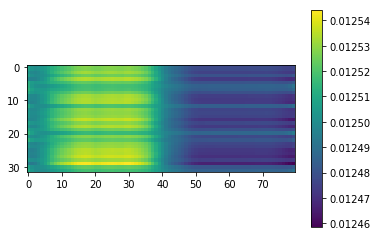

Calculated 100 Batches
Loss 100: 3.852084159851074
08-24 15:06:31


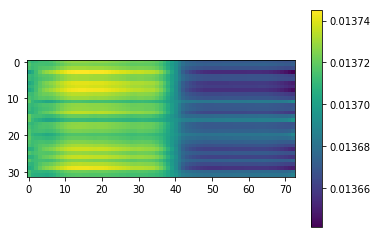

Calculated 110 Batches
Loss 110: 3.8686532974243164
08-24 15:06:33


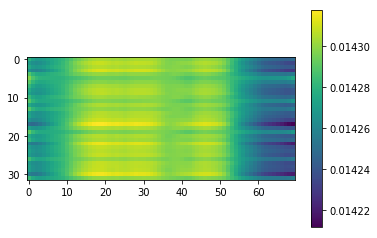

Calculated 120 Batches
Loss 120: 3.8715035915374756
08-24 15:06:34


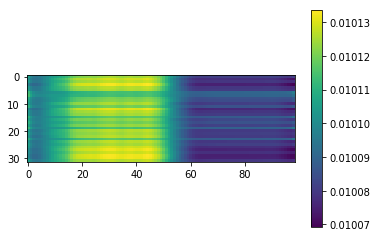

Calculated 130 Batches
Loss 130: 3.8323540687561035
08-24 15:06:36


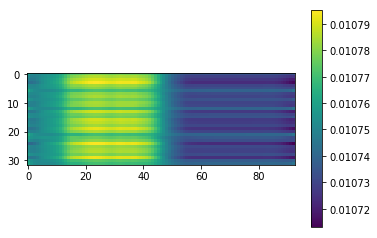

Calculated 140 Batches
Loss 140: 3.857092539469401
08-24 15:06:37


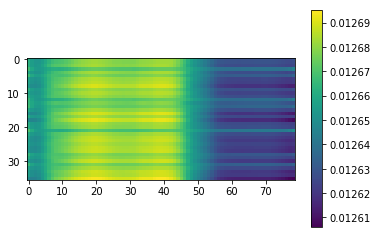

Calculated 150 Batches
Loss 150: 3.8756963941786022
08-24 15:06:39


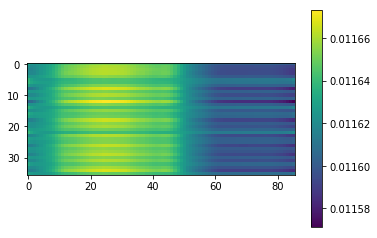

Calculated 160 Batches
Loss 160: 3.848352220323351
08-24 15:06:41


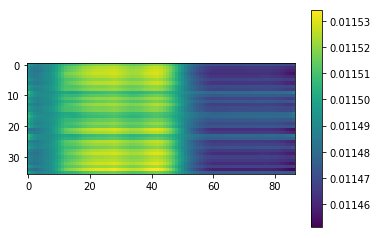

Calculated 170 Batches
Loss 170: 3.863700018988715
08-24 15:06:42


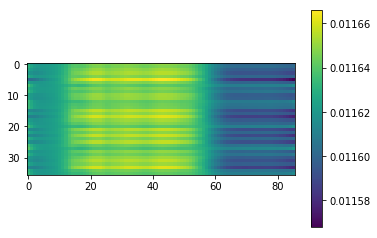

Calculated 180 Batches
Loss 180: 3.897088368733724
08-24 15:06:44


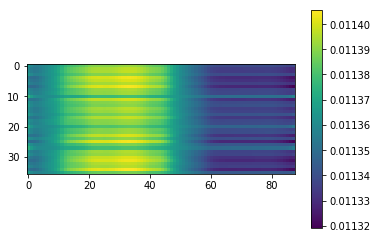

Calculated 190 Batches
Loss 190: 3.9393917083740235
08-24 15:06:46


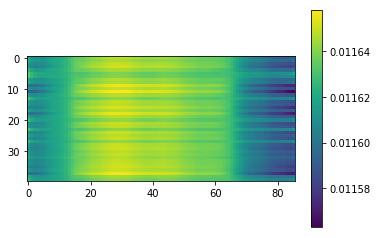

Calculated 200 Batches
Loss 200: 3.8820331573486326
08-24 15:06:48


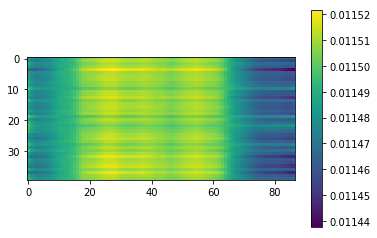

Calculated 210 Batches
Loss 210: 3.896302032470703
08-24 15:06:49


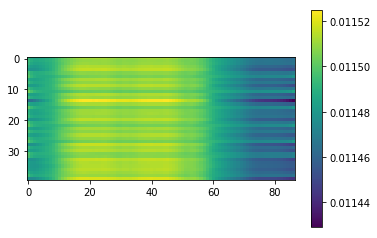

Calculated 220 Batches
Loss 220: 3.8931610107421877
08-24 15:06:51


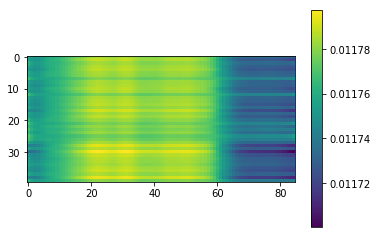

Calculated 230 Batches
Loss 230: 3.9476943969726563
08-24 15:06:53


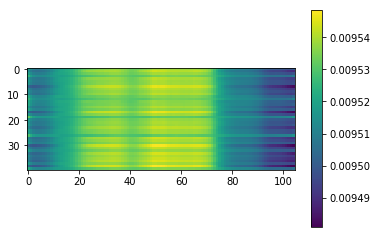

Calculated 240 Batches
Loss 240: 3.929703799161044
08-24 15:06:55


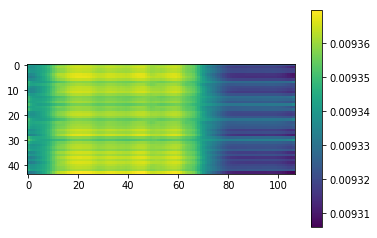

Calculated 250 Batches
Loss 250: 3.892099553888494
08-24 15:06:57


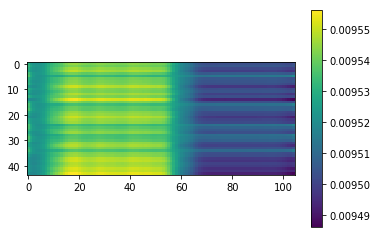

Calculated 260 Batches
Loss 260: 3.919923262162642
08-24 15:06:59


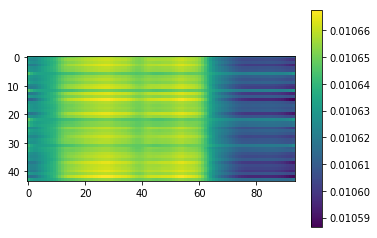

Calculated 270 Batches
Loss 270: 3.9021370627663354
08-24 15:07:02


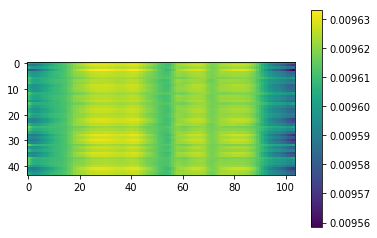

Calculated 280 Batches
Loss 280: 3.9548730850219727
08-24 15:07:04


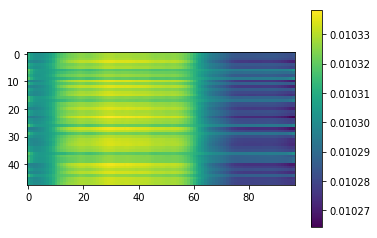

Calculated 290 Batches
Loss 290: 3.9179321924845376
08-24 15:07:06


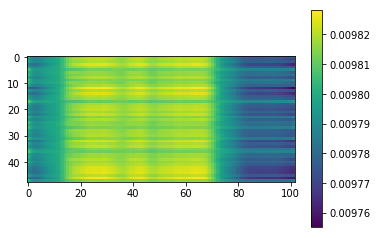

Calculated 300 Batches
Loss 300: 3.9554262161254883
08-24 15:07:08


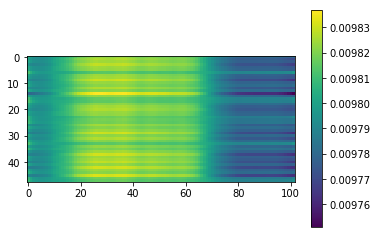

Calculated 310 Batches
Loss 310: 3.9255574544270835
08-24 15:07:10


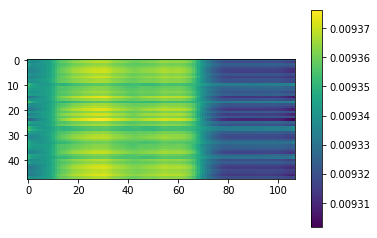

Calculated 320 Batches
Loss 320: 3.909709636981671
08-24 15:07:13


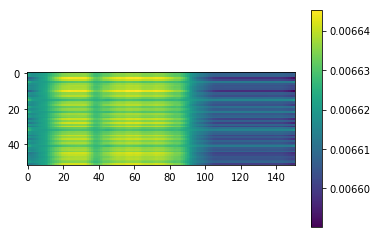

Calculated 330 Batches
Loss 330: 3.9180063100961537
08-24 15:07:15


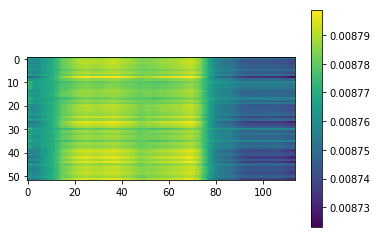

Calculated 340 Batches
Loss 340: 3.763627461024693
08-24 15:07:18


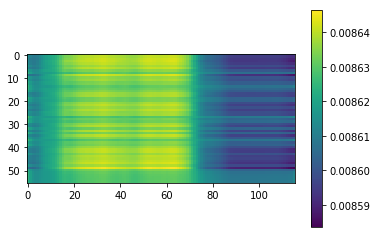

Calculated 350 Batches
Loss 350: 3.9205534798758372
08-24 15:07:20


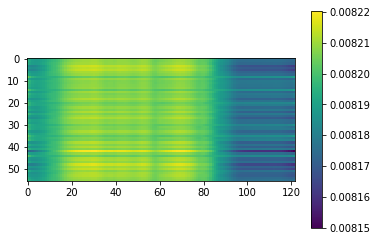

Calculated 360 Batches
Loss 360: 3.7606826782226563
08-24 15:07:23


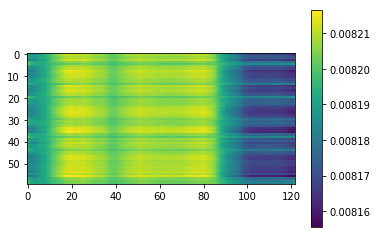

Calculated 370 Batches
Loss 370: 3.958726247151693
08-24 15:07:26


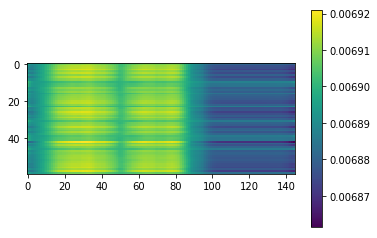

Calculated 380 Batches
Loss 380: 3.9570467472076416
08-24 15:07:29


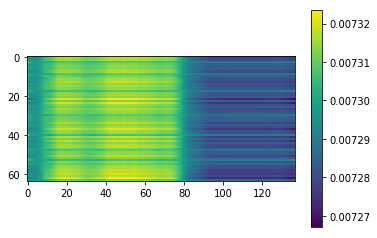

Calculated 390 Batches
Loss 390: 3.948202694163603
08-24 15:07:32


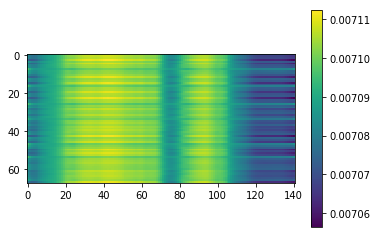

Calculated 400 Batches
Loss 400: 3.8411067615855825
08-24 15:07:36


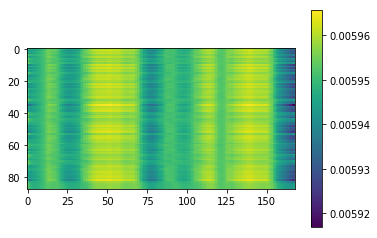

Mean Loss: 3.8812794087163205
----------------------------------------------------
08-24 15:07:38
Calculated 10 Batches
Loss 10: 3.72625994682312
08-24 15:07:38


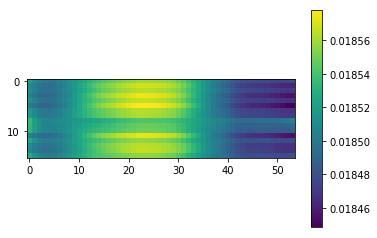

Calculated 20 Batches
Loss 20: 3.8501140594482424
08-24 15:07:39


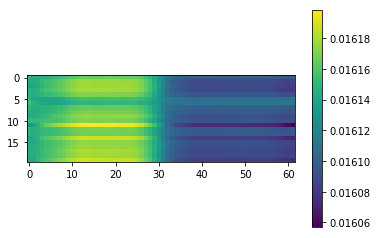

Calculated 30 Batches
Loss 30: 3.8407773971557617
08-24 15:07:40


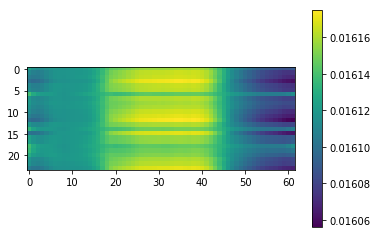

Calculated 40 Batches
Loss 40: 3.7887722651163735
08-24 15:07:41


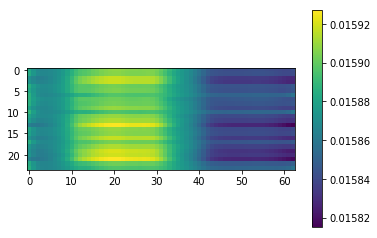

Calculated 50 Batches
Loss 50: 3.7091544015066966
08-24 15:07:43


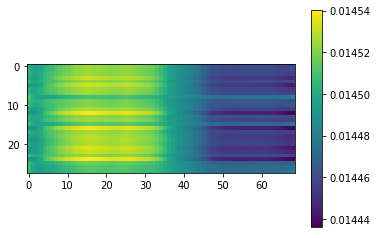

Calculated 60 Batches
Loss 60: 3.8590289524623325
08-24 15:07:44


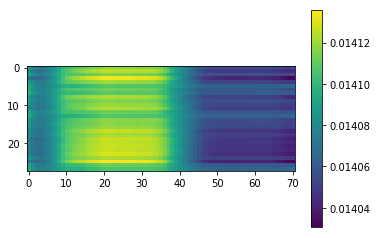

Calculated 70 Batches
Loss 70: 3.8631079537527904
08-24 15:07:45


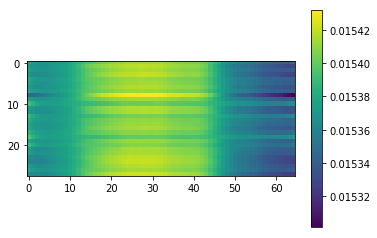

Calculated 80 Batches
Loss 80: 3.8414339338030135
08-24 15:07:46


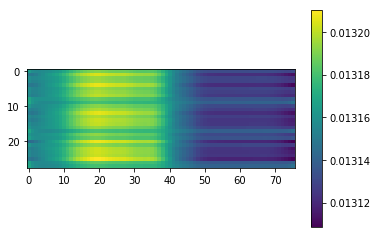

Calculated 90 Batches
Loss 90: 3.8806676864624023
08-24 15:07:48


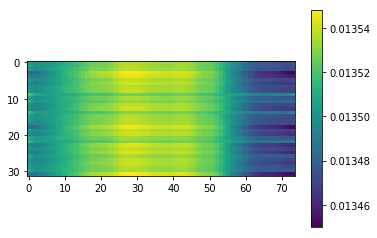

Calculated 100 Batches
Loss 100: 3.929344654083252
08-24 15:07:49


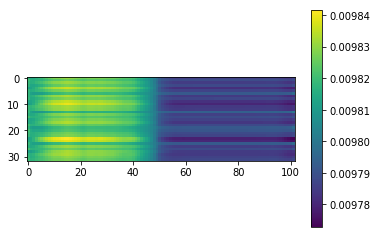

Calculated 110 Batches
Loss 110: 3.82775616645813
08-24 15:07:51


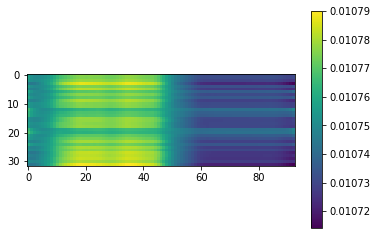

Calculated 120 Batches
Loss 120: 3.8963186740875244
08-24 15:07:52


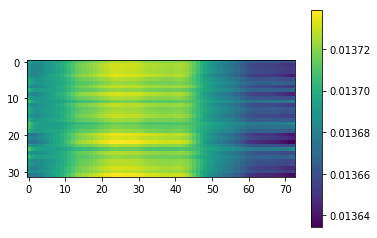

Calculated 130 Batches
Loss 130: 3.8965392112731934
08-24 15:07:54


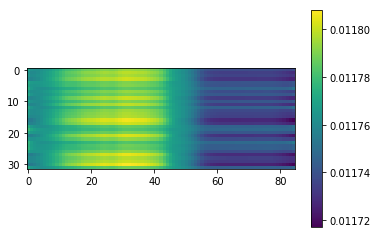

Calculated 140 Batches
Loss 140: 3.8884124755859375
08-24 15:07:55


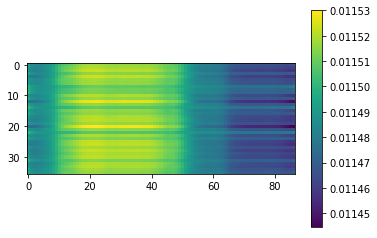

Calculated 150 Batches
Loss 150: 3.8594737582736545
08-24 15:07:57


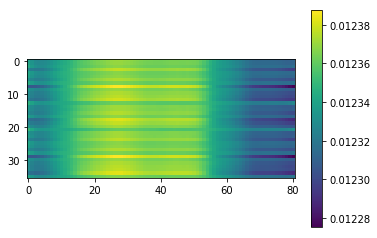

Calculated 160 Batches
Loss 160: 3.925724877251519
08-24 15:07:58


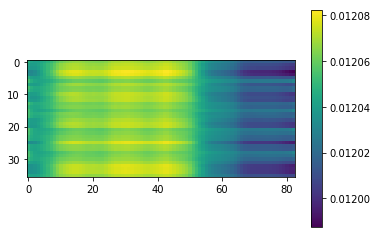

Calculated 170 Batches
Loss 170: 3.892015669080946
08-24 15:08:00


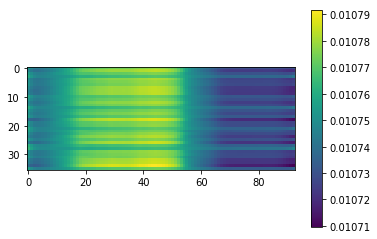

Calculated 180 Batches
Loss 180: 3.8663834465874567
08-24 15:08:02


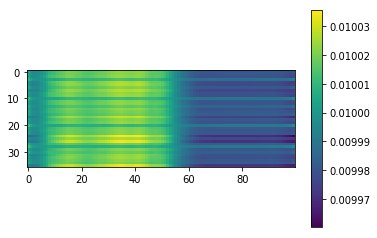

Calculated 190 Batches
Loss 190: 3.9115882873535157
08-24 15:08:04


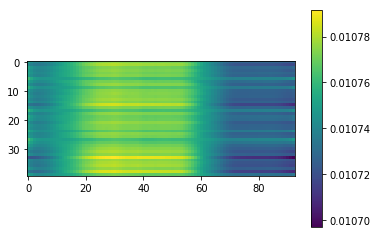

Calculated 200 Batches
Loss 200: 3.917741394042969
08-24 15:08:05


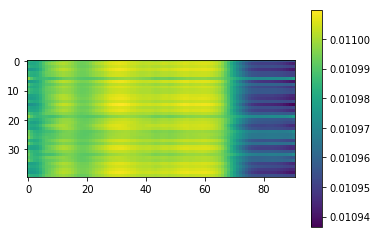

Calculated 210 Batches
Loss 210: 3.9051647186279297
08-24 15:08:07


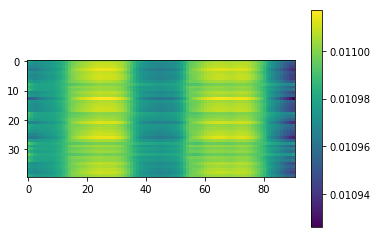

Calculated 220 Batches
Loss 220: 3.902176284790039
08-24 15:08:09


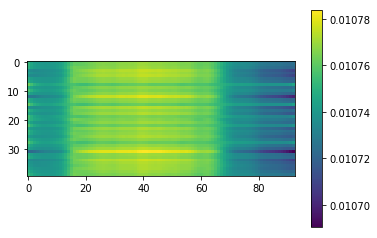

Calculated 230 Batches
Loss 230: 3.8850841522216797
08-24 15:08:11


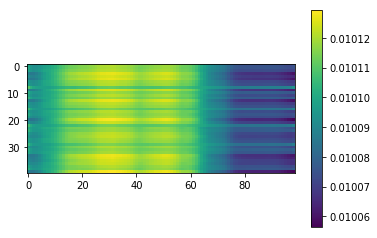

Calculated 240 Batches
Loss 240: 3.887072129683061
08-24 15:08:13


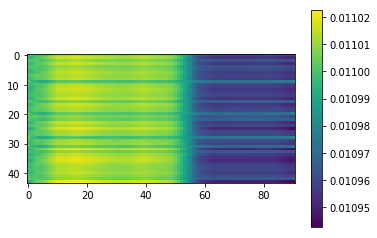

Calculated 250 Batches
Loss 250: 3.8993107188831675
08-24 15:08:15


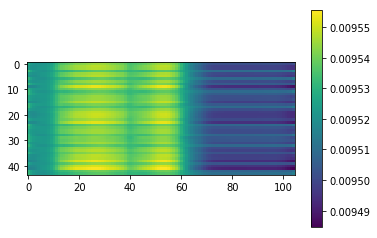

Calculated 260 Batches
Loss 260: 3.915178819136186
08-24 15:08:17


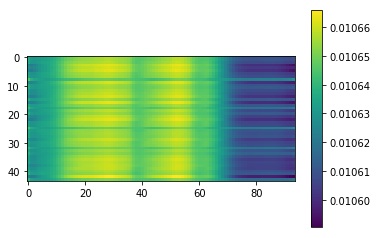

Calculated 270 Batches
Loss 270: 3.911271181973544
08-24 15:08:19


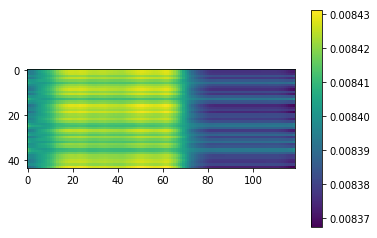

Calculated 280 Batches
Loss 280: 3.8625402450561523
08-24 15:08:21


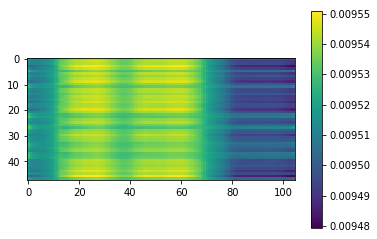

Calculated 290 Batches
Loss 290: 3.9117965698242188
08-24 15:08:24


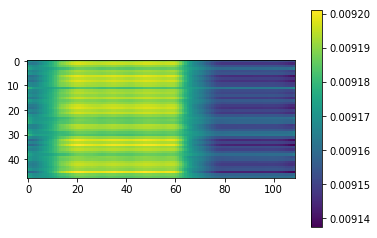

Calculated 300 Batches
Loss 300: 3.8938302993774414
08-24 15:08:26


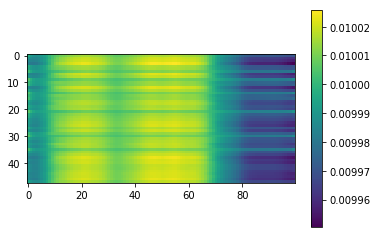

Calculated 310 Batches
Loss 310: 3.9392983118693032
08-24 15:08:28


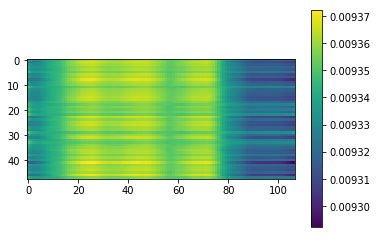

Calculated 320 Batches
Loss 320: 3.9300126295823317
08-24 15:08:31


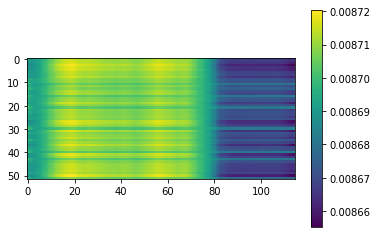

Calculated 330 Batches
Loss 330: 3.935210888202374
08-24 15:08:33


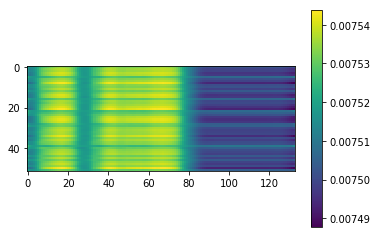

Calculated 340 Batches
Loss 340: 3.793645586286272
08-24 15:08:35


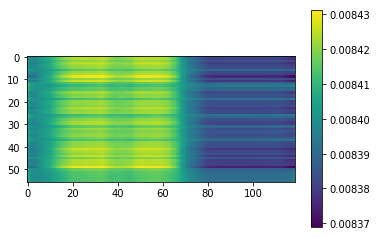

Calculated 350 Batches
Loss 350: 3.9419329507010326
08-24 15:08:38


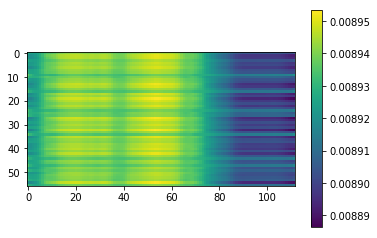

Calculated 360 Batches
Loss 360: 3.7522061665852866
08-24 15:08:41


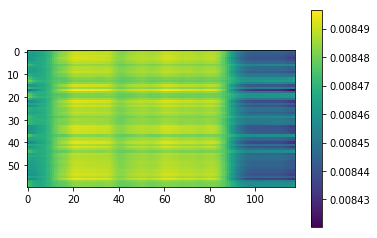

Calculated 370 Batches
Loss 370: 3.939744822184245
08-24 15:08:44


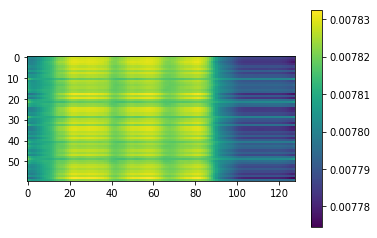

Calculated 380 Batches
Loss 380: 3.9576618671417236
08-24 15:08:47


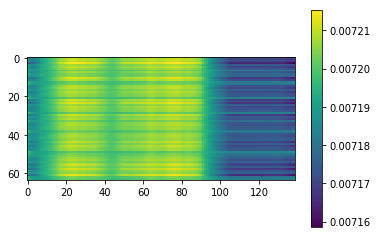

Calculated 390 Batches
Loss 390: 3.9632029813878678
08-24 15:08:50


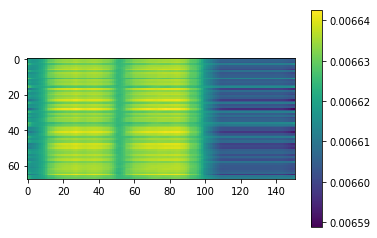

Calculated 400 Batches
Loss 400: 3.8325538635253906
08-24 15:08:54


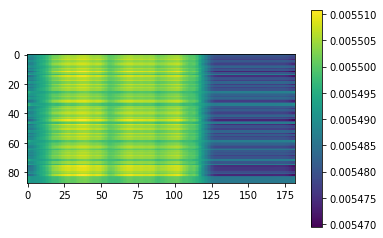

Mean Loss: 3.881257484415414
----------------------------------------------------
08-24 15:08:55
Calculated 10 Batches
Loss 10: 3.7220170497894287
08-24 15:08:56


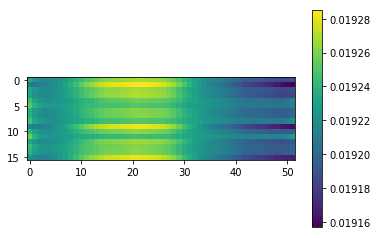

Calculated 20 Batches
Loss 20: 3.808544921875
08-24 15:08:57


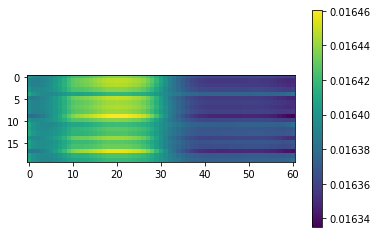

Calculated 30 Batches
Loss 30: 3.841205914815267
08-24 15:08:58


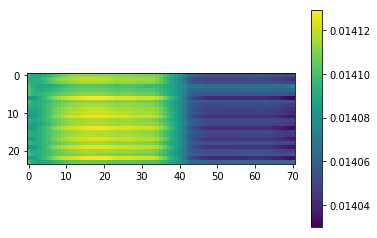

Calculated 40 Batches
Loss 40: 3.8767999013264975
08-24 15:08:59


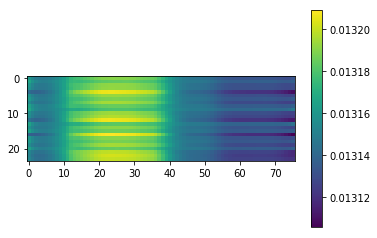

Calculated 50 Batches
Loss 50: 3.723763874598912
08-24 15:09:00


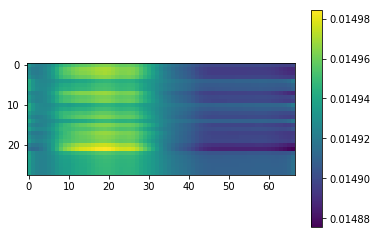

Calculated 60 Batches
Loss 60: 3.850237710135324
08-24 15:09:01


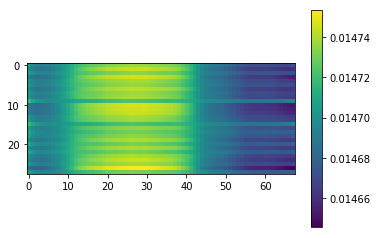

Calculated 70 Batches
Loss 70: 3.8693324497767856
08-24 15:09:03


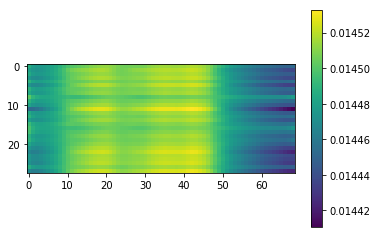

Calculated 80 Batches
Loss 80: 3.835442679268973
08-24 15:09:04


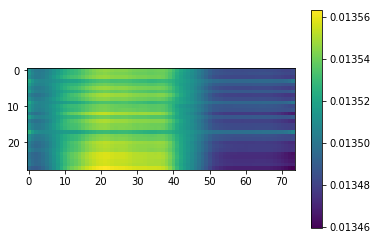

Calculated 90 Batches
Loss 90: 3.907809257507324
08-24 15:09:05


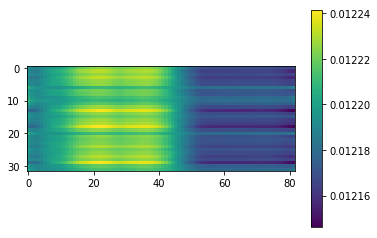

Calculated 100 Batches
Loss 100: 3.9163055419921875
08-24 15:09:07


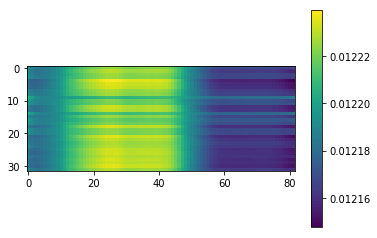

Calculated 110 Batches
Loss 110: 3.870954751968384
08-24 15:09:08


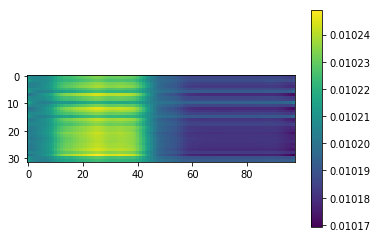

Calculated 120 Batches
Loss 120: 3.8157923221588135
08-24 15:09:10


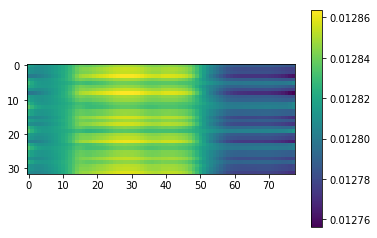

Calculated 130 Batches
Loss 130: 3.834137439727783
08-24 15:09:11


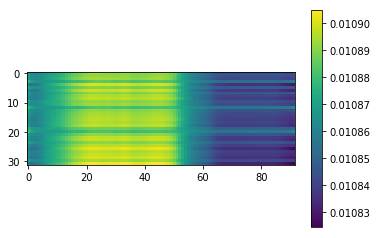

Calculated 140 Batches
Loss 140: 3.85841793484158
08-24 15:09:13


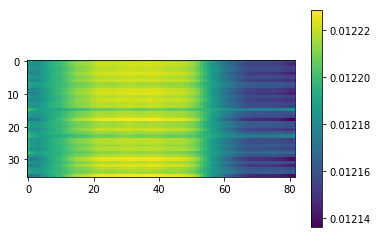

Calculated 150 Batches
Loss 150: 3.873371124267578
08-24 15:09:14


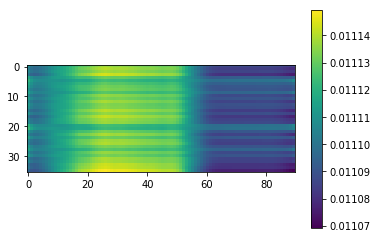

Calculated 160 Batches
Loss 160: 3.8487557305230036
08-24 15:09:16


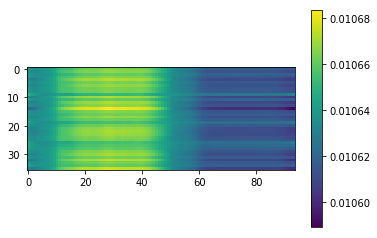

Calculated 170 Batches
Loss 170: 3.887574937608507
08-24 15:09:18


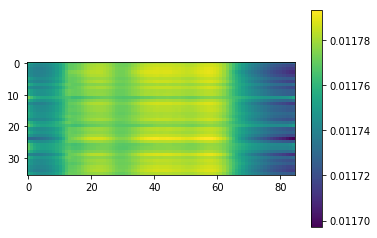

Calculated 180 Batches
Loss 180: 3.859805213080512
08-24 15:09:19


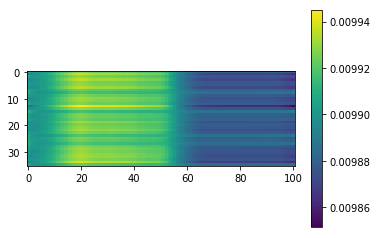

Calculated 190 Batches
Loss 190: 3.8936328887939453
08-24 15:09:21


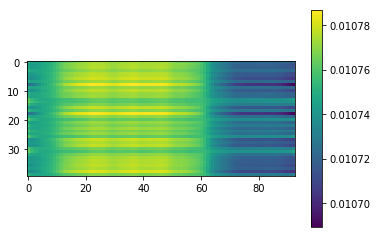

Calculated 200 Batches
Loss 200: 3.936299514770508
08-24 15:09:23


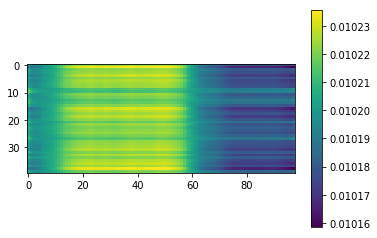

Calculated 210 Batches
Loss 210: 3.880794143676758
08-24 15:09:25


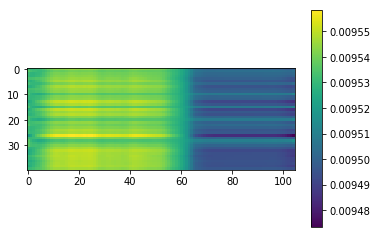

Calculated 220 Batches
Loss 220: 3.8752182006835936
08-24 15:09:27


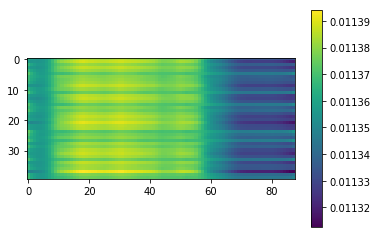

Calculated 230 Batches
Loss 230: 3.8838863372802734
08-24 15:09:29


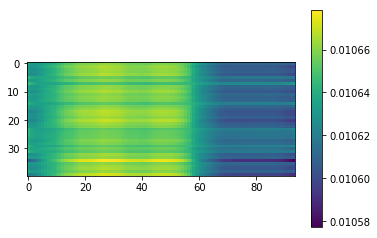

Calculated 240 Batches
Loss 240: 3.950315302068537
08-24 15:09:31


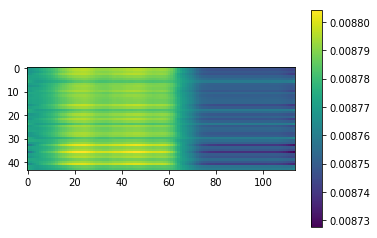

Calculated 250 Batches
Loss 250: 3.924927451393821
08-24 15:09:33


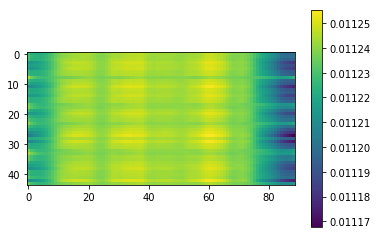

Calculated 260 Batches
Loss 260: 3.938314611261541
08-24 15:09:35


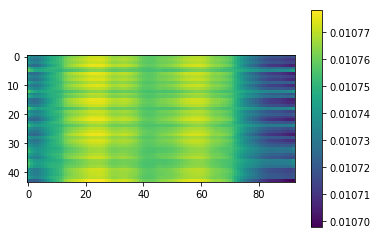

Calculated 270 Batches
Loss 270: 3.9168420271439985
08-24 15:09:37


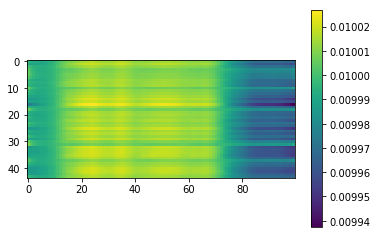

Calculated 280 Batches
Loss 280: 3.915072441101074
08-24 15:09:39


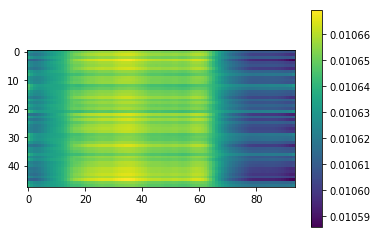

Calculated 290 Batches
Loss 290: 3.881275177001953
08-24 15:09:41


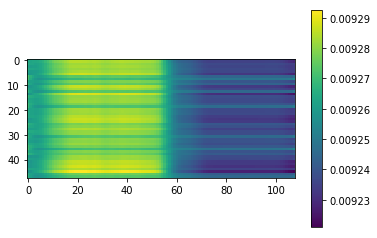

Calculated 300 Batches
Loss 300: 3.91864808400472
08-24 15:09:43


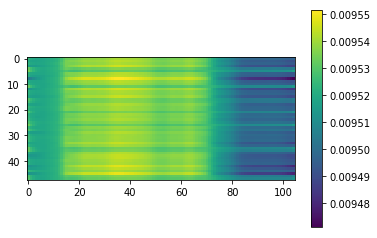

Calculated 310 Batches
Loss 310: 3.90079657236735
08-24 15:09:45


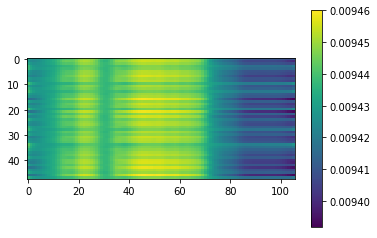

Calculated 320 Batches
Loss 320: 3.931732471172626
08-24 15:09:48


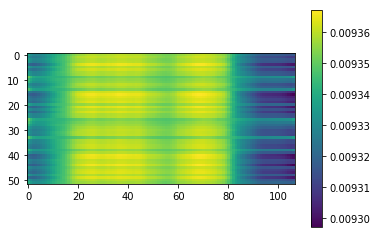

Calculated 330 Batches
Loss 330: 3.936437753530649
08-24 15:09:50


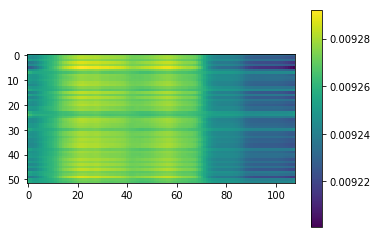

Calculated 340 Batches
Loss 340: 3.795313698904855
08-24 15:09:53


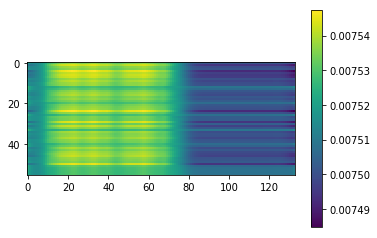

Calculated 350 Batches
Loss 350: 3.9487182072230746
08-24 15:09:55


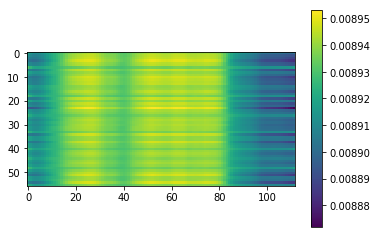

Calculated 360 Batches
Loss 360: 3.780173492431641
08-24 15:09:58


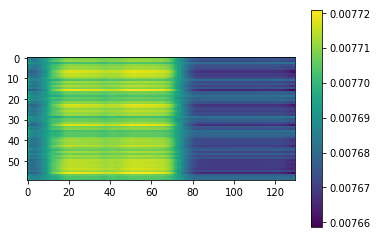

Calculated 370 Batches
Loss 370: 3.9724416097005206
08-24 15:10:01


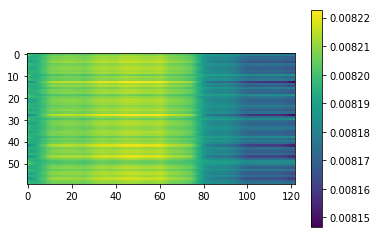

Calculated 380 Batches
Loss 380: 3.9714455604553223
08-24 15:10:04


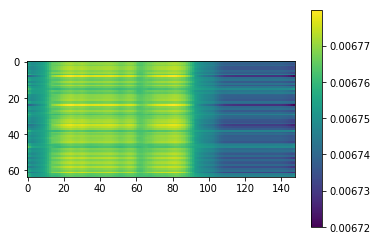

Calculated 390 Batches
Loss 390: 3.9869303983800553
08-24 15:10:08


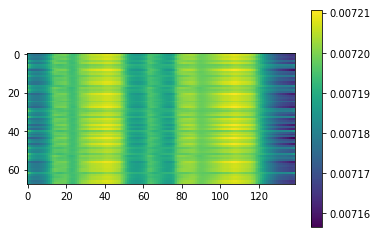

Calculated 400 Batches
Loss 400: 3.8384645635431465
08-24 15:10:12


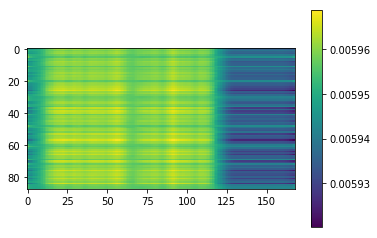

Mean Loss: 3.8806867746858638
----------------------------------------------------
08-24 15:10:13
Calculated 10 Batches
Loss 10: 3.716118097305298
08-24 15:10:13


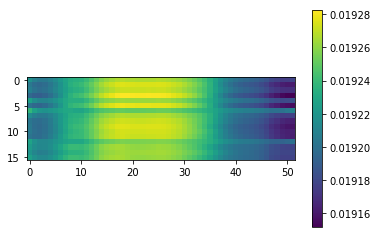

Calculated 20 Batches
Loss 20: 3.757975769042969
08-24 15:10:14


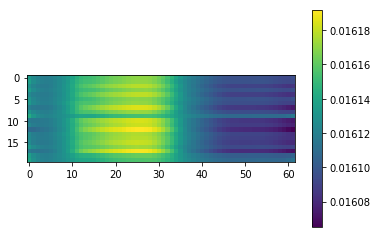

Calculated 30 Batches
Loss 30: 3.851258913675944
08-24 15:10:15


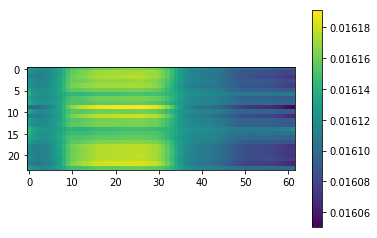

Calculated 40 Batches
Loss 40: 3.796509106953939
08-24 15:10:17


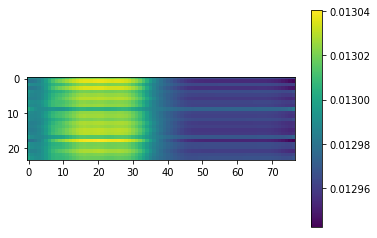

Calculated 50 Batches
Loss 50: 3.754697527204241
08-24 15:10:18


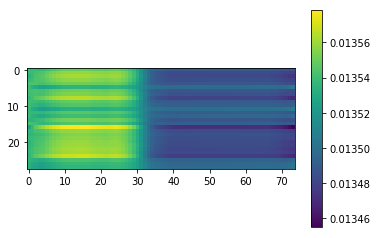

Calculated 60 Batches
Loss 60: 3.852222170148577
08-24 15:10:19


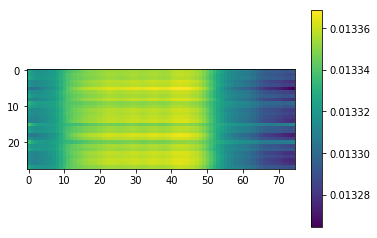

Calculated 70 Batches
Loss 70: 3.8385941641671315
08-24 15:10:20


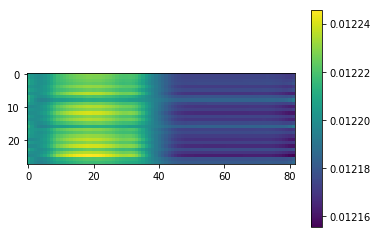

Calculated 80 Batches
Loss 80: 3.8934132712227956
08-24 15:10:21


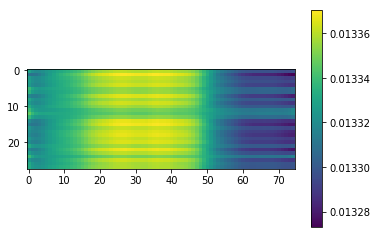

Calculated 90 Batches
Loss 90: 3.8509435653686523
08-24 15:10:23


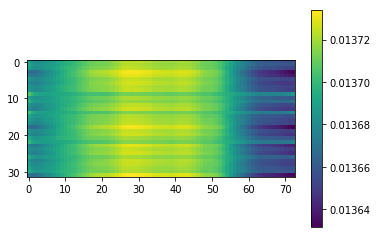

Calculated 100 Batches
Loss 100: 3.851177453994751
08-24 15:10:24


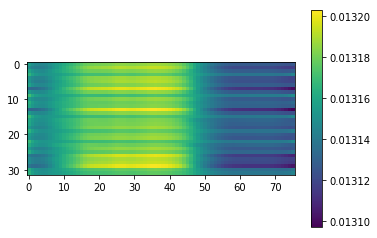

Calculated 110 Batches
Loss 110: 3.8584659099578857
08-24 15:10:26


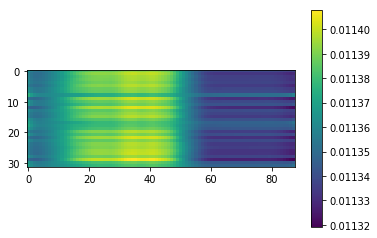

Calculated 120 Batches
Loss 120: 3.842115640640259
08-24 15:10:27


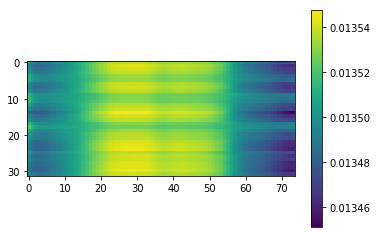

Calculated 130 Batches
Loss 130: 3.873800277709961
08-24 15:10:29


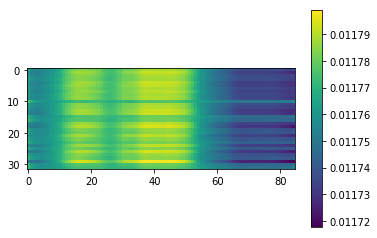

Calculated 140 Batches
Loss 140: 3.8806559244791665
08-24 15:10:30


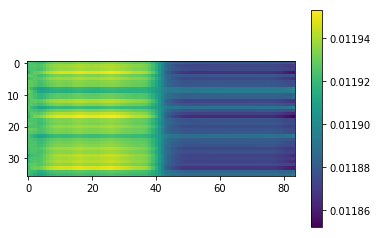

Calculated 150 Batches
Loss 150: 3.856962415907118
08-24 15:10:32


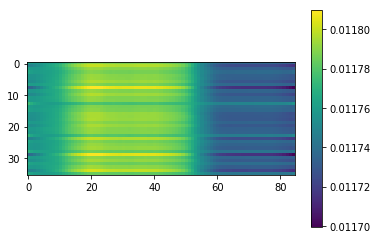

Calculated 160 Batches
Loss 160: 3.8815850151909723
08-24 15:10:34


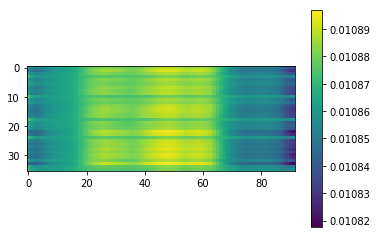

Calculated 170 Batches
Loss 170: 3.851353539360894
08-24 15:10:35


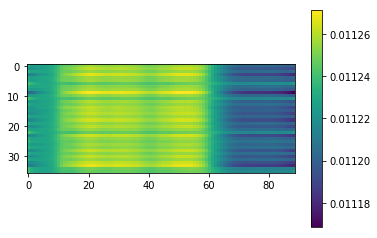

Calculated 180 Batches
Loss 180: 3.840118408203125
08-24 15:10:37


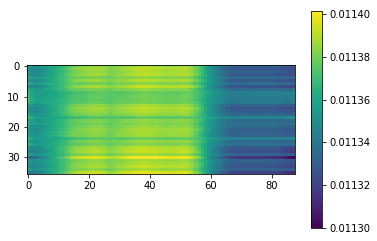

Calculated 190 Batches
Loss 190: 3.894739532470703
08-24 15:10:39


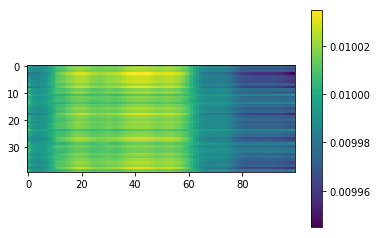

Calculated 200 Batches
Loss 200: 3.8921669006347654
08-24 15:10:41


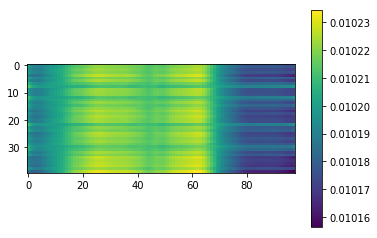

Calculated 210 Batches
Loss 210: 3.896234893798828
08-24 15:10:43


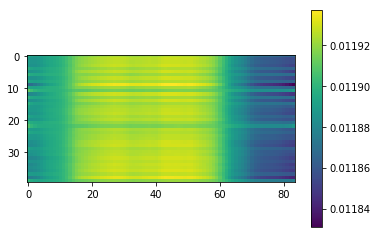

Calculated 220 Batches
Loss 220: 3.8119586944580077
08-24 15:10:44


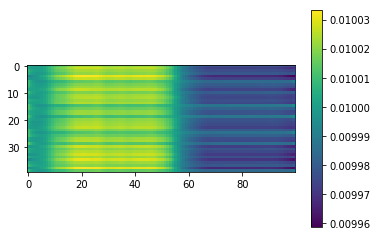

Calculated 230 Batches
Loss 230: 3.922211456298828
08-24 15:10:46


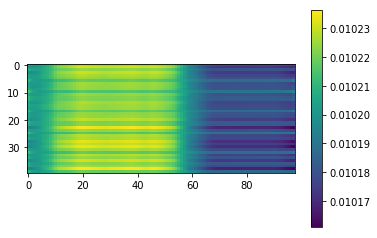

Calculated 240 Batches
Loss 240: 3.909046866677024
08-24 15:10:48


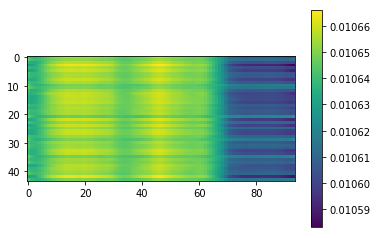

Calculated 250 Batches
Loss 250: 3.923307245427912
08-24 15:10:50


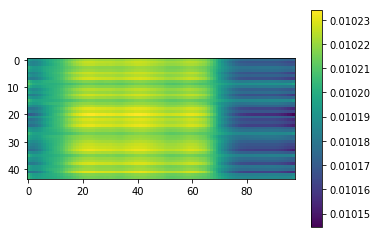

Calculated 260 Batches
Loss 260: 3.8803801103071733
08-24 15:10:52


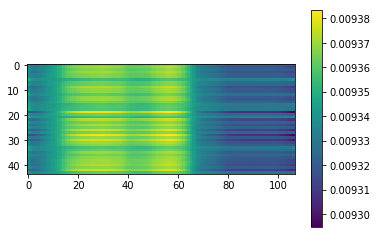

Calculated 270 Batches
Loss 270: 3.9032731489701704
08-24 15:10:54


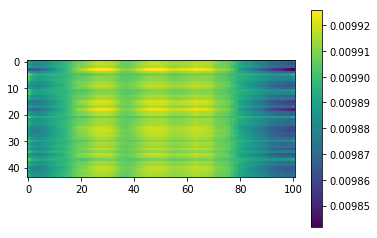

Calculated 280 Batches
Loss 280: 3.9249998728434243
08-24 15:10:57


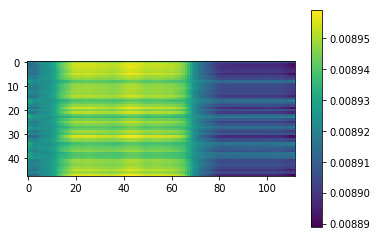

Calculated 290 Batches
Loss 290: 3.9288533528645835
08-24 15:10:59


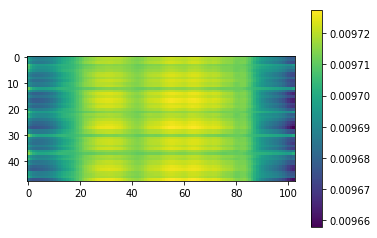

Calculated 300 Batches
Loss 300: 3.9299949010213218
08-24 15:11:01


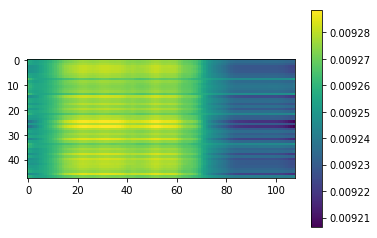

Calculated 310 Batches
Loss 310: 3.9390796025594077
08-24 15:11:03


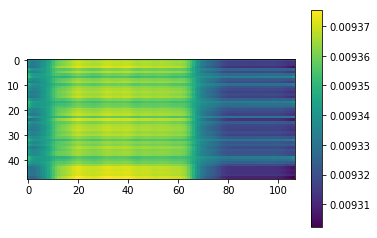

Calculated 320 Batches
Loss 320: 3.9246500455416164
08-24 15:11:06


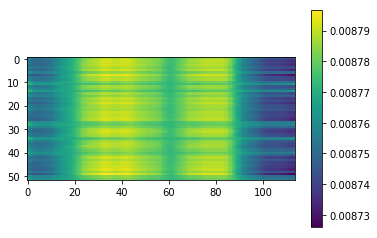

Calculated 330 Batches
Loss 330: 3.9171840961162863
08-24 15:11:09


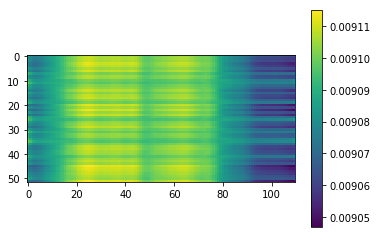

Calculated 340 Batches
Loss 340: 3.8036706107003346
08-24 15:11:11


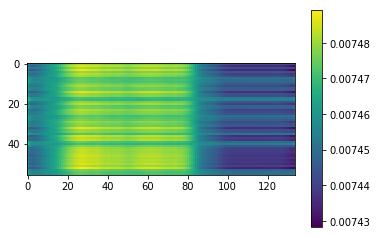

Calculated 350 Batches
Loss 350: 3.919269289289202
08-24 15:11:14


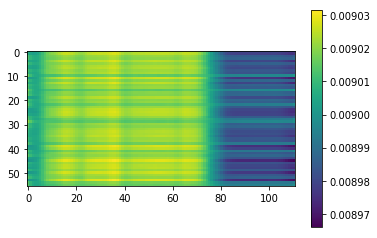

Calculated 360 Batches
Loss 360: 3.748766072591146
08-24 15:11:16


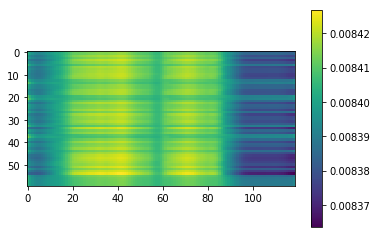

Calculated 370 Batches
Loss 370: 3.9556958516438803
08-24 15:11:19


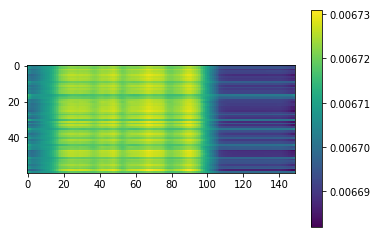

Calculated 380 Batches
Loss 380: 3.930941581726074
08-24 15:11:22


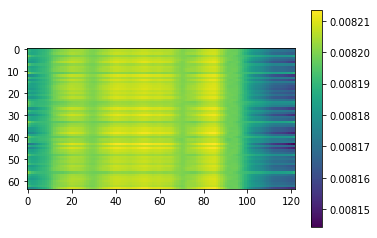

Calculated 390 Batches
Loss 390: 3.9742301492130054
08-24 15:11:26


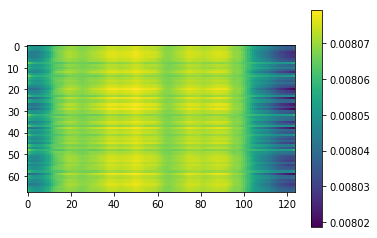

Calculated 400 Batches
Loss 400: 3.8432384837757456
08-24 15:11:29


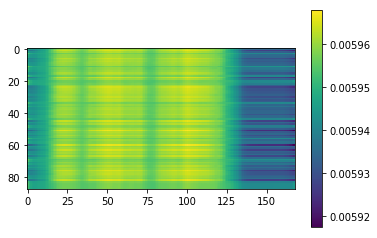

Mean Loss: 3.8801711440020297
----------------------------------------------------
08-24 15:11:31
Calculated 10 Batches
Loss 10: 3.6870086193084717
08-24 15:11:31


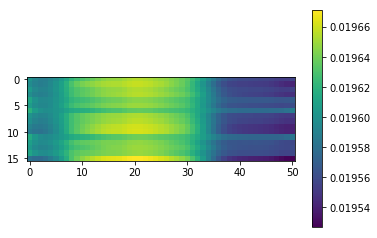

Calculated 20 Batches
Loss 20: 3.815333938598633
08-24 15:11:32


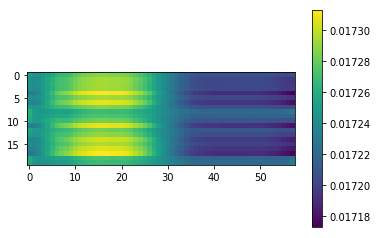

Calculated 30 Batches
Loss 30: 3.8655430475870767
08-24 15:11:33


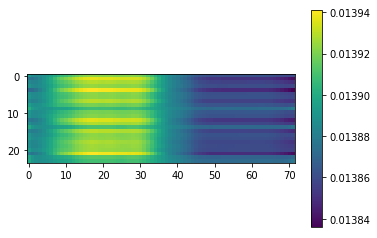

Calculated 40 Batches
Loss 40: 3.8348490397135415
08-24 15:11:34


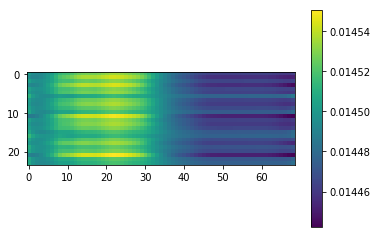

Calculated 50 Batches
Loss 50: 3.757717950003488
08-24 15:11:35


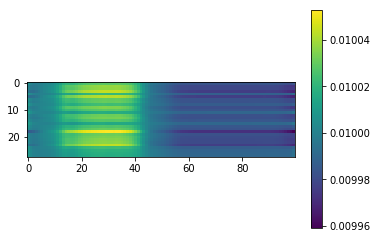

Calculated 60 Batches
Loss 60: 3.8148975372314453
08-24 15:11:37


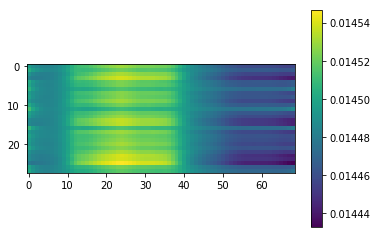

Calculated 70 Batches
Loss 70: 3.850905282156808
08-24 15:11:38


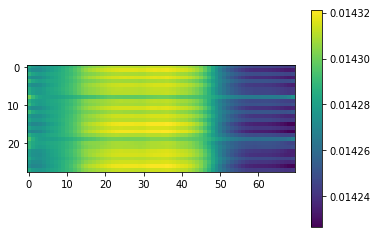

Calculated 80 Batches
Loss 80: 3.882059097290039
08-24 15:11:39


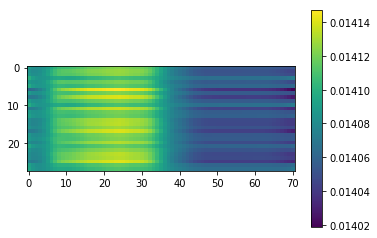

Calculated 90 Batches
Loss 90: 3.8430778980255127
08-24 15:11:41


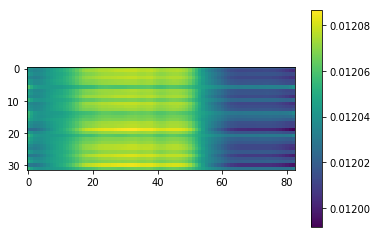

Calculated 100 Batches
Loss 100: 3.866748809814453
08-24 15:11:42


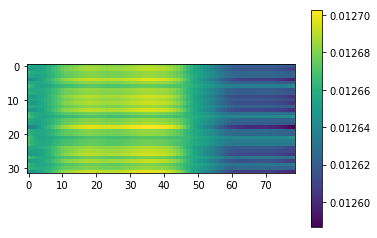

Calculated 110 Batches
Loss 110: 3.86979341506958
08-24 15:11:44


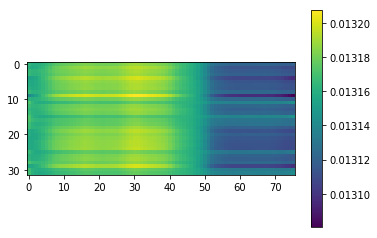

Calculated 120 Batches
Loss 120: 3.862823247909546
08-24 15:11:45


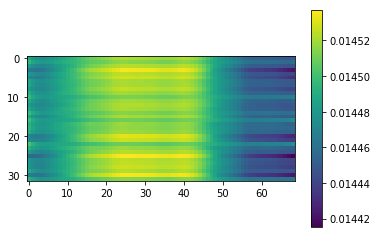

Calculated 130 Batches
Loss 130: 3.836602210998535
08-24 15:11:47


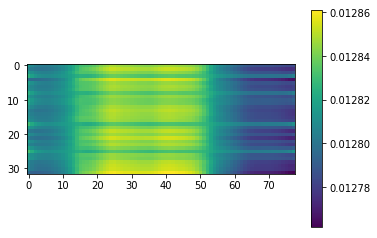

Calculated 140 Batches
Loss 140: 3.862809075249566
08-24 15:11:48


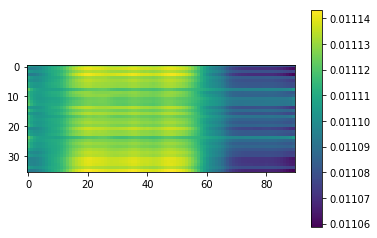

Calculated 150 Batches
Loss 150: 3.882277594672309
08-24 15:11:50


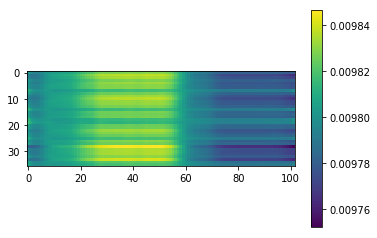

Calculated 160 Batches
Loss 160: 3.9046588473849826
08-24 15:11:52


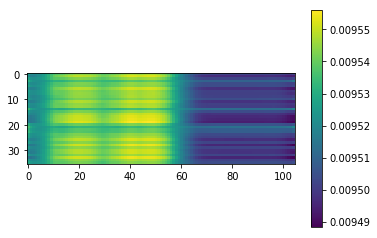

Calculated 170 Batches
Loss 170: 3.857892778184679
08-24 15:11:53


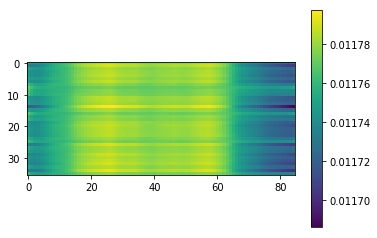

Calculated 180 Batches
Loss 180: 3.935291714138455
08-24 15:11:55


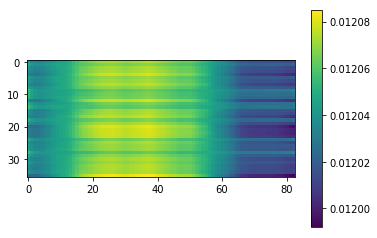

Calculated 190 Batches
Loss 190: 3.903187561035156
08-24 15:11:57


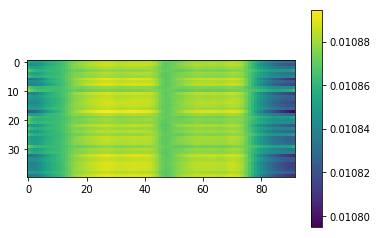

Calculated 200 Batches
Loss 200: 3.876059341430664
08-24 15:11:59


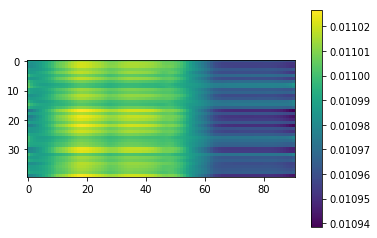

Calculated 210 Batches
Loss 210: 3.8913684844970704
08-24 15:12:00


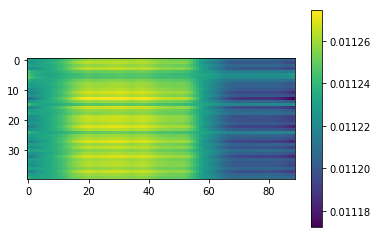

Calculated 220 Batches
Loss 220: 3.861542510986328
08-24 15:12:02


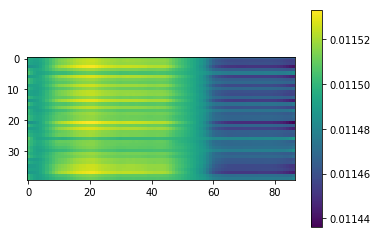

Calculated 230 Batches
Loss 230: 3.911138916015625
08-24 15:12:04


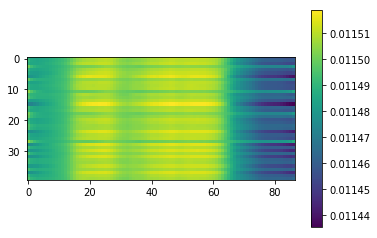

Calculated 240 Batches
Loss 240: 3.9494035894220527
08-24 15:12:06


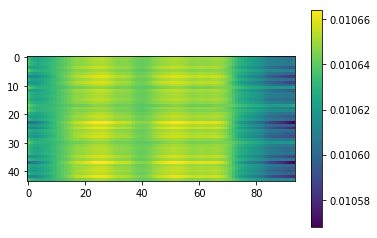

Calculated 250 Batches
Loss 250: 3.9237993413751777
08-24 15:12:08


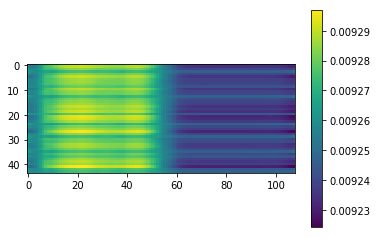

Calculated 260 Batches
Loss 260: 3.9290535666725854
08-24 15:12:10


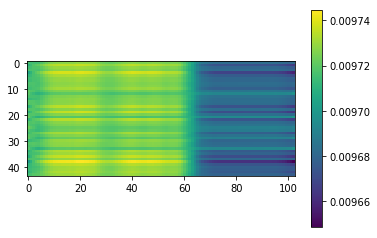

Calculated 270 Batches
Loss 270: 3.8671951293945312
08-24 15:12:12


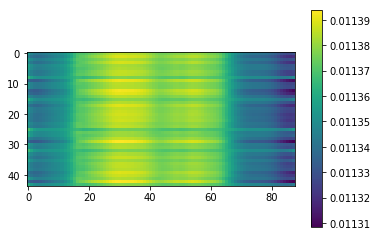

Calculated 280 Batches
Loss 280: 3.93723201751709
08-24 15:12:15


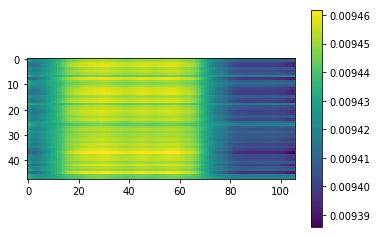

Calculated 290 Batches
Loss 290: 3.9384495417277017
08-24 15:12:17


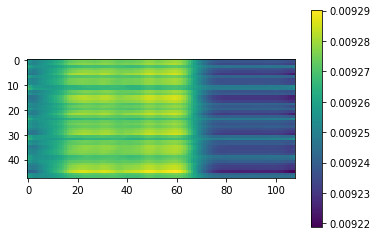

Calculated 300 Batches
Loss 300: 3.9375740687052407
08-24 15:12:19


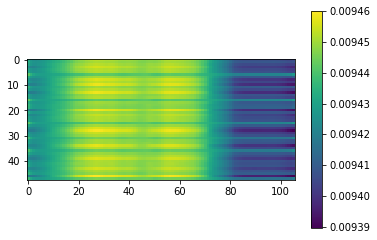

Calculated 310 Batches
Loss 310: 3.892587979634603
08-24 15:12:21


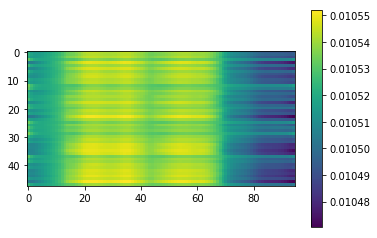

Calculated 320 Batches
Loss 320: 3.9461708068847656
08-24 15:12:24


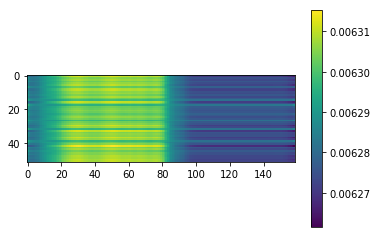

Calculated 330 Batches
Loss 330: 3.923352461594802
08-24 15:12:26


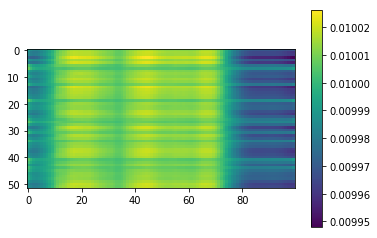

Calculated 340 Batches
Loss 340: 3.7831810542515347
08-24 15:12:29


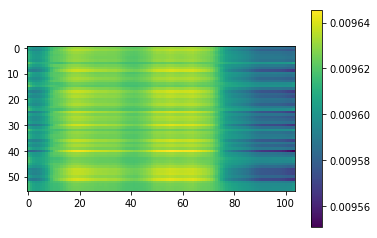

Calculated 350 Batches
Loss 350: 3.948044913155692
08-24 15:12:31


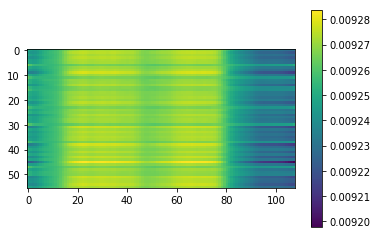

Calculated 360 Batches
Loss 360: 3.7578666687011717
08-24 15:12:34


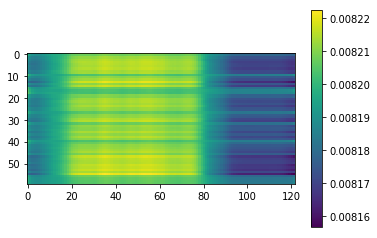

Calculated 370 Batches
Loss 370: 3.950770314534505
08-24 15:12:37


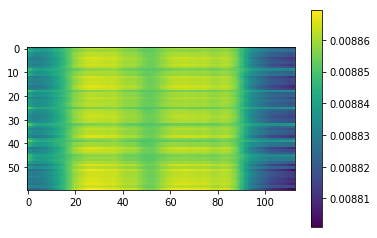

Calculated 380 Batches
Loss 380: 3.9715330600738525
08-24 15:12:40


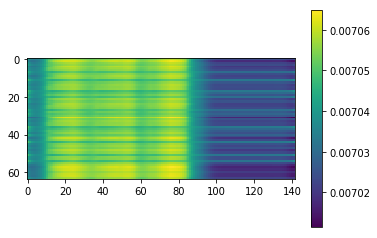

Calculated 390 Batches
Loss 390: 3.965941485236673
08-24 15:12:43


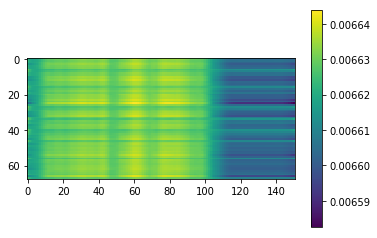

Calculated 400 Batches
Loss 400: 3.8242177096280185
08-24 15:12:47


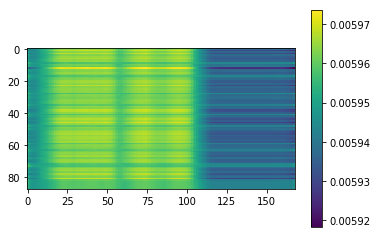

Mean Loss: 3.8806787944121774
----------------------------------------------------
08-24 15:12:49
Calculated 10 Batches
Loss 10: 3.7823326587677
08-24 15:12:49


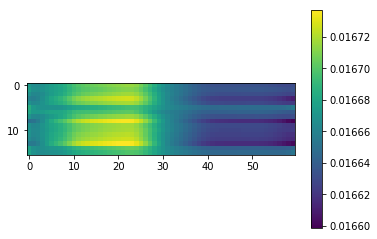

Calculated 20 Batches
Loss 20: 3.813262939453125
08-24 15:12:50


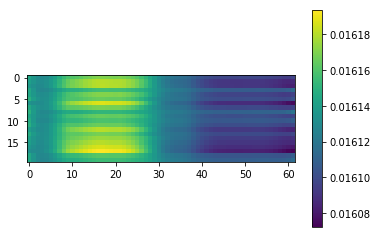

Calculated 30 Batches
Loss 30: 3.8072544733683267
08-24 15:12:51


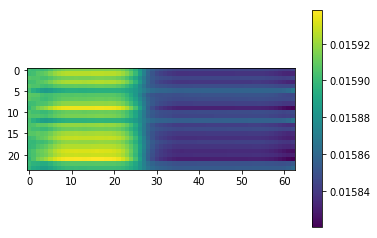

Calculated 40 Batches
Loss 40: 3.80247433980306
08-24 15:12:52


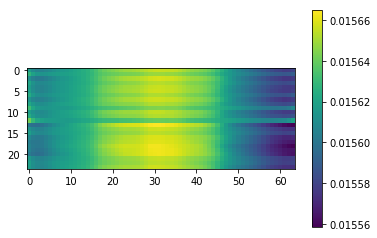

Calculated 50 Batches
Loss 50: 3.726019723074777
08-24 15:12:53


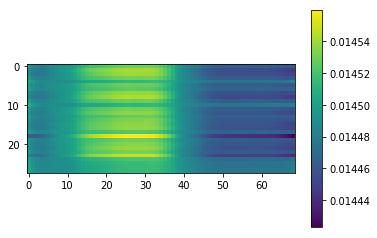

Calculated 60 Batches
Loss 60: 3.8494014739990234
08-24 15:12:55


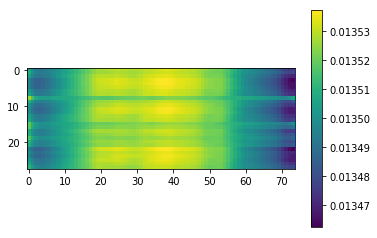

Calculated 70 Batches
Loss 70: 3.8351568494524275
08-24 15:12:56


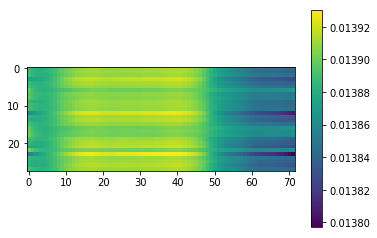

Calculated 80 Batches
Loss 80: 3.8115013667515347
08-24 15:12:57


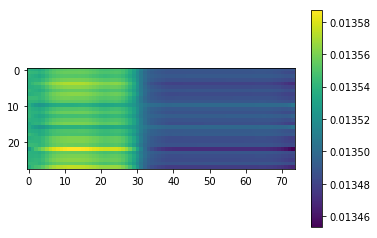

Calculated 90 Batches
Loss 90: 3.8822648525238037
08-24 15:12:59


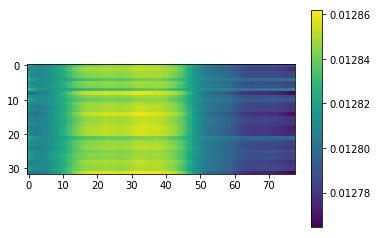

Calculated 100 Batches
Loss 100: 3.872741222381592
08-24 15:13:00


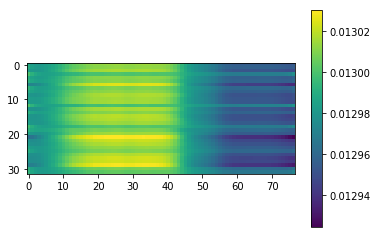

Calculated 110 Batches
Loss 110: 3.9178342819213867
08-24 15:13:02


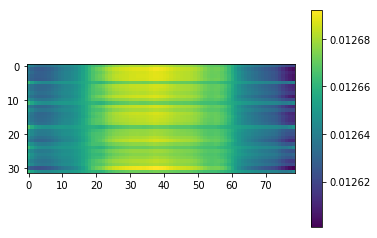

Calculated 120 Batches
Loss 120: 3.832761764526367
08-24 15:13:03


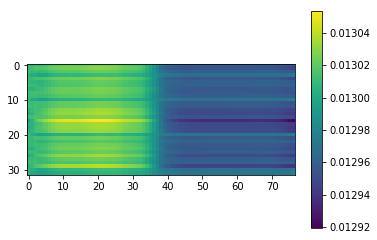

Calculated 130 Batches
Loss 130: 3.8867576122283936
08-24 15:13:05


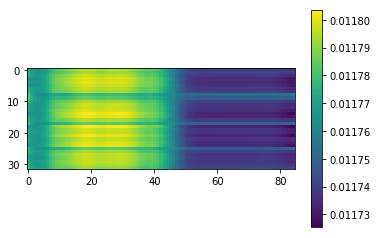

Calculated 140 Batches
Loss 140: 3.909267849392361
08-24 15:13:06


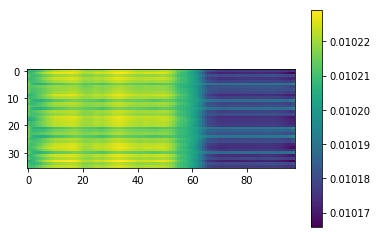

Calculated 150 Batches
Loss 150: 3.9004478454589844
08-24 15:13:08


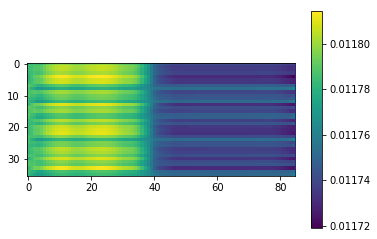

Calculated 160 Batches
Loss 160: 3.832258012559679
08-24 15:13:09


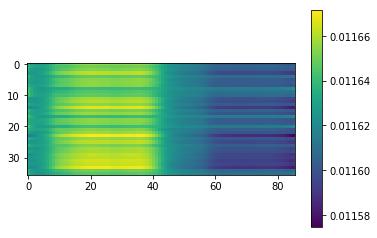

Calculated 170 Batches
Loss 170: 3.9021085103352866
08-24 15:13:11


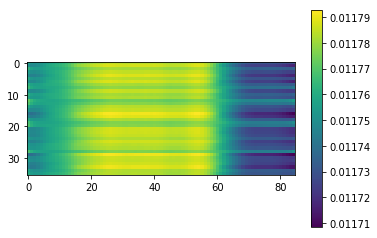

Calculated 180 Batches
Loss 180: 3.904657999674479
08-24 15:13:13


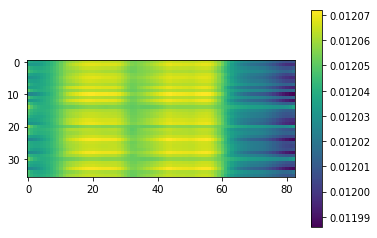

Calculated 190 Batches
Loss 190: 3.9235855102539063
08-24 15:13:15


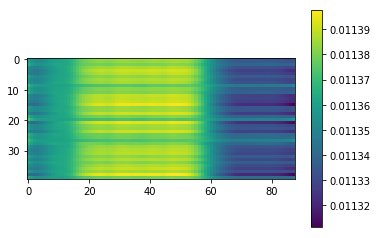

Calculated 200 Batches
Loss 200: 3.881830596923828
08-24 15:13:16


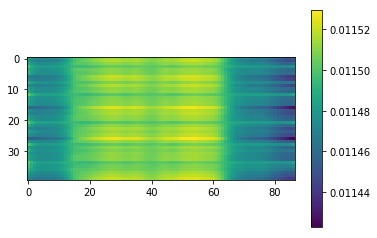

Calculated 210 Batches
Loss 210: 3.8974689483642577
08-24 15:13:18


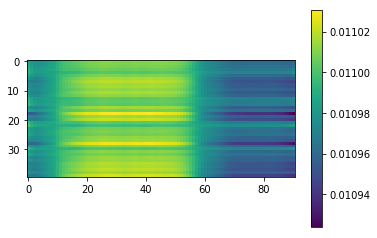

Calculated 220 Batches
Loss 220: 3.9183746337890626
08-24 15:13:20


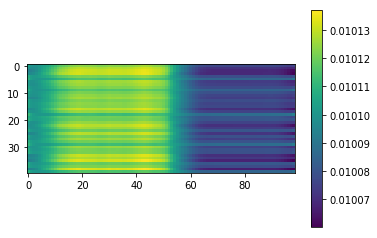

Calculated 230 Batches
Loss 230: 3.880680465698242
08-24 15:13:22


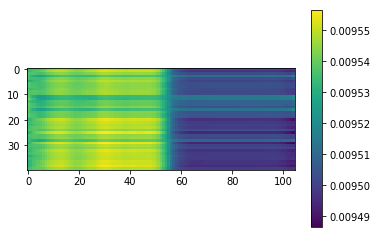

Calculated 240 Batches
Loss 240: 3.9220799532803623
08-24 15:13:24


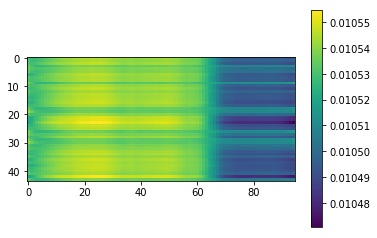

Calculated 250 Batches
Loss 250: 3.9210135719992896
08-24 15:13:26


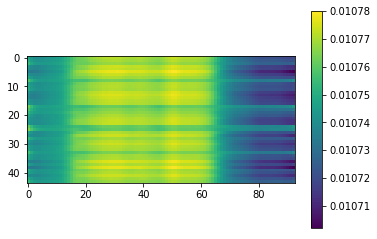

Calculated 260 Batches
Loss 260: 3.8938452980735083
08-24 15:13:28


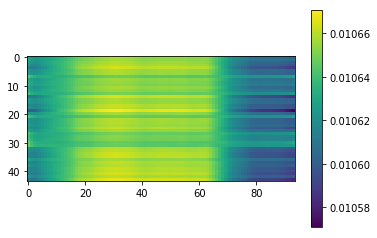

Calculated 270 Batches
Loss 270: 3.9177173267711294
08-24 15:13:30


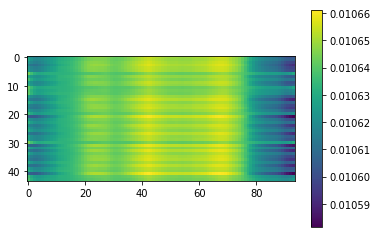

Calculated 280 Batches
Loss 280: 3.9234911600748696
08-24 15:13:32


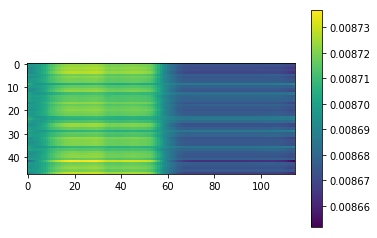

Calculated 290 Batches
Loss 290: 3.9278904596964517
08-24 15:13:35


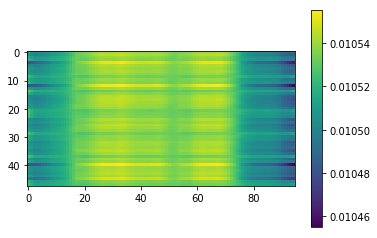

Calculated 300 Batches
Loss 300: 3.918669064839681
08-24 15:13:37


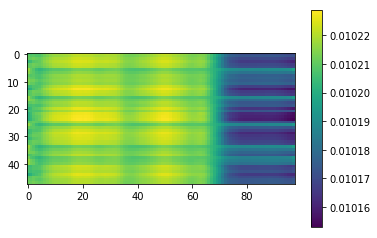

Calculated 310 Batches
Loss 310: 3.9112631479899087
08-24 15:13:39


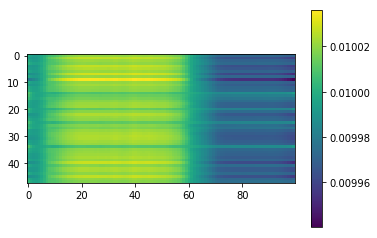

Calculated 320 Batches
Loss 320: 3.9505157470703125
08-24 15:13:41


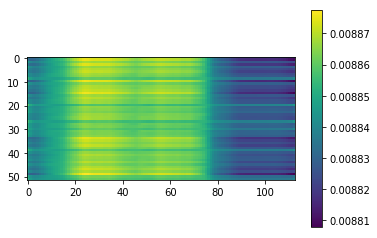

Calculated 330 Batches
Loss 330: 3.9151705228365383
08-24 15:13:44


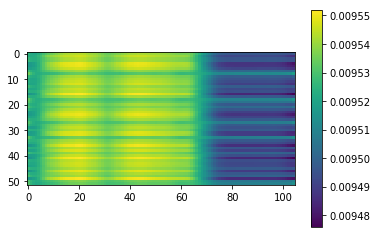

Calculated 340 Batches
Loss 340: 3.774275643484933
08-24 15:13:46


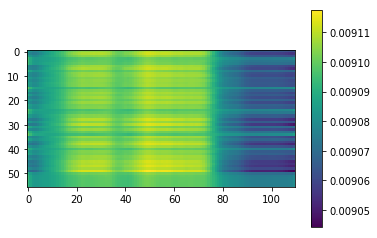

Calculated 350 Batches
Loss 350: 3.9485555376325334
08-24 15:13:49


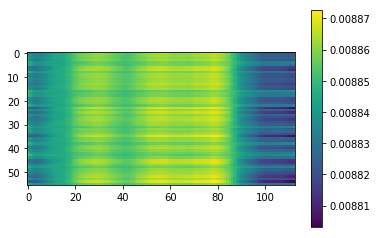

Calculated 360 Batches
Loss 360: 3.7547676086425783
08-24 15:13:52


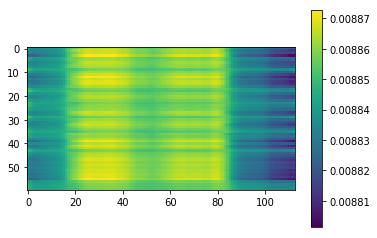

Calculated 370 Batches
Loss 370: 3.942032877604167
08-24 15:13:55


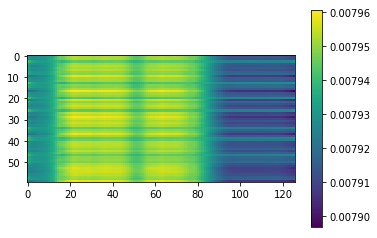

Calculated 380 Batches
Loss 380: 3.9538657665252686
08-24 15:13:58


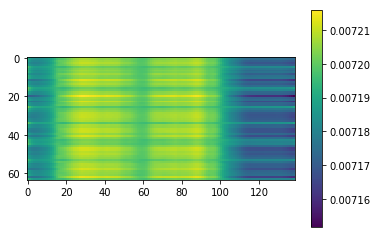

Calculated 390 Batches
Loss 390: 3.9667264152975643
08-24 15:14:01


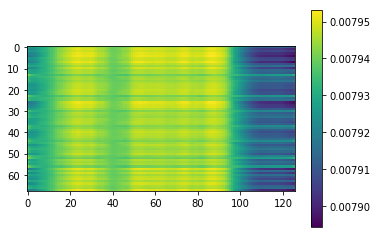

Calculated 400 Batches
Loss 400: 3.8415842923251065
08-24 15:14:05


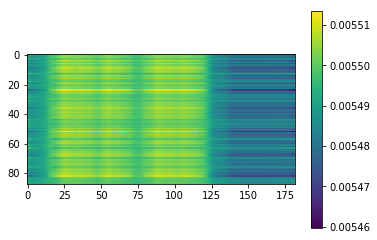

Mean Loss: 3.8798262970523
----------------------------------------------------
08-24 15:14:06
Calculated 10 Batches
Loss 10: 3.7421839237213135
08-24 15:14:07


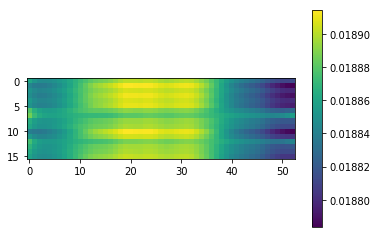

Calculated 20 Batches
Loss 20: 3.7513801574707033
08-24 15:14:08


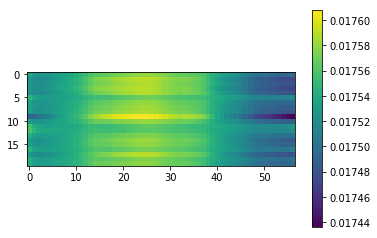

Calculated 30 Batches
Loss 30: 3.8224258422851562
08-24 15:14:09


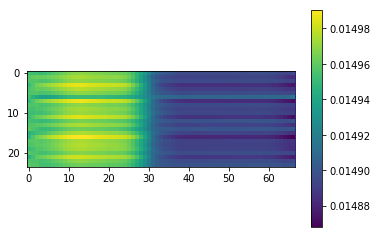

Calculated 40 Batches
Loss 40: 3.826033592224121
08-24 15:14:10


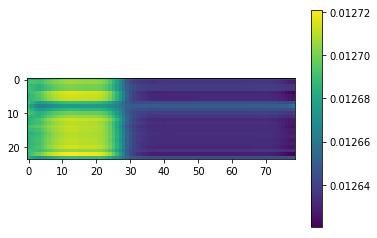

Calculated 50 Batches
Loss 50: 3.7702173505510603
08-24 15:14:11


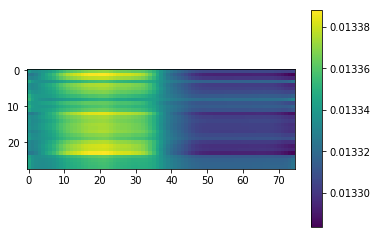

Calculated 60 Batches
Loss 60: 3.8490172794886996
08-24 15:14:12


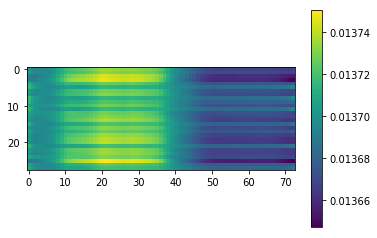

Calculated 70 Batches
Loss 70: 3.8189460209437778
08-24 15:14:14


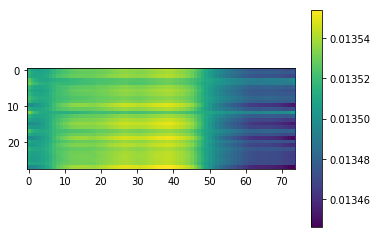

Calculated 80 Batches
Loss 80: 3.856797082083566
08-24 15:14:15


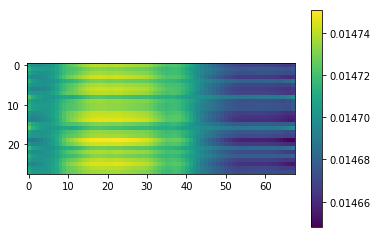

Calculated 90 Batches
Loss 90: 3.8966143131256104
08-24 15:14:16


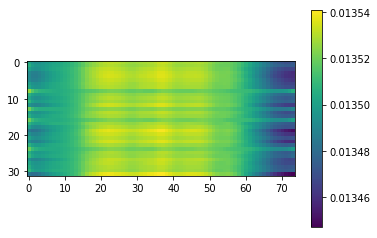

Calculated 100 Batches
Loss 100: 3.824038028717041
08-24 15:14:18


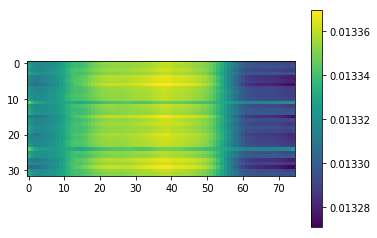

Calculated 110 Batches
Loss 110: 3.930053472518921
08-24 15:14:19


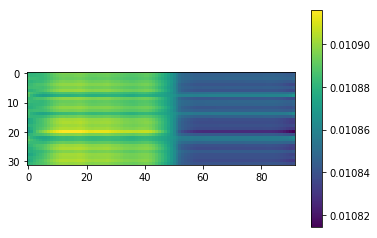

Calculated 120 Batches
Loss 120: 3.850144147872925
08-24 15:14:21


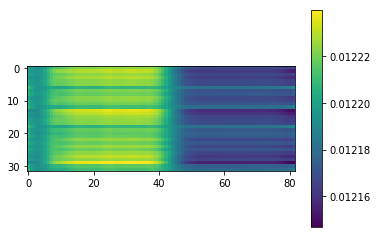

Calculated 130 Batches
Loss 130: 3.8646912574768066
08-24 15:14:22


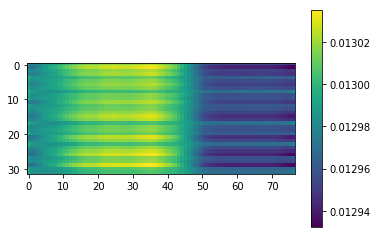

Calculated 140 Batches
Loss 140: 3.875989702012804
08-24 15:14:24


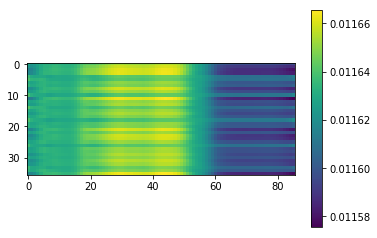

Calculated 150 Batches
Loss 150: 3.8796556260850696
08-24 15:14:25


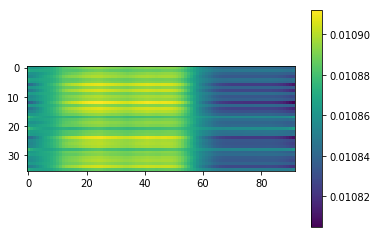

Calculated 160 Batches
Loss 160: 3.929942660861545
08-24 15:14:27


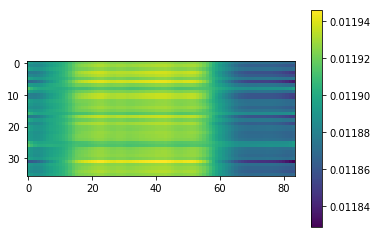

Calculated 170 Batches
Loss 170: 3.8841540018717446
08-24 15:14:29


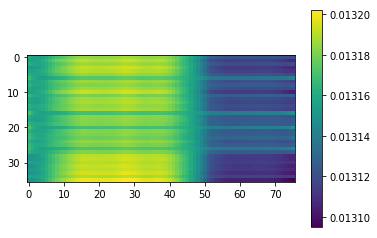

Calculated 180 Batches
Loss 180: 3.911321004231771
08-24 15:14:30


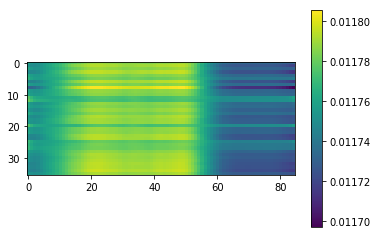

Calculated 190 Batches
Loss 190: 3.8822460174560547
08-24 15:14:32


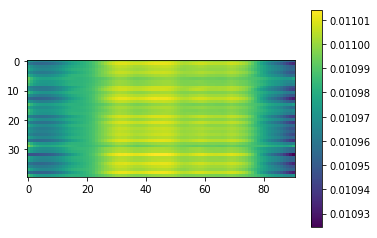

Calculated 200 Batches
Loss 200: 3.89196891784668
08-24 15:14:34


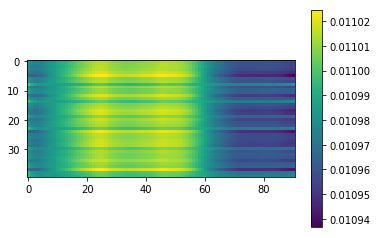

Calculated 210 Batches
Loss 210: 3.90618896484375
08-24 15:14:36


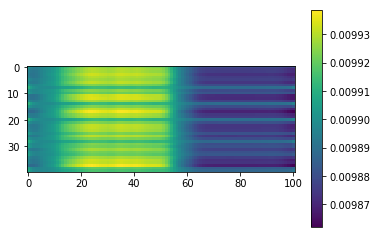

Calculated 220 Batches
Loss 220: 3.910293960571289
08-24 15:14:38


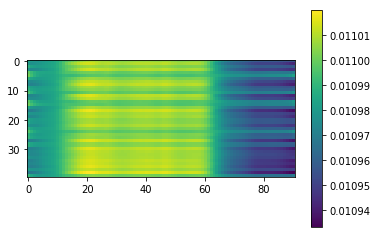

Calculated 230 Batches
Loss 230: 3.900679016113281
08-24 15:14:40


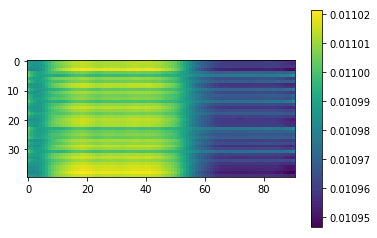

Calculated 240 Batches
Loss 240: 3.8970617814497515
08-24 15:14:42


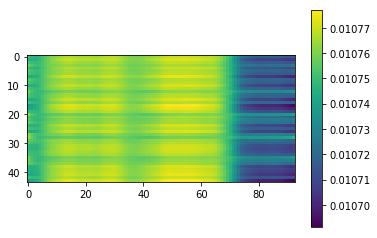

Calculated 250 Batches
Loss 250: 3.917978113347834
08-24 15:14:44


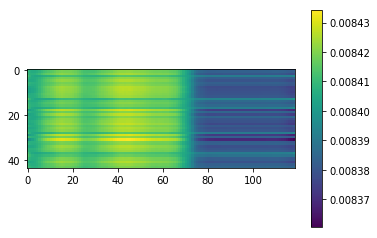

Calculated 260 Batches
Loss 260: 3.885057969526811
08-24 15:14:46


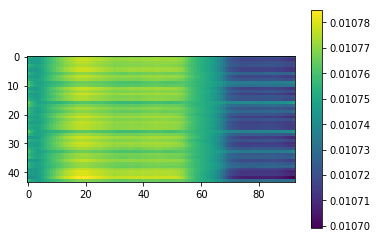

Calculated 270 Batches
Loss 270: 3.88845478404652
08-24 15:14:48


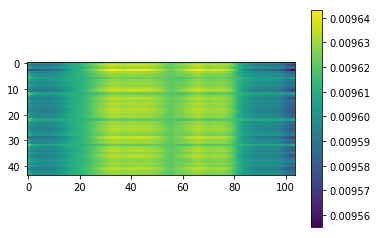

Calculated 280 Batches
Loss 280: 3.91153875986735
08-24 15:14:50


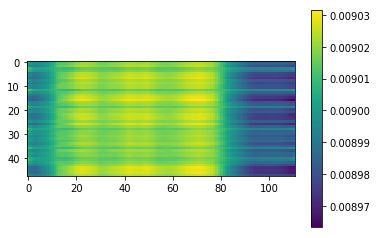

Calculated 290 Batches
Loss 290: 3.938675880432129
08-24 15:14:52


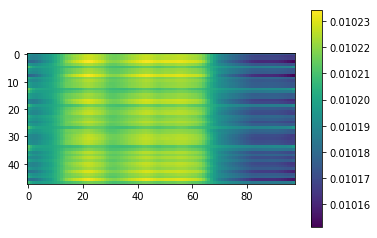

Calculated 300 Batches
Loss 300: 3.9495954513549805
08-24 15:14:54


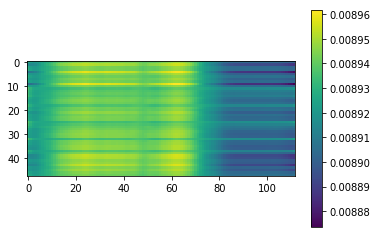

Calculated 310 Batches
Loss 310: 3.909073829650879
08-24 15:14:57


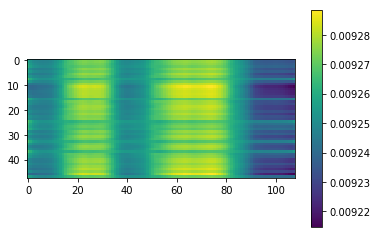

Calculated 320 Batches
Loss 320: 3.9390252920297475
08-24 15:14:59


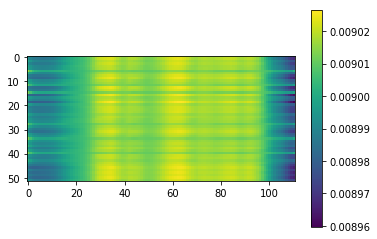

Calculated 330 Batches
Loss 330: 3.904935983511118
08-24 15:15:02


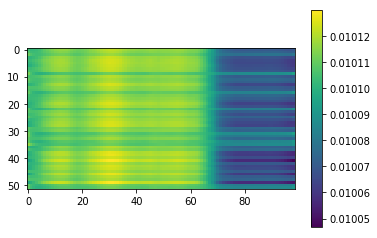

Calculated 340 Batches
Loss 340: 3.7919747488839284
08-24 15:15:04


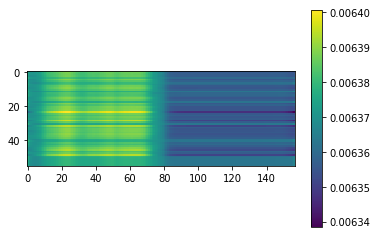

Calculated 350 Batches
Loss 350: 3.9321556091308594
08-24 15:15:07


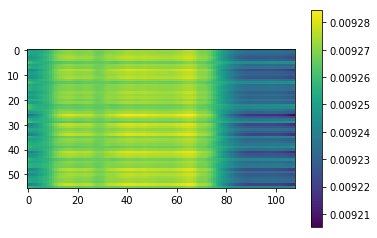

Calculated 360 Batches
Loss 360: 3.7318153381347656
08-24 15:15:09


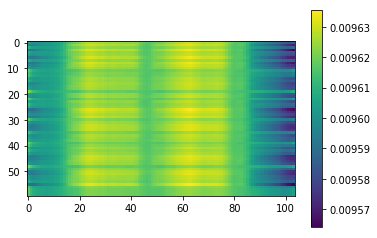

Calculated 370 Batches
Loss 370: 3.936676534016927
08-24 15:15:12


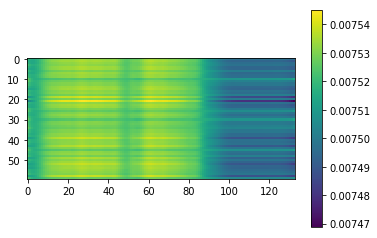

Calculated 380 Batches
Loss 380: 3.9559361934661865
08-24 15:15:15


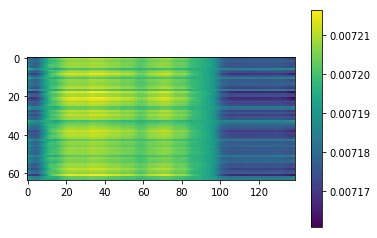

Calculated 390 Batches
Loss 390: 3.96092628030216
08-24 15:15:19


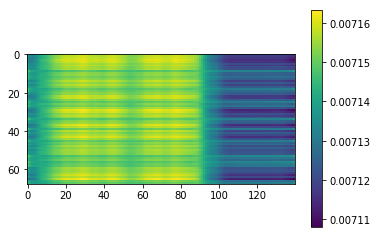

Calculated 400 Batches
Loss 400: 3.8400223471901636
08-24 15:15:23


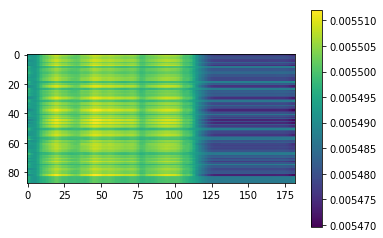

Mean Loss: 3.8794358134015785
----------------------------------------------------
08-24 15:15:24
Calculated 10 Batches
Loss 10: 3.737504243850708
08-24 15:15:24


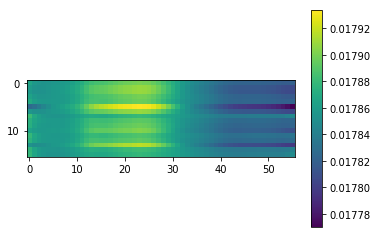

Calculated 20 Batches
Loss 20: 3.856606292724609
08-24 15:15:25


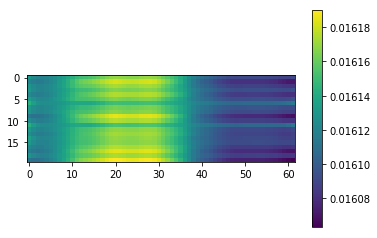

Calculated 30 Batches
Loss 30: 3.7713419596354165
08-24 15:15:26


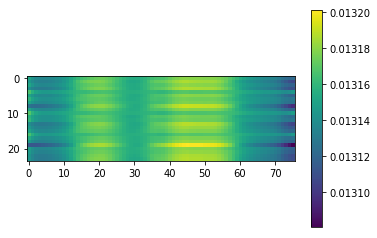

Calculated 40 Batches
Loss 40: 3.8733253479003906
08-24 15:15:28


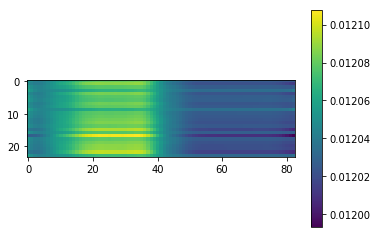

Calculated 50 Batches
Loss 50: 3.711735044206892
08-24 15:15:29


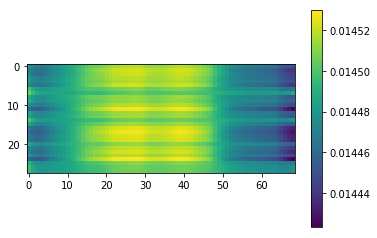

Calculated 60 Batches
Loss 60: 3.855020523071289
08-24 15:15:30


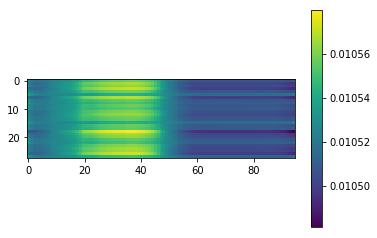

Calculated 70 Batches
Loss 70: 3.8021371023995534
08-24 15:15:31


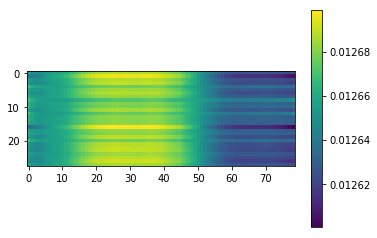

Calculated 80 Batches
Loss 80: 3.858299800327846
08-24 15:15:32


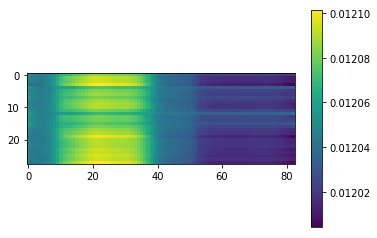

Calculated 90 Batches
Loss 90: 3.8511343002319336
08-24 15:15:34


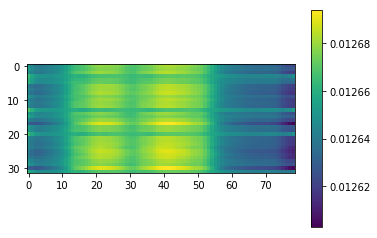

Calculated 100 Batches
Loss 100: 3.8629372119903564
08-24 15:15:35


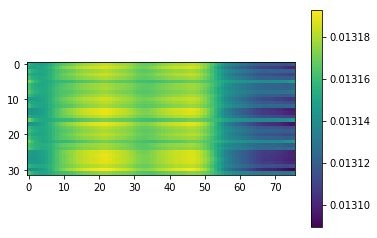

Calculated 110 Batches
Loss 110: 3.851907968521118
08-24 15:15:37


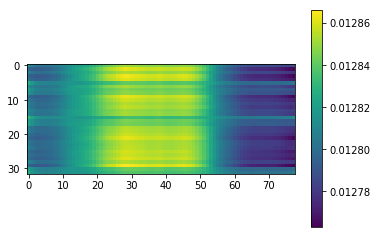

Calculated 120 Batches
Loss 120: 3.894608736038208
08-24 15:15:38


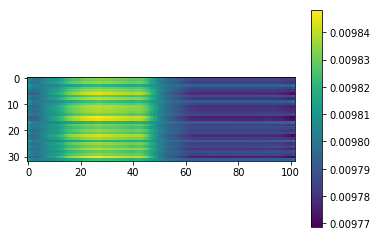

Calculated 130 Batches
Loss 130: 3.9052512645721436
08-24 15:15:40


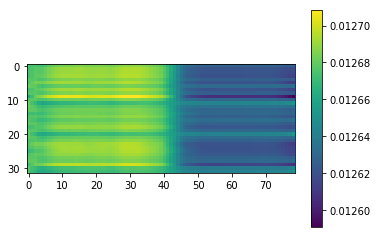

Calculated 140 Batches
Loss 140: 3.864996592203776
08-24 15:15:41


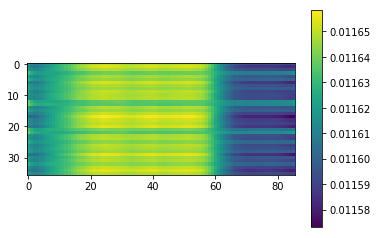

Calculated 150 Batches
Loss 150: 3.906283484564887
08-24 15:15:43


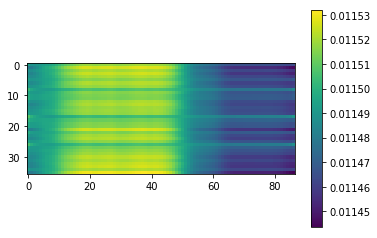

Calculated 160 Batches
Loss 160: 3.8827874925401478
08-24 15:15:45


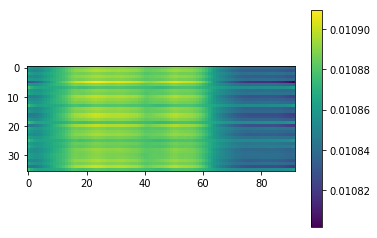

Calculated 170 Batches
Loss 170: 3.8760918511284723
08-24 15:15:46


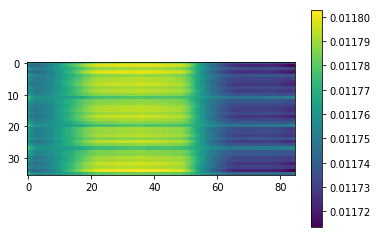

Calculated 180 Batches
Loss 180: 3.8589808146158853
08-24 15:15:48


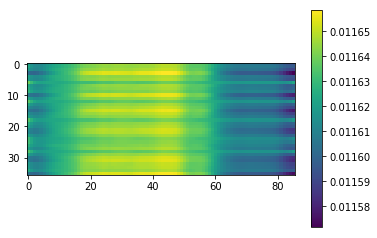

Calculated 190 Batches
Loss 190: 3.878337097167969
08-24 15:15:50


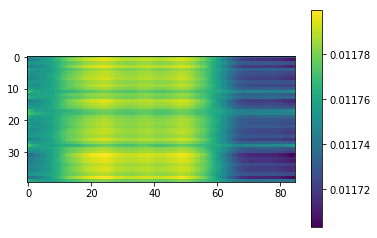

Calculated 200 Batches
Loss 200: 3.86932258605957
08-24 15:15:52


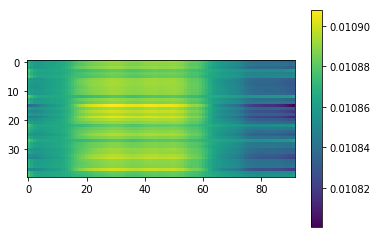

Calculated 210 Batches
Loss 210: 3.9068523406982423
08-24 15:15:54


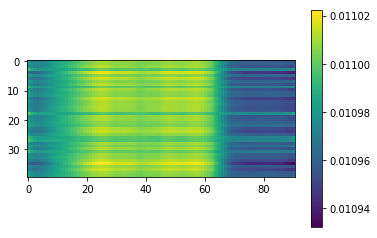

Calculated 220 Batches
Loss 220: 3.8945697784423827
08-24 15:15:55


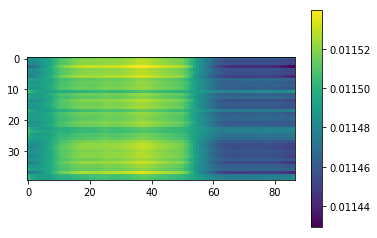

Calculated 230 Batches
Loss 230: 3.8860755920410157
08-24 15:15:57


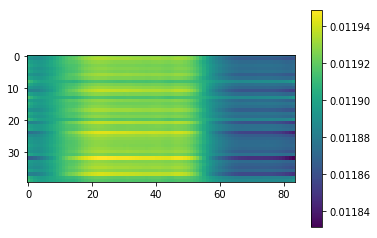

Calculated 240 Batches
Loss 240: 3.918673428622159
08-24 15:15:59


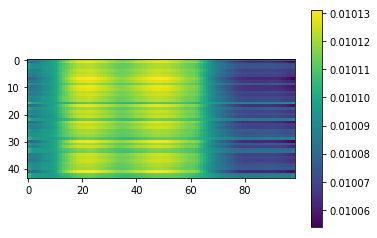

Calculated 250 Batches
Loss 250: 3.917892109264027
08-24 15:16:01


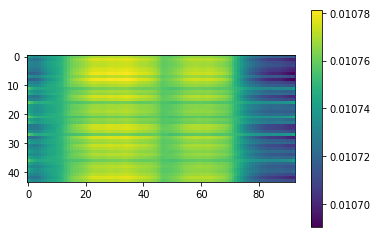

Calculated 260 Batches
Loss 260: 3.894731348211115
08-24 15:16:03


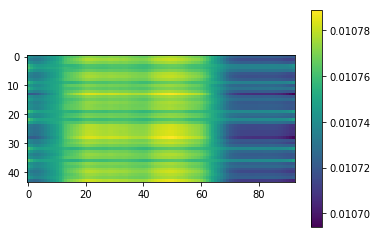

Calculated 270 Batches
Loss 270: 3.8877334594726562
08-24 15:16:05


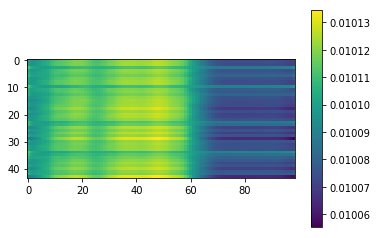

Calculated 280 Batches
Loss 280: 3.949434280395508
08-24 15:16:08


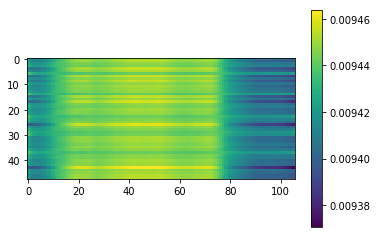

Calculated 290 Batches
Loss 290: 3.906153361002604
08-24 15:16:10


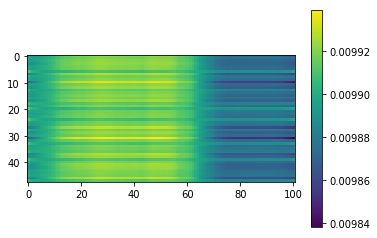

Calculated 300 Batches
Loss 300: 3.9362497329711914
08-24 15:16:12


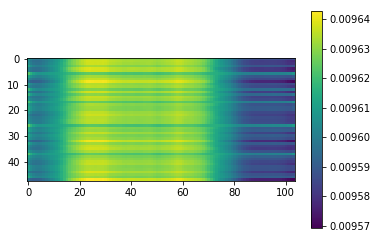

Calculated 310 Batches
Loss 310: 3.907766660054525
08-24 15:16:14


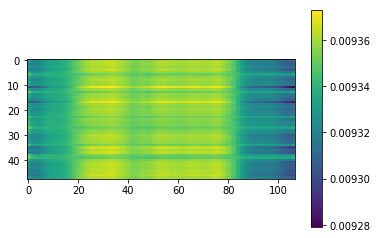

Calculated 320 Batches
Loss 320: 3.925373077392578
08-24 15:16:17


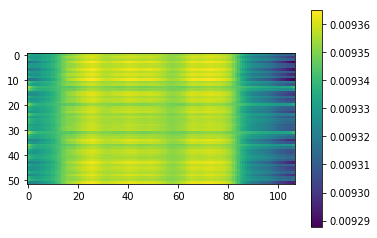

Calculated 330 Batches
Loss 330: 3.9730330247145433
08-24 15:16:19


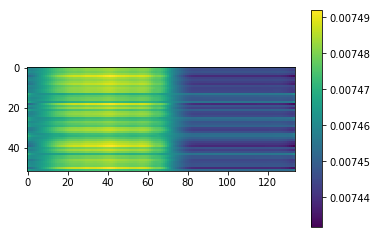

Calculated 340 Batches
Loss 340: 3.782449722290039
08-24 15:16:22


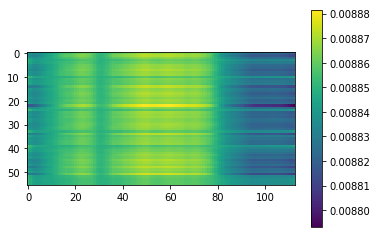

Calculated 350 Batches
Loss 350: 3.9512672424316406
08-24 15:16:25


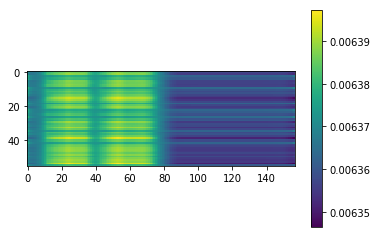

Calculated 360 Batches
Loss 360: 3.767375691731771
08-24 15:16:27


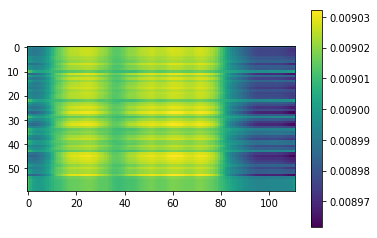

Calculated 370 Batches
Loss 370: 3.941228230794271
08-24 15:16:30


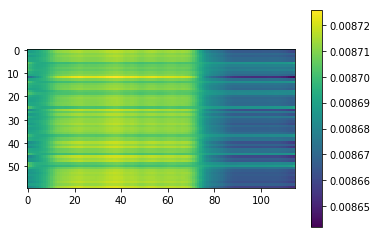

Calculated 380 Batches
Loss 380: 3.942626714706421
08-24 15:16:33


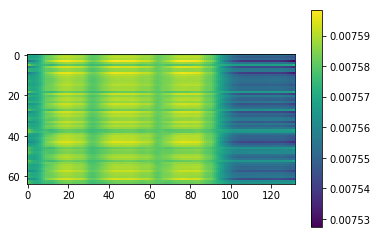

Calculated 390 Batches
Loss 390: 3.976900437298943
08-24 15:16:36


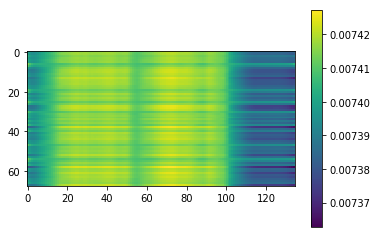

Calculated 400 Batches
Loss 400: 3.8414452292702417
08-24 15:16:40


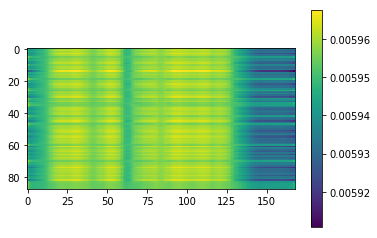

Mean Loss: 3.8793871789271175
----------------------------------------------------
08-24 15:16:42
Calculated 10 Batches
Loss 10: 3.6333558559417725
08-24 15:16:42


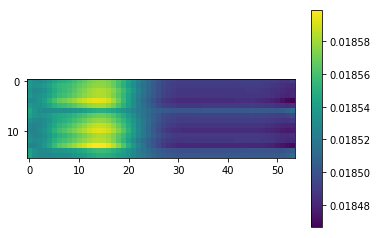

Calculated 20 Batches
Loss 20: 3.833660125732422
08-24 15:16:43


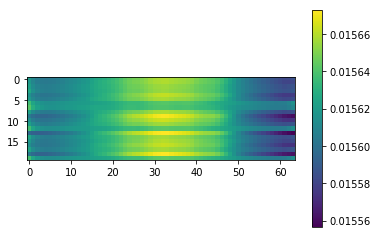

Calculated 30 Batches
Loss 30: 3.85042667388916
08-24 15:16:44


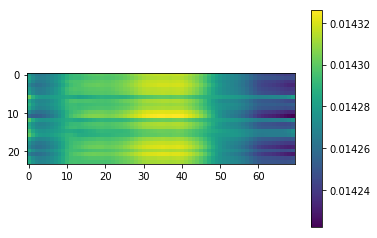

Calculated 40 Batches
Loss 40: 3.80955441792806
08-24 15:16:45


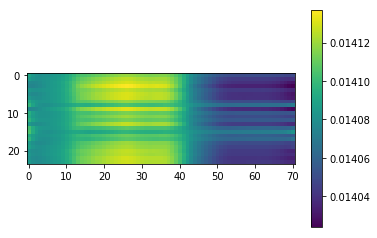

Calculated 50 Batches
Loss 50: 3.687237875802176
08-24 15:16:46


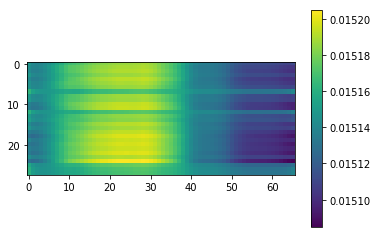

Calculated 60 Batches
Loss 60: 3.8672918592180525
08-24 15:16:48


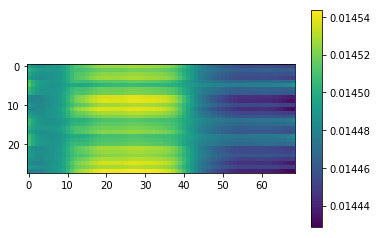

Calculated 70 Batches
Loss 70: 3.852228437151228
08-24 15:16:49


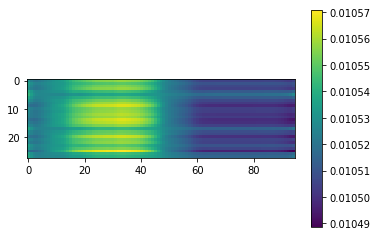

Calculated 80 Batches
Loss 80: 3.831977299281529
08-24 15:16:50


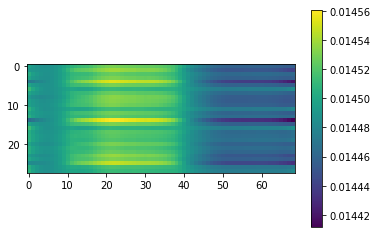

Calculated 90 Batches
Loss 90: 3.8768858909606934
08-24 15:16:51


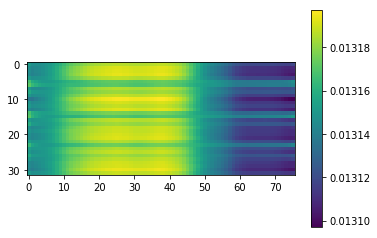

Calculated 100 Batches
Loss 100: 3.8704118728637695
08-24 15:16:53


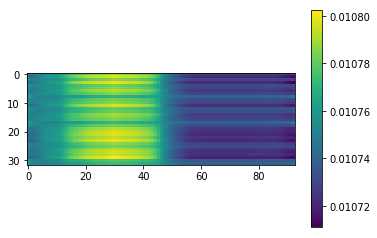

Calculated 110 Batches
Loss 110: 3.845332145690918
08-24 15:16:54


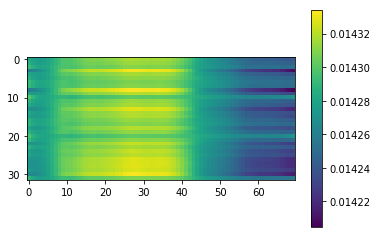

Calculated 120 Batches
Loss 120: 3.8437979221343994
08-24 15:16:56


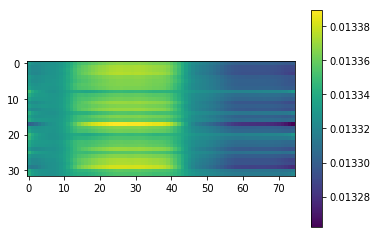

Calculated 130 Batches
Loss 130: 3.854987621307373
08-24 15:16:57


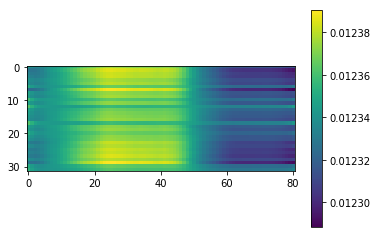

Calculated 140 Batches
Loss 140: 3.9291508992513022
08-24 15:16:59


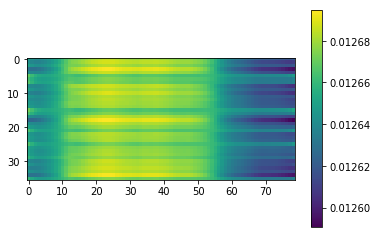

Calculated 150 Batches
Loss 150: 3.856138441297743
08-24 15:17:01


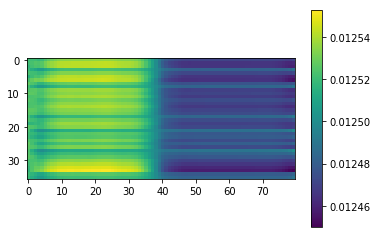

Calculated 160 Batches
Loss 160: 3.8937831454806857
08-24 15:17:02


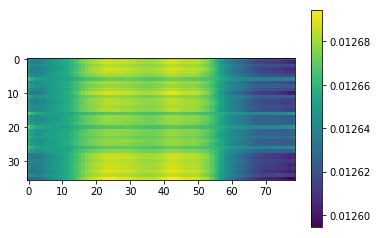

Calculated 170 Batches
Loss 170: 3.878406524658203
08-24 15:17:04


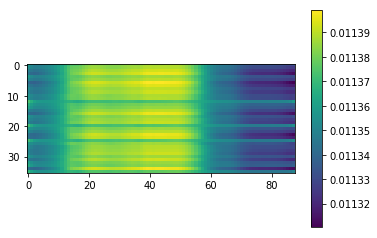

Calculated 180 Batches
Loss 180: 3.889931148952908
08-24 15:17:06


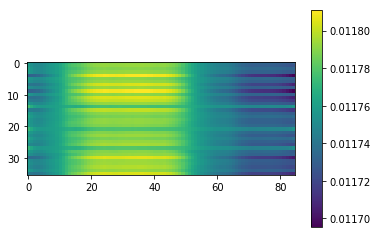

Calculated 190 Batches
Loss 190: 3.880319595336914
08-24 15:17:08


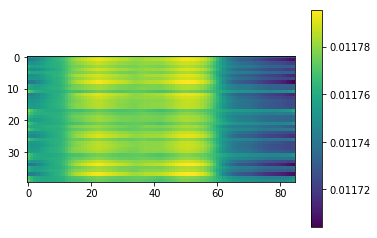

Calculated 200 Batches
Loss 200: 3.9563152313232424
08-24 15:17:09


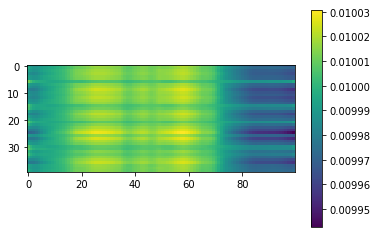

Calculated 210 Batches
Loss 210: 3.912545013427734
08-24 15:17:11


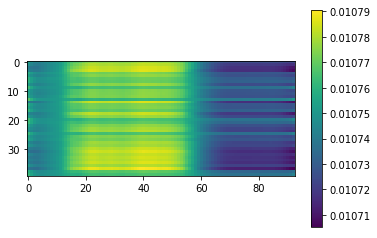

Calculated 220 Batches
Loss 220: 3.8898090362548827
08-24 15:17:13


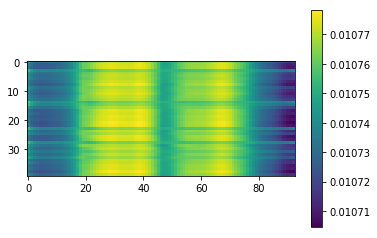

Calculated 230 Batches
Loss 230: 3.848777008056641
08-24 15:17:15


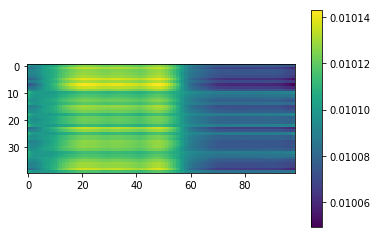

Calculated 240 Batches
Loss 240: 3.8921682184392754
08-24 15:17:17


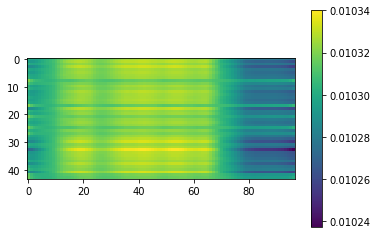

Calculated 250 Batches
Loss 250: 3.897011496803977
08-24 15:17:19


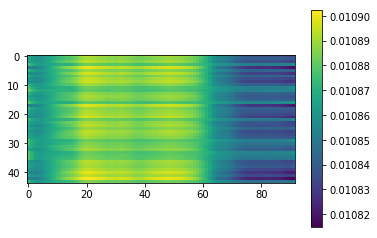

Calculated 260 Batches
Loss 260: 3.8764475042169746
08-24 15:17:21


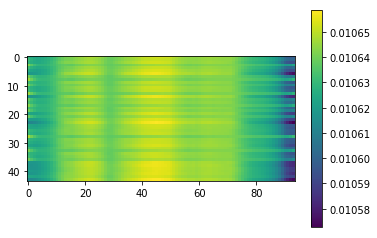

Calculated 270 Batches
Loss 270: 3.9088394858620386
08-24 15:17:23


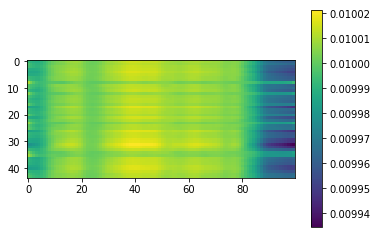

Calculated 280 Batches
Loss 280: 3.9284543991088867
08-24 15:17:25


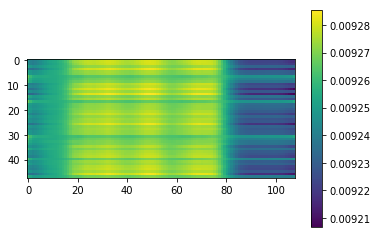

Calculated 290 Batches
Loss 290: 3.9553794860839844
08-24 15:17:27


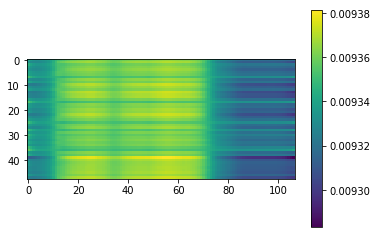

Calculated 300 Batches
Loss 300: 3.9092286427815757
08-24 15:17:30


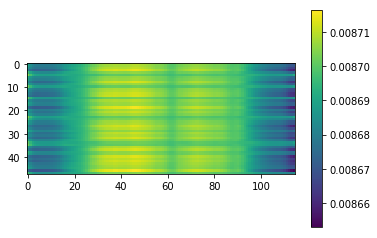

Calculated 310 Batches
Loss 310: 3.9126437505086265
08-24 15:17:32


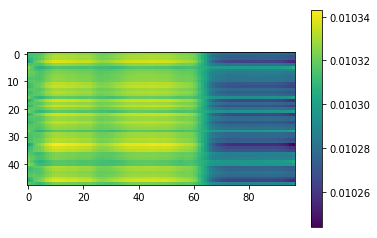

Calculated 320 Batches
Loss 320: 3.9241297795222354
08-24 15:17:34


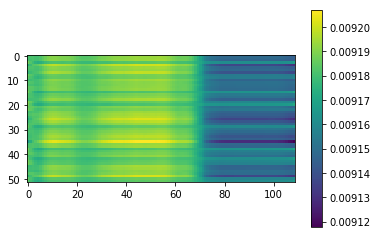

Calculated 330 Batches
Loss 330: 3.9176439138559194
08-24 15:17:37


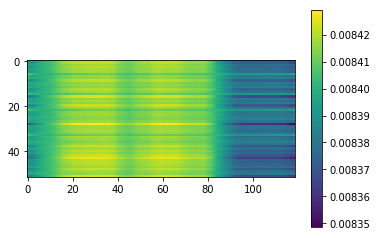

Calculated 340 Batches
Loss 340: 3.7858785901750838
08-24 15:17:40


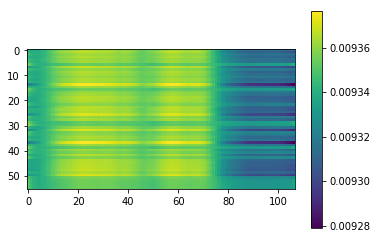

Calculated 350 Batches
Loss 350: 3.942981447492327
08-24 15:17:42


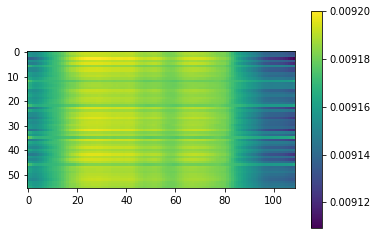

Calculated 360 Batches
Loss 360: 3.7577163696289064
08-24 15:17:45


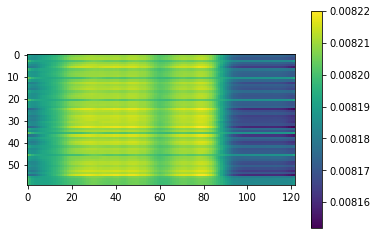

Calculated 370 Batches
Loss 370: 3.9354214986165363
08-24 15:17:48


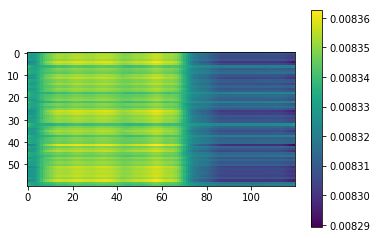

Calculated 380 Batches
Loss 380: 3.9447100162506104
08-24 15:17:51


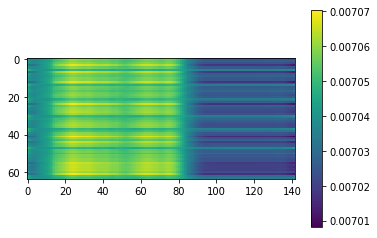

Calculated 390 Batches
Loss 390: 3.9778388528262867
08-24 15:17:54


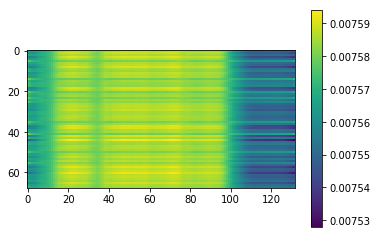

Calculated 400 Batches
Loss 400: 3.8333331021395596
08-24 15:17:58


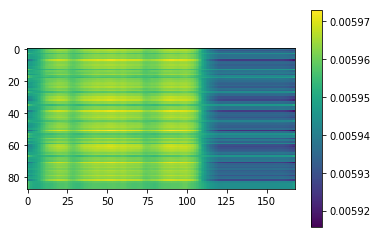

Mean Loss: 3.879389601099654
----------------------------------------------------
08-24 15:17:59
Calculated 10 Batches
Loss 10: 3.7416226863861084
08-24 15:18:00


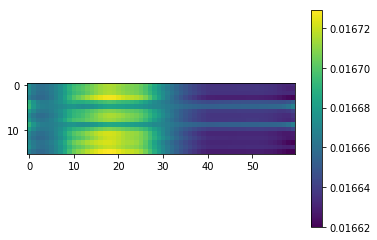

Calculated 20 Batches
Loss 20: 3.797657775878906
08-24 15:18:01


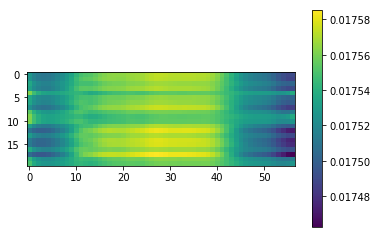

Calculated 30 Batches
Loss 30: 3.860912005106608
08-24 15:18:02


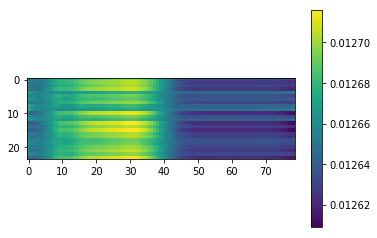

Calculated 40 Batches
Loss 40: 3.824843406677246
08-24 15:18:03


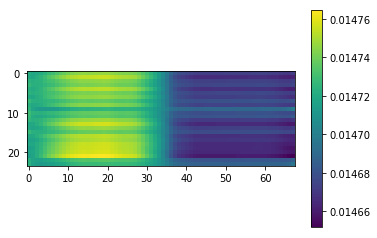

Calculated 50 Batches
Loss 50: 3.699617658342634
08-24 15:18:04


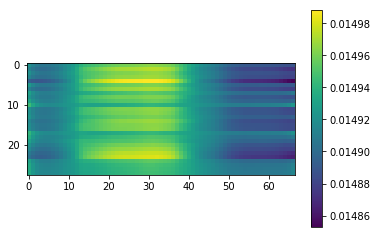

Calculated 60 Batches
Loss 60: 3.8644646235874722
08-24 15:18:05


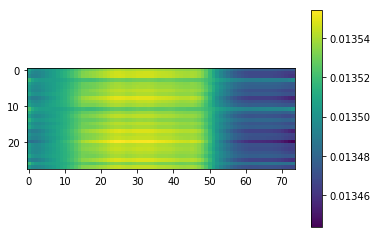

Calculated 70 Batches
Loss 70: 3.866056169782366
08-24 15:18:07


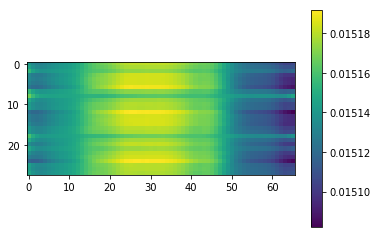

Calculated 80 Batches
Loss 80: 3.8385222298758372
08-24 15:18:08


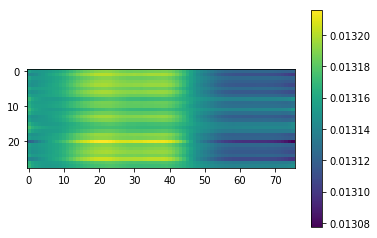

Calculated 90 Batches
Loss 90: 3.8589141368865967
08-24 15:18:10


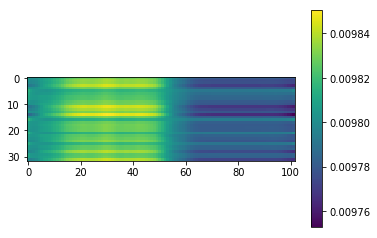

Calculated 100 Batches
Loss 100: 3.8691658973693848
08-24 15:18:11


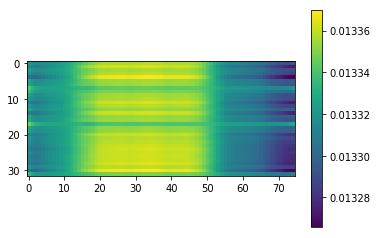

Calculated 110 Batches
Loss 110: 3.8696064949035645
08-24 15:18:12


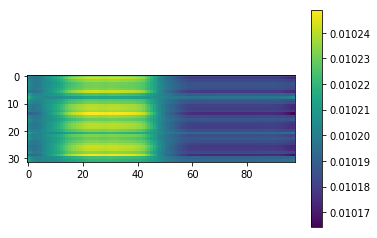

Calculated 120 Batches
Loss 120: 3.8584024906158447
08-24 15:18:14


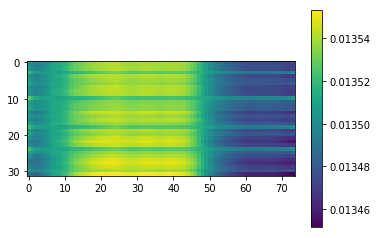

Calculated 130 Batches
Loss 130: 3.8826935291290283
08-24 15:18:15


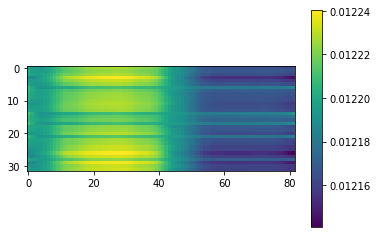

Calculated 140 Batches
Loss 140: 3.84529791937934
08-24 15:18:17


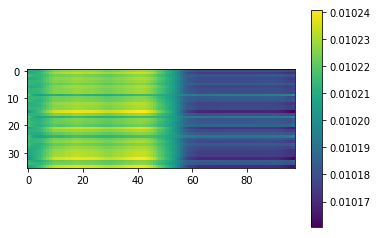

Calculated 150 Batches
Loss 150: 3.8433914184570312
08-24 15:18:19


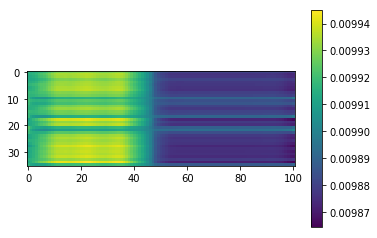

Calculated 160 Batches
Loss 160: 3.8991288079155817
08-24 15:18:20


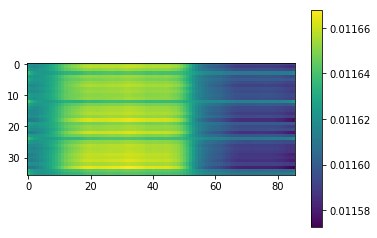

Calculated 170 Batches
Loss 170: 3.8761622111002603
08-24 15:18:22


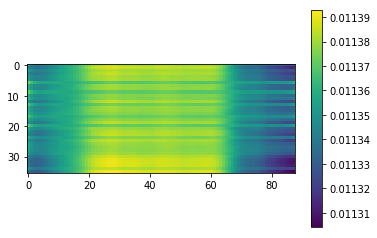

Calculated 180 Batches
Loss 180: 3.926844702826606
08-24 15:18:24


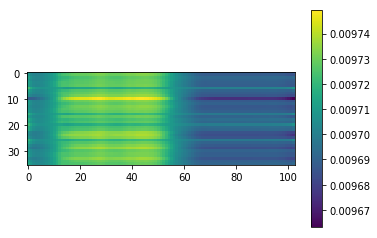

Calculated 190 Batches
Loss 190: 3.8825145721435548
08-24 15:18:25


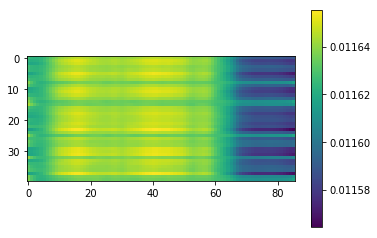

Calculated 200 Batches
Loss 200: 3.90844612121582
08-24 15:18:27


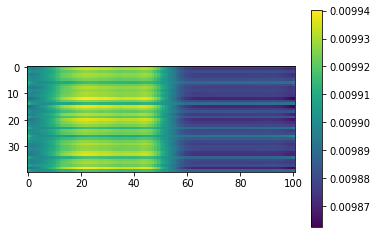

Calculated 210 Batches
Loss 210: 3.9152347564697267
08-24 15:18:29


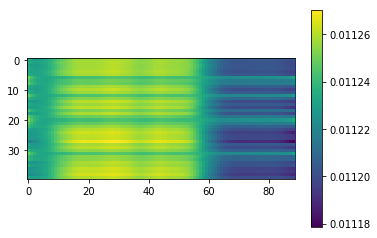

Calculated 220 Batches
Loss 220: 3.9024627685546873
08-24 15:18:31


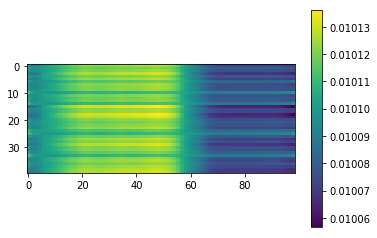

Calculated 230 Batches
Loss 230: 3.9557437896728516
08-24 15:18:33


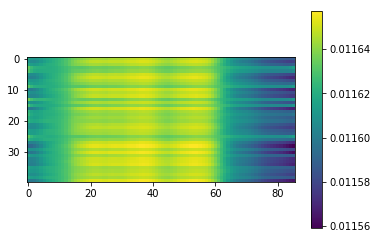

Calculated 240 Batches
Loss 240: 3.9261769381436435
08-24 15:18:35


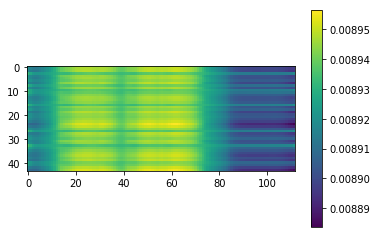

Calculated 250 Batches
Loss 250: 3.924360448663885
08-24 15:18:37


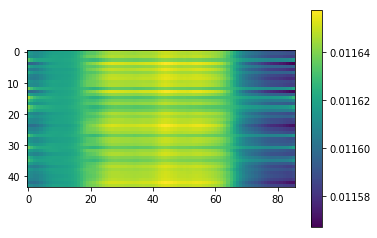

Calculated 260 Batches
Loss 260: 3.9261363636363638
08-24 15:18:39


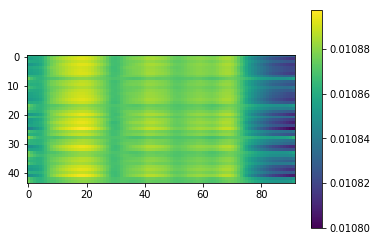

Calculated 270 Batches
Loss 270: 3.8848006508567114
08-24 15:18:41


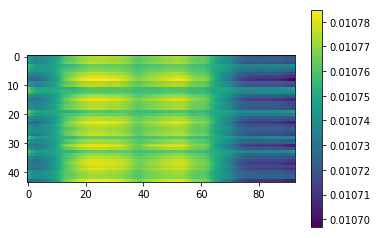

Calculated 280 Batches
Loss 280: 3.912452061971029
08-24 15:18:43


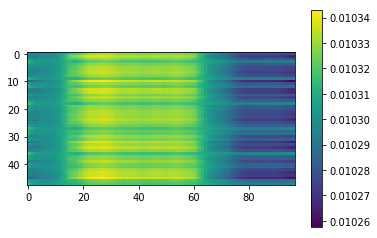

Calculated 290 Batches
Loss 290: 3.9058567682902017
08-24 15:18:45


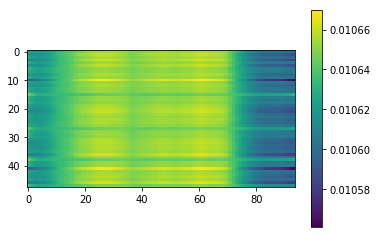

Calculated 300 Batches
Loss 300: 3.904815991719564
08-24 15:18:48


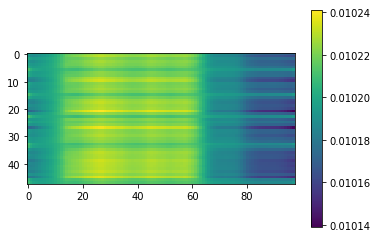

Calculated 310 Batches
Loss 310: 3.949570655822754
08-24 15:18:50


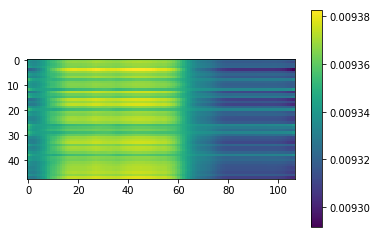

Calculated 320 Batches
Loss 320: 3.9297511761005106
08-24 15:18:52


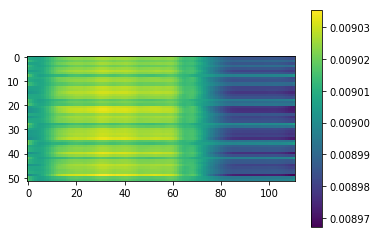

Calculated 330 Batches
Loss 330: 3.934876955472506
08-24 15:18:55


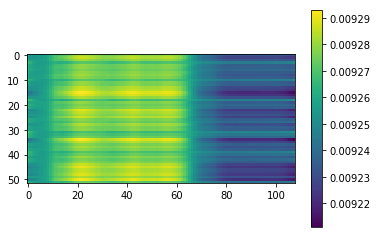

Calculated 340 Batches
Loss 340: 3.803783416748047
08-24 15:18:57


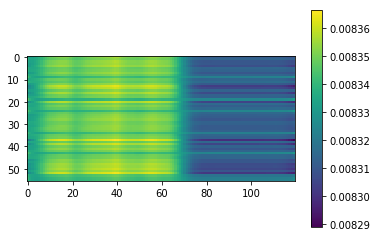

Calculated 350 Batches
Loss 350: 3.910243443080357
08-24 15:19:00


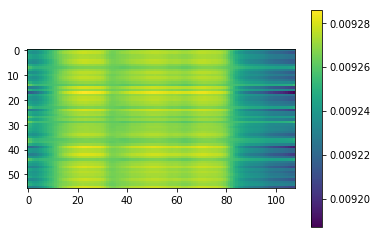

Calculated 360 Batches
Loss 360: 3.759010823567708
08-24 15:19:03


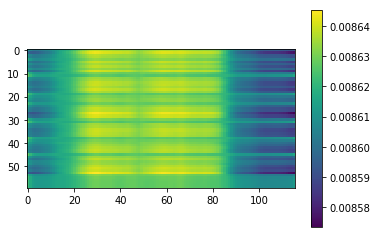

Calculated 370 Batches
Loss 370: 3.921470133463542
08-24 15:19:05


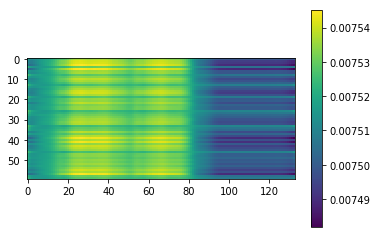

Calculated 380 Batches
Loss 380: 3.9437272548675537
08-24 15:19:08


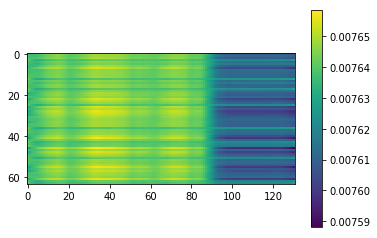

Calculated 390 Batches
Loss 390: 3.9677945305319393
08-24 15:19:12


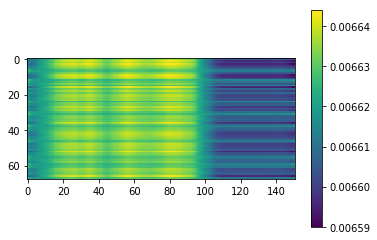

Calculated 400 Batches
Loss 400: 3.8353968533602627
08-24 15:19:16


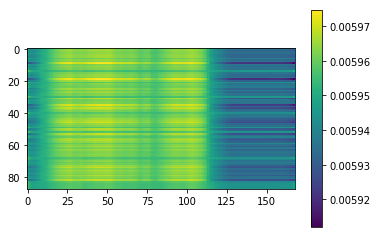

Mean Loss: 3.8789129938499034
----------------------------------------------------
08-24 15:19:17
Calculated 10 Batches
Loss 10: 3.780728816986084
08-24 15:19:17


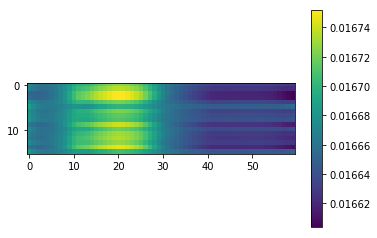

Calculated 20 Batches
Loss 20: 3.753887939453125
08-24 15:19:18


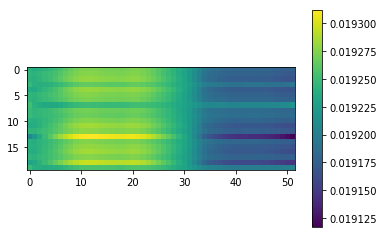

Calculated 30 Batches
Loss 30: 3.879696846008301
08-24 15:19:19


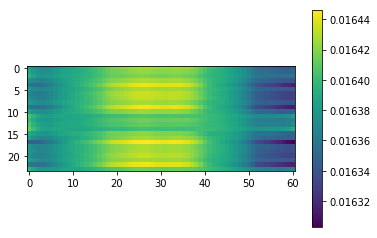

Calculated 40 Batches
Loss 40: 3.8312082290649414
08-24 15:19:21


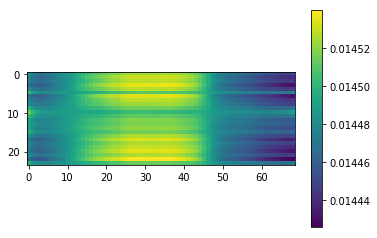

Calculated 50 Batches
Loss 50: 3.731825147356306
08-24 15:19:22


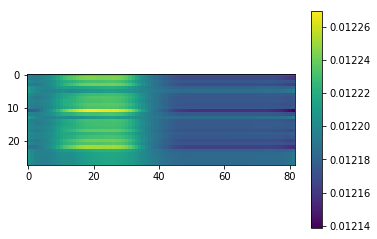

Calculated 60 Batches
Loss 60: 3.8534494127546037
08-24 15:19:23


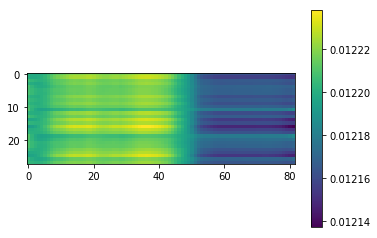

Calculated 70 Batches
Loss 70: 3.83402224949428
08-24 15:19:24


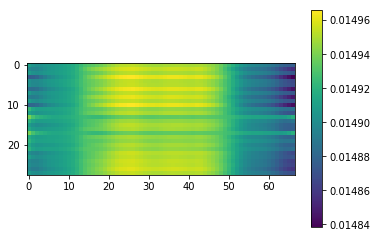

Calculated 80 Batches
Loss 80: 3.8236427307128906
08-24 15:19:26


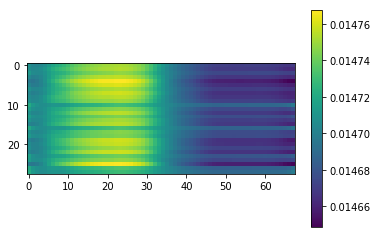

Calculated 90 Batches
Loss 90: 3.9081788063049316
08-24 15:19:27


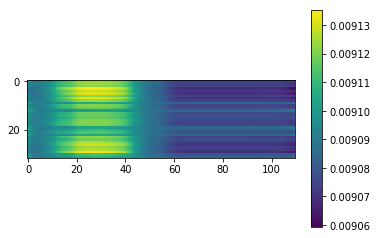

Calculated 100 Batches
Loss 100: 3.837677478790283
08-24 15:19:29


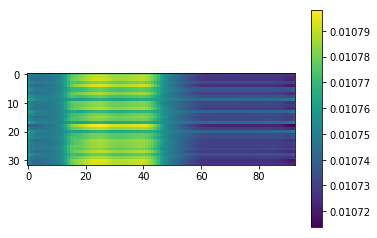

Calculated 110 Batches
Loss 110: 3.889775276184082
08-24 15:19:30


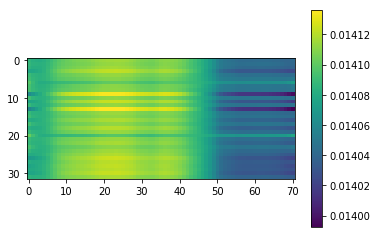

Calculated 120 Batches
Loss 120: 3.8753180503845215
08-24 15:19:31


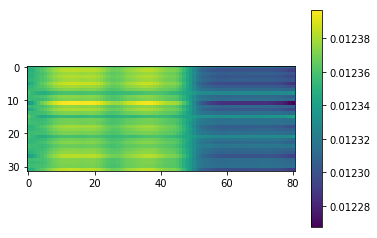

Calculated 130 Batches
Loss 130: 3.8422696590423584
08-24 15:19:33


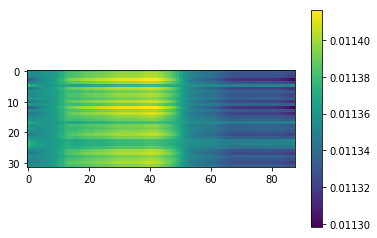

Calculated 140 Batches
Loss 140: 3.867633819580078
08-24 15:19:34


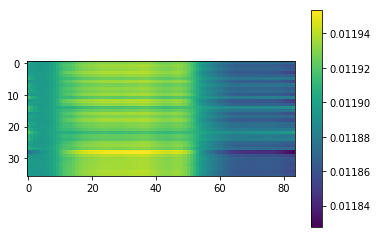

Calculated 150 Batches
Loss 150: 3.8707203335232205
08-24 15:19:36


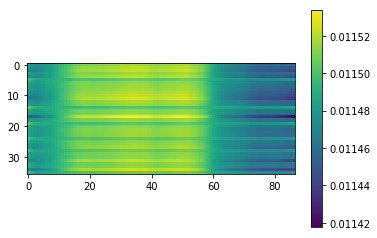

Calculated 160 Batches
Loss 160: 3.855290730794271
08-24 15:19:38


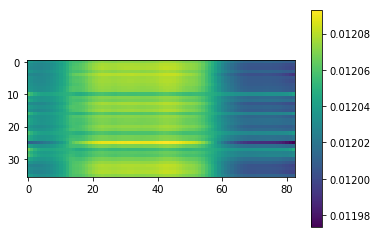

Calculated 170 Batches
Loss 170: 3.8776643541124134
08-24 15:19:39


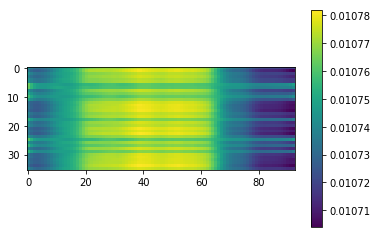

Calculated 180 Batches
Loss 180: 3.9178309970431857
08-24 15:19:41


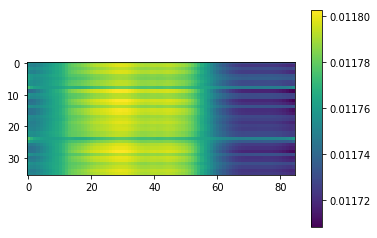

Calculated 190 Batches
Loss 190: 3.8994071960449217
08-24 15:19:43


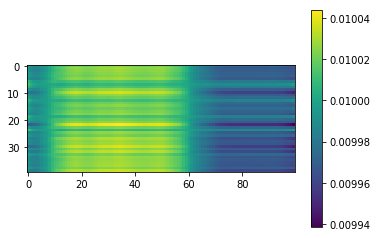

Calculated 200 Batches
Loss 200: 3.8953296661376955
08-24 15:19:45


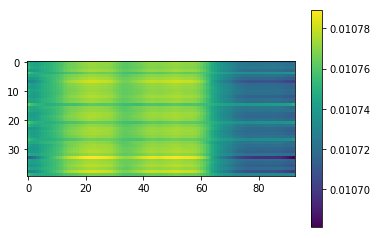

Calculated 210 Batches
Loss 210: 3.898406982421875
08-24 15:19:47


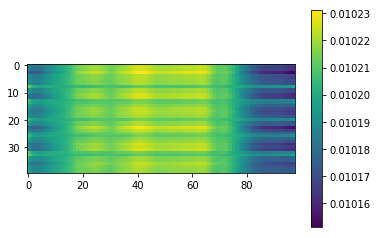

Calculated 220 Batches
Loss 220: 3.9305755615234377
08-24 15:19:48


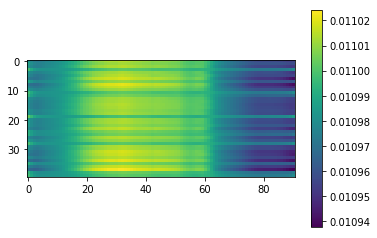

Calculated 230 Batches
Loss 230: 3.907335662841797
08-24 15:19:50


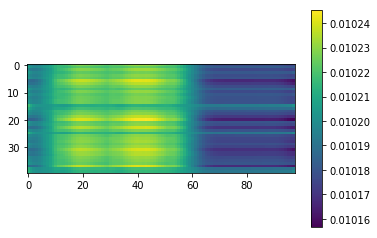

Calculated 240 Batches
Loss 240: 3.9163183732466265
08-24 15:19:52


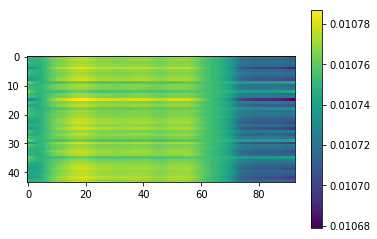

Calculated 250 Batches
Loss 250: 3.9270796342329546
08-24 15:19:54


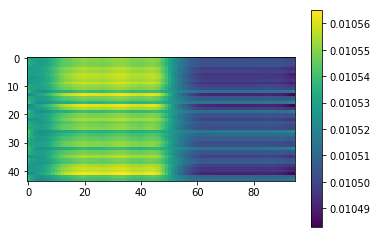

Calculated 260 Batches
Loss 260: 3.89398193359375
08-24 15:19:56


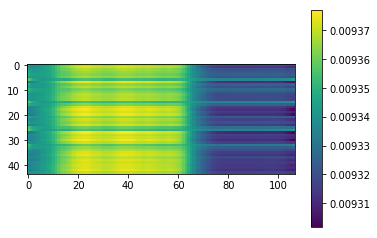

Calculated 270 Batches
Loss 270: 3.88600678877397
08-24 15:19:59


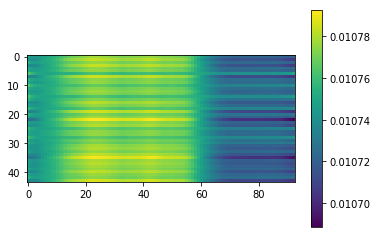

Calculated 280 Batches
Loss 280: 3.8846511840820312
08-24 15:20:01


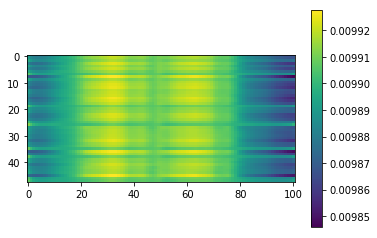

Calculated 290 Batches
Loss 290: 3.9061047236124673
08-24 15:20:03


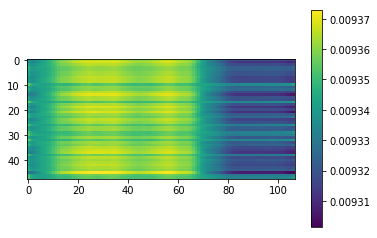

Calculated 300 Batches
Loss 300: 3.8988189697265625
08-24 15:20:05


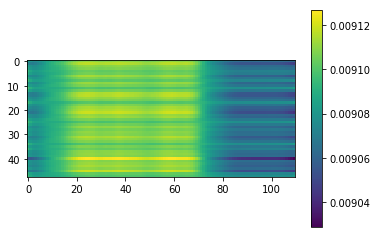

Calculated 310 Batches
Loss 310: 3.9032214482625327
08-24 15:20:07


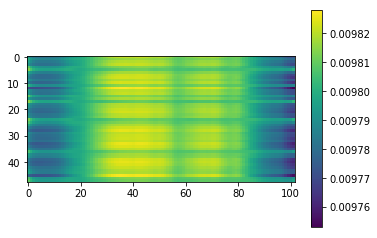

Calculated 320 Batches
Loss 320: 3.927342341496394
08-24 15:20:10


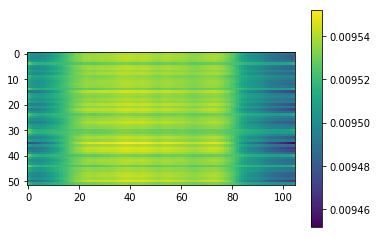

Calculated 330 Batches
Loss 330: 3.9324026841383715
08-24 15:20:12


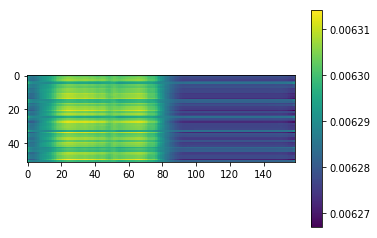

Calculated 340 Batches
Loss 340: 3.8023291996547153
08-24 15:20:15


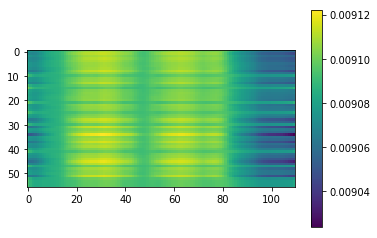

Calculated 350 Batches
Loss 350: 3.924424580165318
08-24 15:20:17


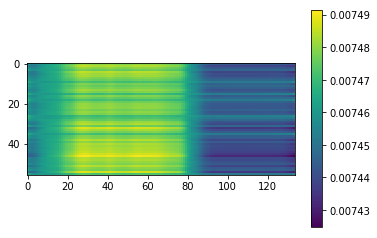

Calculated 360 Batches
Loss 360: 3.748668924967448
08-24 15:20:20


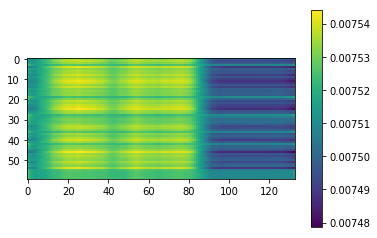

Calculated 370 Batches
Loss 370: 3.9321469624837238
08-24 15:20:23


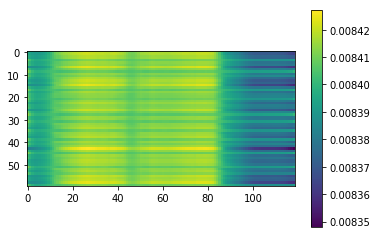

Calculated 380 Batches
Loss 380: 3.9590790271759033
08-24 15:20:26


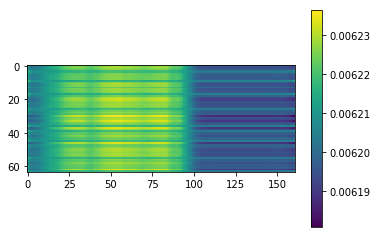

Calculated 390 Batches
Loss 390: 3.942565020392923
08-24 15:20:29


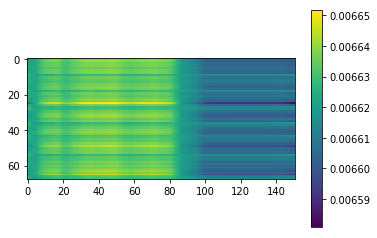

Calculated 400 Batches
Loss 400: 3.8356541720303623
08-24 15:20:33


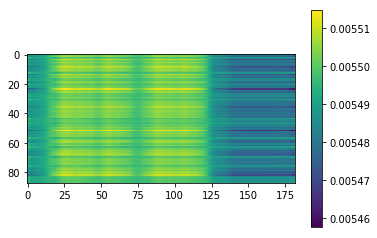

Mean Loss: 3.879128641679706
----------------------------------------------------
08-24 15:20:35
Calculated 10 Batches
Loss 10: 3.796827554702759
08-24 15:20:35


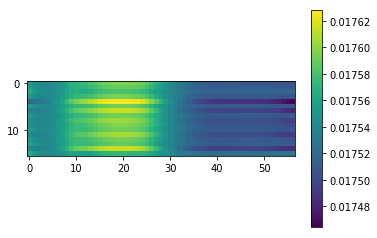

Calculated 20 Batches
Loss 20: 3.7982433319091795
08-24 15:20:36


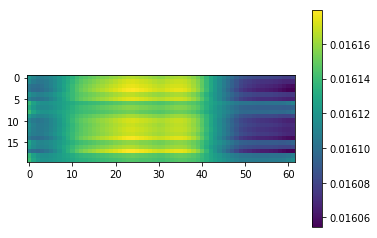

Calculated 30 Batches
Loss 30: 3.87486998240153
08-24 15:20:37


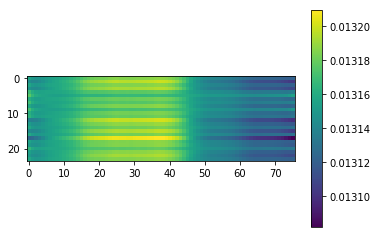

Calculated 40 Batches
Loss 40: 3.8717896143595376
08-24 15:20:38


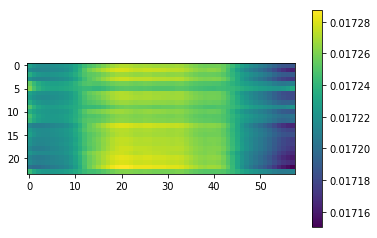

Calculated 50 Batches
Loss 50: 3.7444542476109097
08-24 15:20:39


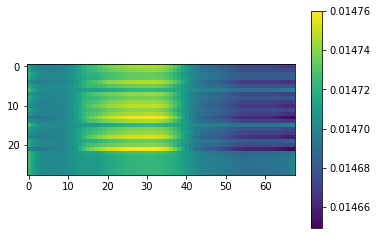

Calculated 60 Batches
Loss 60: 3.8511717660086497
08-24 15:20:41


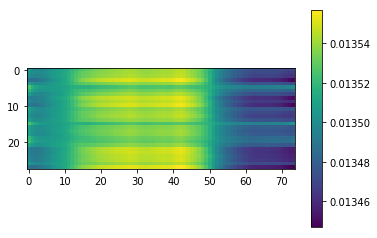

Calculated 70 Batches
Loss 70: 3.845980780465262
08-24 15:20:42


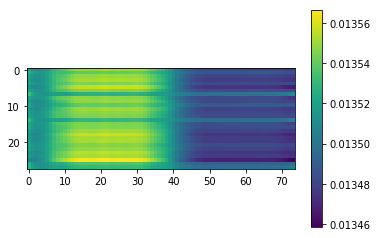

Calculated 80 Batches
Loss 80: 3.849529538835798
08-24 15:20:43


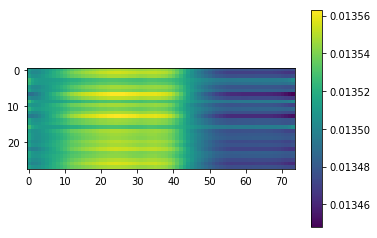

Calculated 90 Batches
Loss 90: 3.873750925064087
08-24 15:20:45


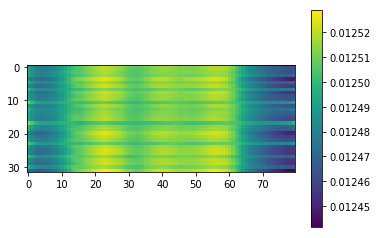

Calculated 100 Batches
Loss 100: 3.895073652267456
08-24 15:20:46


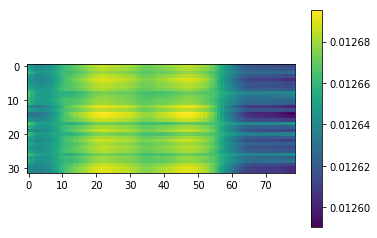

Calculated 110 Batches
Loss 110: 3.8360822200775146
08-24 15:20:47


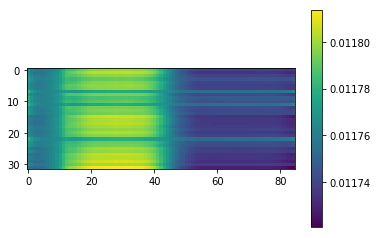

Calculated 120 Batches
Loss 120: 3.886613607406616
08-24 15:20:49


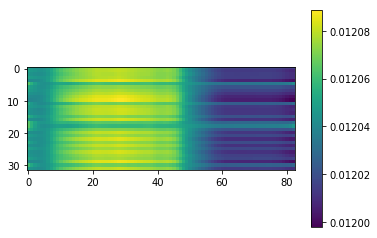

Calculated 130 Batches
Loss 130: 3.8539981842041016
08-24 15:20:50


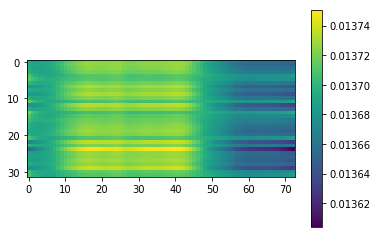

Calculated 140 Batches
Loss 140: 3.8984544542100696
08-24 15:20:52


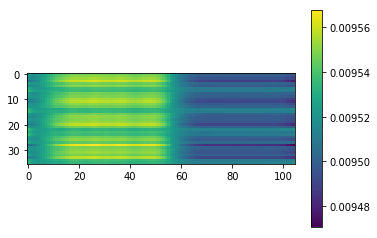

Calculated 150 Batches
Loss 150: 3.913710276285807
08-24 15:20:54


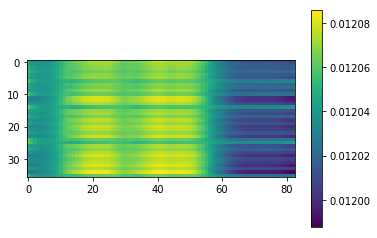

Calculated 160 Batches
Loss 160: 3.855693817138672
08-24 15:20:55


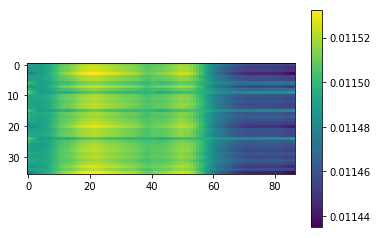

Calculated 170 Batches
Loss 170: 3.885380638970269
08-24 15:20:57


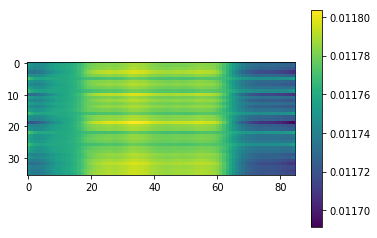

Calculated 180 Batches
Loss 180: 3.942011515299479
08-24 15:20:59


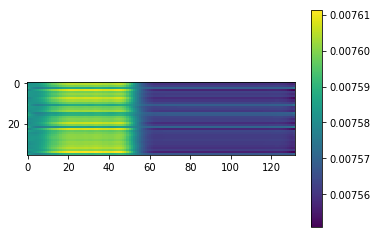

Calculated 190 Batches
Loss 190: 3.886626434326172
08-24 15:21:01


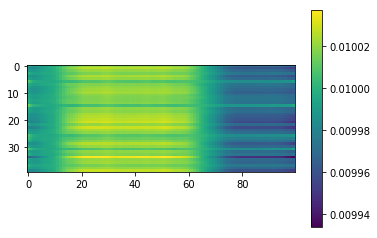

Calculated 200 Batches
Loss 200: 3.9080322265625
08-24 15:21:02


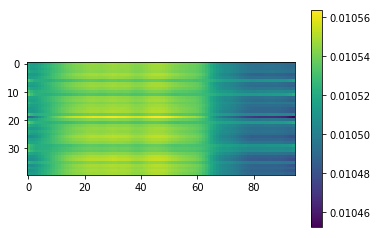

Calculated 210 Batches
Loss 210: 3.8966930389404295
08-24 15:21:04


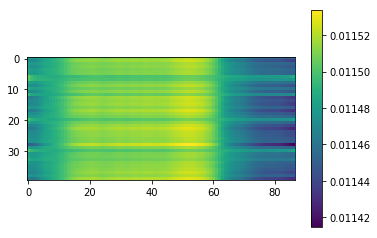

Calculated 220 Batches
Loss 220: 3.902964782714844
08-24 15:21:06


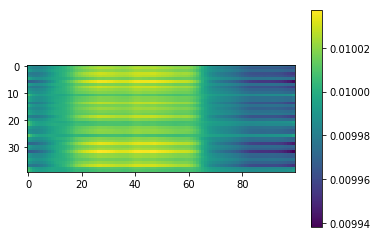

Calculated 230 Batches
Loss 230: 3.90527229309082
08-24 15:21:08


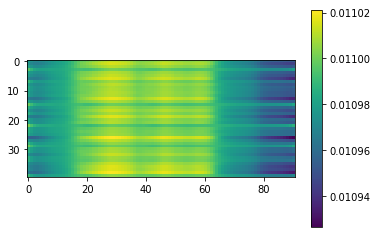

Calculated 240 Batches
Loss 240: 3.9177814830433237
08-24 15:21:10


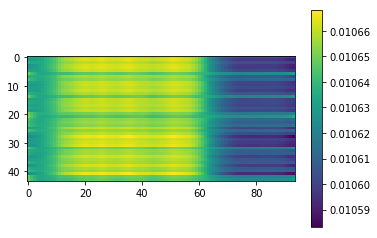

Calculated 250 Batches
Loss 250: 3.9043995250355112
08-24 15:21:12


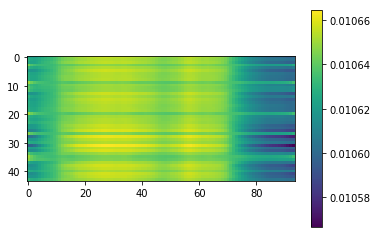

Calculated 260 Batches
Loss 260: 3.899955055930398
08-24 15:21:14


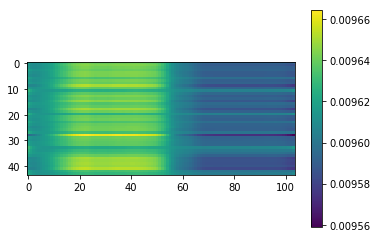

Calculated 270 Batches
Loss 270: 3.9057315479625356
08-24 15:21:16


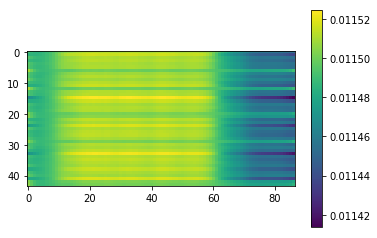

Calculated 280 Batches
Loss 280: 3.8957141240437827
08-24 15:21:18


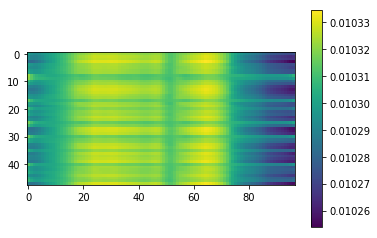

Calculated 290 Batches
Loss 290: 3.9125808080037436
08-24 15:21:20


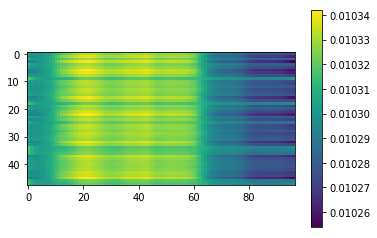

Calculated 300 Batches
Loss 300: 3.9229634602864585
08-24 15:21:22


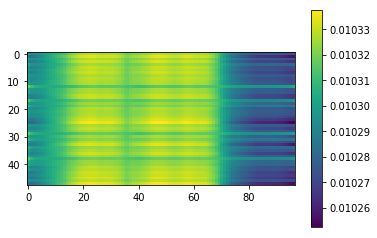

Calculated 310 Batches
Loss 310: 3.881480852762858
08-24 15:21:25


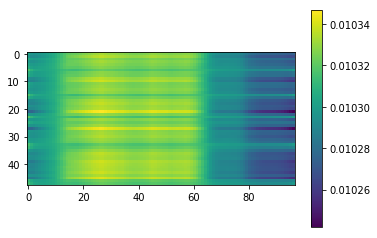

Calculated 320 Batches
Loss 320: 3.932000967172476
08-24 15:21:27


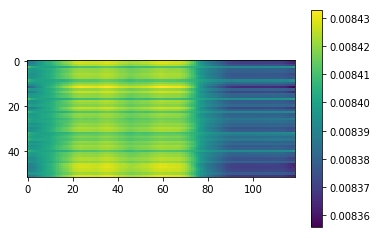

Calculated 330 Batches
Loss 330: 3.909997793344351
08-24 15:21:30


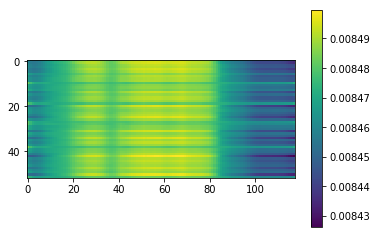

Calculated 340 Batches
Loss 340: 3.8122264317103793
08-24 15:21:32


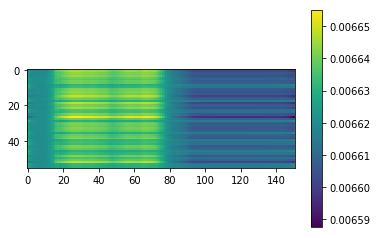

Calculated 350 Batches
Loss 350: 3.9626917157854353
08-24 15:21:35


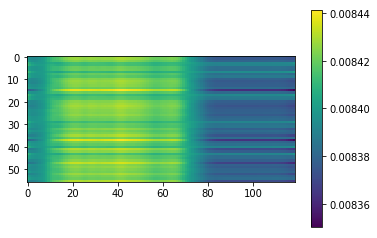

Calculated 360 Batches
Loss 360: 3.841489371606859
08-24 15:21:37


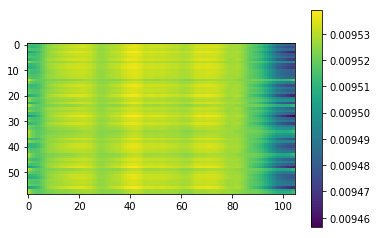

Calculated 370 Batches
Loss 370: 3.9194107055664062
08-24 15:21:40


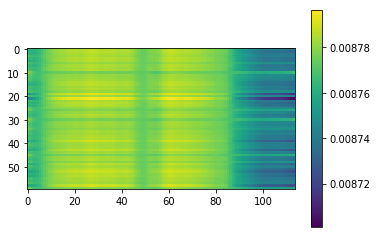

Calculated 380 Batches
Loss 380: 3.949383020401001
08-24 15:21:44


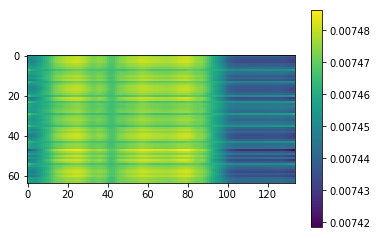

Calculated 390 Batches
Loss 390: 3.960214053883272
08-24 15:21:47


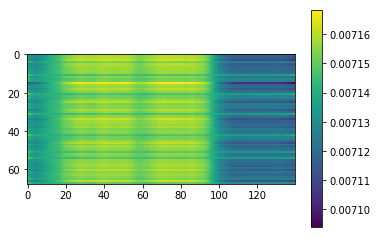

Calculated 400 Batches
Loss 400: 3.834541667591442
08-24 15:21:51


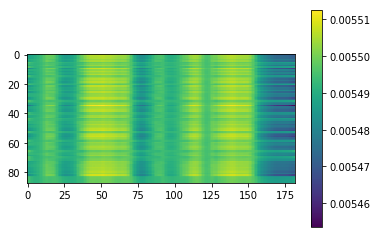

Mean Loss: 3.8793951048186703
----------------------------------------------------
08-24 15:21:52
Calculated 10 Batches
Loss 10: 3.6653990745544434
08-24 15:21:53


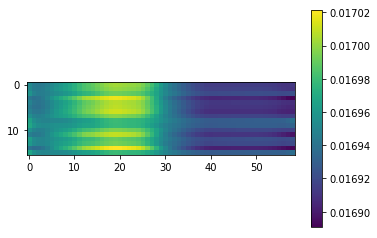

Calculated 20 Batches
Loss 20: 3.7718814849853515
08-24 15:21:53


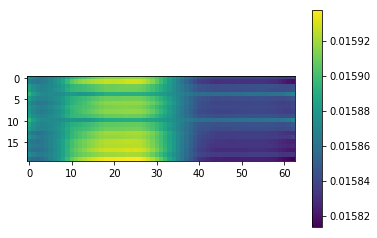

Calculated 30 Batches
Loss 30: 3.872150739034017
08-24 15:21:54


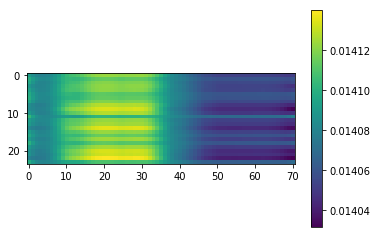

Calculated 40 Batches
Loss 40: 3.8346967697143555
08-24 15:21:56


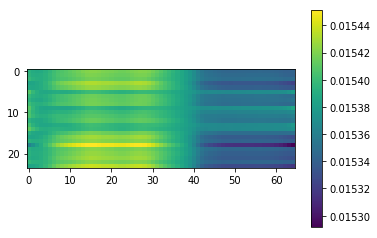

Calculated 50 Batches
Loss 50: 3.728436606270926
08-24 15:21:57


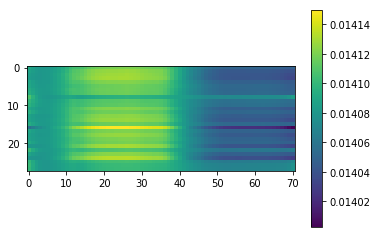

Calculated 60 Batches
Loss 60: 3.8163784572056363
08-24 15:21:58


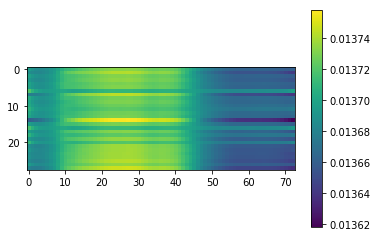

Calculated 70 Batches
Loss 70: 3.8111495971679688
08-24 15:21:59


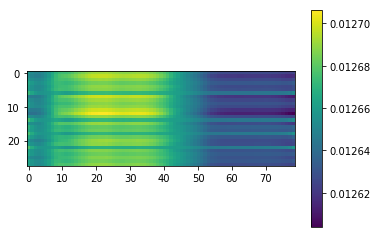

Calculated 80 Batches
Loss 80: 3.8461505344935825
08-24 15:22:01


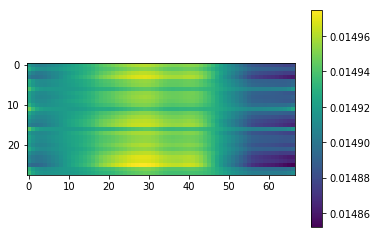

Calculated 90 Batches
Loss 90: 3.8561840057373047
08-24 15:22:02


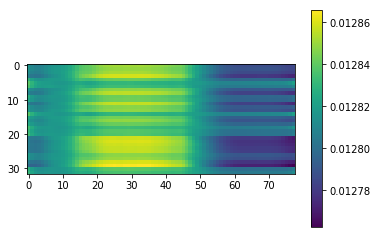

Calculated 100 Batches
Loss 100: 3.8852014541625977
08-24 15:22:03


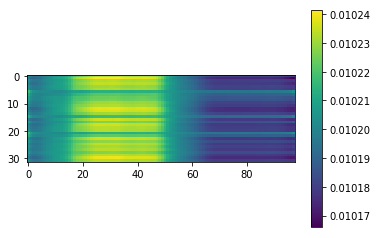

Calculated 110 Batches
Loss 110: 3.8403685092926025
08-24 15:22:05


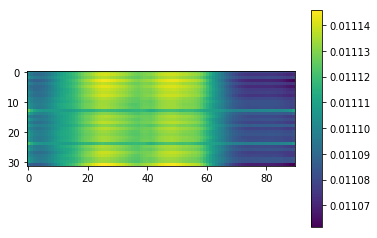

Calculated 120 Batches
Loss 120: 3.8964548110961914
08-24 15:22:06


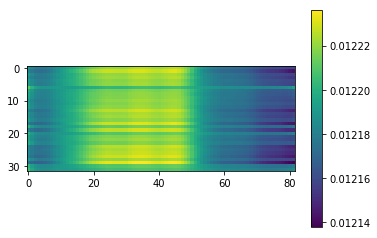

Calculated 130 Batches
Loss 130: 3.9007444381713867
08-24 15:22:08


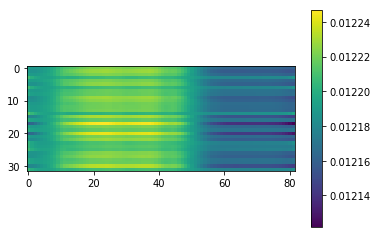

Calculated 140 Batches
Loss 140: 3.8822962443033853
08-24 15:22:09


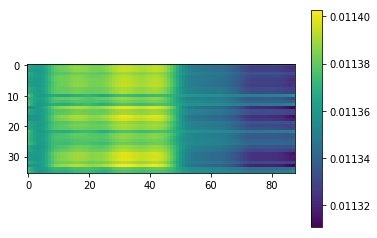

Calculated 150 Batches
Loss 150: 3.8725162082248263
08-24 15:22:11


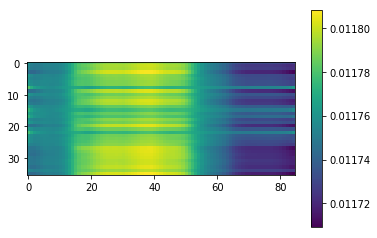

Calculated 160 Batches
Loss 160: 3.9019317626953125
08-24 15:22:13


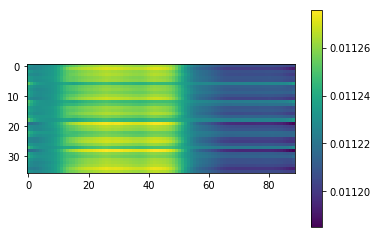

Calculated 170 Batches
Loss 170: 3.8670361836751304
08-24 15:22:14


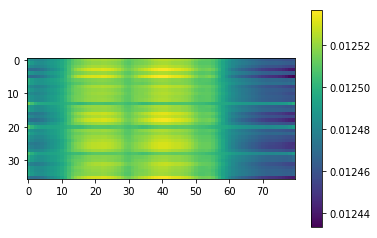

Calculated 180 Batches
Loss 180: 3.8803003099229603
08-24 15:22:16


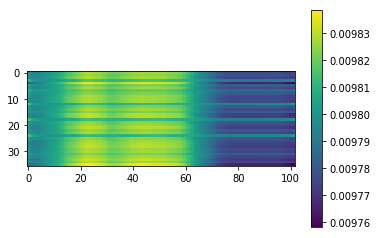

Calculated 190 Batches
Loss 190: 3.8906883239746093
08-24 15:22:18


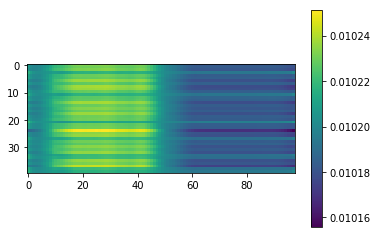

Calculated 200 Batches
Loss 200: 3.9224163055419923
08-24 15:22:20


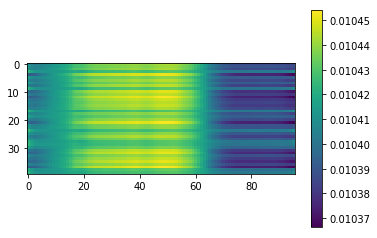

Calculated 210 Batches
Loss 210: 3.8964794158935545
08-24 15:22:22


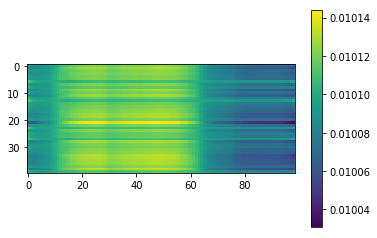

Calculated 220 Batches
Loss 220: 3.8710540771484374
08-24 15:22:24


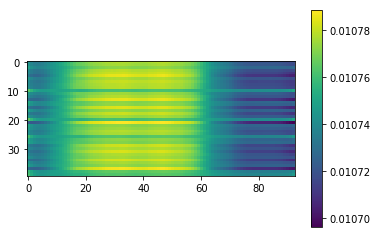

Calculated 230 Batches
Loss 230: 3.903717803955078
08-24 15:22:25


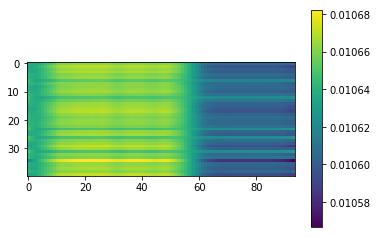

Calculated 240 Batches
Loss 240: 3.891529083251953
08-24 15:22:27


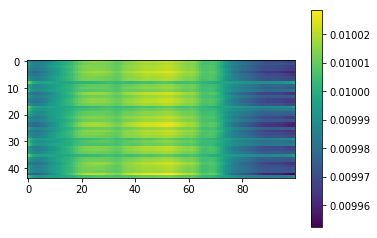

Calculated 250 Batches
Loss 250: 3.940731395374645
08-24 15:22:29


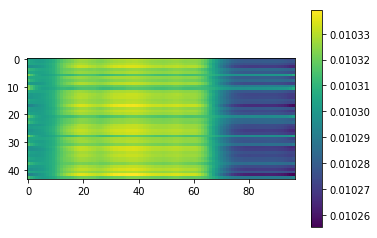

Calculated 260 Batches
Loss 260: 3.9182430614124644
08-24 15:22:31


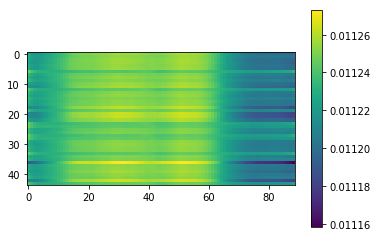

Calculated 270 Batches
Loss 270: 3.898337624289773
08-24 15:22:33


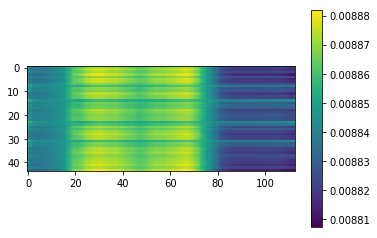

Calculated 280 Batches
Loss 280: 3.9288810094197593
08-24 15:22:36


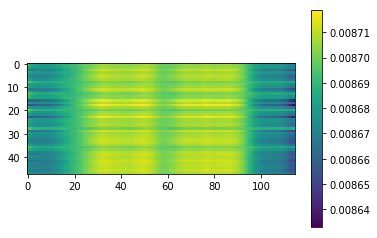

Calculated 290 Batches
Loss 290: 3.911458969116211
08-24 15:22:38


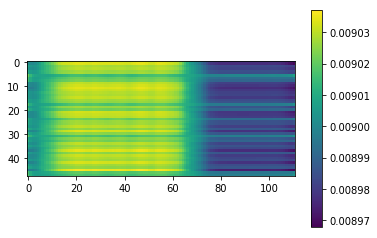

Calculated 300 Batches
Loss 300: 3.911502202351888
08-24 15:22:40


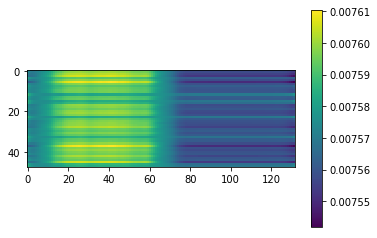

Calculated 310 Batches
Loss 310: 3.930885632832845
08-24 15:22:42


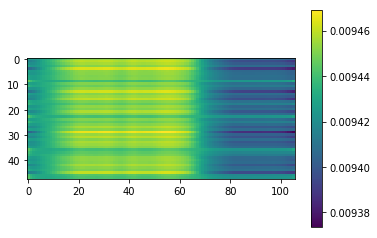

Calculated 320 Batches
Loss 320: 3.920031034029447
08-24 15:22:45


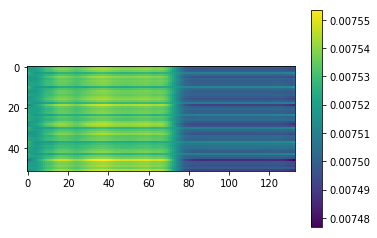

Calculated 330 Batches
Loss 330: 3.9161746685321512
08-24 15:22:47


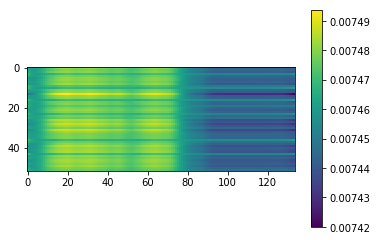

Calculated 340 Batches
Loss 340: 3.8129400525774275
08-24 15:22:50


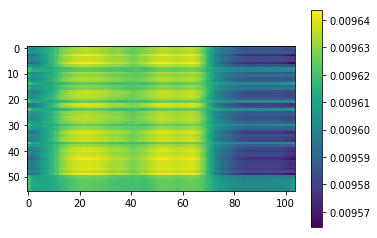

Calculated 350 Batches
Loss 350: 3.9594244275774275
08-24 15:22:52


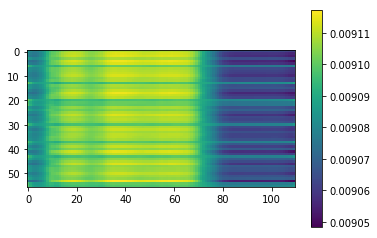

Calculated 360 Batches
Loss 360: 3.8042563745530984
08-24 15:22:55


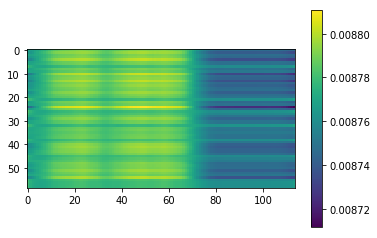

Calculated 370 Batches
Loss 370: 3.942826588948568
08-24 15:22:58


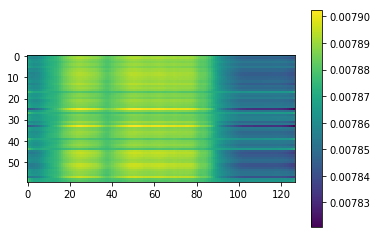

Calculated 380 Batches
Loss 380: 3.958179235458374
08-24 15:23:01


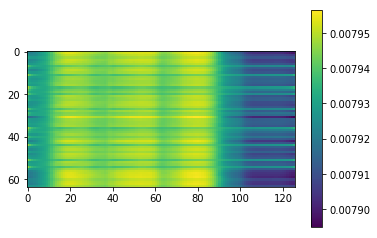

Calculated 390 Batches
Loss 390: 3.950892728917739
08-24 15:23:04


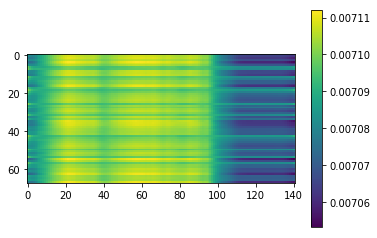

Calculated 400 Batches
Loss 400: 3.8455113497647373
08-24 15:23:08


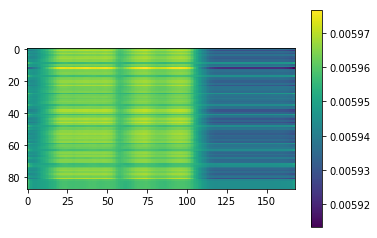

Mean Loss: 3.8793106596937834
----------------------------------------------------
08-24 15:23:09
Calculated 10 Batches
Loss 10: 3.758213520050049
08-24 15:23:10


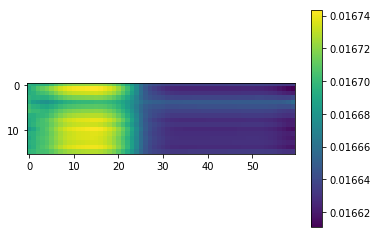

Calculated 20 Batches
Loss 20: 3.8854705810546877
08-24 15:23:11


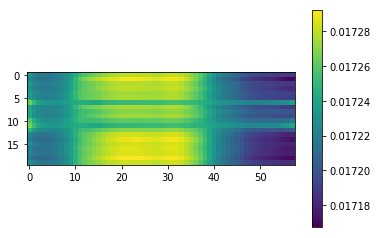

Calculated 30 Batches
Loss 30: 3.848679542541504
08-24 15:23:12


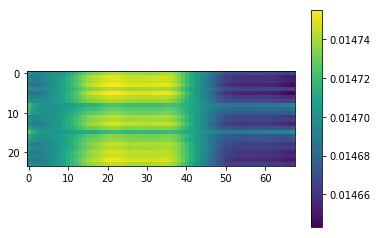

Calculated 40 Batches
Loss 40: 3.819573720296224
08-24 15:23:13


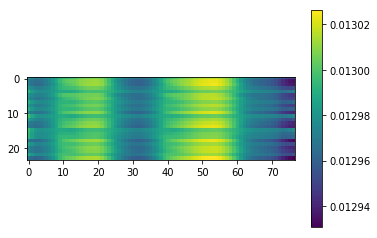

Calculated 50 Batches
Loss 50: 3.7825845990862166
08-24 15:23:14


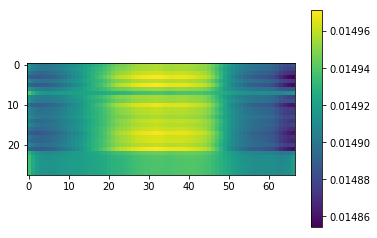

Calculated 60 Batches
Loss 60: 3.8392996106828963
08-24 15:23:16


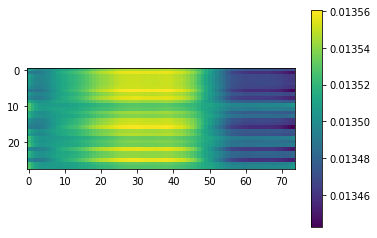

Calculated 70 Batches
Loss 70: 3.8596600123814175
08-24 15:23:17


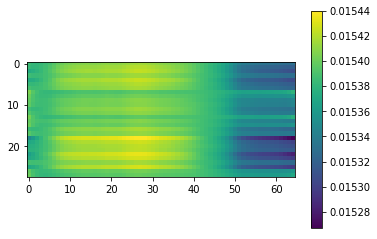

Calculated 80 Batches
Loss 80: 3.846881866455078
08-24 15:23:18


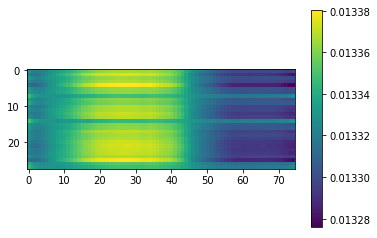

Calculated 90 Batches
Loss 90: 3.844491720199585
08-24 15:23:19


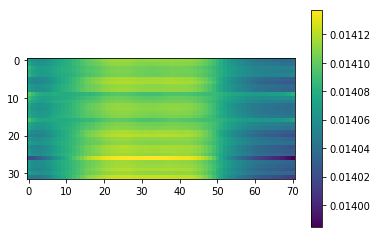

Calculated 100 Batches
Loss 100: 3.860400676727295
08-24 15:23:21


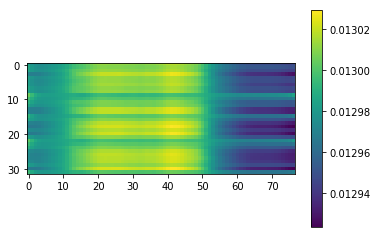

Calculated 110 Batches
Loss 110: 3.870117664337158
08-24 15:23:23


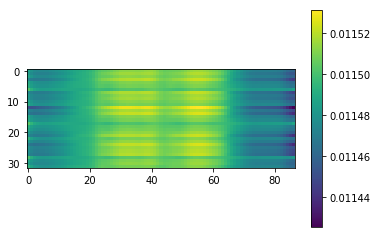

Calculated 120 Batches
Loss 120: 3.855640172958374
08-24 15:23:24


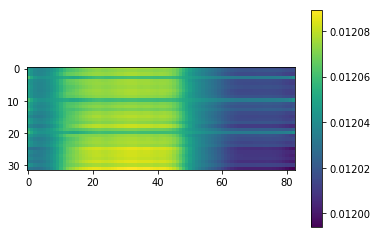

Calculated 130 Batches
Loss 130: 3.838578224182129
08-24 15:23:25


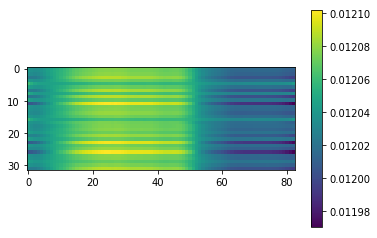

Calculated 140 Batches
Loss 140: 3.9130236307779946
08-24 15:23:27


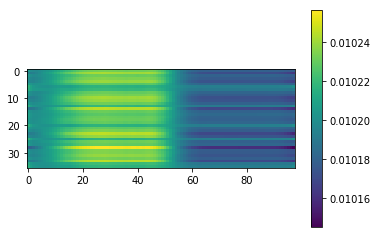

Calculated 150 Batches
Loss 150: 3.9146300421820746
08-24 15:23:29


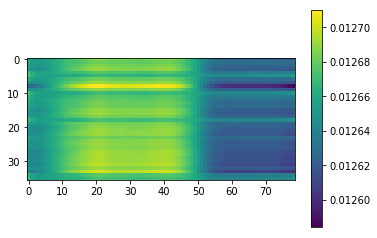

Calculated 160 Batches
Loss 160: 3.910827212863498
08-24 15:23:30


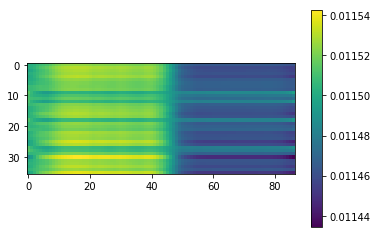

Calculated 170 Batches
Loss 170: 3.8794966803656683
08-24 15:23:32


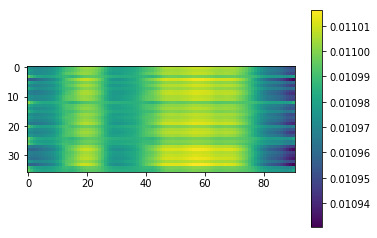

Calculated 180 Batches
Loss 180: 3.8751487731933594
08-24 15:23:34


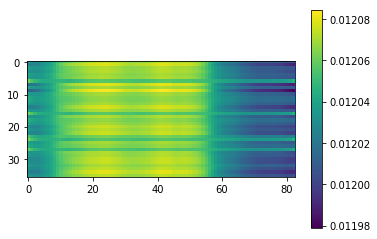

Calculated 190 Batches
Loss 190: 3.9066097259521486
08-24 15:23:35


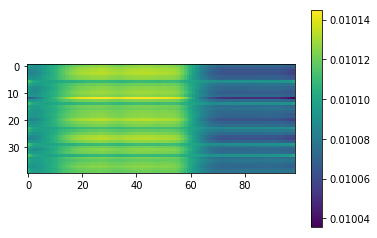

Calculated 200 Batches
Loss 200: 3.8744606018066405
08-24 15:23:37


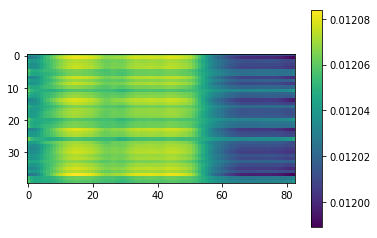

Calculated 210 Batches
Loss 210: 3.9435787200927734
08-24 15:23:39


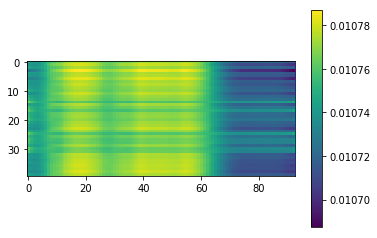

Calculated 220 Batches
Loss 220: 3.885870361328125
08-24 15:23:41


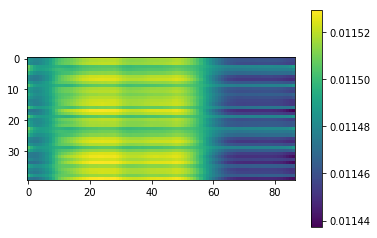

Calculated 230 Batches
Loss 230: 3.857324981689453
08-24 15:23:43


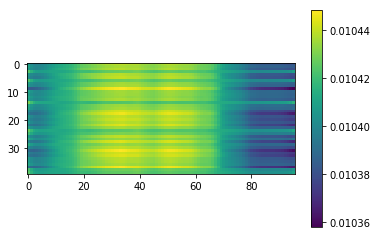

Calculated 240 Batches
Loss 240: 3.908877632834695
08-24 15:23:45


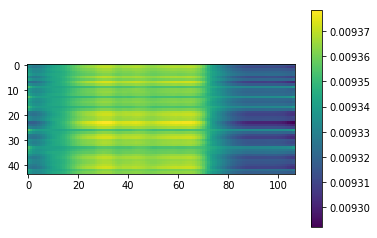

Calculated 250 Batches
Loss 250: 3.910101457075639
08-24 15:23:47


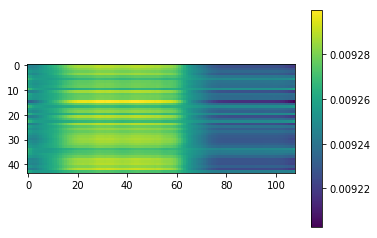

Calculated 260 Batches
Loss 260: 3.92675122347745
08-24 15:23:49


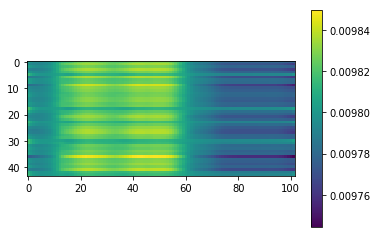

Calculated 270 Batches
Loss 270: 3.88980449329723
08-24 15:23:51


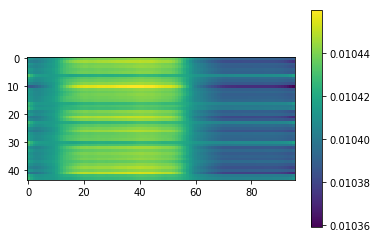

Calculated 280 Batches
Loss 280: 3.9342568715413413
08-24 15:23:53


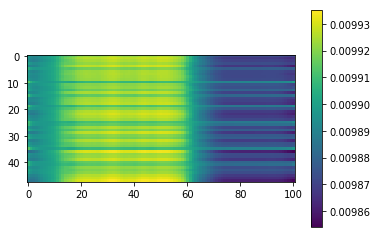

Calculated 290 Batches
Loss 290: 3.921807289123535
08-24 15:23:55


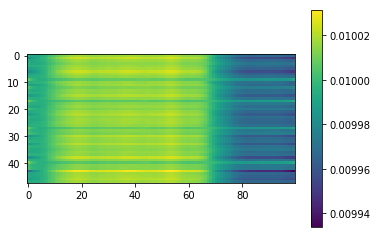

Calculated 300 Batches
Loss 300: 3.9126850763956704
08-24 15:23:58


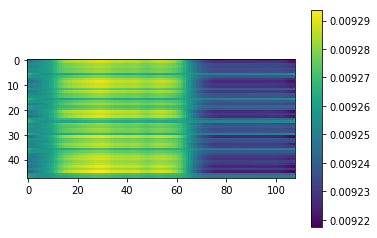

Calculated 310 Batches
Loss 310: 3.9217678705851235
08-24 15:24:00


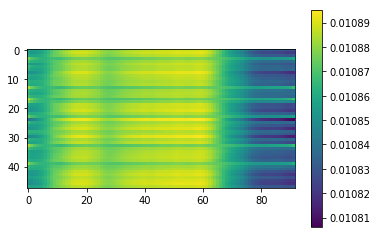

Calculated 320 Batches
Loss 320: 3.896792778602013
08-24 15:24:02


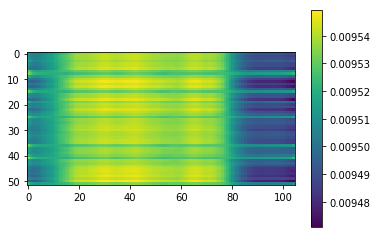

Calculated 330 Batches
Loss 330: 3.9177944476787863
08-24 15:24:05


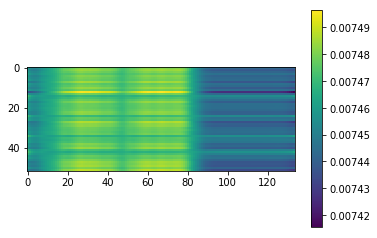

Calculated 340 Batches
Loss 340: 3.802880423409598
08-24 15:24:07


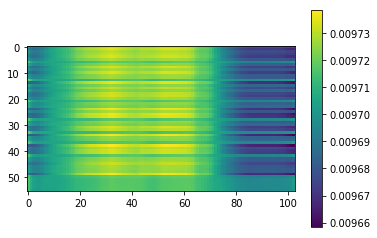

Calculated 350 Batches
Loss 350: 3.934738976614816
08-24 15:24:10


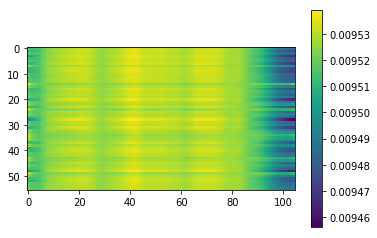

Calculated 360 Batches
Loss 360: 3.8231304621292375
08-24 15:24:13


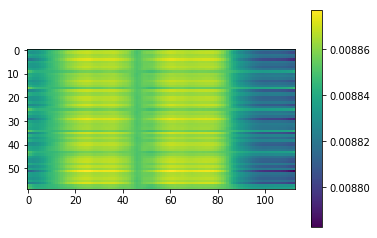

Calculated 370 Batches
Loss 370: 3.944677480061849
08-24 15:24:15


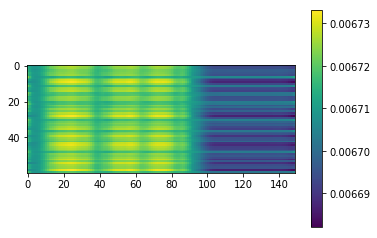

Calculated 380 Batches
Loss 380: 3.9364142417907715
08-24 15:24:19


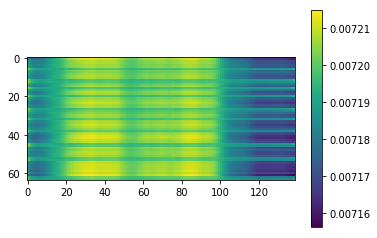

Calculated 390 Batches
Loss 390: 3.963334925034467
08-24 15:24:22


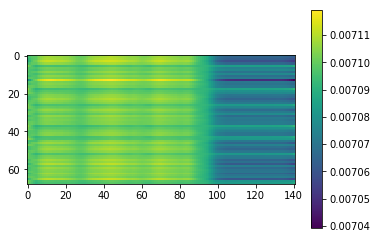

Calculated 400 Batches
Loss 400: 3.844002116810192
08-24 15:24:26


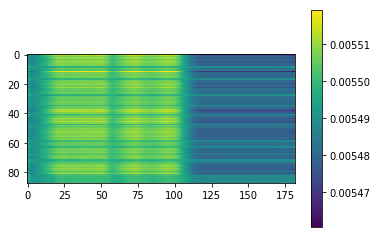

Mean Loss: 3.8798919085192556
----------------------------------------------------
08-24 15:24:27
Calculated 10 Batches
Loss 10: 3.6688735485076904
08-24 15:24:27


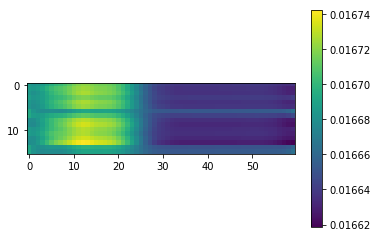

Calculated 20 Batches
Loss 20: 3.8268890380859375
08-24 15:24:28


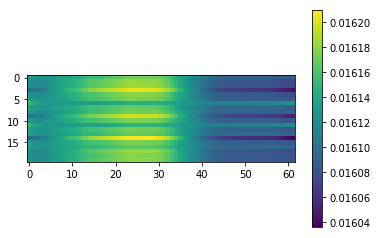

Calculated 30 Batches
Loss 30: 3.7561283111572266
08-24 15:24:29


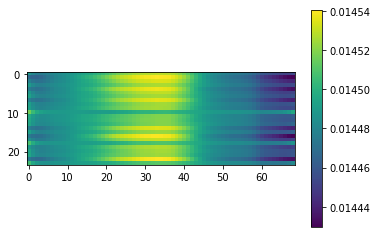

Calculated 40 Batches
Loss 40: 3.8791414896647134
08-24 15:24:31


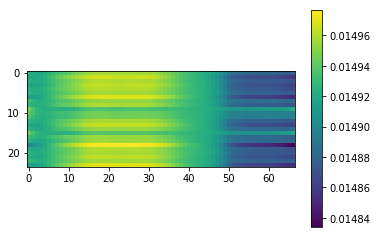

Calculated 50 Batches
Loss 50: 3.7850867680140903
08-24 15:24:32


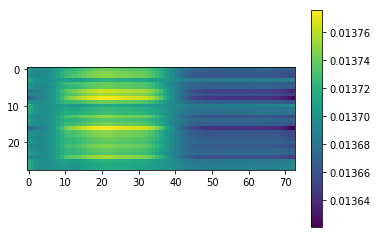

Calculated 60 Batches
Loss 60: 3.9084835052490234
08-24 15:24:33


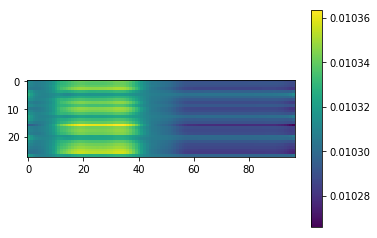

Calculated 70 Batches
Loss 70: 3.844376700265067
08-24 15:24:34


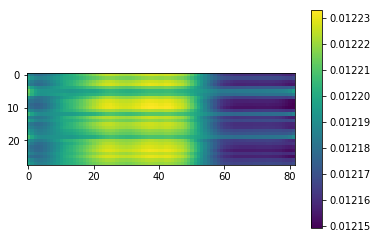

Calculated 80 Batches
Loss 80: 3.804584230695452
08-24 15:24:36


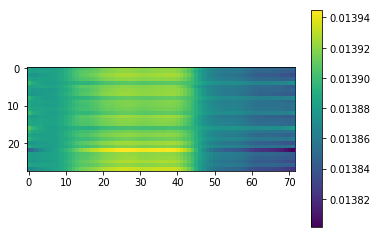

Calculated 90 Batches
Loss 90: 3.846057415008545
08-24 15:24:37


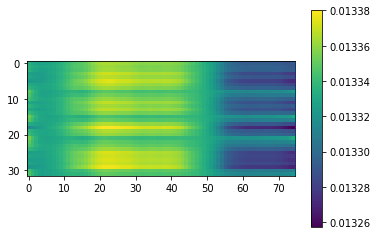

Calculated 100 Batches
Loss 100: 3.870371103286743
08-24 15:24:38


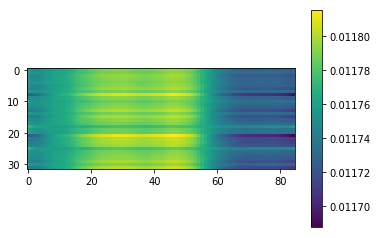

Calculated 110 Batches
Loss 110: 3.9056520462036133
08-24 15:24:40


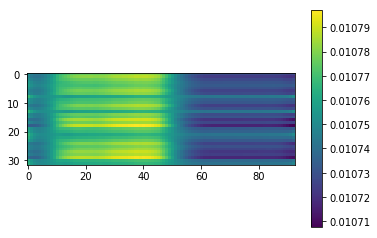

Calculated 120 Batches
Loss 120: 3.8570804595947266
08-24 15:24:41


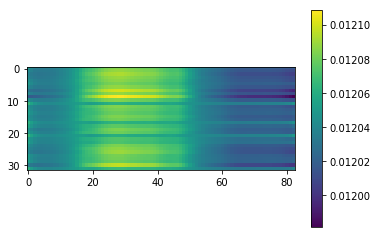

Calculated 130 Batches
Loss 130: 3.9044930934906006
08-24 15:24:43


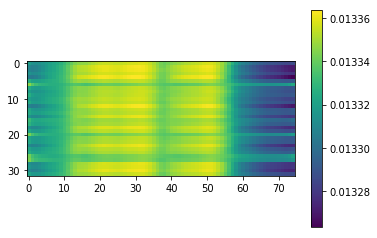

Calculated 140 Batches
Loss 140: 3.9298053317599826
08-24 15:24:45


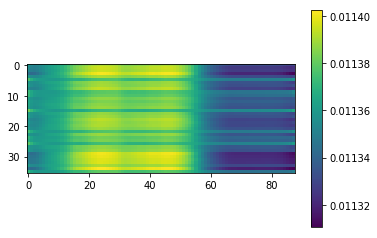

Calculated 150 Batches
Loss 150: 3.84212154812283
08-24 15:24:46


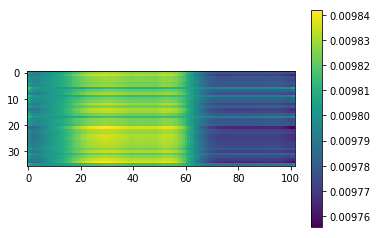

Calculated 160 Batches
Loss 160: 3.8599391513400607
08-24 15:24:48


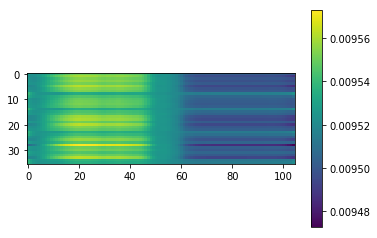

Calculated 170 Batches
Loss 170: 3.8740035163031683
08-24 15:24:49


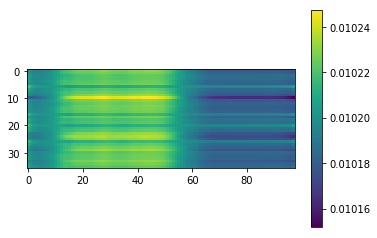

Calculated 180 Batches
Loss 180: 3.8678694831000433
08-24 15:24:51


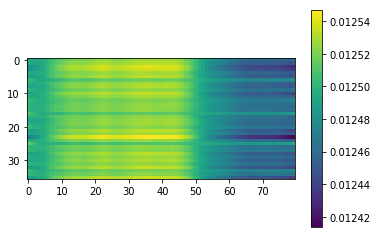

Calculated 190 Batches
Loss 190: 3.8786792755126953
08-24 15:24:53


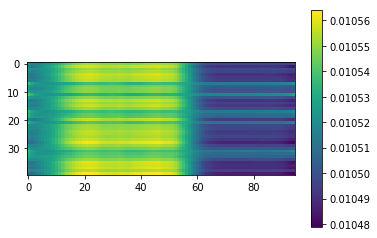

Calculated 200 Batches
Loss 200: 3.84000244140625
08-24 15:24:55


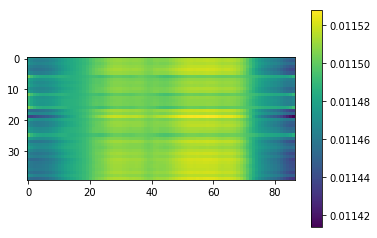

Calculated 210 Batches
Loss 210: 3.9006309509277344
08-24 15:24:57


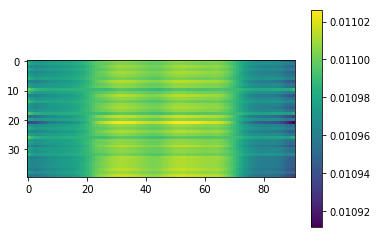

Calculated 220 Batches
Loss 220: 3.9013256072998046
08-24 15:24:58


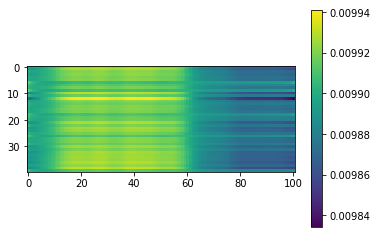

Calculated 230 Batches
Loss 230: 3.9072437286376953
08-24 15:25:00


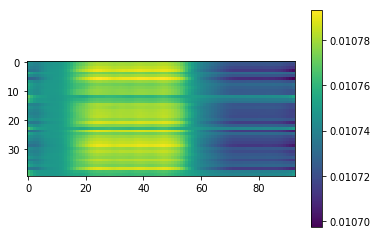

Calculated 240 Batches
Loss 240: 3.8940339521928267
08-24 15:25:02


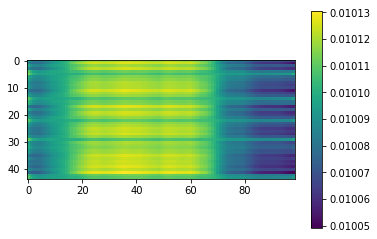

Calculated 250 Batches
Loss 250: 3.9103587757457388
08-24 15:25:04


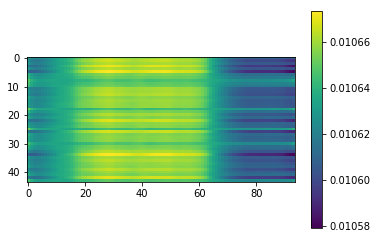

Calculated 260 Batches
Loss 260: 3.9132811806418677
08-24 15:25:07


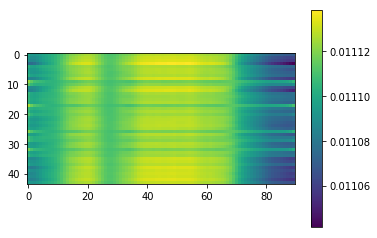

Calculated 270 Batches
Loss 270: 3.9312834306196733
08-24 15:25:09


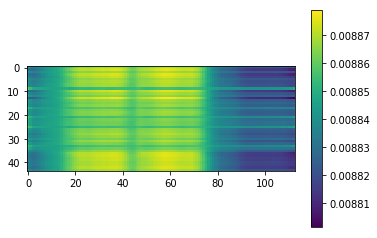

Calculated 280 Batches
Loss 280: 3.918156623840332
08-24 15:25:11


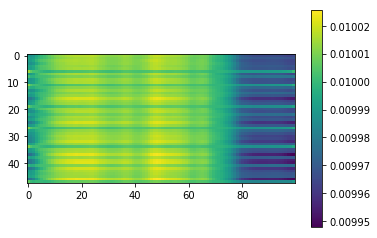

Calculated 290 Batches
Loss 290: 3.9167683919270835
08-24 15:25:13


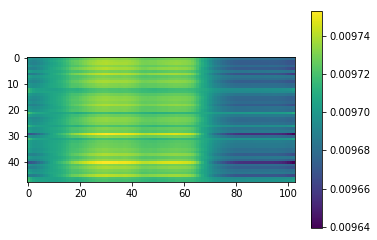

Calculated 300 Batches
Loss 300: 3.942834218343099
08-24 15:25:15


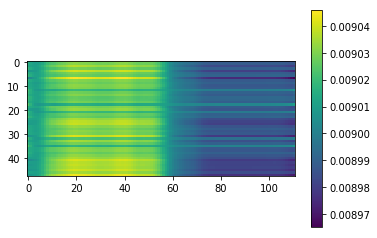

Calculated 310 Batches
Loss 310: 3.9312044779459634
08-24 15:25:18


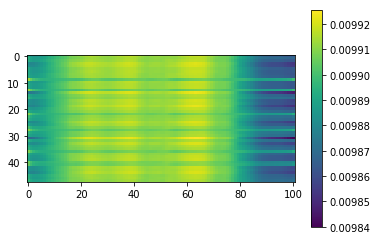

Calculated 320 Batches
Loss 320: 3.9188766479492188
08-24 15:25:20


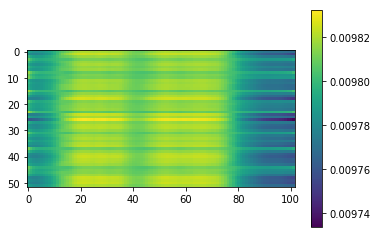

Calculated 330 Batches
Loss 330: 3.92188468346229
08-24 15:25:23


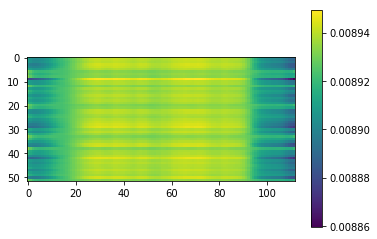

Calculated 340 Batches
Loss 340: 3.8051866803850447
08-24 15:25:25


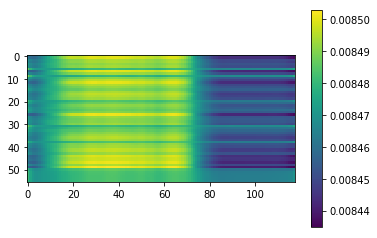

Calculated 350 Batches
Loss 350: 3.905895505632673
08-24 15:25:28


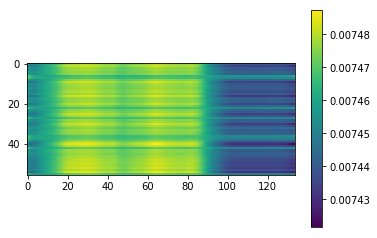

Calculated 360 Batches
Loss 360: 3.750086720784505
08-24 15:25:30


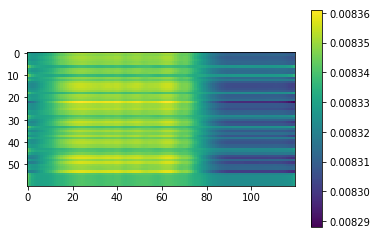

Calculated 370 Batches
Loss 370: 3.9469367980957033
08-24 15:25:33


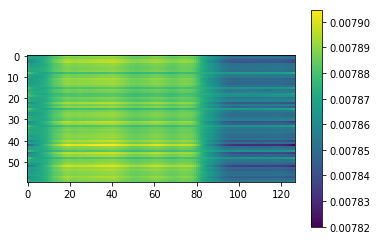

Calculated 380 Batches
Loss 380: 3.9677340984344482
08-24 15:25:36


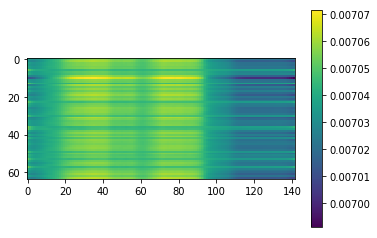

Calculated 390 Batches
Loss 390: 3.971070682301241
08-24 15:25:40


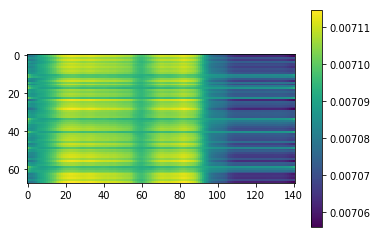

Calculated 400 Batches
Loss 400: 3.8439563404430044
08-24 15:25:44


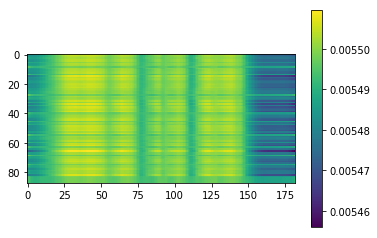

Mean Loss: 3.8787682437981283
----------------------------------------------------
08-24 15:25:45
Calculated 10 Batches
Loss 10: 3.827723979949951
08-24 15:25:45


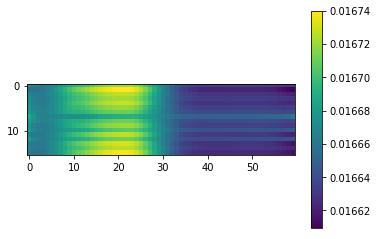

Calculated 20 Batches
Loss 20: 3.842974853515625
08-24 15:25:46


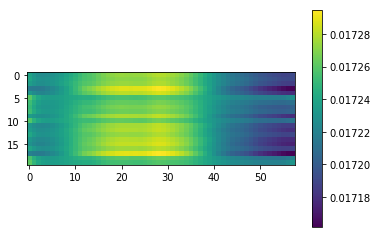

Calculated 30 Batches
Loss 30: 3.873063087463379
08-24 15:25:47


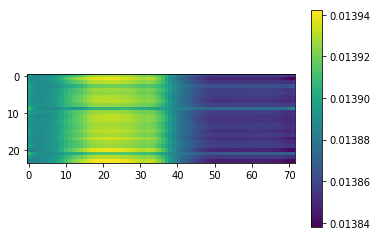

Calculated 40 Batches
Loss 40: 3.8178771336873374
08-24 15:25:48


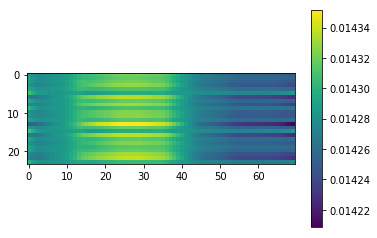

Calculated 50 Batches
Loss 50: 3.8026392800467357
08-24 15:25:50


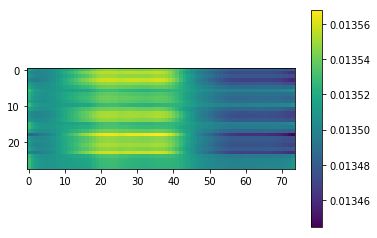

Calculated 60 Batches
Loss 60: 3.8236983163016185
08-24 15:25:51


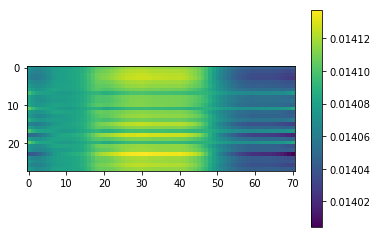

Calculated 70 Batches
Loss 70: 3.853939873831613
08-24 15:25:52


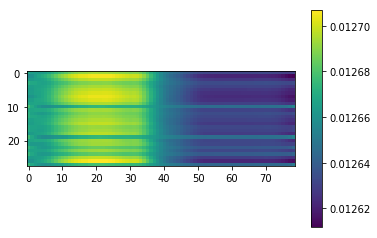

Calculated 80 Batches
Loss 80: 3.8431009565080916
08-24 15:25:53


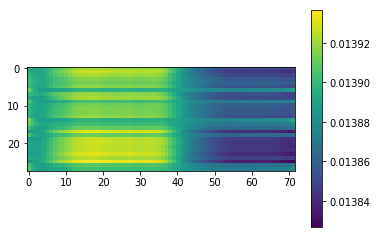

Calculated 90 Batches
Loss 90: 3.799973964691162
08-24 15:25:55


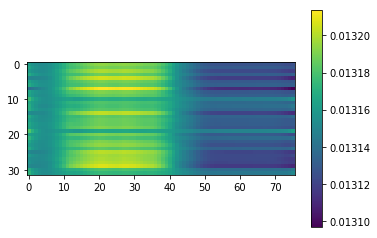

Calculated 100 Batches
Loss 100: 3.8763692378997803
08-24 15:25:56


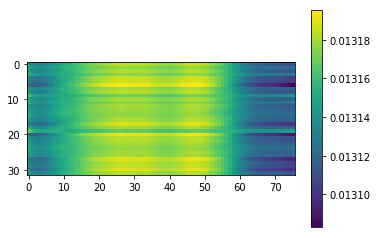

Calculated 110 Batches
Loss 110: 3.8523781299591064
08-24 15:25:58


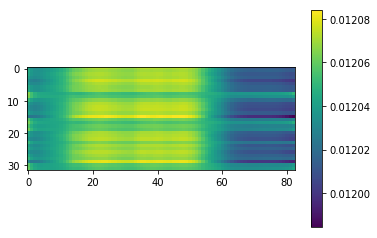

Calculated 120 Batches
Loss 120: 3.844388961791992
08-24 15:25:59


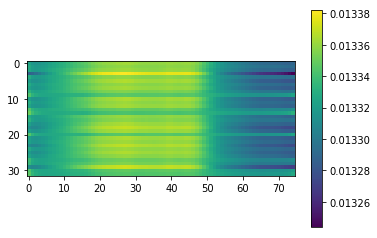

Calculated 130 Batches
Loss 130: 3.901097059249878
08-24 15:26:01


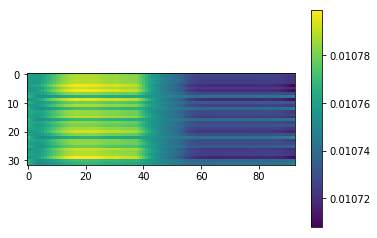

Calculated 140 Batches
Loss 140: 3.8527264065212674
08-24 15:26:02


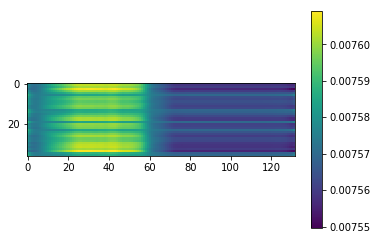

Calculated 150 Batches
Loss 150: 3.88779534233941
08-24 15:26:04


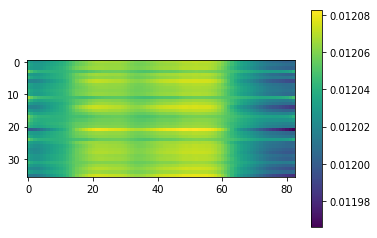

Calculated 160 Batches
Loss 160: 3.838370429144965
08-24 15:26:05


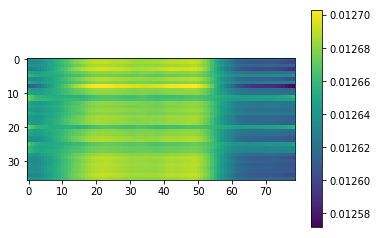

Calculated 170 Batches
Loss 170: 3.888063218858507
08-24 15:26:07


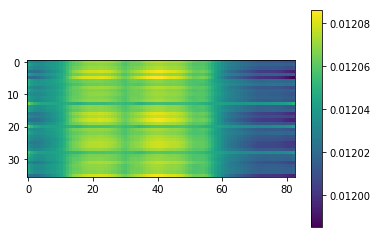

Calculated 180 Batches
Loss 180: 3.893282996283637
08-24 15:26:09


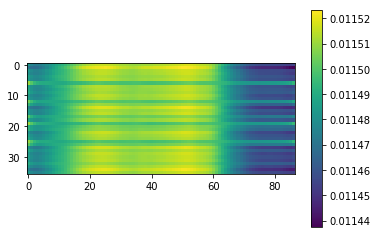

Calculated 190 Batches
Loss 190: 3.9168121337890627
08-24 15:26:11


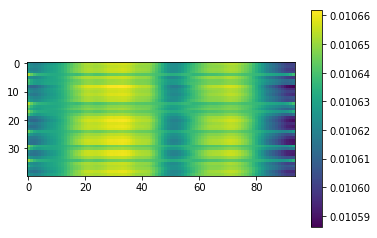

Calculated 200 Batches
Loss 200: 3.873793029785156
08-24 15:26:13


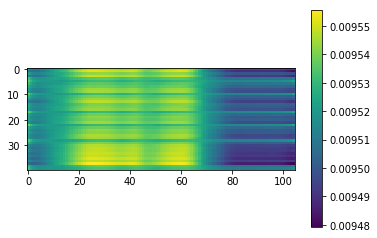

Calculated 210 Batches
Loss 210: 3.8727420806884765
08-24 15:26:14


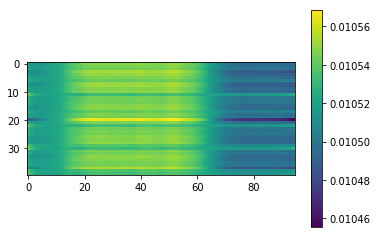

Calculated 220 Batches
Loss 220: 3.9037944793701174
08-24 15:26:16


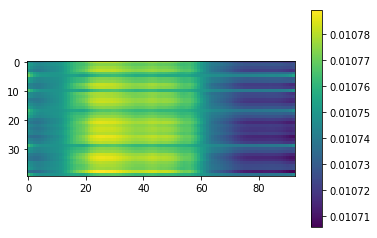

Calculated 230 Batches
Loss 230: 3.892083740234375
08-24 15:26:18


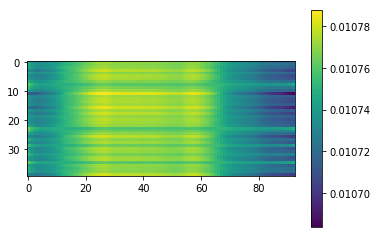

Calculated 240 Batches
Loss 240: 3.9325374256480825
08-24 15:26:20


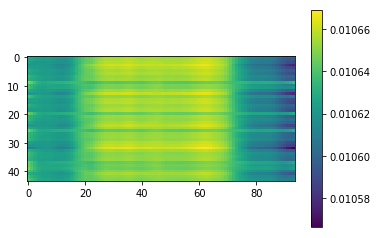

Calculated 250 Batches
Loss 250: 3.8804550170898438
08-24 15:26:22


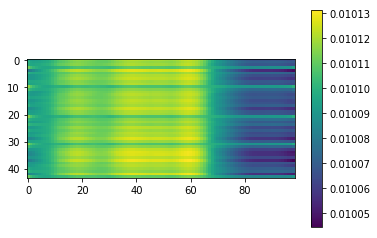

Calculated 260 Batches
Loss 260: 3.8784831653941763
08-24 15:26:24


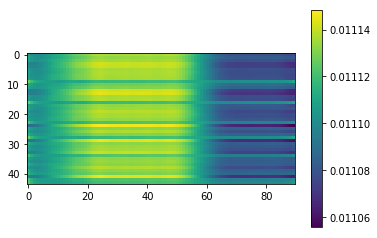

Calculated 270 Batches
Loss 270: 3.9042098305442114
08-24 15:26:26


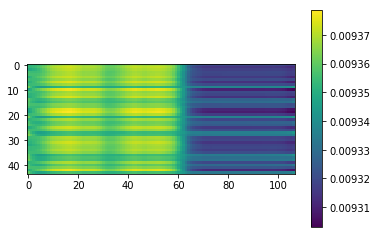

Calculated 280 Batches
Loss 280: 3.9246702194213867
08-24 15:26:28


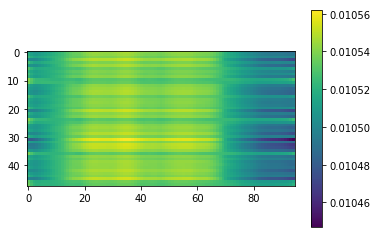

Calculated 290 Batches
Loss 290: 3.958523750305176
08-24 15:26:31


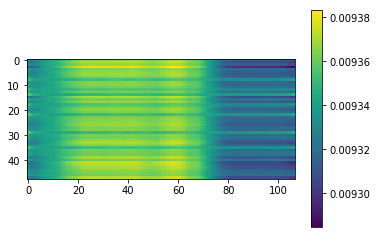

Calculated 300 Batches
Loss 300: 3.926527976989746
08-24 15:26:33


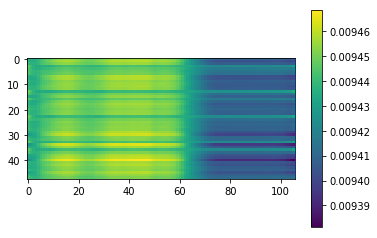

Calculated 310 Batches
Loss 310: 3.91139284769694
08-24 15:26:35


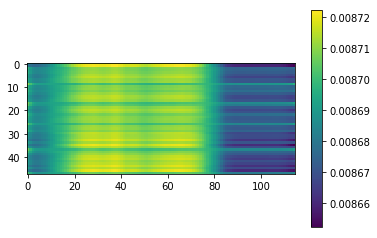

Calculated 320 Batches
Loss 320: 3.9291651799128604
08-24 15:26:38


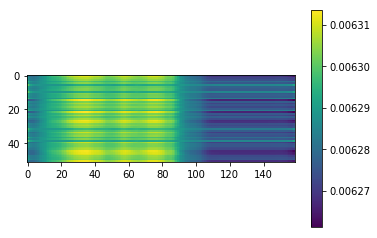

Calculated 330 Batches
Loss 330: 3.9405728853665867
08-24 15:26:40


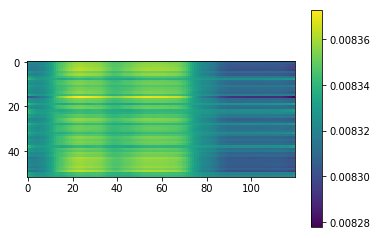

Calculated 340 Batches
Loss 340: 3.7823268345424106
08-24 15:26:43


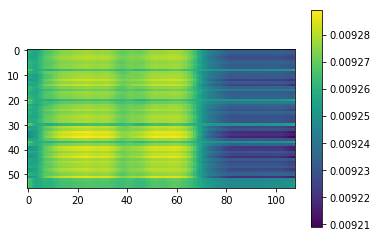

Calculated 350 Batches
Loss 350: 3.9233390263148715
08-24 15:26:45


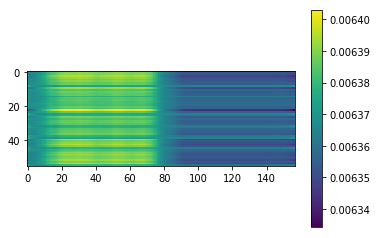

Calculated 360 Batches
Loss 360: 3.7745704650878906
08-24 15:26:48


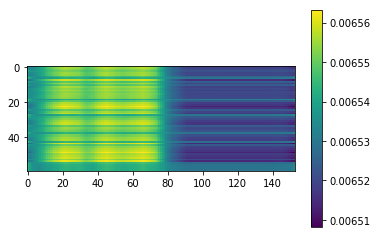

Calculated 370 Batches
Loss 370: 3.9347826639811196
08-24 15:26:51


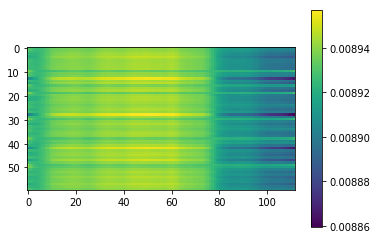

Calculated 380 Batches
Loss 380: 3.951580286026001
08-24 15:26:54


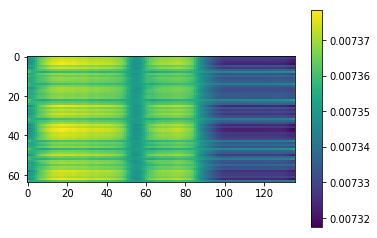

Calculated 390 Batches
Loss 390: 3.9889656515682446
08-24 15:26:57


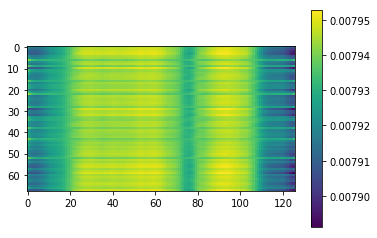

Calculated 400 Batches
Loss 400: 3.8429270657626065
08-24 15:27:01


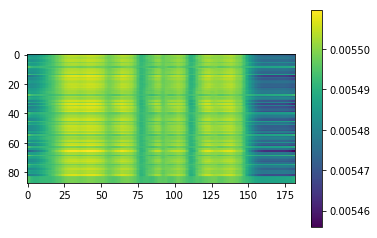

Mean Loss: 3.8785677197261355
----------------------------------------------------
08-24 15:27:02
Calculated 10 Batches
Loss 10: 3.7619869709014893
08-24 15:27:03


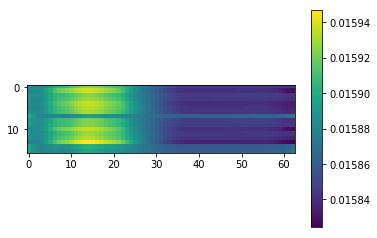

Calculated 20 Batches
Loss 20: 3.8236061096191407
08-24 15:27:04


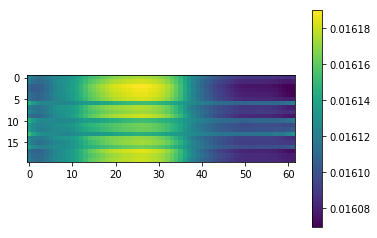

Calculated 30 Batches
Loss 30: 3.8281021118164062
08-24 15:27:05


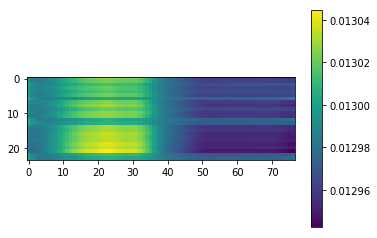

Calculated 40 Batches
Loss 40: 3.832845687866211
08-24 15:27:06


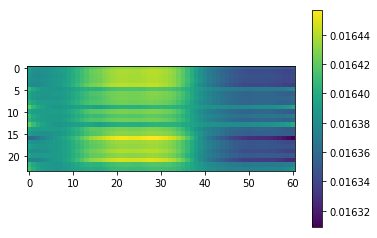

Calculated 50 Batches
Loss 50: 3.725566864013672
08-24 15:27:07


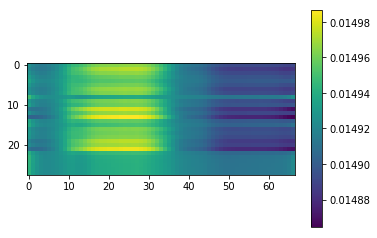

Calculated 60 Batches
Loss 60: 3.8798700060163225
08-24 15:27:08


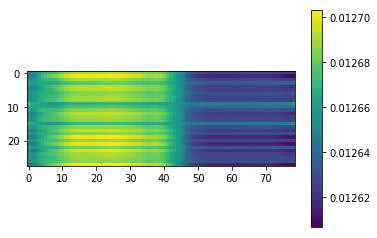

Calculated 70 Batches
Loss 70: 3.8755686623709544
08-24 15:27:10


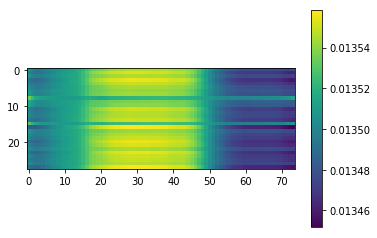

Calculated 80 Batches
Loss 80: 3.8430066789899553
08-24 15:27:11


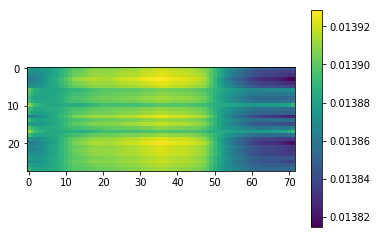

Calculated 90 Batches
Loss 90: 3.8622472286224365
08-24 15:27:12


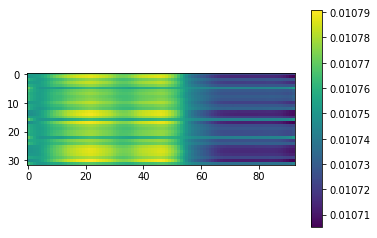

Calculated 100 Batches
Loss 100: 3.8489925861358643
08-24 15:27:14


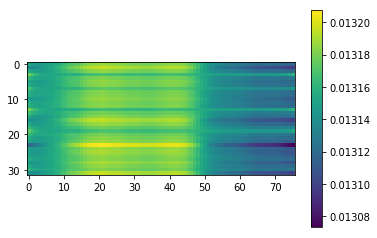

Calculated 110 Batches
Loss 110: 3.8610541820526123
08-24 15:27:15


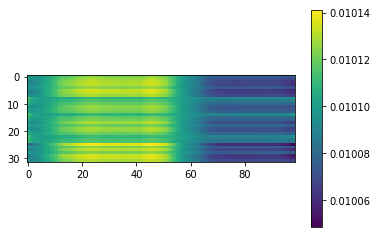

Calculated 120 Batches
Loss 120: 3.897050619125366
08-24 15:27:17


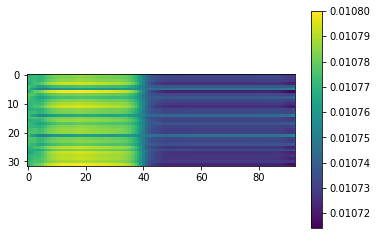

Calculated 130 Batches
Loss 130: 3.8695037364959717
08-24 15:27:18


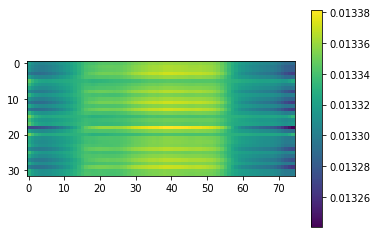

Calculated 140 Batches
Loss 140: 3.9020173814561634
08-24 15:27:20


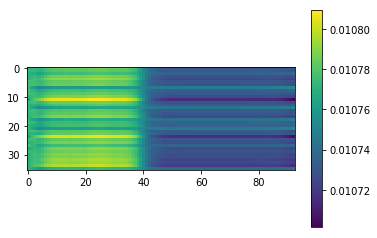

Calculated 150 Batches
Loss 150: 3.867770300971137
08-24 15:27:21


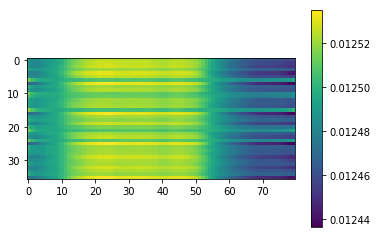

Calculated 160 Batches
Loss 160: 3.900895436604818
08-24 15:27:23


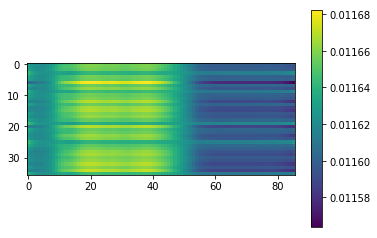

Calculated 170 Batches
Loss 170: 3.8815455966525607
08-24 15:27:25


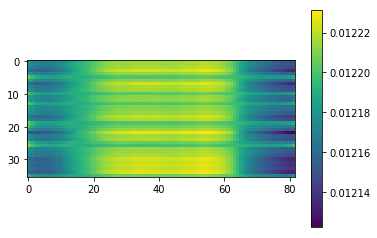

Calculated 180 Batches
Loss 180: 3.9004779391818576
08-24 15:27:26


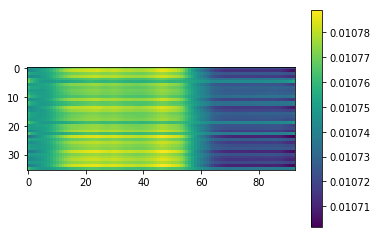

Calculated 190 Batches
Loss 190: 3.8842018127441404
08-24 15:27:28


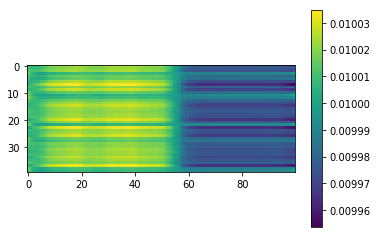

Calculated 200 Batches
Loss 200: 3.9087478637695314
08-24 15:27:30


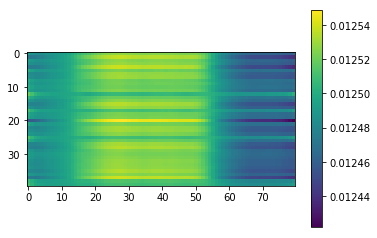

Calculated 210 Batches
Loss 210: 3.8770538330078126
08-24 15:27:32


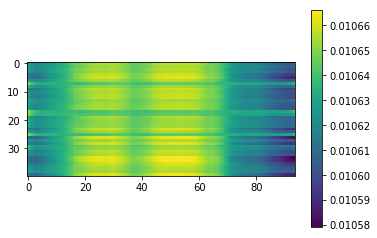

Calculated 220 Batches
Loss 220: 3.9141586303710936
08-24 15:27:34


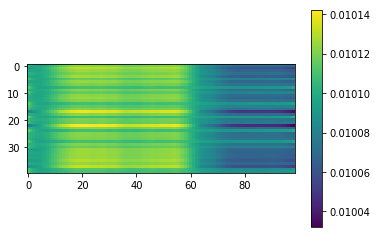

Calculated 230 Batches
Loss 230: 3.9180553436279295
08-24 15:27:36


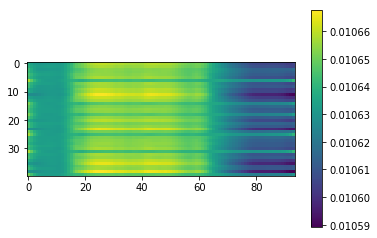

Calculated 240 Batches
Loss 240: 3.90371357310902
08-24 15:27:38


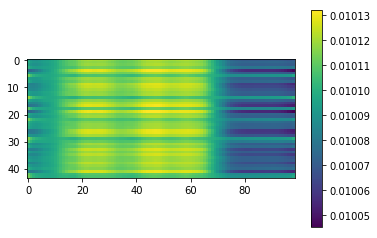

Calculated 250 Batches
Loss 250: 3.9204354719682173
08-24 15:27:40


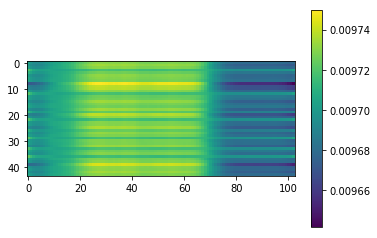

Calculated 260 Batches
Loss 260: 3.883377421985973
08-24 15:27:42


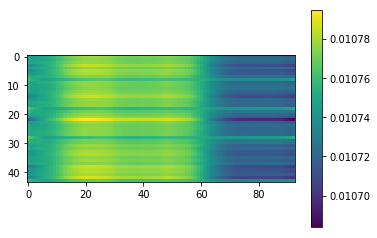

Calculated 270 Batches
Loss 270: 3.8960921547629614
08-24 15:27:44


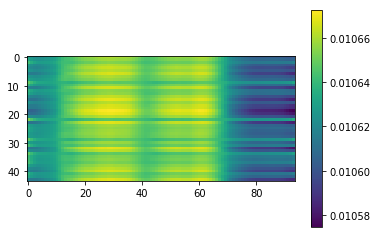

Calculated 280 Batches
Loss 280: 3.9195426305135093
08-24 15:27:46


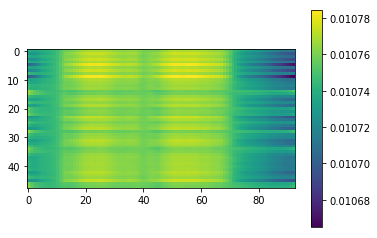

Calculated 290 Batches
Loss 290: 3.9264094034830728
08-24 15:27:48


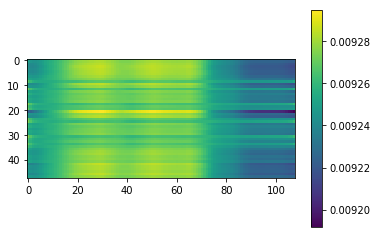

Calculated 300 Batches
Loss 300: 3.8979549407958984
08-24 15:27:50


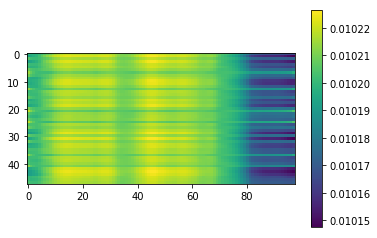

Calculated 310 Batches
Loss 310: 3.8882741928100586
08-24 15:27:53


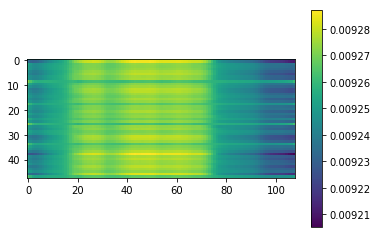

Calculated 320 Batches
Loss 320: 3.9155153127817006
08-24 15:27:55


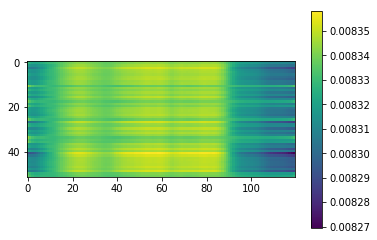

Calculated 330 Batches
Loss 330: 3.9223301227276144
08-24 15:27:57


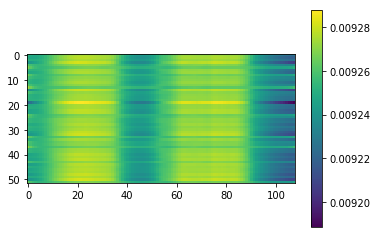

Calculated 340 Batches
Loss 340: 3.787560599190848
08-24 15:28:00


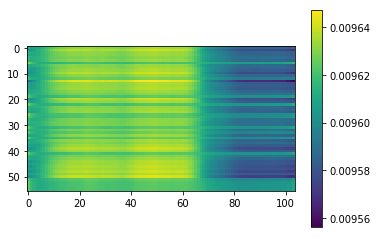

Calculated 350 Batches
Loss 350: 3.928605215890067
08-24 15:28:03


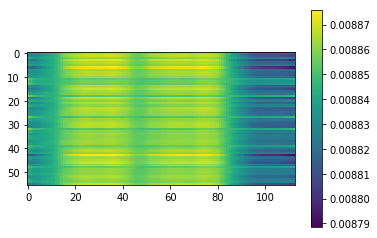

Calculated 360 Batches
Loss 360: 3.748627217610677
08-24 15:28:05


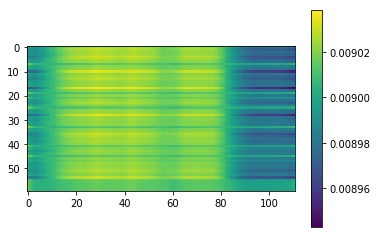

Calculated 370 Batches
Loss 370: 3.9153297424316404
08-24 15:28:08


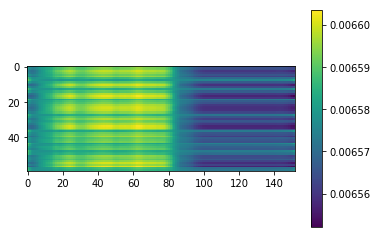

Calculated 380 Batches
Loss 380: 3.923065185546875
08-24 15:28:11


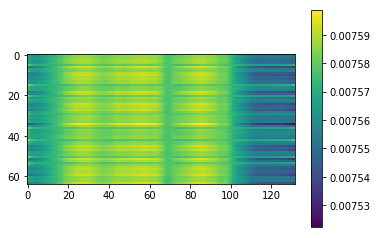

Calculated 390 Batches
Loss 390: 3.9645672966452206
08-24 15:28:15


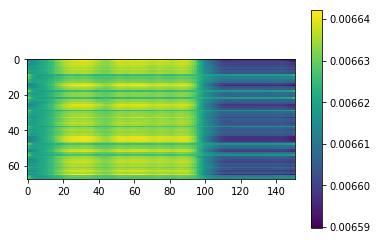

Calculated 400 Batches
Loss 400: 3.8328746448863638
08-24 15:28:19


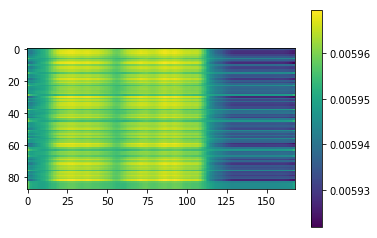

Mean Loss: 3.8779412084741742
----------------------------------------------------
08-24 15:28:20
Calculated 10 Batches
Loss 10: 3.6620194911956787
08-24 15:28:20


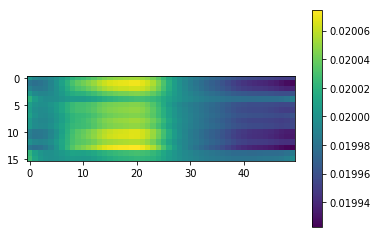

Calculated 20 Batches
Loss 20: 3.8086719512939453
08-24 15:28:21


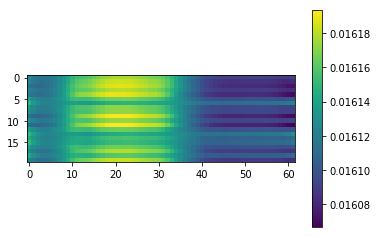

Calculated 30 Batches
Loss 30: 3.8387937545776367
08-24 15:28:22


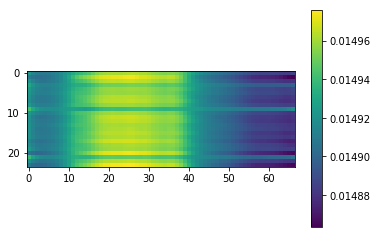

Calculated 40 Batches
Loss 40: 3.8184725443522134
08-24 15:28:23


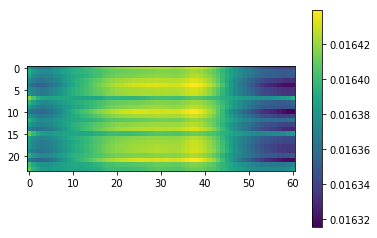

Calculated 50 Batches
Loss 50: 3.726848602294922
08-24 15:28:25


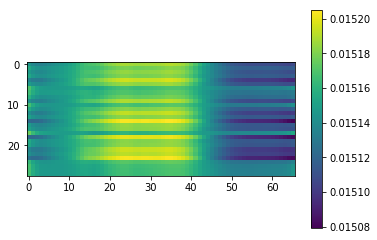

Calculated 60 Batches
Loss 60: 3.8436252049037387
08-24 15:28:26


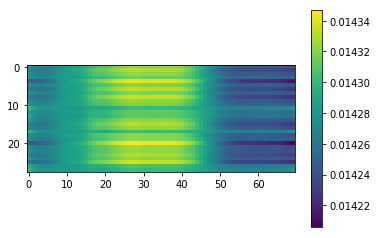

Calculated 70 Batches
Loss 70: 3.858869825090681
08-24 15:28:27


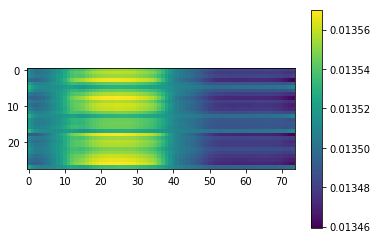

Calculated 80 Batches
Loss 80: 3.820707321166992
08-24 15:28:28


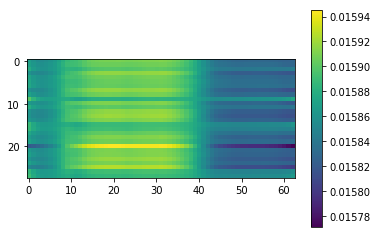

Calculated 90 Batches
Loss 90: 3.8898532390594482
08-24 15:28:30


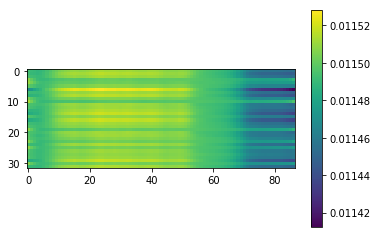

Calculated 100 Batches
Loss 100: 3.839681386947632
08-24 15:28:31


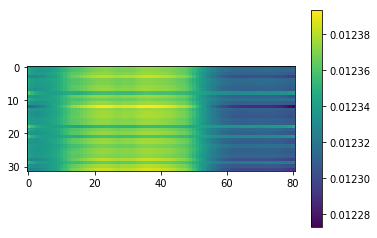

Calculated 110 Batches
Loss 110: 3.888831615447998
08-24 15:28:33


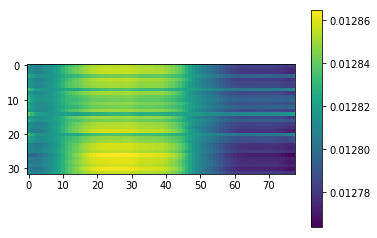

Calculated 120 Batches
Loss 120: 3.8656165599823
08-24 15:28:34


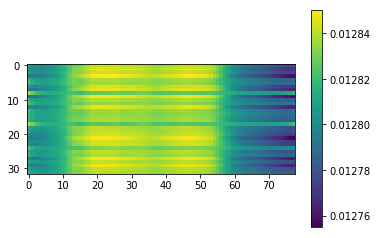

Calculated 130 Batches
Loss 130: 3.874734401702881
08-24 15:28:36


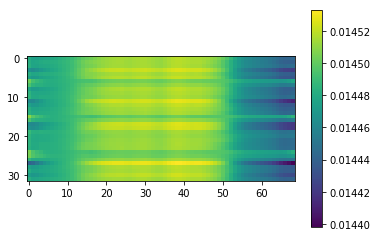

Calculated 140 Batches
Loss 140: 3.9013616773817272
08-24 15:28:37


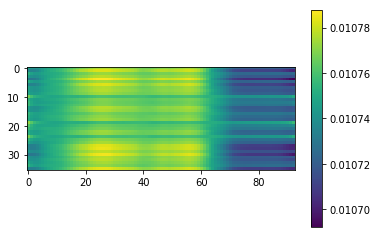

Calculated 150 Batches
Loss 150: 3.8711925082736545
08-24 15:28:39


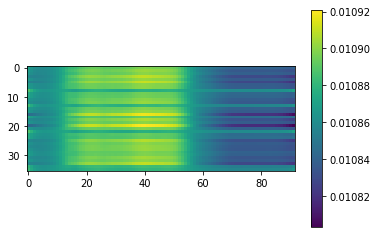

Calculated 160 Batches
Loss 160: 3.9099676344129772
08-24 15:28:41


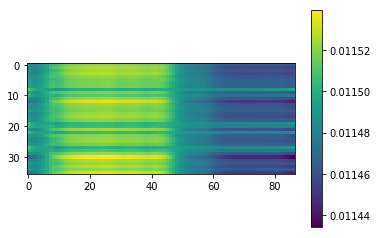

Calculated 170 Batches
Loss 170: 3.832536909315321
08-24 15:28:42


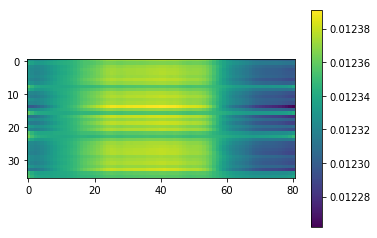

Calculated 180 Batches
Loss 180: 3.873263465033637
08-24 15:28:44


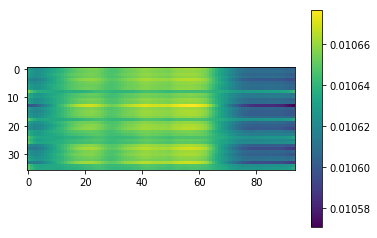

Calculated 190 Batches
Loss 190: 3.872719573974609
08-24 15:28:46


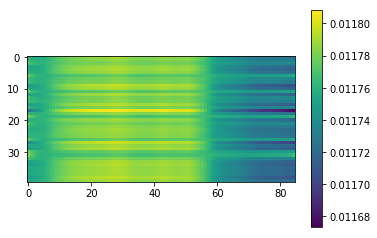

Calculated 200 Batches
Loss 200: 3.903279495239258
08-24 15:28:48


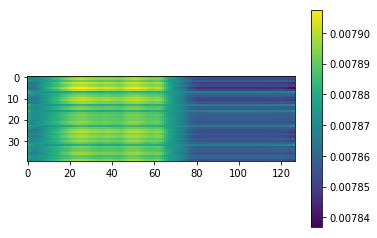

Calculated 210 Batches
Loss 210: 3.9139167785644533
08-24 15:28:49


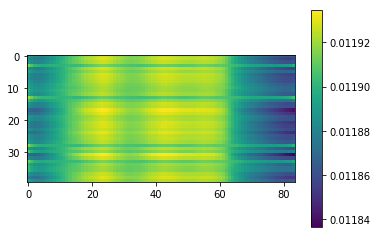

Calculated 220 Batches
Loss 220: 3.891000747680664
08-24 15:28:51


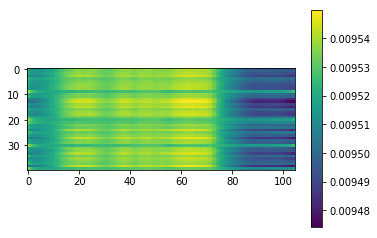

Calculated 230 Batches
Loss 230: 3.893505859375
08-24 15:28:53


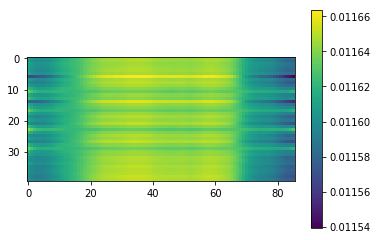

Calculated 240 Batches
Loss 240: 3.898341092196378
08-24 15:28:55


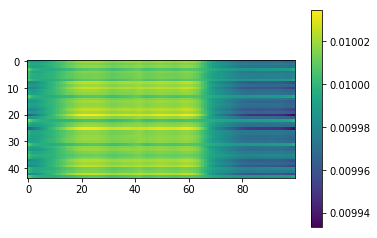

Calculated 250 Batches
Loss 250: 3.894634246826172
08-24 15:28:57


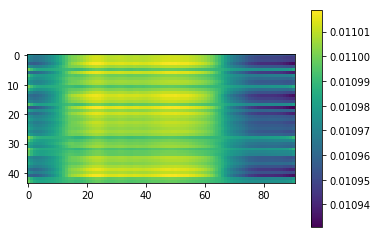

Calculated 260 Batches
Loss 260: 3.918060996315696
08-24 15:28:59


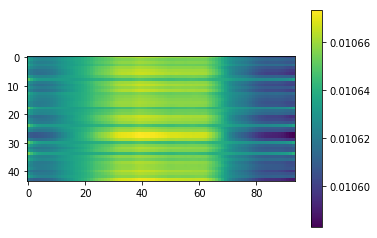

Calculated 270 Batches
Loss 270: 3.908475702459162
08-24 15:29:01


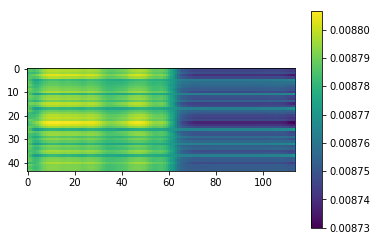

Calculated 280 Batches
Loss 280: 3.900928815205892
08-24 15:29:03


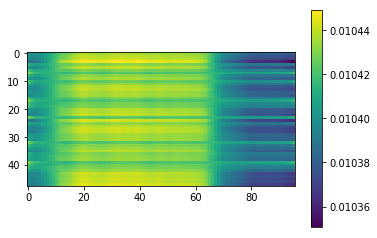

Calculated 290 Batches
Loss 290: 3.918463389078776
08-24 15:29:06


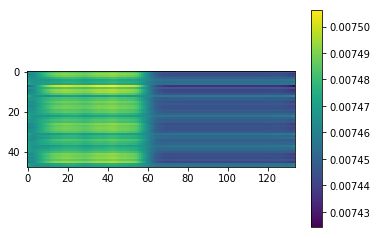

Calculated 300 Batches
Loss 300: 3.9403394063313804
08-24 15:29:08


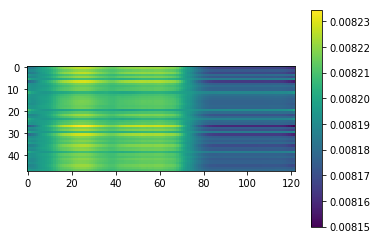

Calculated 310 Batches
Loss 310: 3.9041926066080728
08-24 15:29:10


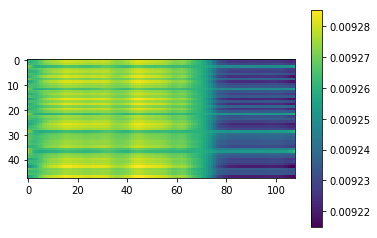

Calculated 320 Batches
Loss 320: 3.8908004760742188
08-24 15:29:13


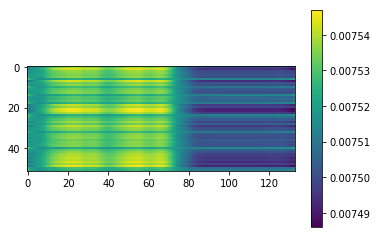

Calculated 330 Batches
Loss 330: 3.8946926410381613
08-24 15:29:15


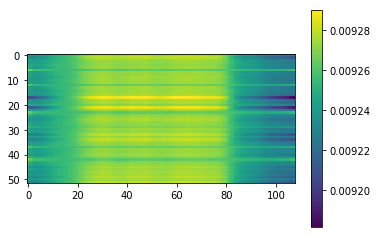

Calculated 340 Batches
Loss 340: 3.768796648297991
08-24 15:29:18


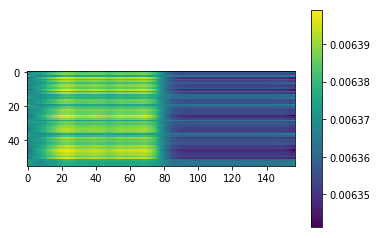

Calculated 350 Batches
Loss 350: 3.9581217084612166
08-24 15:29:20


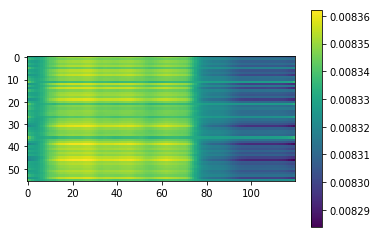

Calculated 360 Batches
Loss 360: 3.737981923421224
08-24 15:29:23


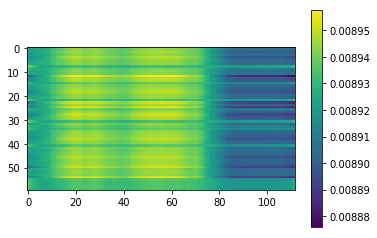

Calculated 370 Batches
Loss 370: 3.9599586486816407
08-24 15:29:26


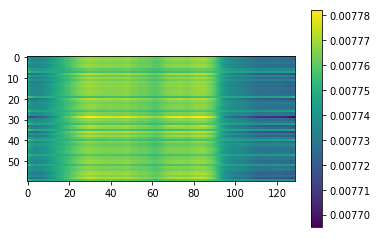

Calculated 380 Batches
Loss 380: 3.9662296772003174
08-24 15:29:29


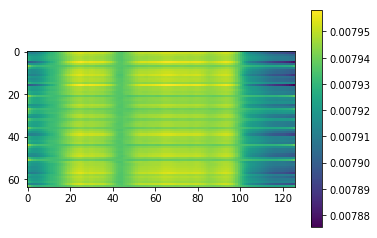

Calculated 390 Batches
Loss 390: 3.965837366440717
08-24 15:29:32


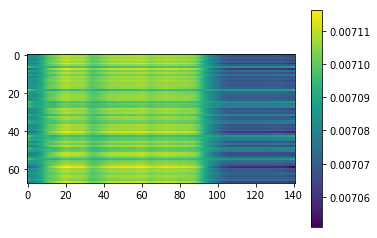

Calculated 400 Batches
Loss 400: 3.839508750221946
08-24 15:29:36


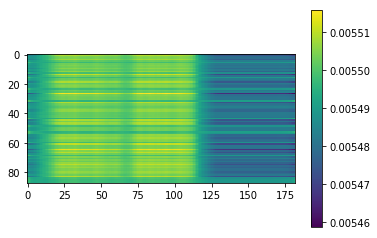

Mean Loss: 3.8778480512169646
----------------------------------------------------
08-24 15:29:37
Calculated 10 Batches
Loss 10: 3.722208023071289
08-24 15:29:38


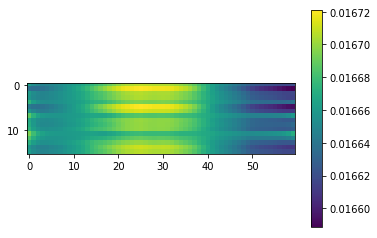

Calculated 20 Batches
Loss 20: 3.8608524322509767
08-24 15:29:39


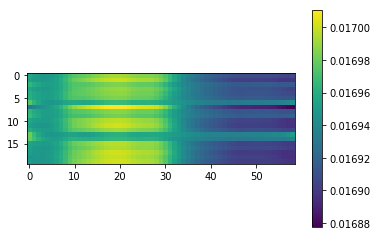

Calculated 30 Batches
Loss 30: 3.8262939453125
08-24 15:29:40


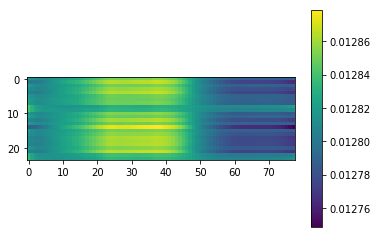

Calculated 40 Batches
Loss 40: 3.843276023864746
08-24 15:29:41


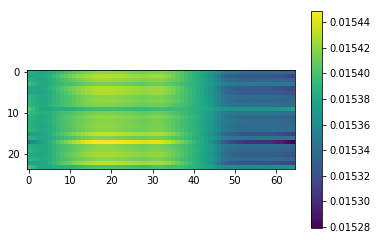

Calculated 50 Batches
Loss 50: 3.781864711216518
08-24 15:29:42


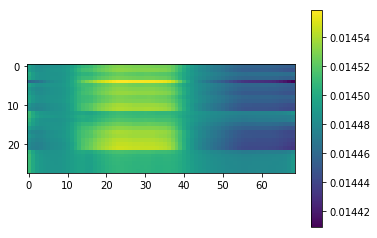

Calculated 60 Batches
Loss 60: 3.903660365513393
08-24 15:29:43


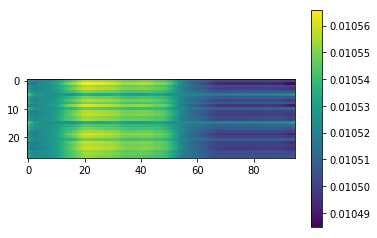

Calculated 70 Batches
Loss 70: 3.905980246407645
08-24 15:29:45


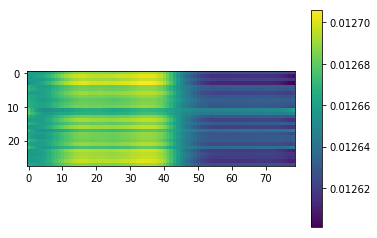

Calculated 80 Batches
Loss 80: 3.9134088243756975
08-24 15:29:46


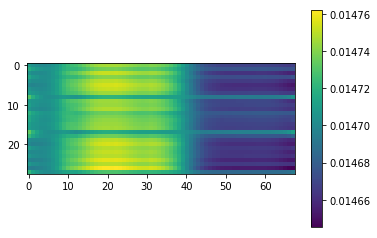

Calculated 90 Batches
Loss 90: 3.817192792892456
08-24 15:29:47


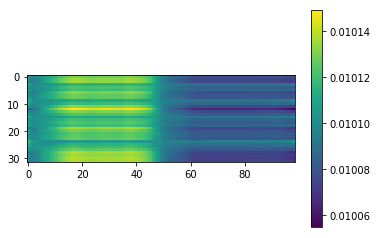

Calculated 100 Batches
Loss 100: 3.8801372051239014
08-24 15:29:49


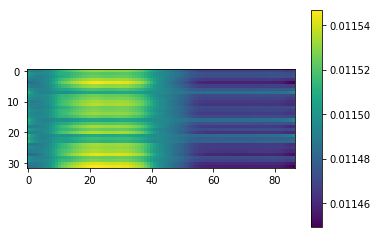

Calculated 110 Batches
Loss 110: 3.881883144378662
08-24 15:29:50


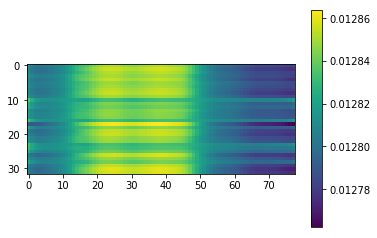

Calculated 120 Batches
Loss 120: 3.8694677352905273
08-24 15:29:52


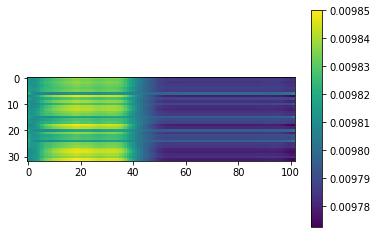

Calculated 130 Batches
Loss 130: 3.893303871154785
08-24 15:29:53


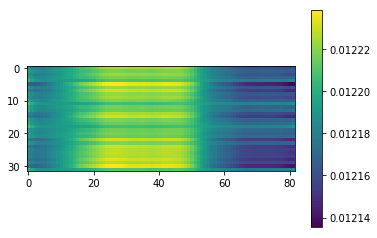

Calculated 140 Batches
Loss 140: 3.9126468234592013
08-24 15:29:55


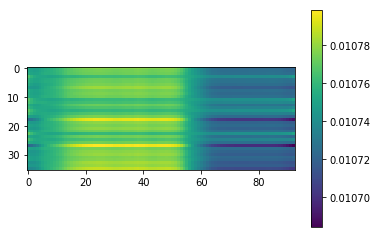

Calculated 150 Batches
Loss 150: 3.8604965209960938
08-24 15:29:57


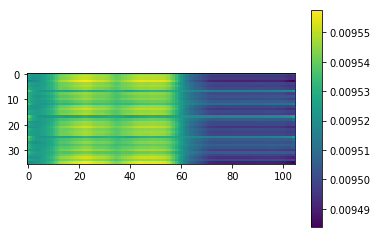

Calculated 160 Batches
Loss 160: 3.866268581814236
08-24 15:29:58


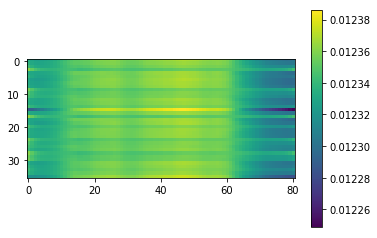

Calculated 170 Batches
Loss 170: 3.877173105875651
08-24 15:30:00


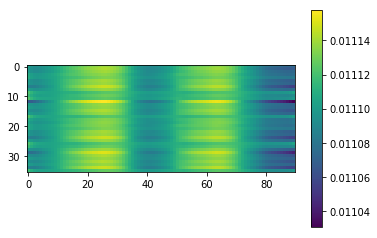

Calculated 180 Batches
Loss 180: 3.8665593465169272
08-24 15:30:01


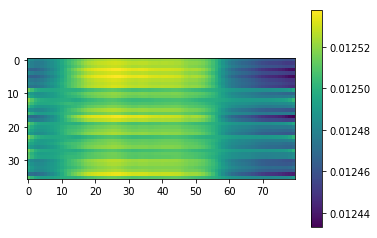

Calculated 190 Batches
Loss 190: 3.9042808532714846
08-24 15:30:03


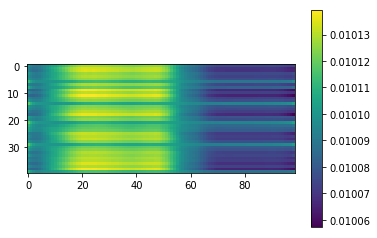

Calculated 200 Batches
Loss 200: 3.88829345703125
08-24 15:30:05


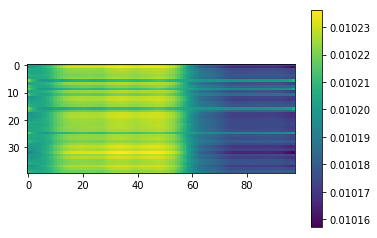

Calculated 210 Batches
Loss 210: 3.8836830139160154
08-24 15:30:07


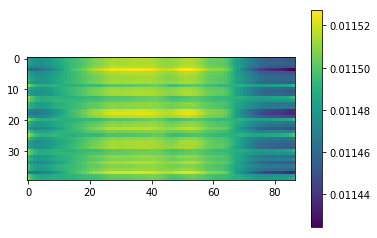

Calculated 220 Batches
Loss 220: 3.8804718017578126
08-24 15:30:09


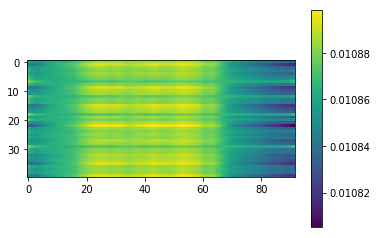

Calculated 230 Batches
Loss 230: 3.8938339233398436
08-24 15:30:11


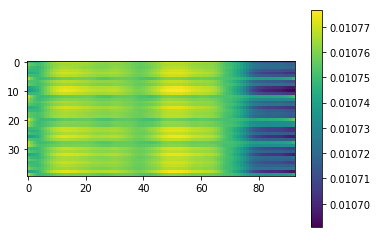

Calculated 240 Batches
Loss 240: 3.922827287153764
08-24 15:30:13


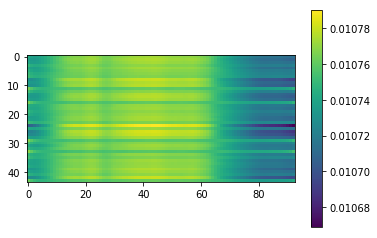

Calculated 250 Batches
Loss 250: 3.8974054509943183
08-24 15:30:15


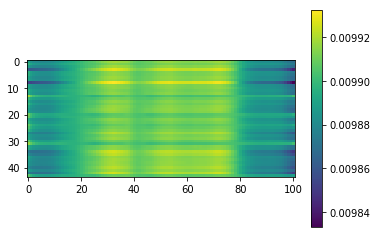

Calculated 260 Batches
Loss 260: 3.942611347545277
08-24 15:30:17


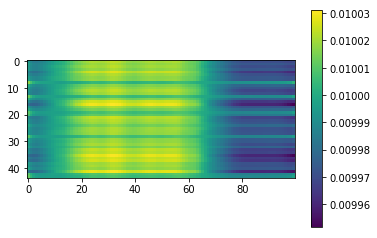

Calculated 270 Batches
Loss 270: 3.924987099387429
08-24 15:30:19


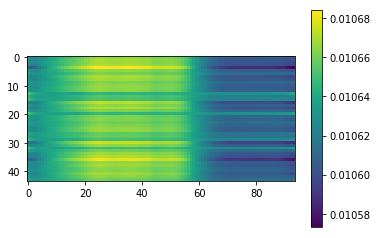

Calculated 280 Batches
Loss 280: 3.902531941731771
08-24 15:30:21


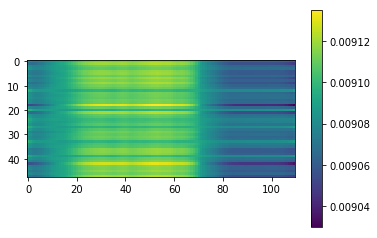

Calculated 290 Batches
Loss 290: 3.9080918629964194
08-24 15:30:23


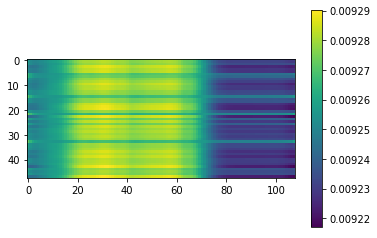

Calculated 300 Batches
Loss 300: 3.9362500508626304
08-24 15:30:26


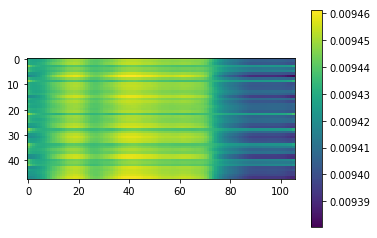

Calculated 310 Batches
Loss 310: 3.9114869435628257
08-24 15:30:28


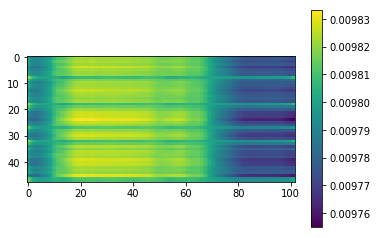

Calculated 320 Batches
Loss 320: 3.893358377309946
08-24 15:30:30


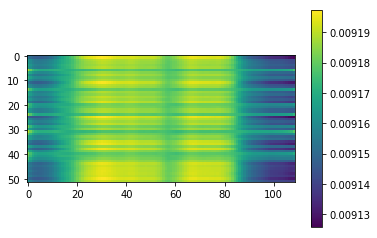

Calculated 330 Batches
Loss 330: 3.9174214876615086
08-24 15:30:33


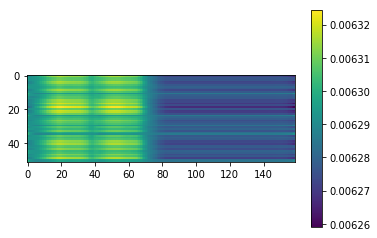

Calculated 340 Batches
Loss 340: 3.7850595201764787
08-24 15:30:35


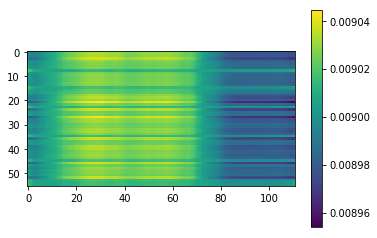

Calculated 350 Batches
Loss 350: 3.9538893018450056
08-24 15:30:38


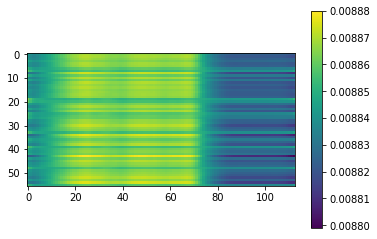

Calculated 360 Batches
Loss 360: 3.733649190266927
08-24 15:30:41


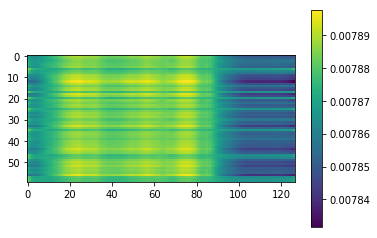

Calculated 370 Batches
Loss 370: 3.9533121744791666
08-24 15:30:43


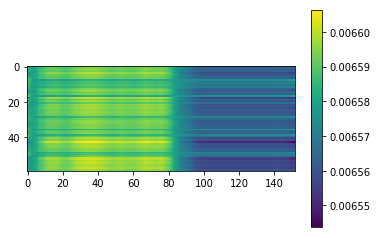

Calculated 380 Batches
Loss 380: 3.954803466796875
08-24 15:30:47


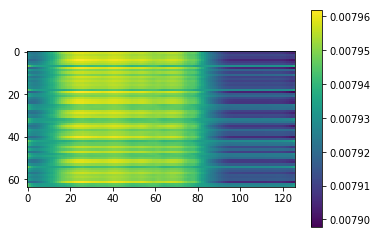

Calculated 390 Batches
Loss 390: 3.968366735121783
08-24 15:30:50


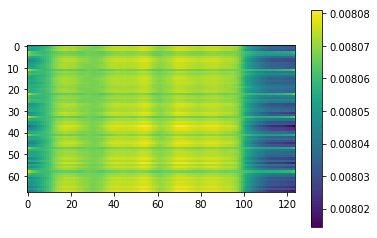

Calculated 400 Batches
Loss 400: 3.8406153592196377
08-24 15:30:54


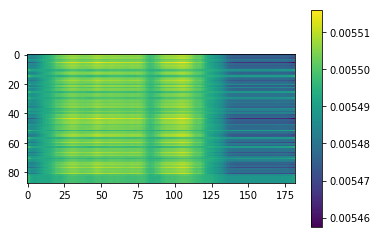

Mean Loss: 3.87815808077168
----------------------------------------------------
08-24 15:30:55
Calculated 10 Batches
Loss 10: 3.7872045040130615
08-24 15:30:55


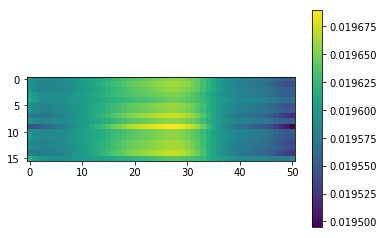

Calculated 20 Batches
Loss 20: 3.8490657806396484
08-24 15:30:56


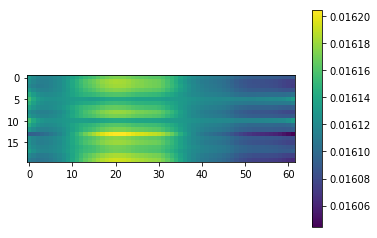

Calculated 30 Batches
Loss 30: 3.7382129033406577
08-24 15:30:57


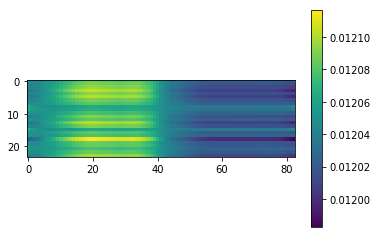

Calculated 40 Batches
Loss 40: 3.825802803039551
08-24 15:30:59


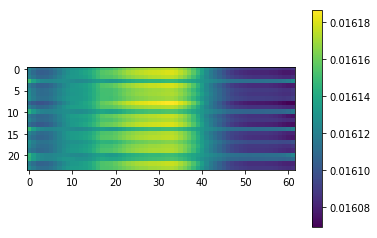

Calculated 50 Batches
Loss 50: 3.748154503958566
08-24 15:31:00


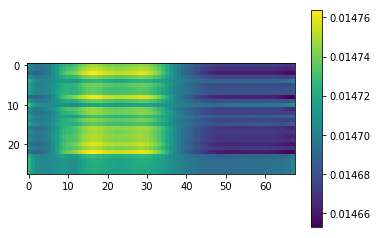

Calculated 60 Batches
Loss 60: 3.8842500959123885
08-24 15:31:01


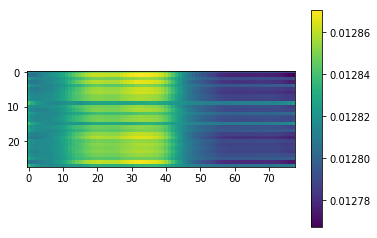

Calculated 70 Batches
Loss 70: 3.8351527622767856
08-24 15:31:02


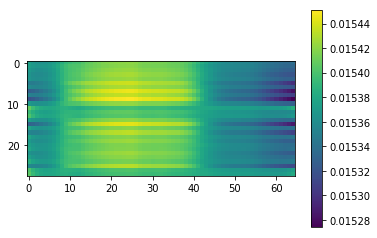

Calculated 80 Batches
Loss 80: 3.877788816179548
08-24 15:31:04


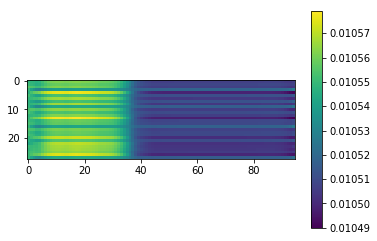

Calculated 90 Batches
Loss 90: 3.834656238555908
08-24 15:31:05


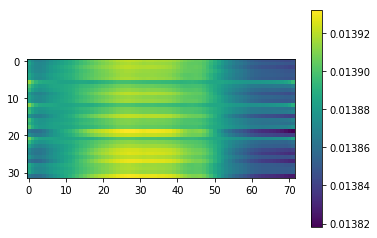

Calculated 100 Batches
Loss 100: 3.8779220581054688
08-24 15:31:06


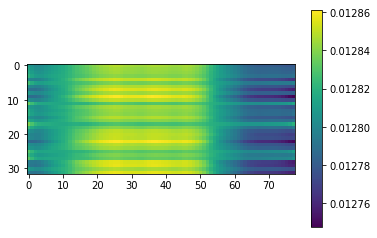

Calculated 110 Batches
Loss 110: 3.8543174266815186
08-24 15:31:08


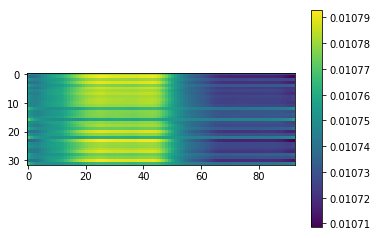

Calculated 120 Batches
Loss 120: 3.8801181316375732
08-24 15:31:09


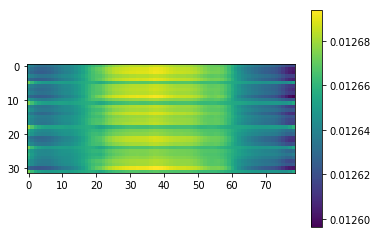

Calculated 130 Batches
Loss 130: 3.9178435802459717
08-24 15:31:11


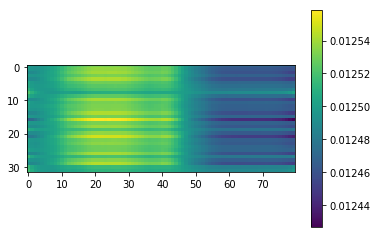

Calculated 140 Batches
Loss 140: 3.9001875983344183
08-24 15:31:12


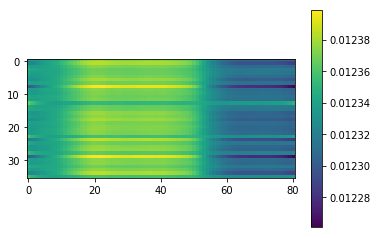

Calculated 150 Batches
Loss 150: 3.869232601589627
08-24 15:31:14


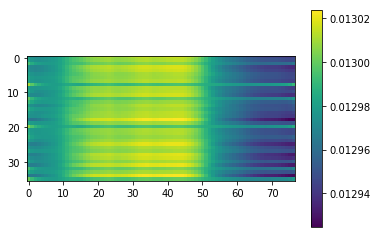

Calculated 160 Batches
Loss 160: 3.8697128295898438
08-24 15:31:16


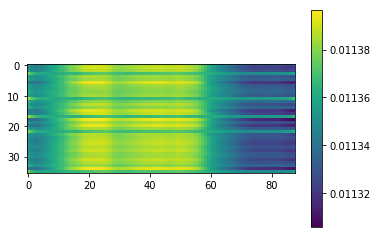

Calculated 170 Batches
Loss 170: 3.8799040052625866
08-24 15:31:17


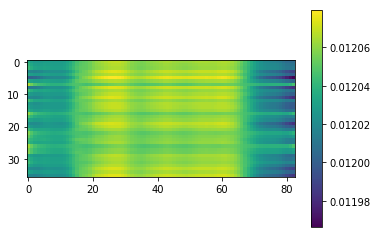

Calculated 180 Batches
Loss 180: 3.8387794494628906
08-24 15:31:19


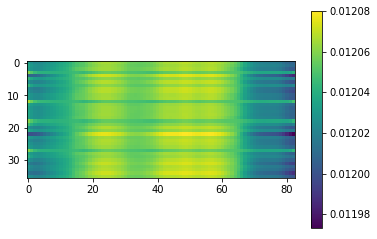

Calculated 190 Batches
Loss 190: 3.891684341430664
08-24 15:31:21


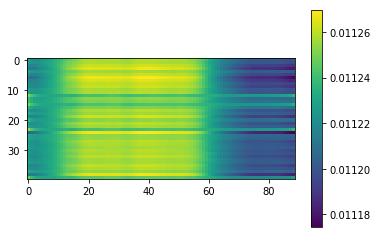

Calculated 200 Batches
Loss 200: 3.913319778442383
08-24 15:31:23


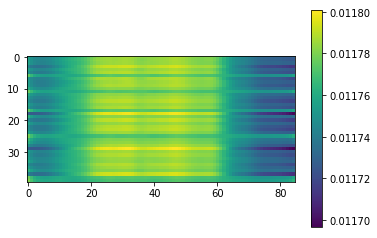

Calculated 210 Batches
Loss 210: 3.847268295288086
08-24 15:31:25


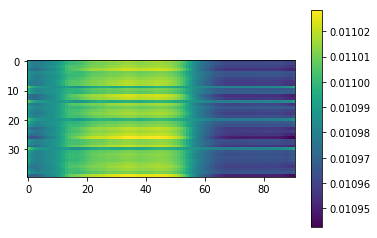

Calculated 220 Batches
Loss 220: 3.9041210174560548
08-24 15:31:26


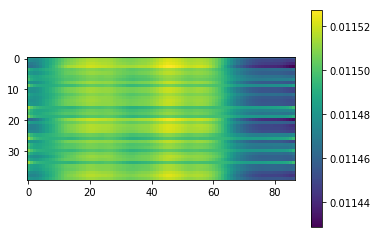

Calculated 230 Batches
Loss 230: 3.9126731872558596
08-24 15:31:28


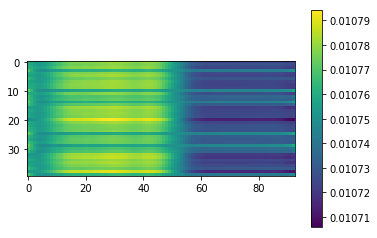

Calculated 240 Batches
Loss 240: 3.923891240900213
08-24 15:31:30


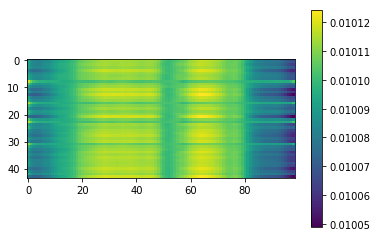

Calculated 250 Batches
Loss 250: 3.88683423128995
08-24 15:31:32


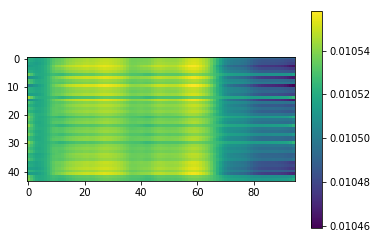

Calculated 260 Batches
Loss 260: 3.903153506192294
08-24 15:31:34


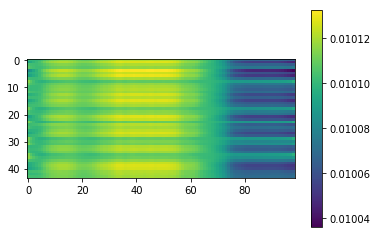

Calculated 270 Batches
Loss 270: 3.9192706021395596
08-24 15:31:36


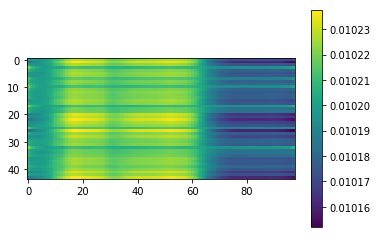

Calculated 280 Batches
Loss 280: 3.9262946446736655
08-24 15:31:39


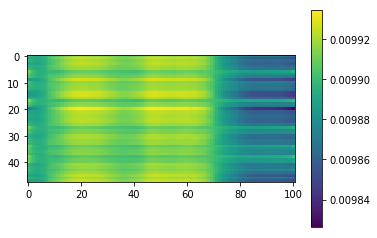

Calculated 290 Batches
Loss 290: 3.9431775410970054
08-24 15:31:41


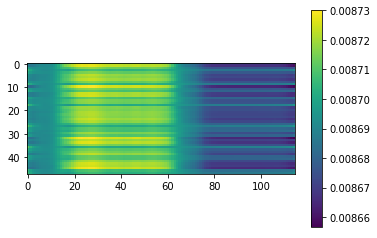

Calculated 300 Batches
Loss 300: 3.9361979166666665
08-24 15:31:43


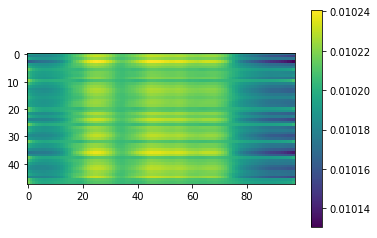

Calculated 310 Batches
Loss 310: 3.9371891021728516
08-24 15:31:45


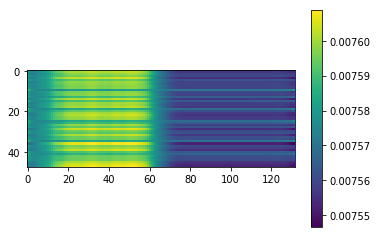

Calculated 320 Batches
Loss 320: 3.916430253248948
08-24 15:31:48


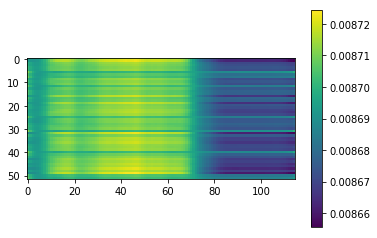

Calculated 330 Batches
Loss 330: 3.892296130840595
08-24 15:31:50


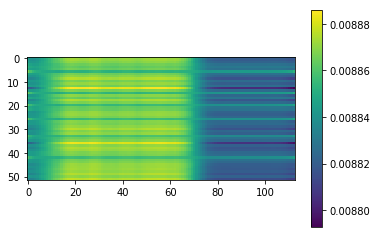

Calculated 340 Batches
Loss 340: 3.801511219569615
08-24 15:31:53


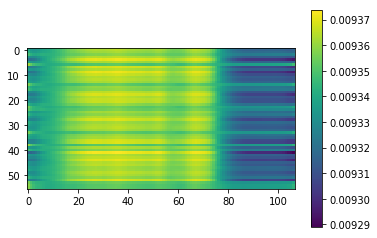

Calculated 350 Batches
Loss 350: 3.9569642203194753
08-24 15:31:55


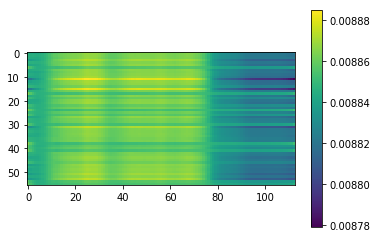

Calculated 360 Batches
Loss 360: 3.7219032287597655
08-24 15:31:58


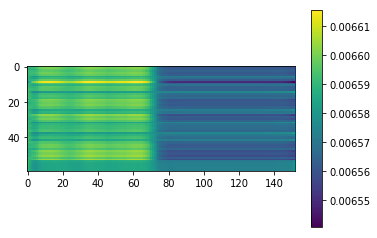

Calculated 370 Batches
Loss 370: 3.974371083577474
08-24 15:32:01


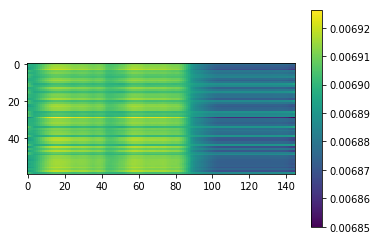

Calculated 380 Batches
Loss 380: 3.9576408863067627
08-24 15:32:04


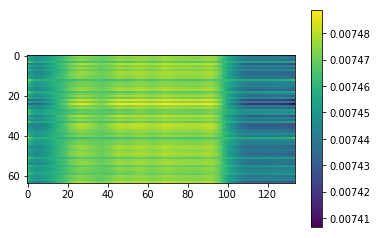

Calculated 390 Batches
Loss 390: 3.9731526094324447
08-24 15:32:07


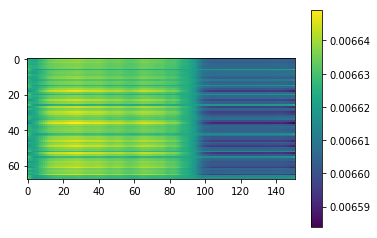

Calculated 400 Batches
Loss 400: 3.843194441361861
08-24 15:32:11


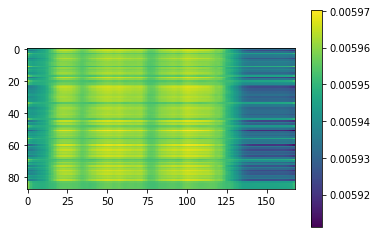

Mean Loss: 3.877966483864634
----------------------------------------------------
08-24 15:32:12
Calculated 10 Batches
Loss 10: 3.698570966720581
08-24 15:32:13


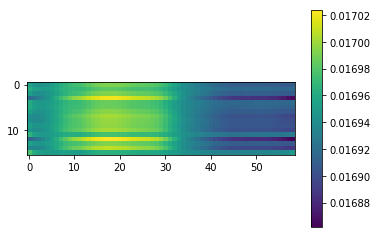

Calculated 20 Batches
Loss 20: 3.8636890411376954
08-24 15:32:14


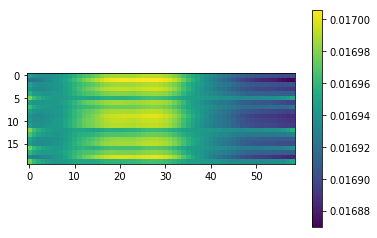

Calculated 30 Batches
Loss 30: 3.825615564982096
08-24 15:32:15


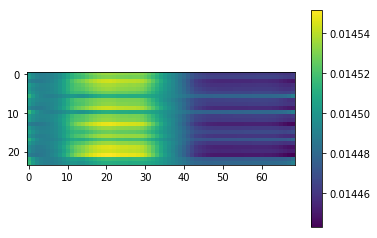

Calculated 40 Batches
Loss 40: 3.860039710998535
08-24 15:32:16


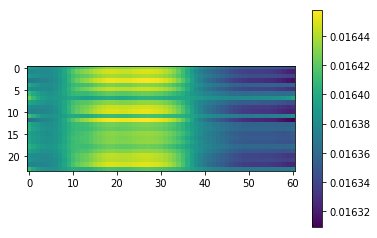

Calculated 50 Batches
Loss 50: 3.7226009368896484
08-24 15:32:18


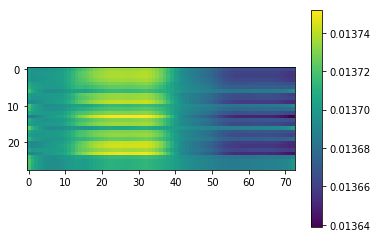

Calculated 60 Batches
Loss 60: 3.8659850529261996
08-24 15:32:19


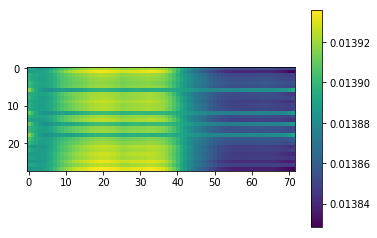

Calculated 70 Batches
Loss 70: 3.8343606676374162
08-24 15:32:20


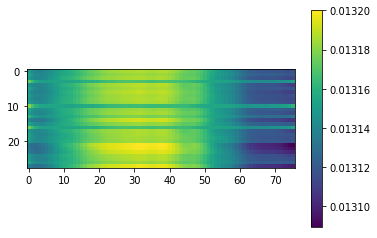

Calculated 80 Batches
Loss 80: 3.859905515398298
08-24 15:32:21


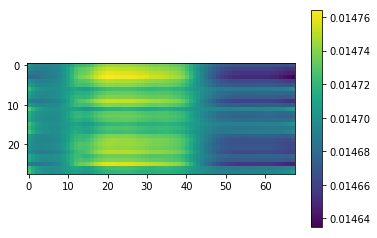

Calculated 90 Batches
Loss 90: 3.867225170135498
08-24 15:32:23


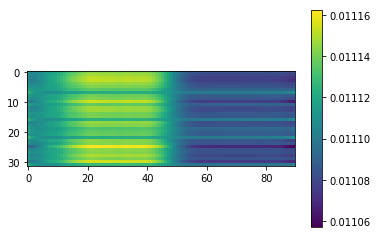

Calculated 100 Batches
Loss 100: 3.870598077774048
08-24 15:32:24


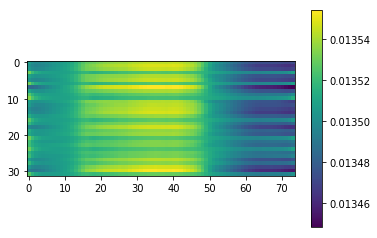

Calculated 110 Batches
Loss 110: 3.8345954418182373
08-24 15:32:26


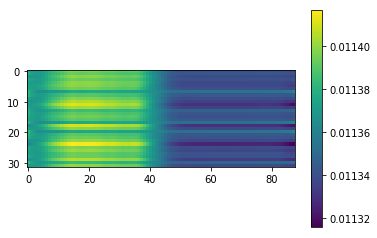

Calculated 120 Batches
Loss 120: 3.886854648590088
08-24 15:32:27


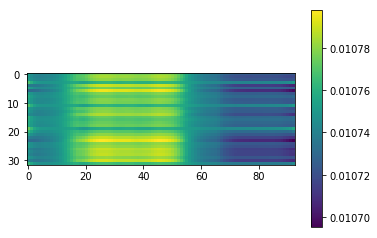

Calculated 130 Batches
Loss 130: 3.8610424995422363
08-24 15:32:28


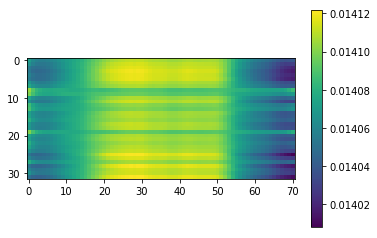

Calculated 140 Batches
Loss 140: 3.8970493740505643
08-24 15:32:30


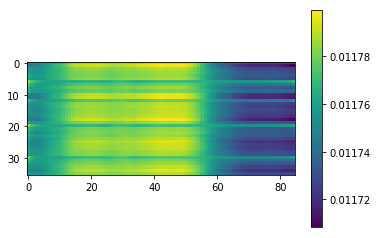

Calculated 150 Batches
Loss 150: 3.8455768161349826
08-24 15:32:32


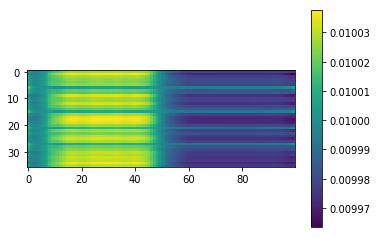

Calculated 160 Batches
Loss 160: 3.8615281846788196
08-24 15:32:33


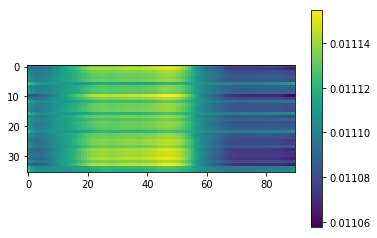

Calculated 170 Batches
Loss 170: 3.9347440931532116
08-24 15:32:35


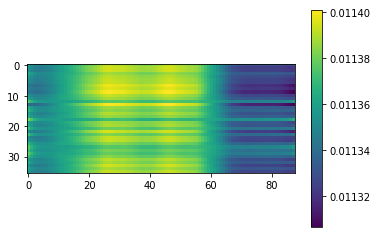

Calculated 180 Batches
Loss 180: 3.8736690945095487
08-24 15:32:37


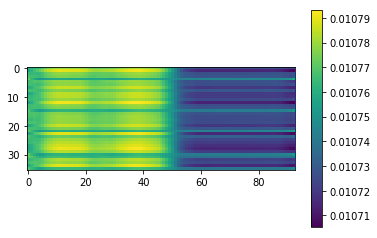

Calculated 190 Batches
Loss 190: 3.903359603881836
08-24 15:32:39


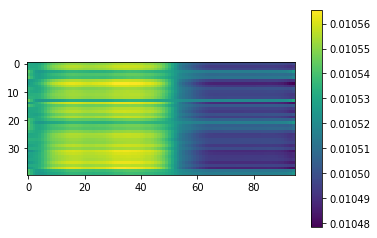

Calculated 200 Batches
Loss 200: 3.895899200439453
08-24 15:32:41


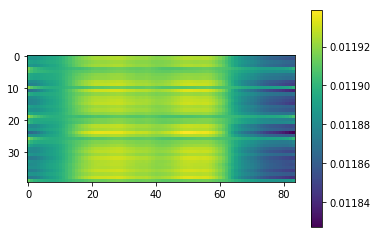

Calculated 210 Batches
Loss 210: 3.862380599975586
08-24 15:32:42


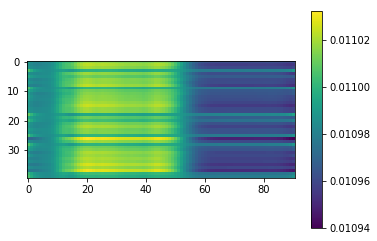

Calculated 220 Batches
Loss 220: 3.8883697509765627
08-24 15:32:44


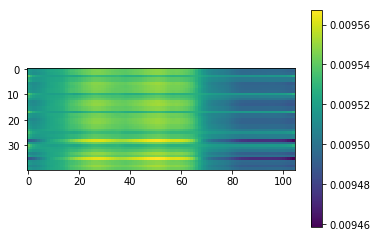

Calculated 230 Batches
Loss 230: 3.890229034423828
08-24 15:32:46


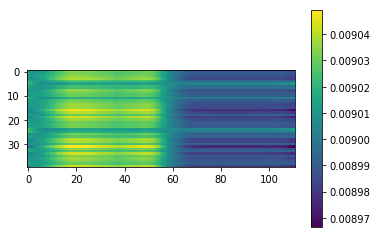

Calculated 240 Batches
Loss 240: 3.8831540888006035
08-24 15:32:48


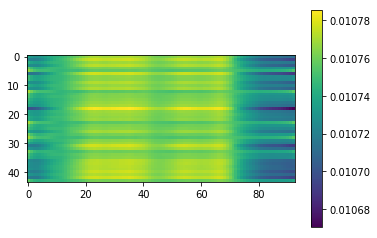

Calculated 250 Batches
Loss 250: 3.9480635903098364
08-24 15:32:50


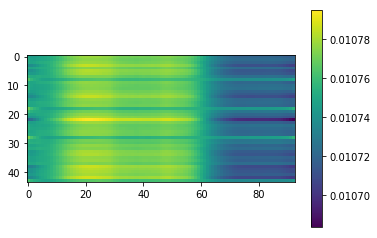

Calculated 260 Batches
Loss 260: 3.9164310802112925
08-24 15:32:52


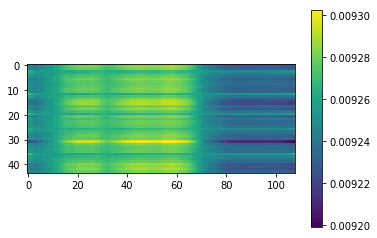

Calculated 270 Batches
Loss 270: 3.9019817005504263
08-24 15:32:54


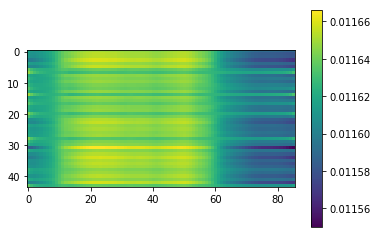

Calculated 280 Batches
Loss 280: 3.9066088994344077
08-24 15:32:56


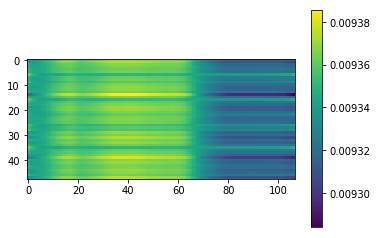

Calculated 290 Batches
Loss 290: 3.903435707092285
08-24 15:32:58


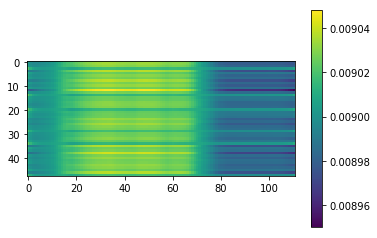

Calculated 300 Batches
Loss 300: 3.899930000305176
08-24 15:33:01


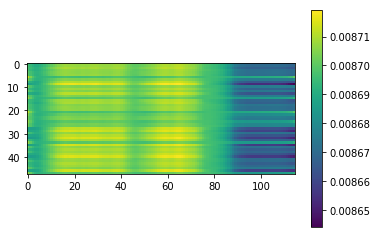

Calculated 310 Batches
Loss 310: 3.9340461095174155
08-24 15:33:03


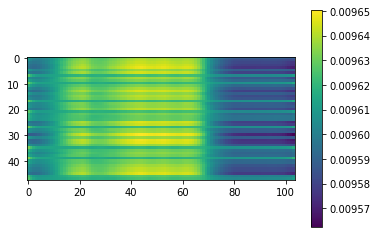

Calculated 320 Batches
Loss 320: 3.9046830397385817
08-24 15:33:05


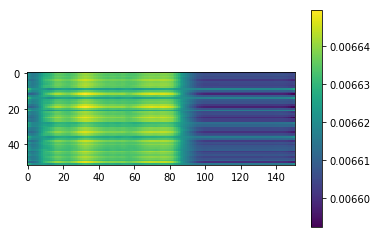

Calculated 330 Batches
Loss 330: 3.9040445181039662
08-24 15:33:08


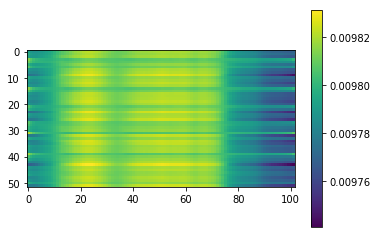

Calculated 340 Batches
Loss 340: 3.851084483753551
08-24 15:33:10


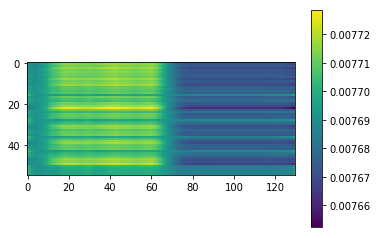

Calculated 350 Batches
Loss 350: 3.9082083020891463
08-24 15:33:13


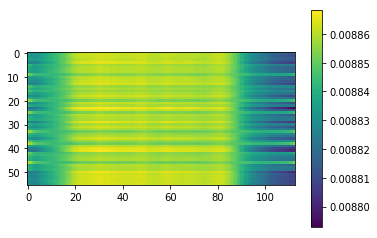

Calculated 360 Batches
Loss 360: 3.7598086039225262
08-24 15:33:16


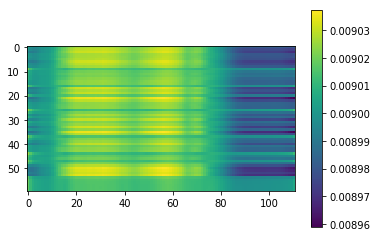

Calculated 370 Batches
Loss 370: 3.9563392639160155
08-24 15:33:18


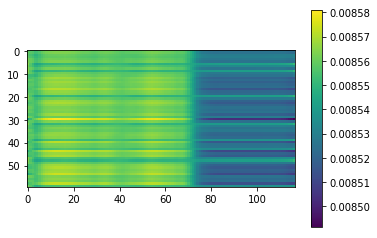

Calculated 380 Batches
Loss 380: 3.9461352825164795
08-24 15:33:22


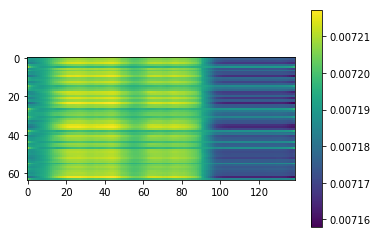

Calculated 390 Batches
Loss 390: 4.00826083912569
08-24 15:33:25


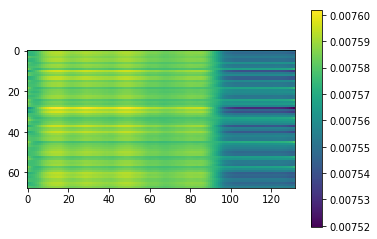

Calculated 400 Batches
Loss 400: 3.8410703485662285
08-24 15:33:29


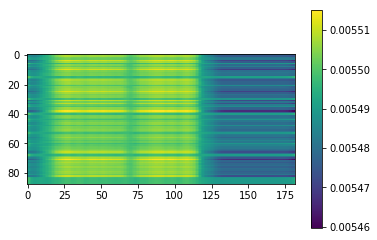

Mean Loss: 3.8780432557573614
----------------------------------------------------
08-24 15:33:30
Calculated 10 Batches
Loss 10: 3.717703342437744
08-24 15:33:31


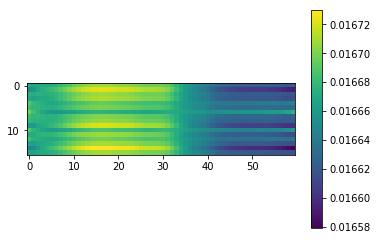

Calculated 20 Batches
Loss 20: 3.8085617065429687
08-24 15:33:32


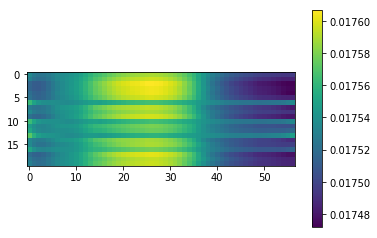

Calculated 30 Batches
Loss 30: 3.821781794230143
08-24 15:33:33


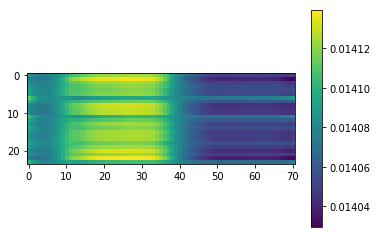

Calculated 40 Batches
Loss 40: 3.799467086791992
08-24 15:33:34


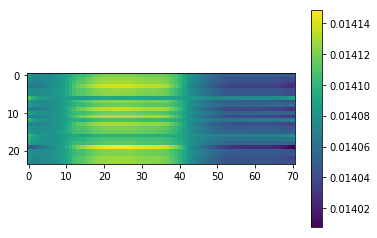

Calculated 50 Batches
Loss 50: 3.754531587873186
08-24 15:33:35


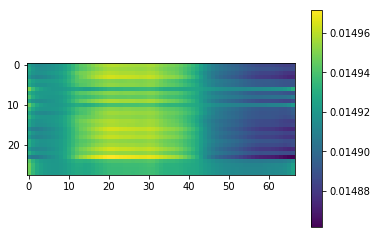

Calculated 60 Batches
Loss 60: 3.8261007581438338
08-24 15:33:36


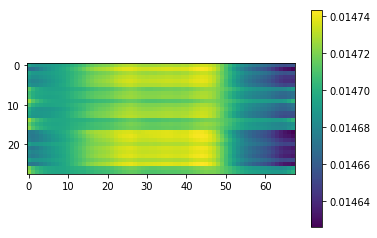

Calculated 70 Batches
Loss 70: 3.8447252001081194
08-24 15:33:38


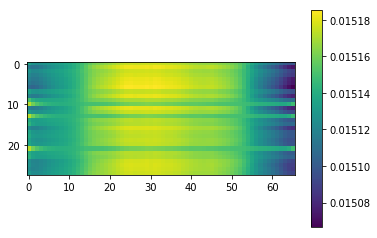

Calculated 80 Batches
Loss 80: 3.855267660958426
08-24 15:33:39


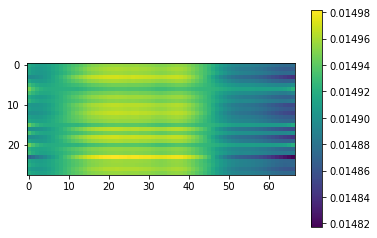

Calculated 90 Batches
Loss 90: 3.8635690212249756
08-24 15:33:40


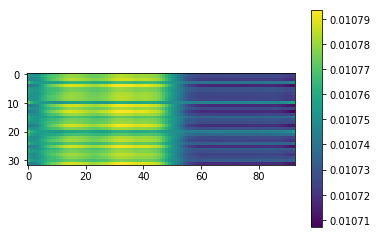

Calculated 100 Batches
Loss 100: 3.847594738006592
08-24 15:33:42


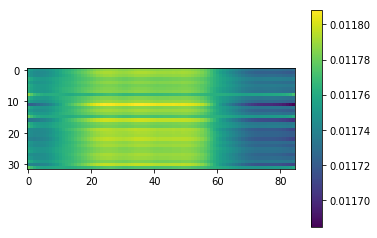

Calculated 110 Batches
Loss 110: 3.839205265045166
08-24 15:33:43


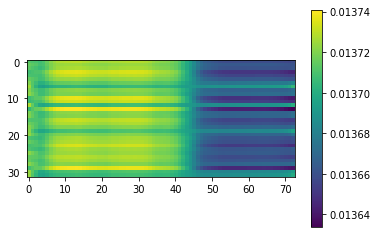

Calculated 120 Batches
Loss 120: 3.872854232788086
08-24 15:33:45


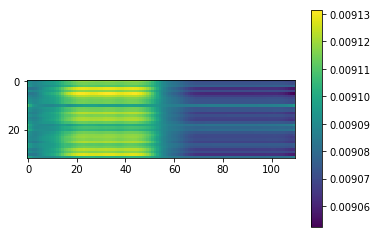

Calculated 130 Batches
Loss 130: 3.852254867553711
08-24 15:33:46


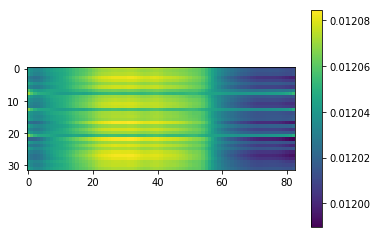

Calculated 140 Batches
Loss 140: 3.8566576639811196
08-24 15:33:48


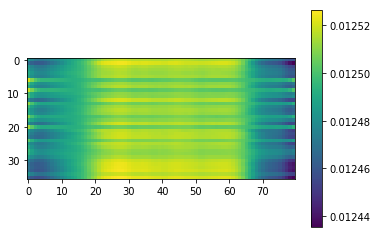

Calculated 150 Batches
Loss 150: 3.839596218532986
08-24 15:33:49


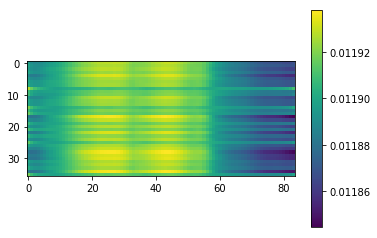

Calculated 160 Batches
Loss 160: 3.898368411593967
08-24 15:33:51


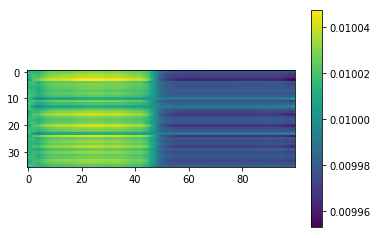

Calculated 170 Batches
Loss 170: 3.8301060994466147
08-24 15:33:53


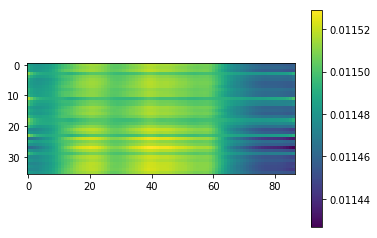

Calculated 180 Batches
Loss 180: 3.9005037943522134
08-24 15:33:54


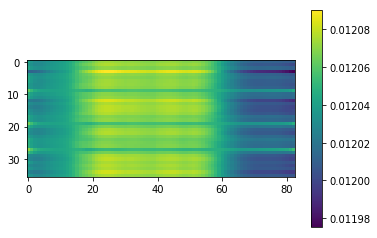

Calculated 190 Batches
Loss 190: 3.880411148071289
08-24 15:33:56


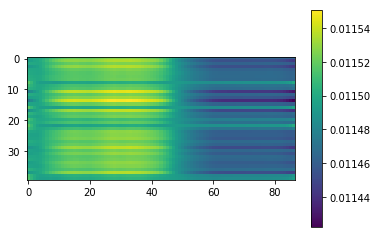

Calculated 200 Batches
Loss 200: 3.921256256103516
08-24 15:33:58


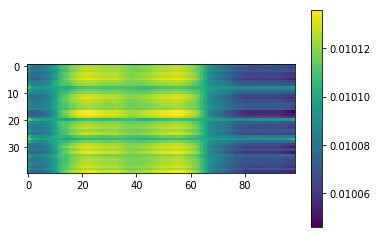

Calculated 210 Batches
Loss 210: 3.930923843383789
08-24 15:34:00


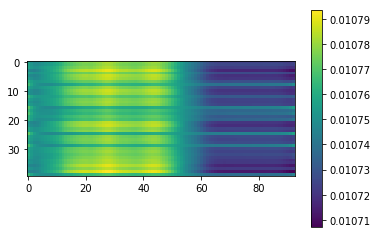

Calculated 220 Batches
Loss 220: 3.8730297088623047
08-24 15:34:02


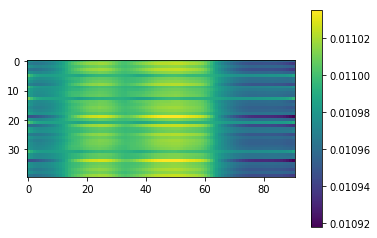

Calculated 230 Batches
Loss 230: 3.9201274871826173
08-24 15:34:04


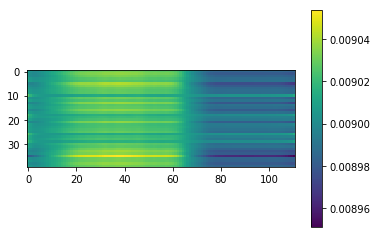

Calculated 240 Batches
Loss 240: 3.929140264337713
08-24 15:34:06


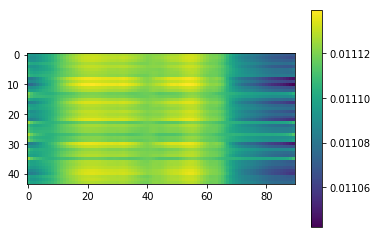

Calculated 250 Batches
Loss 250: 3.926309758966619
08-24 15:34:08


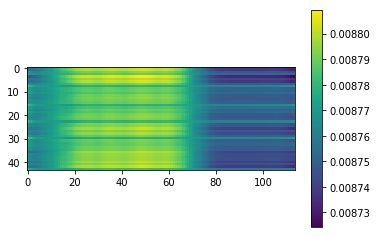

Calculated 260 Batches
Loss 260: 3.8754487471147017
08-24 15:34:10


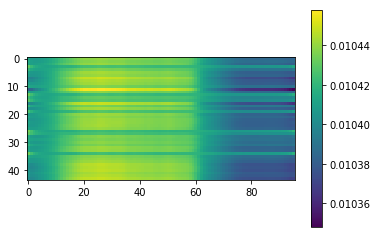

Calculated 270 Batches
Loss 270: 3.937052986838601
08-24 15:34:12


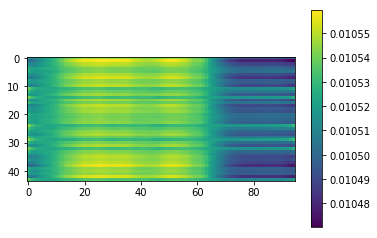

Calculated 280 Batches
Loss 280: 3.912550608317057
08-24 15:34:14


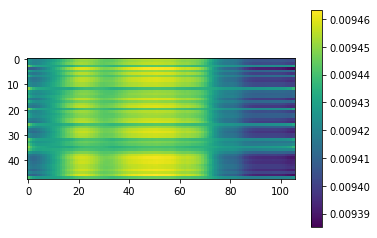

Calculated 290 Batches
Loss 290: 3.9084132512410483
08-24 15:34:16


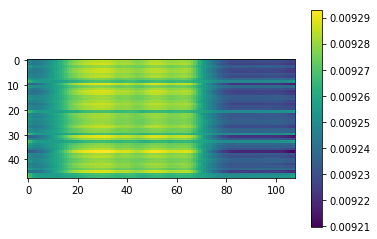

Calculated 300 Batches
Loss 300: 3.895550092061361
08-24 15:34:18


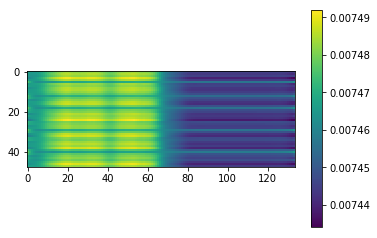

Calculated 310 Batches
Loss 310: 3.9228105545043945
08-24 15:34:20


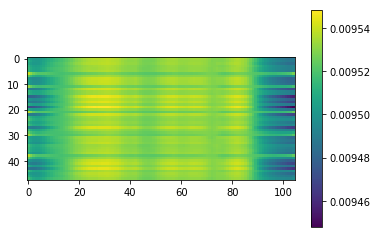

Calculated 320 Batches
Loss 320: 3.9226675767164965
08-24 15:34:23


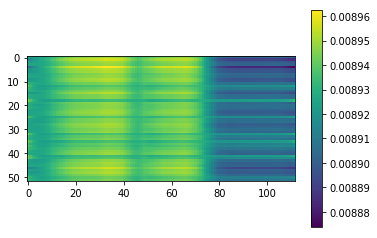

Calculated 330 Batches
Loss 330: 3.922114739051232
08-24 15:34:25


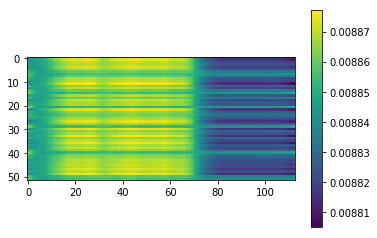

Calculated 340 Batches
Loss 340: 3.7812415531703403
08-24 15:34:28


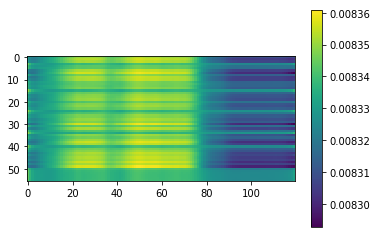

Calculated 350 Batches
Loss 350: 3.9544105529785156
08-24 15:34:31


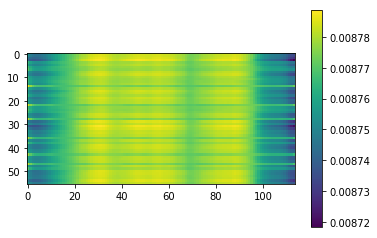

Calculated 360 Batches
Loss 360: 3.742974853515625
08-24 15:34:33


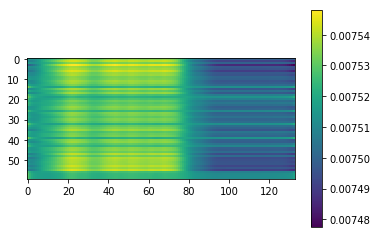

Calculated 370 Batches
Loss 370: 3.9457069396972657
08-24 15:34:36


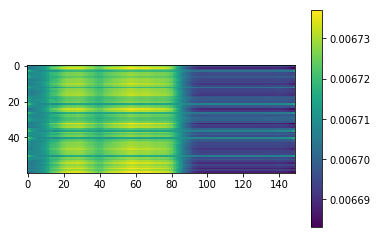

Calculated 380 Batches
Loss 380: 3.9375836849212646
08-24 15:34:39


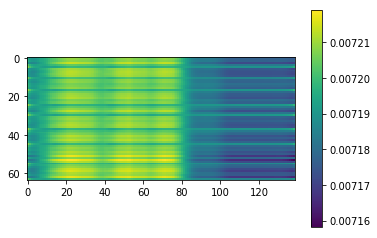

Calculated 390 Batches
Loss 390: 3.9531142290900734
08-24 15:34:43


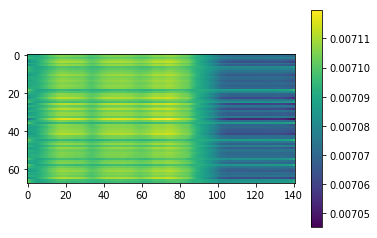

Calculated 400 Batches
Loss 400: 3.838844646107067
08-24 15:34:47


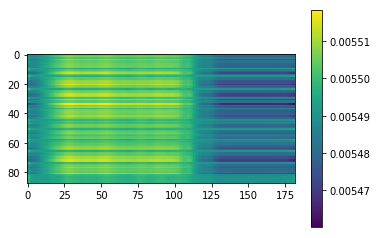

Mean Loss: 3.877636524948519
----------------------------------------------------
08-24 15:34:48
Calculated 10 Batches
Loss 10: 3.723680019378662
08-24 15:34:48


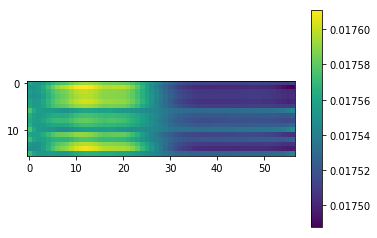

Calculated 20 Batches
Loss 20: 3.842604064941406
08-24 15:34:49


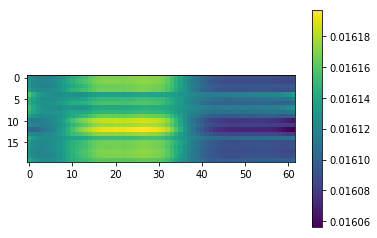

Calculated 30 Batches
Loss 30: 3.825650215148926
08-24 15:34:50


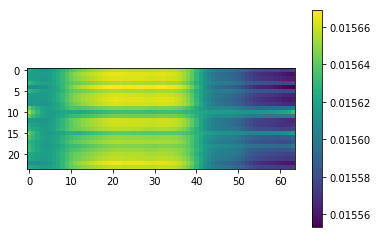

Calculated 40 Batches
Loss 40: 3.8868227005004883
08-24 15:34:51


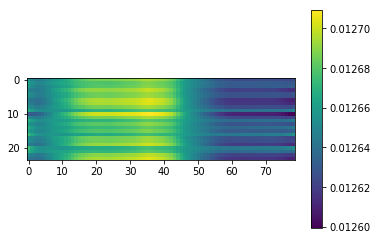

Calculated 50 Batches
Loss 50: 3.741385051182338
08-24 15:34:53


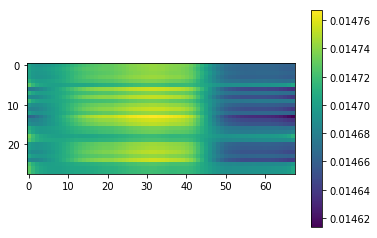

Calculated 60 Batches
Loss 60: 3.7959090641566684
08-24 15:34:54


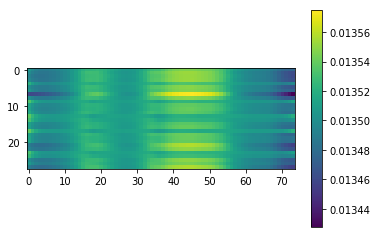

Calculated 70 Batches
Loss 70: 3.863339832850865
08-24 15:34:55


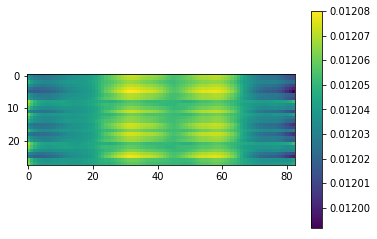

Calculated 80 Batches
Loss 80: 3.836263656616211
08-24 15:34:56


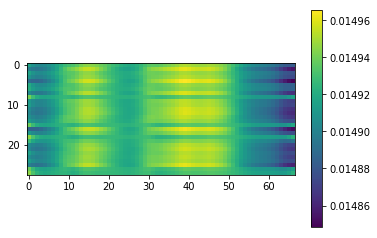

Calculated 90 Batches
Loss 90: 3.8413302898406982
08-24 15:34:58


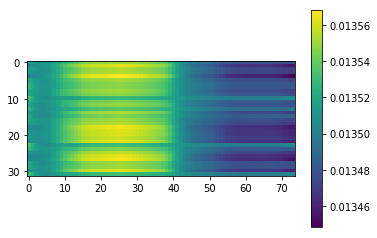

Calculated 100 Batches
Loss 100: 3.852473020553589
08-24 15:34:59


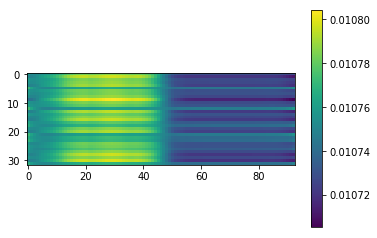

Calculated 110 Batches
Loss 110: 3.860055446624756
08-24 15:35:01


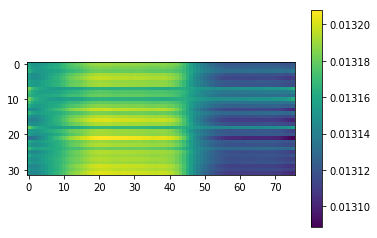

Calculated 120 Batches
Loss 120: 3.876434326171875
08-24 15:35:02


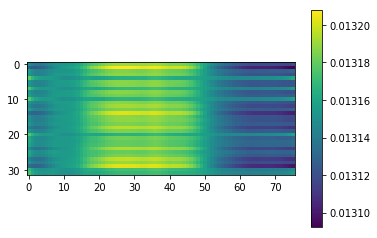

Calculated 130 Batches
Loss 130: 3.877331256866455
08-24 15:35:04


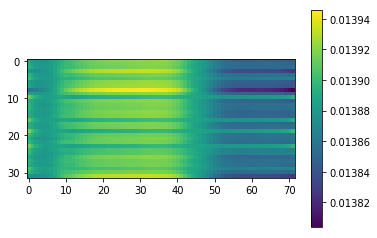

Calculated 140 Batches
Loss 140: 3.8465008205837674
08-24 15:35:05


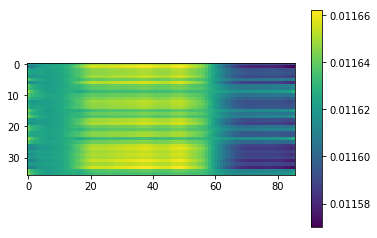

Calculated 150 Batches
Loss 150: 3.9075245327419705
08-24 15:35:07


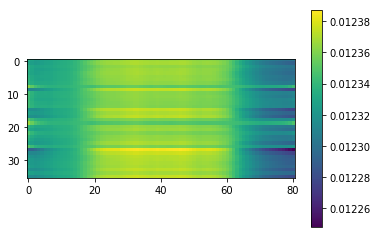

Calculated 160 Batches
Loss 160: 3.8797124226888022
08-24 15:35:09


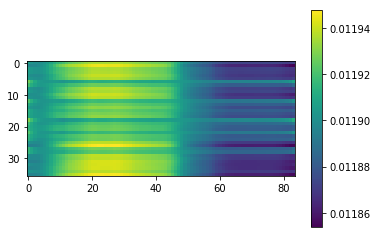

Calculated 170 Batches
Loss 170: 3.866376664903429
08-24 15:35:10


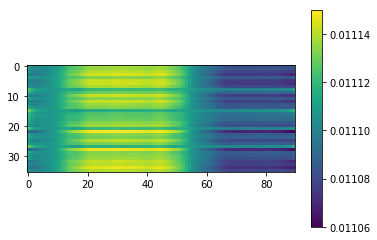

Calculated 180 Batches
Loss 180: 3.9225184122721353
08-24 15:35:12


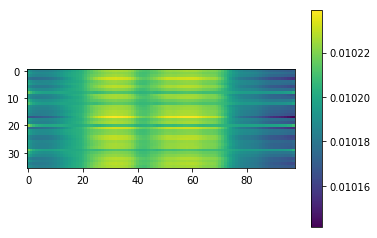

Calculated 190 Batches
Loss 190: 3.8963924407958985
08-24 15:35:14


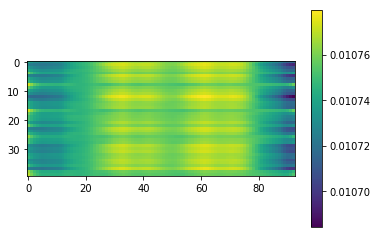

Calculated 200 Batches
Loss 200: 3.9503135681152344
08-24 15:35:16


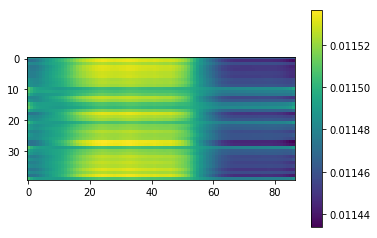

Calculated 210 Batches
Loss 210: 3.88897705078125
08-24 15:35:17


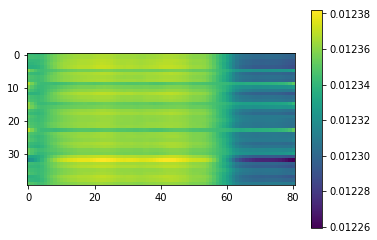

Calculated 220 Batches
Loss 220: 3.894075393676758
08-24 15:35:19


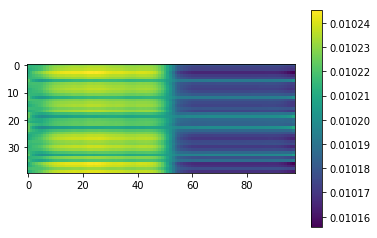

Calculated 230 Batches
Loss 230: 3.8643733978271486
08-24 15:35:21


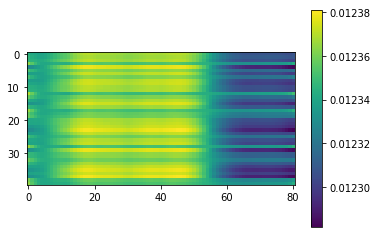

Calculated 240 Batches
Loss 240: 3.8981895446777344
08-24 15:35:23


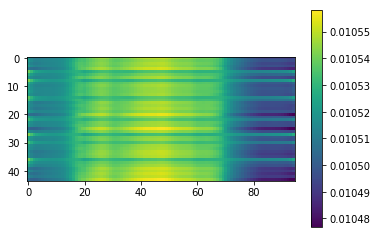

Calculated 250 Batches
Loss 250: 3.918296120383523
08-24 15:35:25


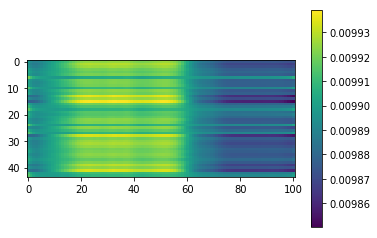

Calculated 260 Batches
Loss 260: 3.8955147483132104
08-24 15:35:27


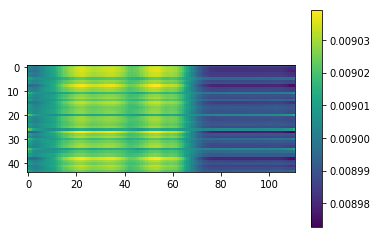

Calculated 270 Batches
Loss 270: 3.8742856112393467
08-24 15:35:29


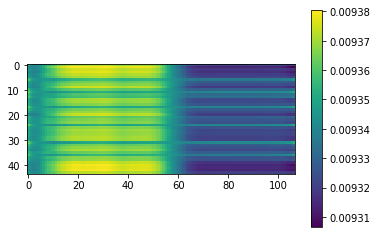

Calculated 280 Batches
Loss 280: 3.9402332305908203
08-24 15:35:31


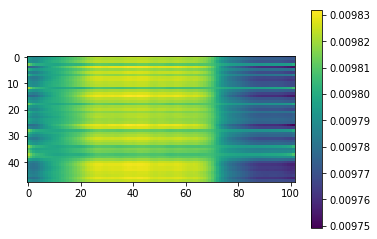

Calculated 290 Batches
Loss 290: 3.9081074396769204
08-24 15:35:34


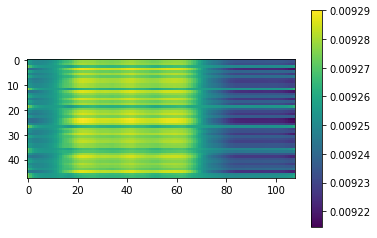

Calculated 300 Batches
Loss 300: 3.8949127197265625
08-24 15:35:36


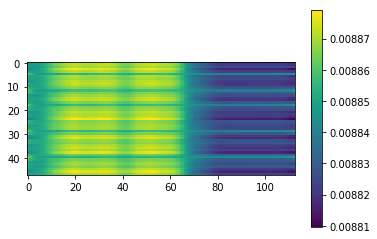

Calculated 310 Batches
Loss 310: 3.9115463892618814
08-24 15:35:38


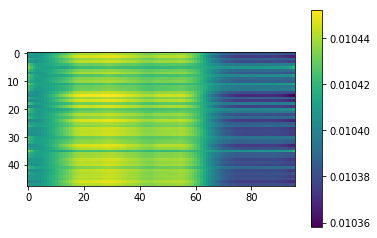

Calculated 320 Batches
Loss 320: 3.91232182429387
08-24 15:35:41


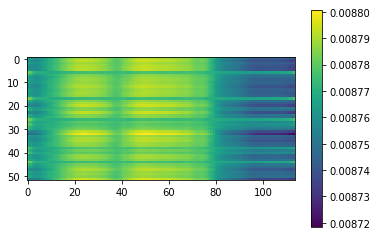

Calculated 330 Batches
Loss 330: 3.923468076265775
08-24 15:35:43


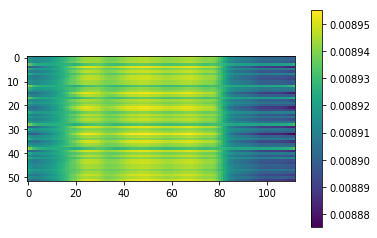

Calculated 340 Batches
Loss 340: 3.8029681614467075
08-24 15:35:46


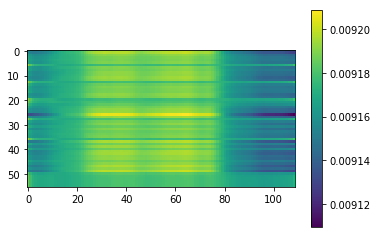

Calculated 350 Batches
Loss 350: 3.9462484632219588
08-24 15:35:48


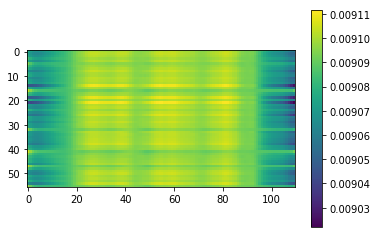

Calculated 360 Batches
Loss 360: 3.7394083658854167
08-24 15:35:51


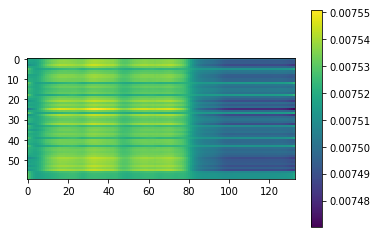

Calculated 370 Batches
Loss 370: 3.9449440002441407
08-24 15:35:54


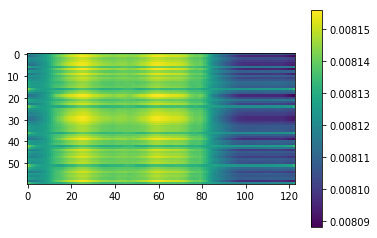

Calculated 380 Batches
Loss 380: 3.9681801795959473
08-24 15:35:57


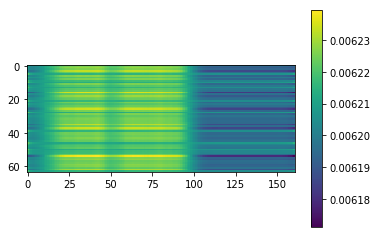

Calculated 390 Batches
Loss 390: 3.9582357967601105
08-24 15:36:00


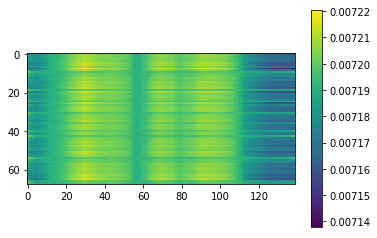

Calculated 400 Batches
Loss 400: 3.834165399724787
08-24 15:36:04


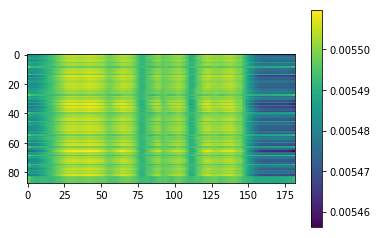

Mean Loss: 3.8774474468741937
----------------------------------------------------


In [52]:
EPOCH = 30

for epoch in range(EPOCH):
    try:
        net.load('gdrive/My Drive/korean-single-speaker-speech-dataset/kss/mel/check_point_test')
    except:
        print("Loading check point file Failed")
        
    preloader.initialize_batch()
    counter = 0
    loss_list = list()
    print(datetime.now().strftime('%m-%d %H:%M:%S'))
    
    while preloader.end_flag == False:
        tensor_input, ground_truth, loss_mask = preloader.get_batch()
        pred_tensor, attention_matrix, loss = net.train(tensor_input.to(device), ground_truth.to(device), loss_mask.to(device))
        
        counter += 1
        loss_list.append(loss)
        
        if (counter % 10 == 0):
            print('Calculated {} Batches'.format(counter))
            print('Loss {}: {}'.format(counter, loss))
            print(datetime.now().strftime('%m-%d %H:%M:%S'))

            plt.figure()
            plt.imshow(attention_matrix[0].detach().cpu().numpy())
            plt.colorbar()
            plt.show()
            
    net.save('gdrive/My Drive/korean-single-speaker-speech-dataset/kss/mel/check_point_test')
    print("Mean Loss: {}".format(np.mean(np.asarray(loss_list))))
    print("----------------------------------------------------")

In [0]:
# EPOCH = 1

# for epoch in range(EPOCH):
    
#     net.load('check_point_test')
    
#     for i in tqdm(range(len(metadata))):
#         tensor_input = preloader.get(i)
#         ground_truth = ground_truth_list[i]
        
#         pred_tensor, attention_matrix, loss = net.train(tensor_input.to(device), ground_truth.to(device))
        
#         if (i % 100 == 0):
#             print(datetime.datetime.now())
#             print('Loss {}: {}'.format(i, loss))
#             plt.figure()
#             plt.imshow(attention_matrix[0].detach().cpu().numpy())
#             plt.colorbar()
#             plt.show()
#             _, index = pred_tensor.max(-1)
#             sentence = tokenizer.num2word(index.view(-1))
#             print(''.join(sentence))
#             print(metadata[i, 2])
    
#     net.save('check_point_test')